In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms

from utils import mnist, plot_graphs, plot_mnist, to_onehot
import numpy as np
import os 

%matplotlib inline

In [2]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [3]:
root_folder = 'FC_AAE_C_results'
fixed_folder = root_folder + '/Fixed_results/'
recon_folder = root_folder + '/Recon_results/'

if os.path.isdir(root_folder):
    !rm -r $root_folder
os.mkdir(root_folder)
os.mkdir(fixed_folder)
os.mkdir(recon_folder)

In [4]:
mnist_tanh = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize((0.5,), (0.5,)),
                lambda x: x.to(device)
           ])

In [5]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

lr = 0.0001
prior_size = 10
train_epoch = 1000
batch_size = 250
train_loader, valid_loader, test_loader = mnist(batch_size=batch_size, valid=10000, transform=mnist_tanh)
fixed_z = torch.randn((10, prior_size)).repeat((1,10)).view(-1, prior_size).to(device)
fixed_z_label = to_onehot(torch.tensor(list(range(10))).repeat((10)), 10).to(device)
fixed_data, fixed_label = next(iter(test_loader))
fixed_data = fixed_data[:100].to(device)
fixed_label = to_onehot(fixed_label[:100], 10).to(device)

cuda:0


In [6]:
data, label = next(iter(train_loader))

In [7]:
class FullyConnected(nn.Module):
    def __init__(self, sizes, dropout=False, activation_fn=nn.Tanh(), flatten=False, 
                 last_fn=None, first_fn=None, device='cpu'):
        super(FullyConnected, self).__init__()
        layers = []
        self.flatten = flatten
        if first_fn is not None:
            layers.append(first_fn)
        for i in range(len(sizes) - 2):
            layers.append(nn.Linear(sizes[i], sizes[i+1]))
            if dropout:
                layers.append(nn.Dropout(dropout))
            layers.append(activation_fn) # нам не нужен дропаут и фнкция активации в последнем слое
        else: 
            layers.append(nn.Linear(sizes[-2], sizes[-1]))
        if last_fn is not None:
            layers.append(last_fn)
        self.model = nn.Sequential(*layers)
        self.to(device)
        
    def forward(self, x, y=None):
        if self.flatten:
            x = x.view(x.shape[0], -1)
        if y is not None:
            x = torch.cat([x, y], dim=1)
        return self.model(x)

In [8]:
Enc = FullyConnected([28*28, 1024, 1024, prior_size], activation_fn=nn.LeakyReLU(0.2), flatten=True, device=device)
Dec = FullyConnected([prior_size+10, 1024, 1024, 28*28], activation_fn=nn.LeakyReLU(0.2), last_fn=nn.Tanh(), device=device)
Disc = FullyConnected([prior_size, 1024, 1024, 1], dropout=0.3, activation_fn=nn.LeakyReLU(0.2), device=device)

Enc_optimizer = optim.Adam(Enc.parameters(), lr=lr)
Dec_optimizer = optim.Adam(Dec.parameters(), lr=lr)
Disc_optimizer = optim.Adam(Disc.parameters(), lr=lr)

In [9]:
train_log = {'E': [],'AE': [], 'D': []}
test_log = {'E': [],'AE': [], 'D': []}

In [10]:
batch_zeros = torch.zeros((batch_size, 1)).to(device)
batch_ones = torch.ones((batch_size, 1)).to(device)

In [11]:
def train(epoch, Enc, Dec, Disc, log=None):
    train_size = len(train_loader.sampler)
    for batch_idx, (data, label) in enumerate(train_loader):
        label = to_onehot(label, 10, device)
        # train D
        Enc.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size)).to(device)
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)

        fake_pred = Disc(Enc(data))
        true_pred = Disc(z)

        
        fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros)
        true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones)
        
        Disc_loss = 0.5*(fake_loss + true_loss)
        
        Disc_loss.backward()
        Disc_optimizer.step()
        
        # train AE
        Enc.zero_grad()
        Dec.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size))
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10)
        
        latent = Enc(data)
        reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
        fake_pred = Disc(latent)
        
        Enc_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_ones)
        AE_loss = F.mse_loss(reconstructed, data)
        G_loss = AE_loss + Enc_loss
        
        G_loss.backward()
        Dec_optimizer.step()
        Enc_optimizer.step()
            
        if batch_idx % 100 == 0:
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
            losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
            print(line + losses)
            
    else:
        batch_idx += 1
        line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
            epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
        losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
        print(line + losses)
        log['E'].append(Enc_loss.item())
        log['AE'].append(AE_loss.item())
        log['D'].append(Disc_loss.item())

In [12]:
def test(Enc, Dec, Disc, loader, epoch, log=None):
    test_size = len(loader)
    E_loss = 0.
    AE_loss = 0.
    D_loss = 0.
    test_loss = {'E': 0., 'AE': 0., 'D': 0.}
    with torch.no_grad():
        for data, label in loader:
            label = to_onehot(label, 10, device)
            z = torch.randn((batch_size, prior_size)).to(device)
            z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)
            latent = Enc(data)
            reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
            fake_pred = Disc(latent)
            true_pred = Disc(z)
        
            fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros).item()
            true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones).item()
            
            D_loss += 0.5*(fake_loss + true_loss)
            E_loss += F.binary_cross_entropy_with_logits(fake_pred, batch_ones).item()
            AE_loss += F.mse_loss(reconstructed, data)
            
        E_loss /= test_size
        D_loss /= test_size
        AE_loss /= test_size

        fixed_gen = Dec(fixed_z, fixed_z_label).cpu().data.numpy().reshape(100, 1, 28, 28)
        plot_mnist(fixed_gen, (10, 10), True, fixed_folder + '%03d.png' % epoch)
        fixed_reconstruction = Dec(Enc(fixed_data), fixed_label).cpu().data.numpy().reshape(100, 1, 28, 28)
        plot_mnist(fixed_reconstruction, (10, 10), True, recon_folder + '%03d.png' % epoch)
        
    report = 'Test losses. E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(E_loss, AE_loss, D_loss)
    print(report)

Train Epoch: 1 [0/50000 (0%)]	Losses E: 0.6488, AE: 0.9265, D: 0.6619
Train Epoch: 1 [25000/50000 (50%)]	Losses E: 0.7547, AE: 0.2717, D: 5.6026
Train Epoch: 1 [50000/50000 (100%)]	Losses E: 0.8650, AE: 0.2713, D: 1.6477


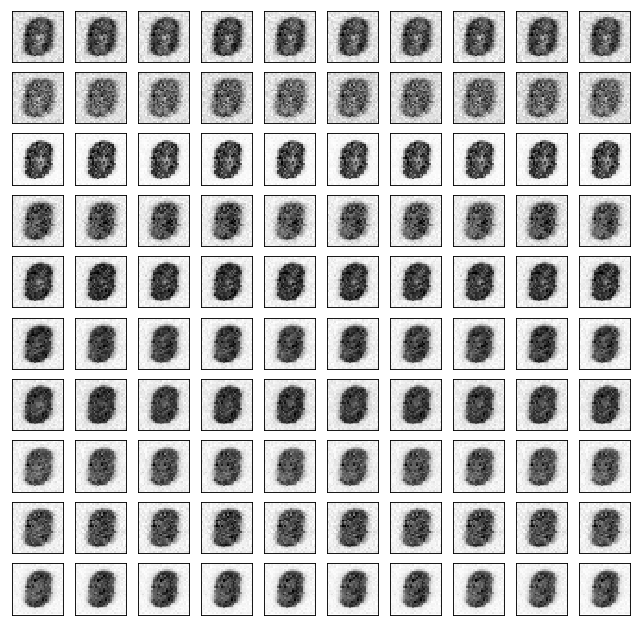

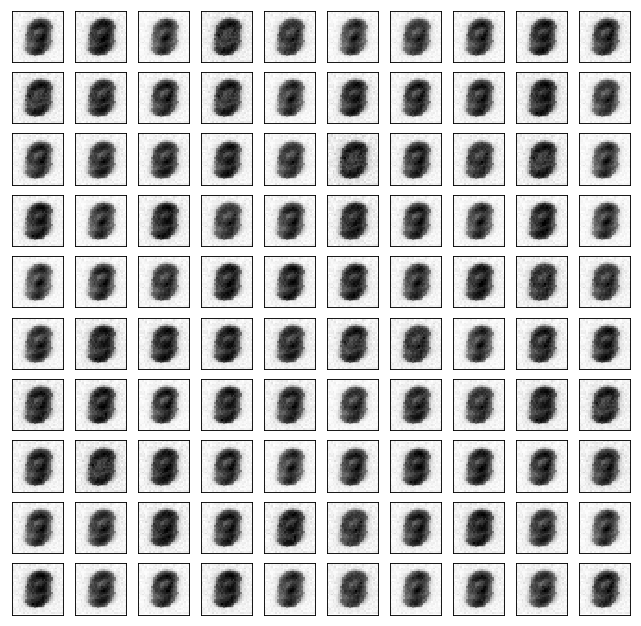

Test losses. E: 0.8535, AE: 0.2694, D: 1.6051
Train Epoch: 2 [0/50000 (0%)]	Losses E: 0.8545, AE: 0.2696, D: 1.5956
Train Epoch: 2 [25000/50000 (50%)]	Losses E: 0.5284, AE: 0.2599, D: 0.9501
Train Epoch: 2 [50000/50000 (100%)]	Losses E: 1.3146, AE: 0.2497, D: 0.9016


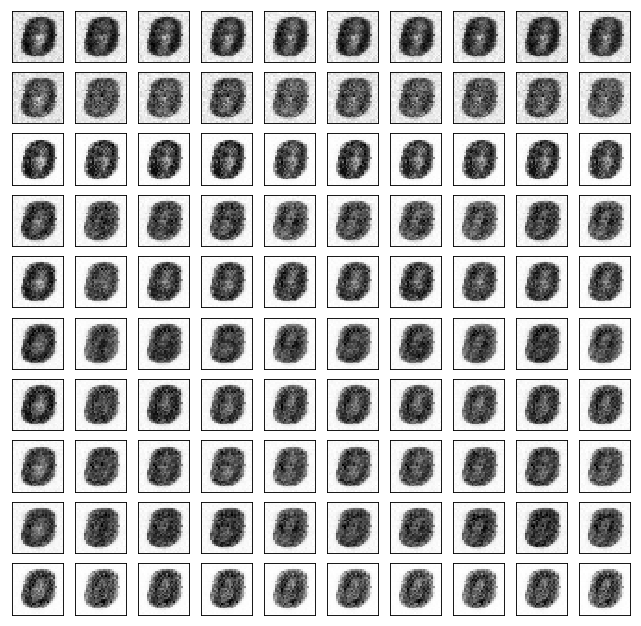

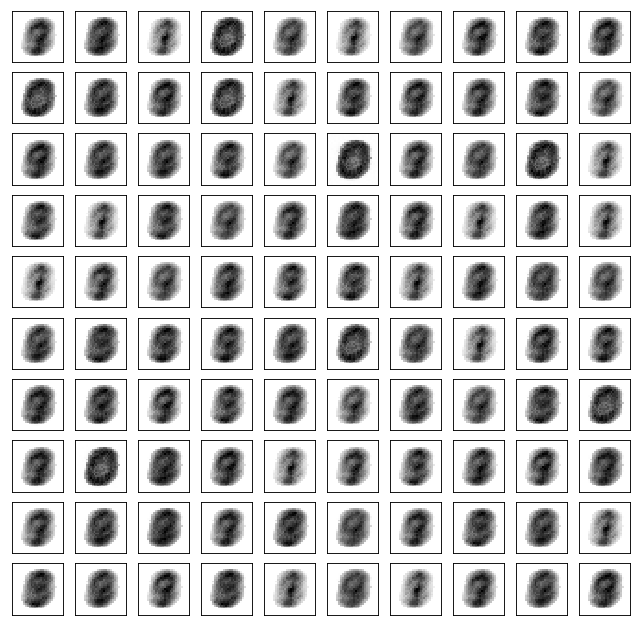

Test losses. E: 1.0759, AE: 0.2500, D: 0.8987
Train Epoch: 3 [0/50000 (0%)]	Losses E: 1.2505, AE: 0.2531, D: 0.8662
Train Epoch: 3 [25000/50000 (50%)]	Losses E: 0.4668, AE: 0.2594, D: 0.8922
Train Epoch: 3 [50000/50000 (100%)]	Losses E: 0.5844, AE: 0.2293, D: 0.7861


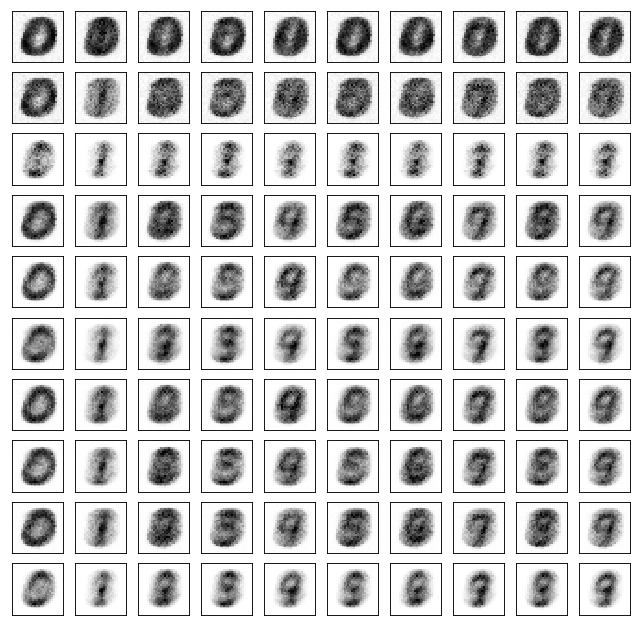

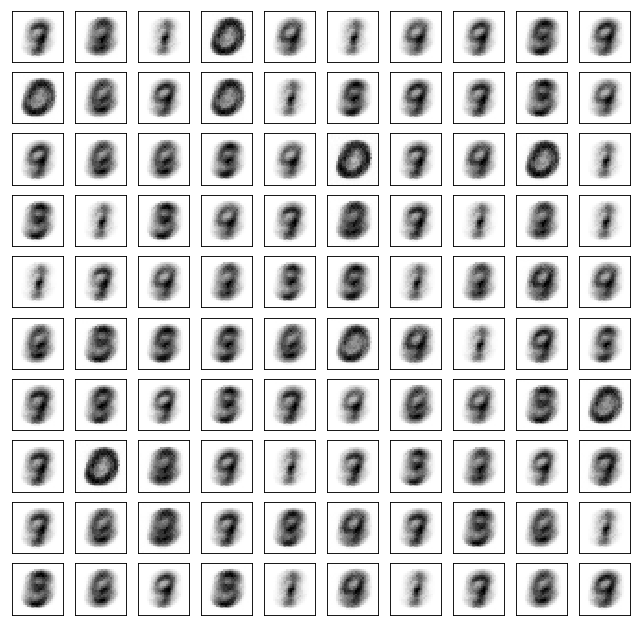

Test losses. E: 0.5351, AE: 0.2322, D: 0.7880
Train Epoch: 4 [0/50000 (0%)]	Losses E: 0.6072, AE: 0.2345, D: 0.7984
Train Epoch: 4 [25000/50000 (50%)]	Losses E: 0.7922, AE: 0.2170, D: 0.8128
Train Epoch: 4 [50000/50000 (100%)]	Losses E: 0.4679, AE: 0.2224, D: 0.8443


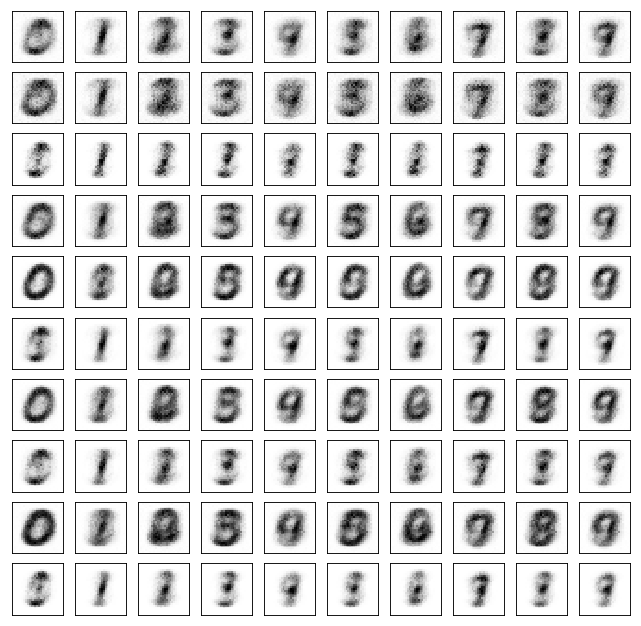

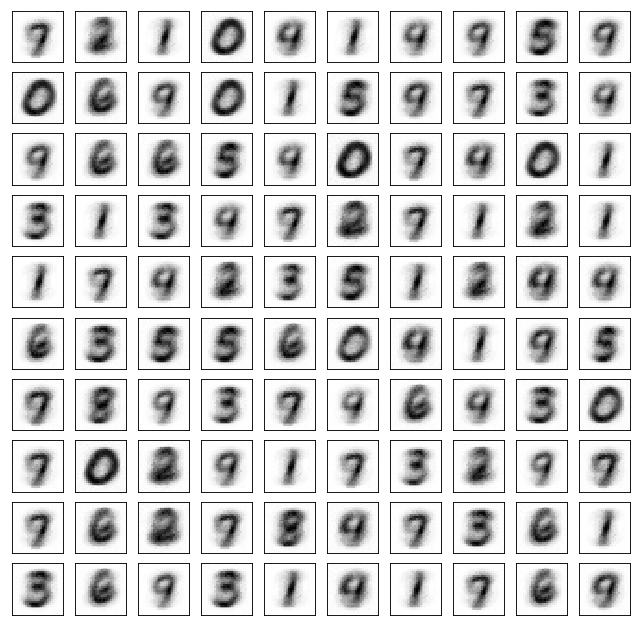

Test losses. E: 0.4565, AE: 0.2164, D: 0.8493
Train Epoch: 5 [0/50000 (0%)]	Losses E: 0.4645, AE: 0.2215, D: 0.8574
Train Epoch: 5 [25000/50000 (50%)]	Losses E: 0.4801, AE: 0.2105, D: 0.7754
Train Epoch: 5 [50000/50000 (100%)]	Losses E: 0.8457, AE: 0.2080, D: 0.6546


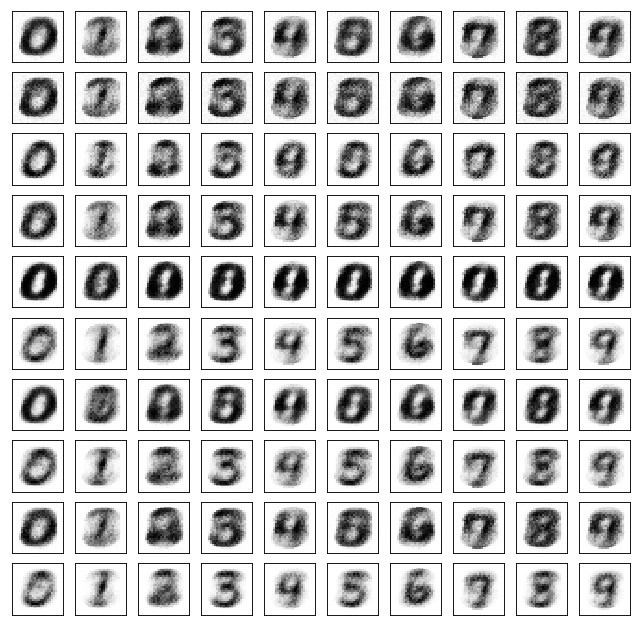

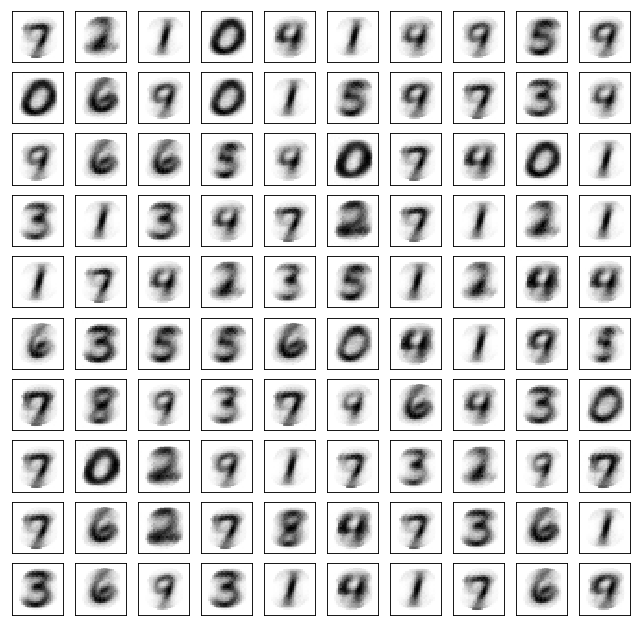

Test losses. E: 0.7987, AE: 0.2062, D: 0.6389
Train Epoch: 6 [0/50000 (0%)]	Losses E: 0.8337, AE: 0.2089, D: 0.6505
Train Epoch: 6 [25000/50000 (50%)]	Losses E: 0.6035, AE: 0.2066, D: 0.8523
Train Epoch: 6 [50000/50000 (100%)]	Losses E: 0.5782, AE: 0.1887, D: 0.7332


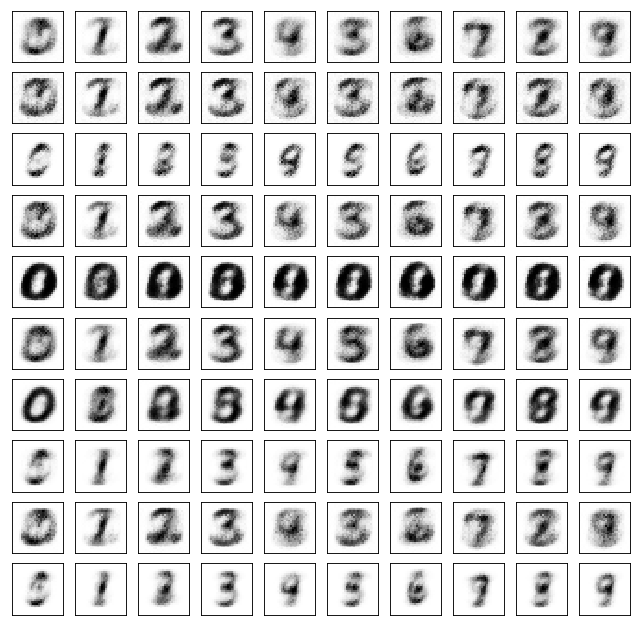

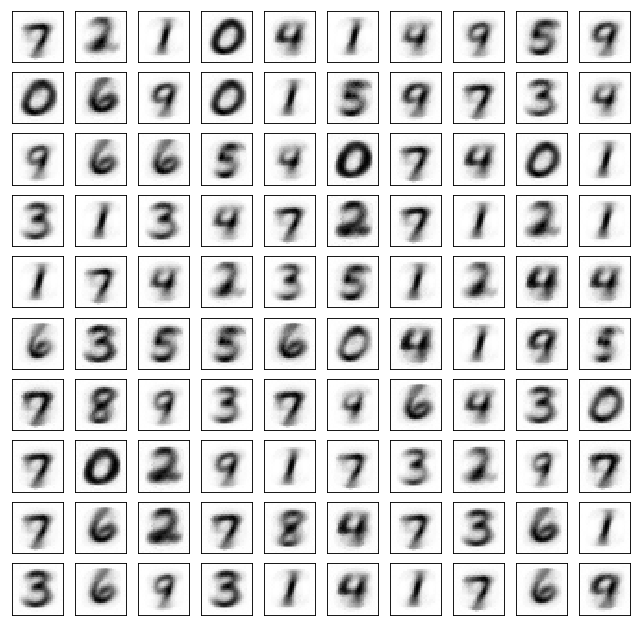

Test losses. E: 0.5757, AE: 0.2000, D: 0.7270
Train Epoch: 7 [0/50000 (0%)]	Losses E: 0.5763, AE: 0.2002, D: 0.7349
Train Epoch: 7 [25000/50000 (50%)]	Losses E: 0.5319, AE: 0.1963, D: 0.7382
Train Epoch: 7 [50000/50000 (100%)]	Losses E: 0.6468, AE: 0.1956, D: 0.7529


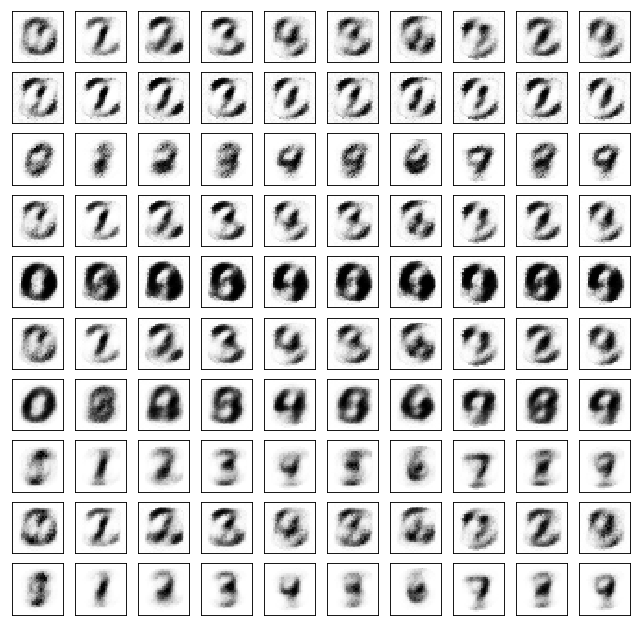

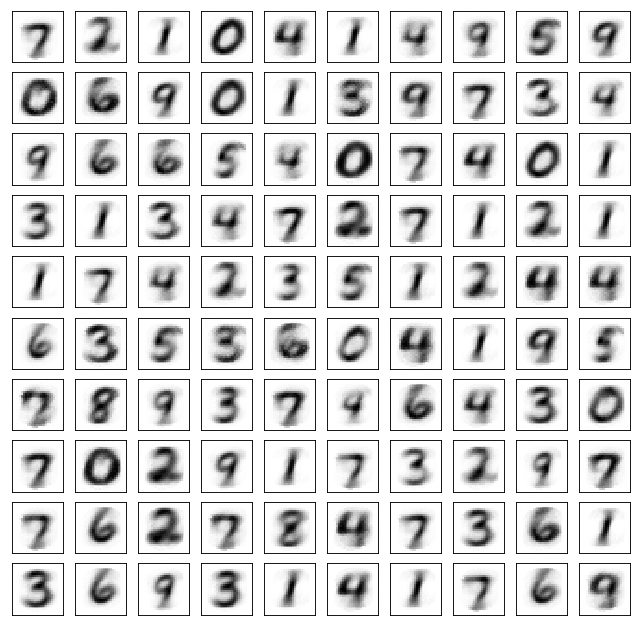

Test losses. E: 0.6441, AE: 0.1904, D: 0.7456
Train Epoch: 8 [0/50000 (0%)]	Losses E: 0.6480, AE: 0.1896, D: 0.7459
Train Epoch: 8 [25000/50000 (50%)]	Losses E: 0.7336, AE: 0.1835, D: 0.6921
Train Epoch: 8 [50000/50000 (100%)]	Losses E: 0.6419, AE: 0.1831, D: 0.7975


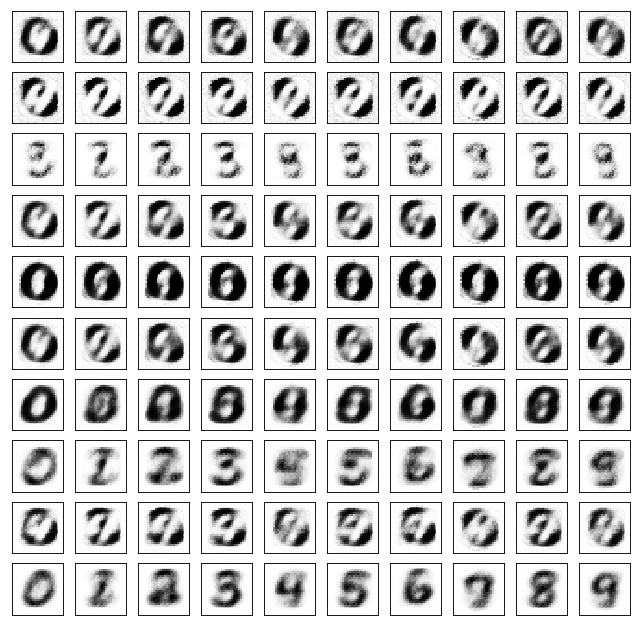

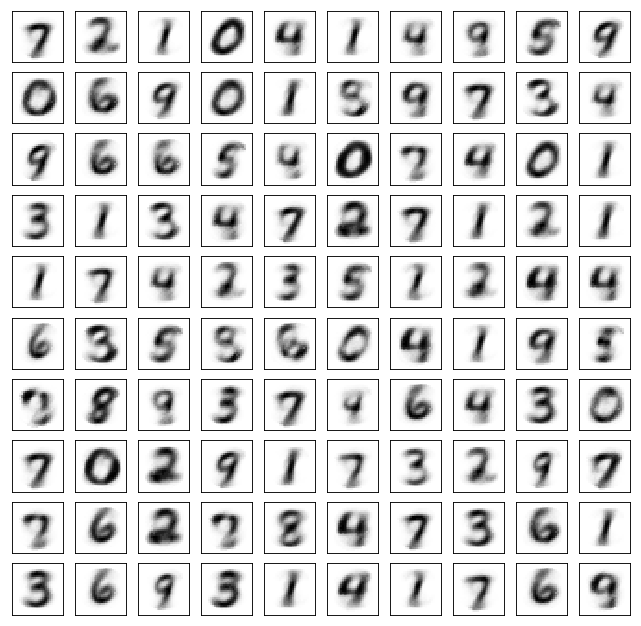

Test losses. E: 0.6338, AE: 0.1829, D: 0.7956
Train Epoch: 9 [0/50000 (0%)]	Losses E: 0.6474, AE: 0.1854, D: 0.7879
Train Epoch: 9 [25000/50000 (50%)]	Losses E: 0.6052, AE: 0.1813, D: 0.7001
Train Epoch: 9 [50000/50000 (100%)]	Losses E: 0.6740, AE: 0.1779, D: 0.6592


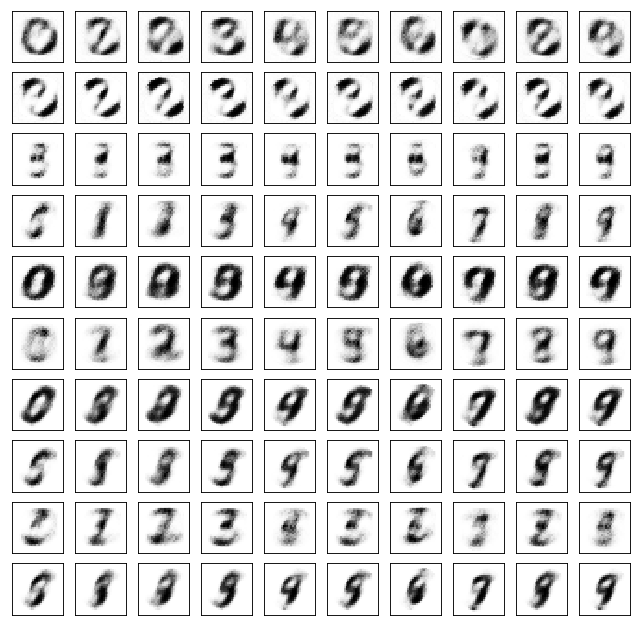

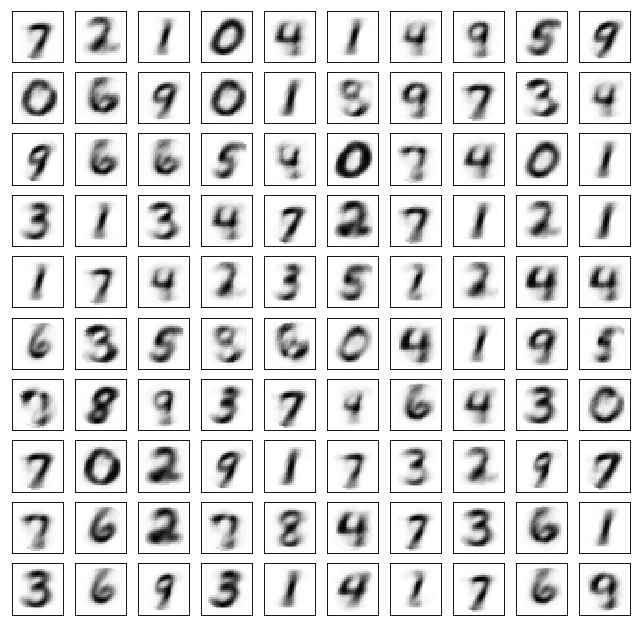

Test losses. E: 0.6576, AE: 0.1792, D: 0.6624
Train Epoch: 10 [0/50000 (0%)]	Losses E: 0.6703, AE: 0.1738, D: 0.6623
Train Epoch: 10 [25000/50000 (50%)]	Losses E: 0.8062, AE: 0.1858, D: 0.7690
Train Epoch: 10 [50000/50000 (100%)]	Losses E: 0.6540, AE: 0.1688, D: 0.7080


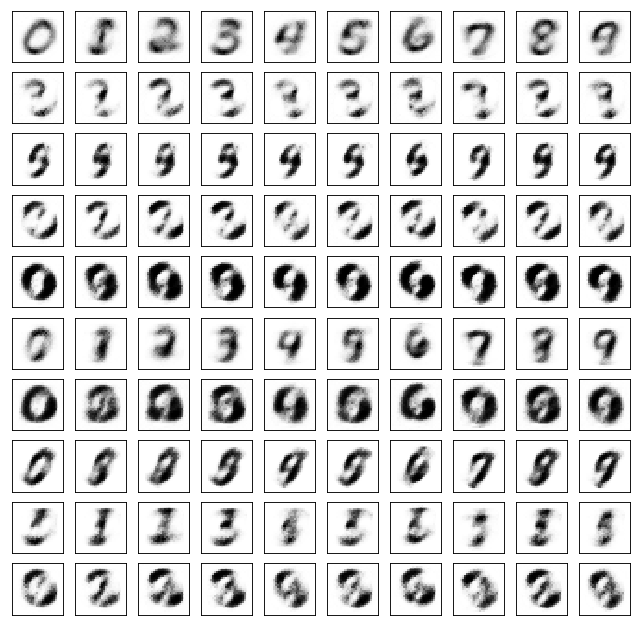

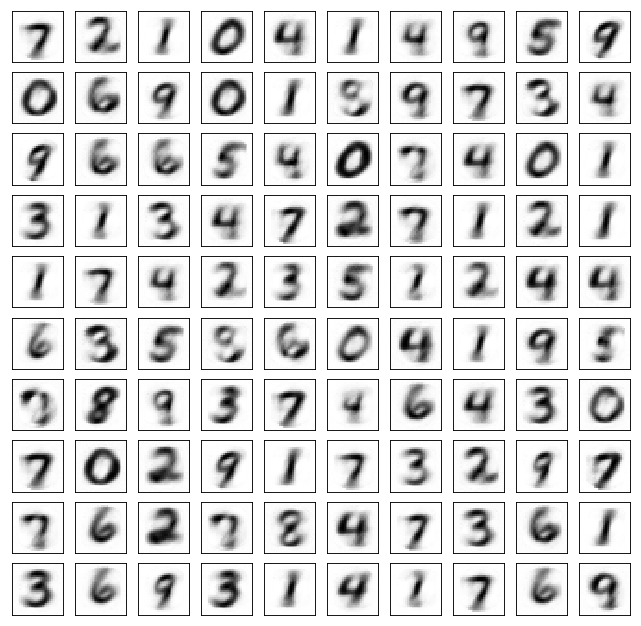

Test losses. E: 0.6481, AE: 0.1761, D: 0.7060
Train Epoch: 11 [0/50000 (0%)]	Losses E: 0.6497, AE: 0.1762, D: 0.7080
Train Epoch: 11 [25000/50000 (50%)]	Losses E: 0.6235, AE: 0.1684, D: 0.7312
Train Epoch: 11 [50000/50000 (100%)]	Losses E: 0.6332, AE: 0.1817, D: 0.7533


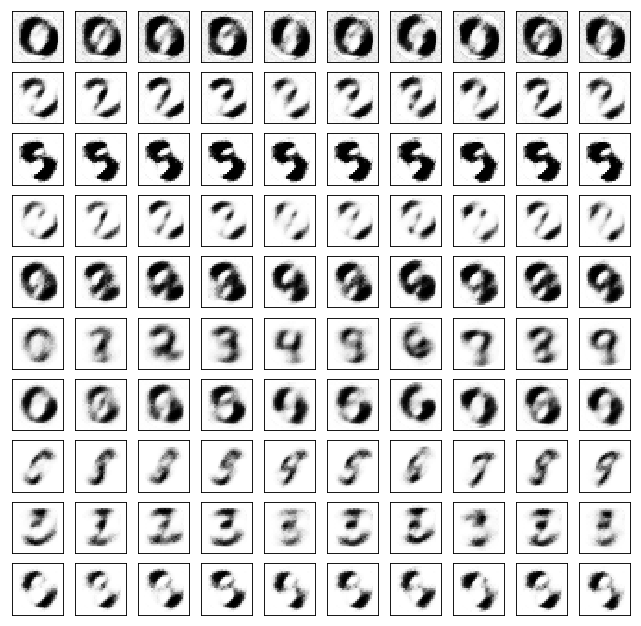

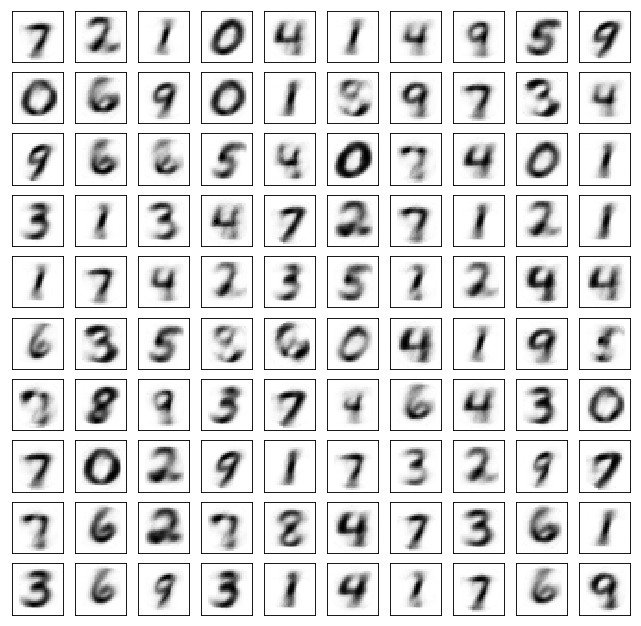

Test losses. E: 0.6318, AE: 0.1713, D: 0.7519
Train Epoch: 12 [0/50000 (0%)]	Losses E: 0.6331, AE: 0.1715, D: 0.7581
Train Epoch: 12 [25000/50000 (50%)]	Losses E: 0.5979, AE: 0.1630, D: 0.7244
Train Epoch: 12 [50000/50000 (100%)]	Losses E: 0.6882, AE: 0.1577, D: 0.6615


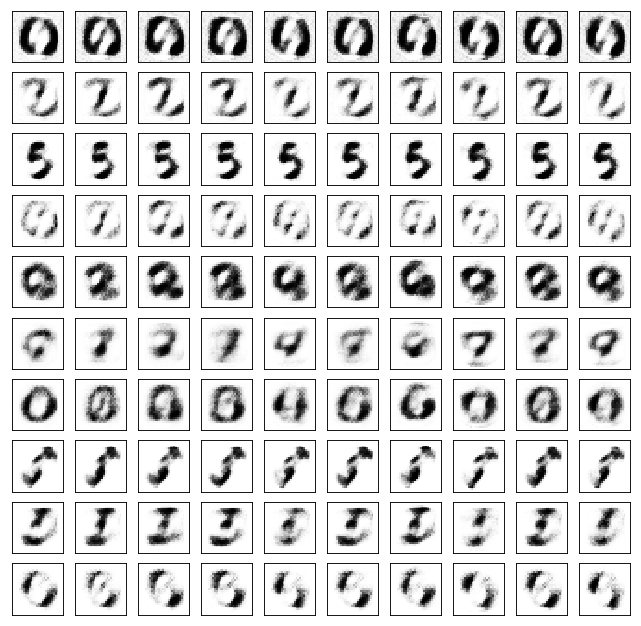

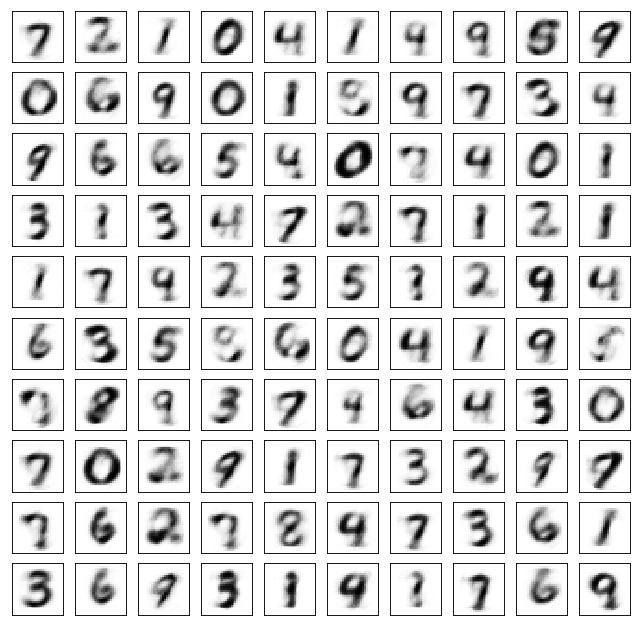

Test losses. E: 0.6644, AE: 0.1602, D: 0.6638
Train Epoch: 13 [0/50000 (0%)]	Losses E: 0.6922, AE: 0.1615, D: 0.6597
Train Epoch: 13 [25000/50000 (50%)]	Losses E: 0.6407, AE: 0.1637, D: 0.7641
Train Epoch: 13 [50000/50000 (100%)]	Losses E: 0.5448, AE: 0.1641, D: 0.7545


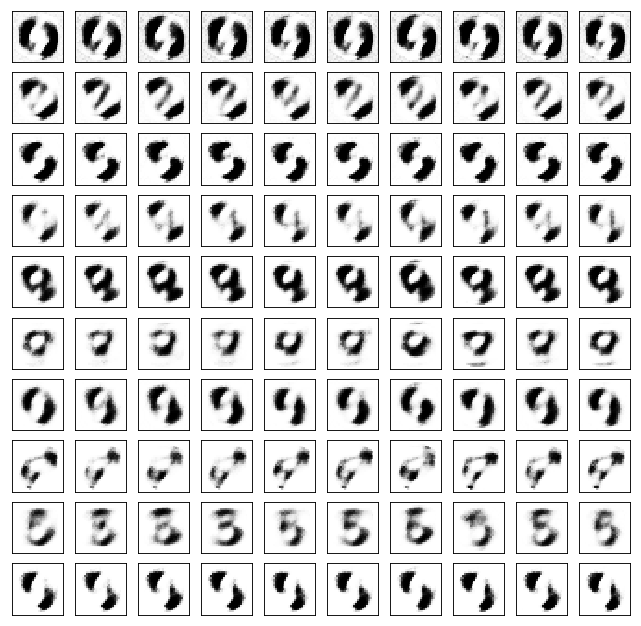

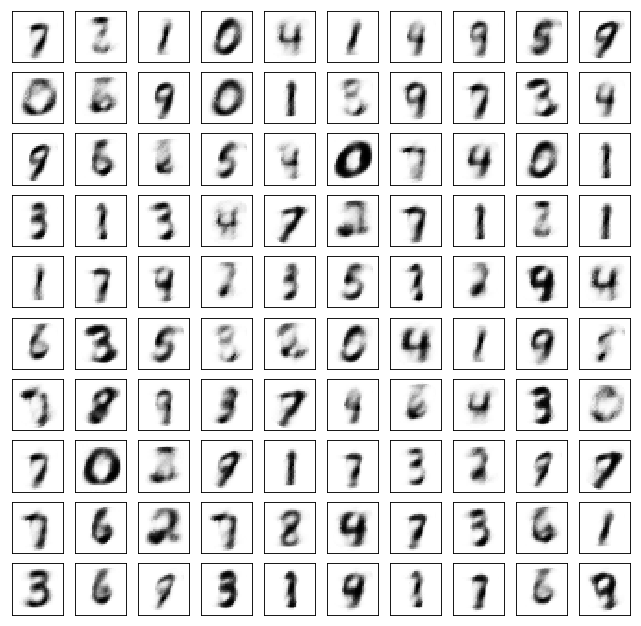

Test losses. E: 0.5333, AE: 0.1677, D: 0.7549
Train Epoch: 14 [0/50000 (0%)]	Losses E: 0.5435, AE: 0.1608, D: 0.7636
Train Epoch: 14 [25000/50000 (50%)]	Losses E: 0.6731, AE: 0.1537, D: 0.7494
Train Epoch: 14 [50000/50000 (100%)]	Losses E: 0.5932, AE: 0.1509, D: 0.7100


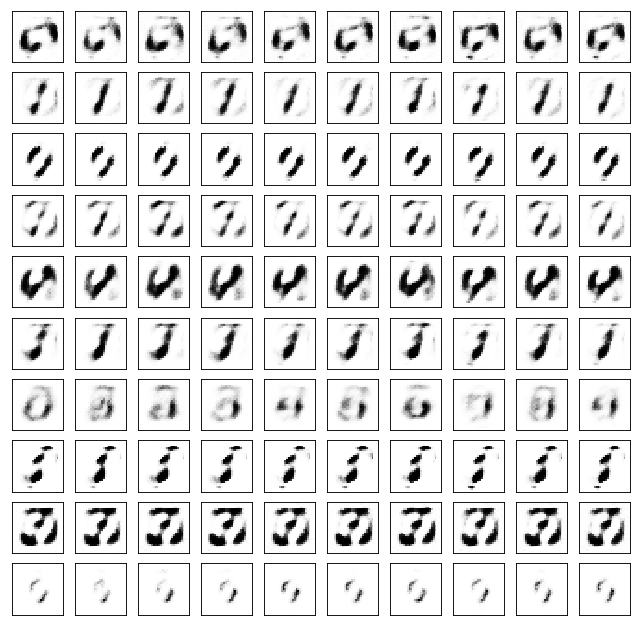

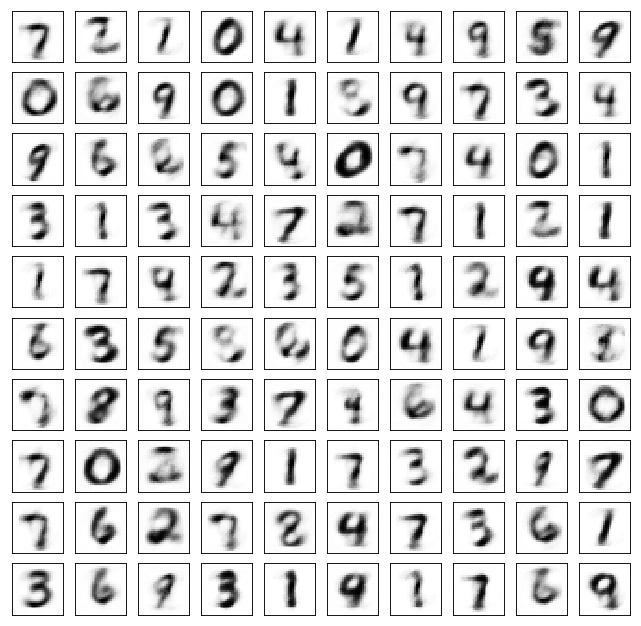

Test losses. E: 0.5897, AE: 0.1508, D: 0.7097
Train Epoch: 15 [0/50000 (0%)]	Losses E: 0.5897, AE: 0.1466, D: 0.7120
Train Epoch: 15 [25000/50000 (50%)]	Losses E: 0.7079, AE: 0.1637, D: 0.6805
Train Epoch: 15 [50000/50000 (100%)]	Losses E: 0.6871, AE: 0.1396, D: 0.7471


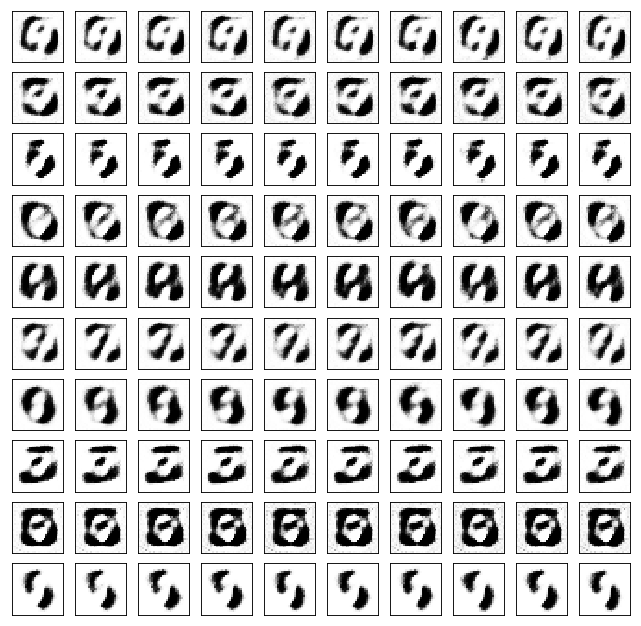

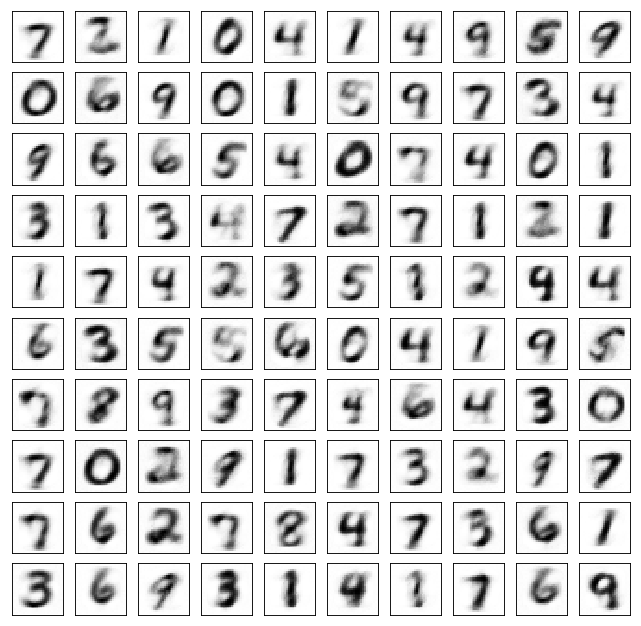

Test losses. E: 0.6859, AE: 0.1460, D: 0.7432
Train Epoch: 16 [0/50000 (0%)]	Losses E: 0.6846, AE: 0.1416, D: 0.7477
Train Epoch: 16 [25000/50000 (50%)]	Losses E: 0.7034, AE: 0.1382, D: 0.6616
Train Epoch: 16 [50000/50000 (100%)]	Losses E: 0.6688, AE: 0.1593, D: 0.7603


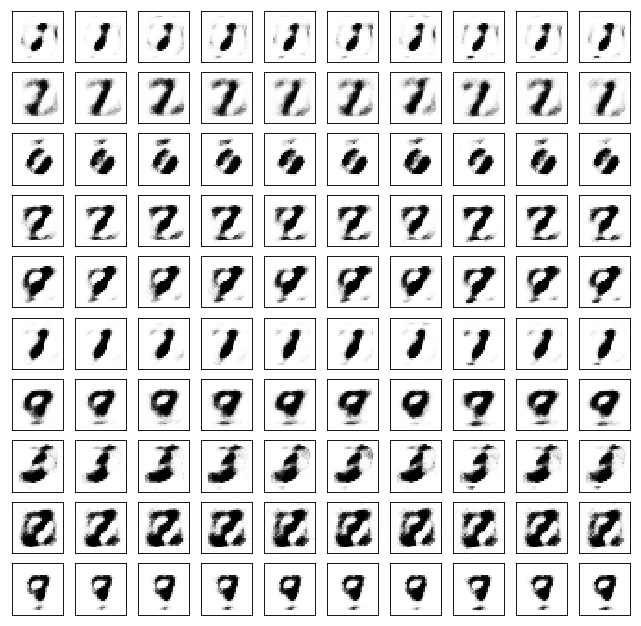

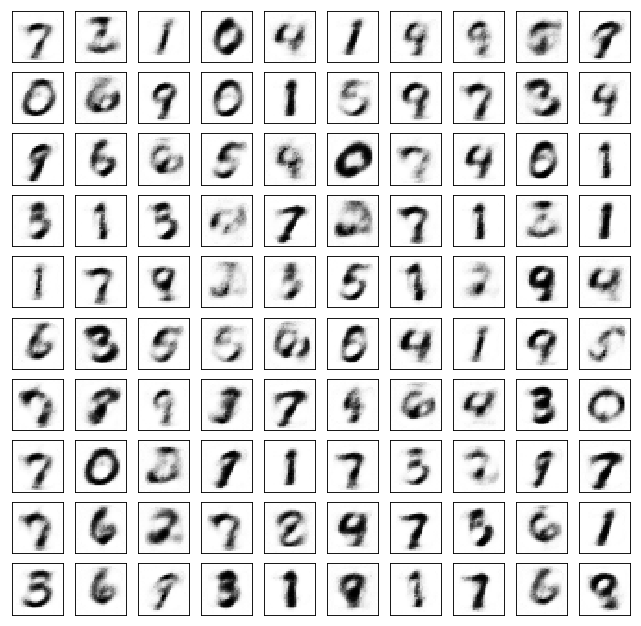

Test losses. E: 0.6494, AE: 0.1523, D: 0.7586
Train Epoch: 17 [0/50000 (0%)]	Losses E: 0.6656, AE: 0.1510, D: 0.7669
Train Epoch: 17 [25000/50000 (50%)]	Losses E: 0.6733, AE: 0.1357, D: 0.7205
Train Epoch: 17 [50000/50000 (100%)]	Losses E: 0.6275, AE: 0.1404, D: 0.6952


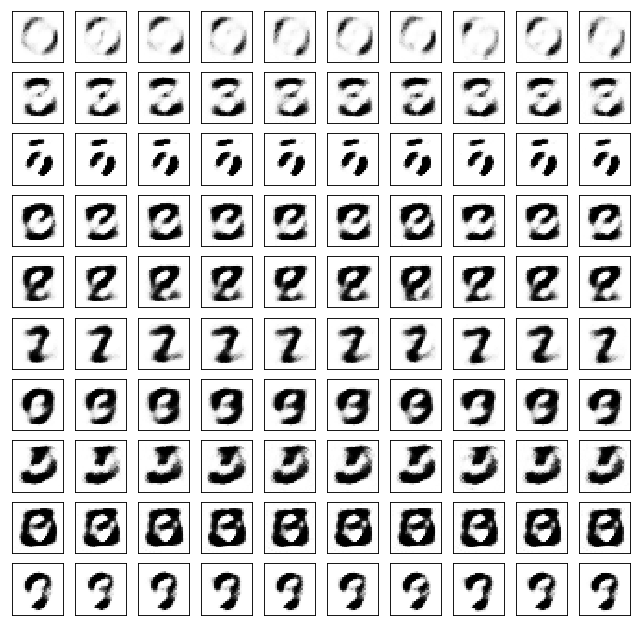

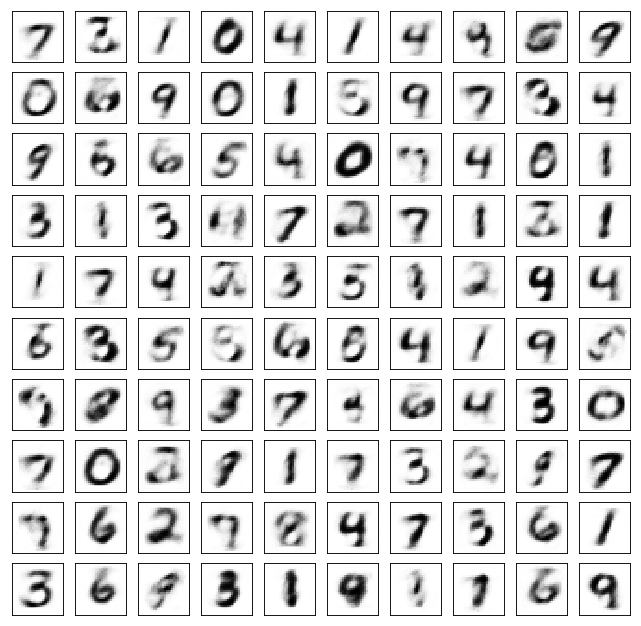

Test losses. E: 0.6188, AE: 0.1388, D: 0.6976
Train Epoch: 18 [0/50000 (0%)]	Losses E: 0.6203, AE: 0.1365, D: 0.6984
Train Epoch: 18 [25000/50000 (50%)]	Losses E: 0.8248, AE: 0.1462, D: 0.7484
Train Epoch: 18 [50000/50000 (100%)]	Losses E: 0.6368, AE: 0.1361, D: 0.6991


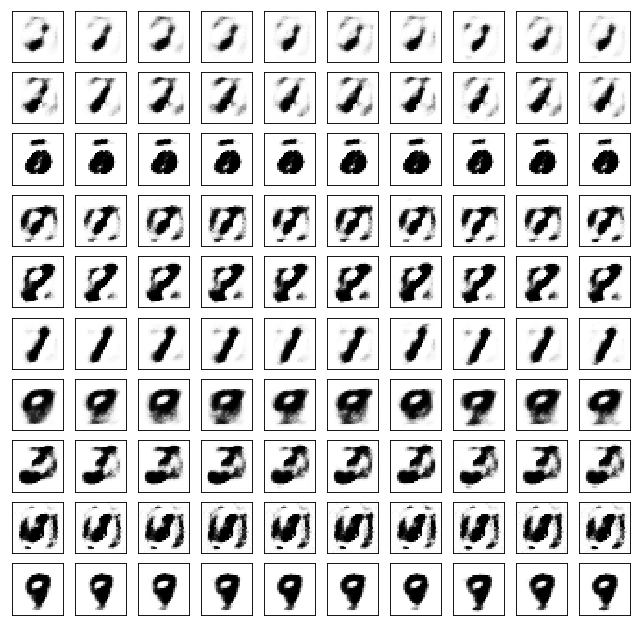

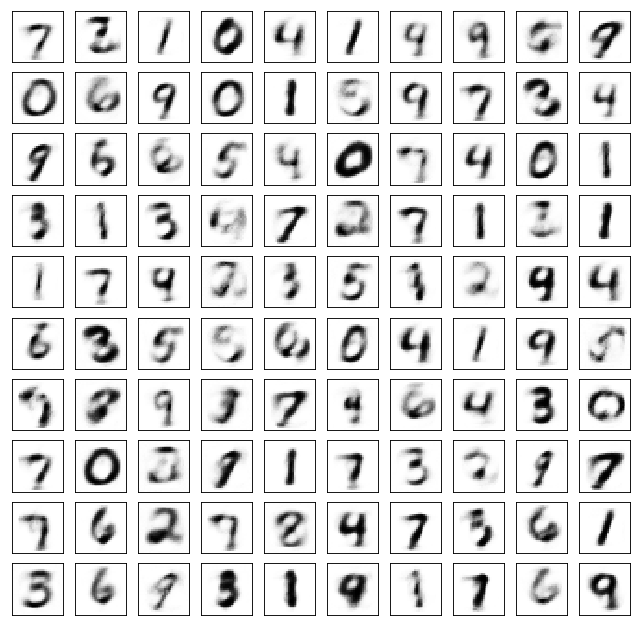

Test losses. E: 0.6364, AE: 0.1311, D: 0.6969
Train Epoch: 19 [0/50000 (0%)]	Losses E: 0.6367, AE: 0.1282, D: 0.6981
Train Epoch: 19 [25000/50000 (50%)]	Losses E: 0.9611, AE: 0.1470, D: 0.6021
Train Epoch: 19 [50000/50000 (100%)]	Losses E: 0.7141, AE: 0.1284, D: 0.7376


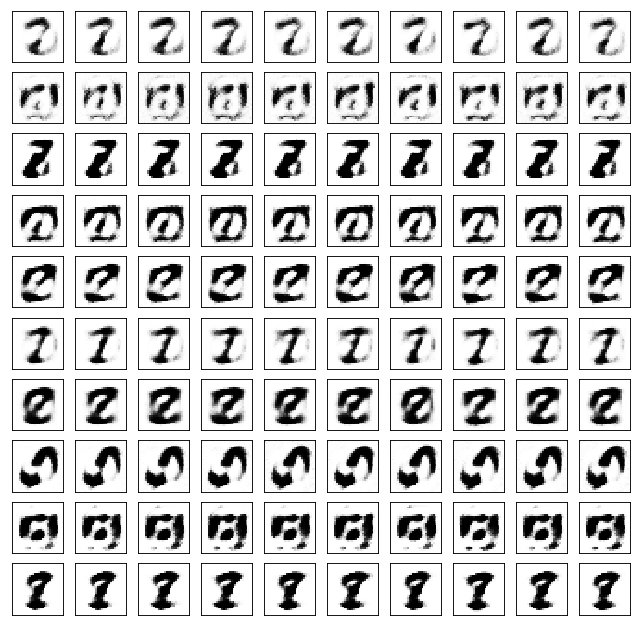

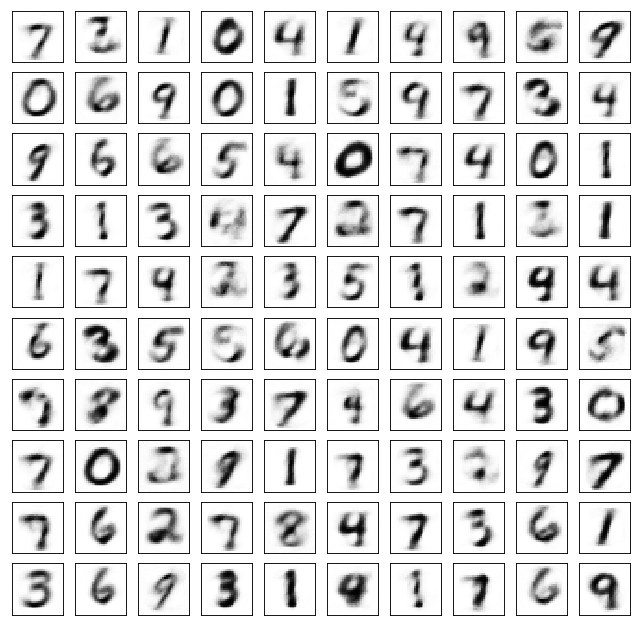

Test losses. E: 0.7142, AE: 0.1308, D: 0.7386
Train Epoch: 20 [0/50000 (0%)]	Losses E: 0.7129, AE: 0.1331, D: 0.7394
Train Epoch: 20 [25000/50000 (50%)]	Losses E: 0.6863, AE: 0.1289, D: 0.6552
Train Epoch: 20 [50000/50000 (100%)]	Losses E: 0.7471, AE: 0.2397, D: 0.8020


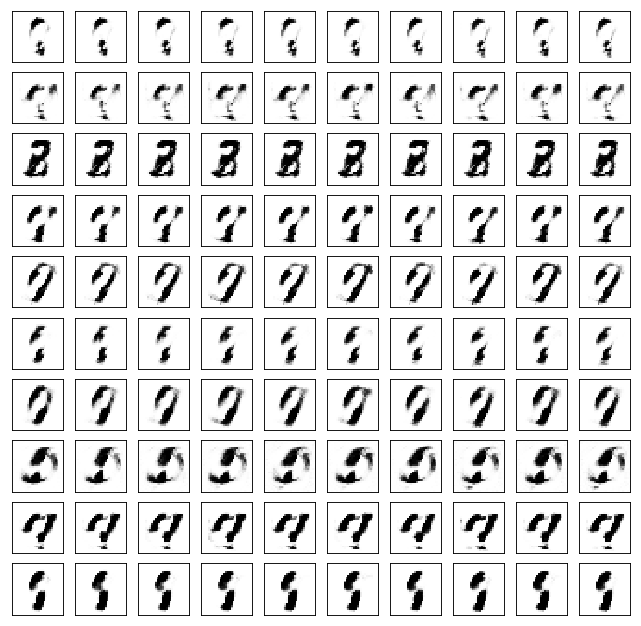

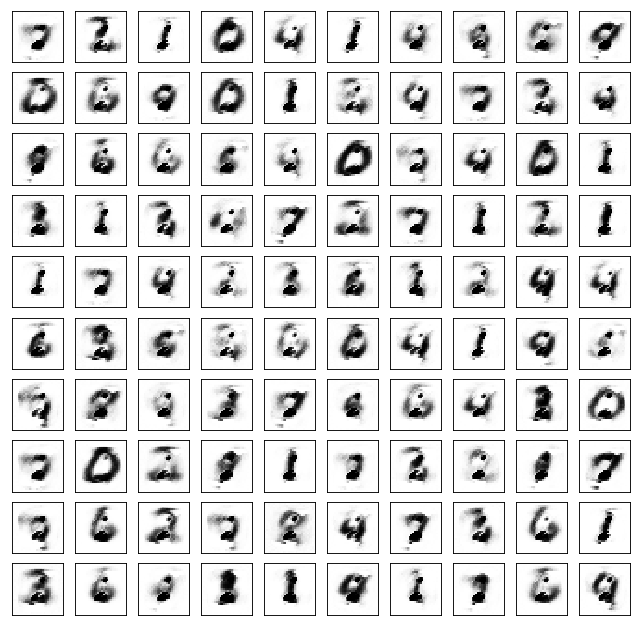

Test losses. E: 0.7452, AE: 0.2421, D: 0.7947
Train Epoch: 21 [0/50000 (0%)]	Losses E: 0.7473, AE: 0.2331, D: 0.7938
Train Epoch: 21 [25000/50000 (50%)]	Losses E: 0.6617, AE: 0.1300, D: 0.6858
Train Epoch: 21 [50000/50000 (100%)]	Losses E: 0.9926, AE: 0.1765, D: 0.6740


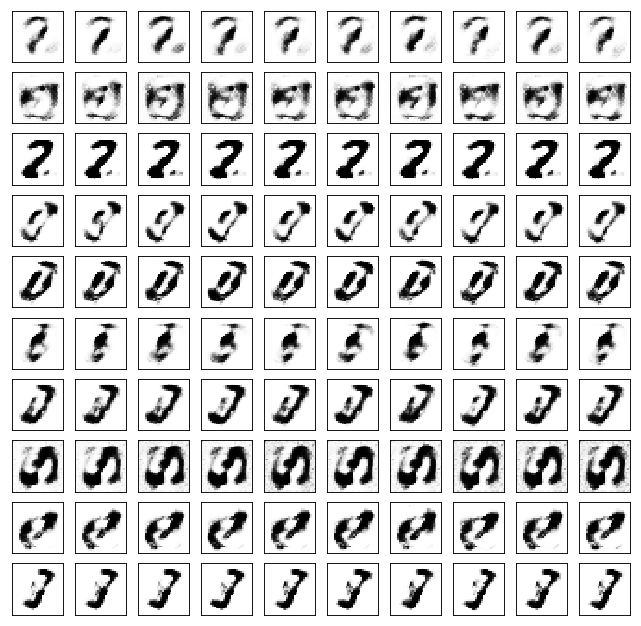

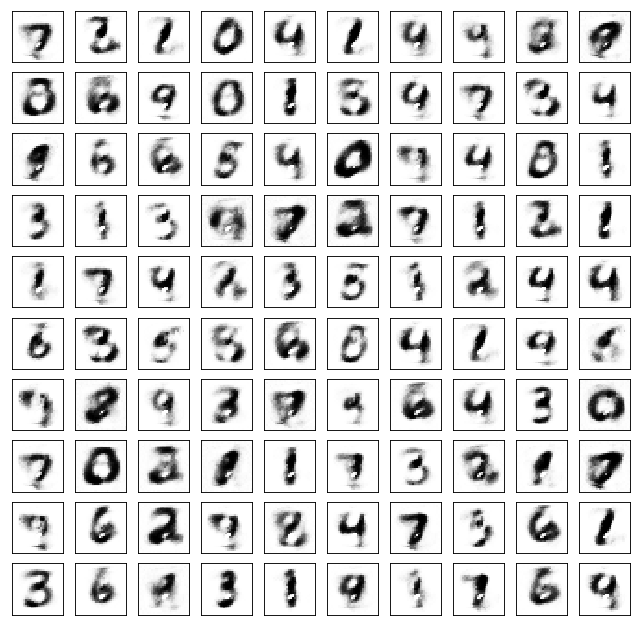

Test losses. E: 0.9037, AE: 0.1806, D: 0.6821
Train Epoch: 22 [0/50000 (0%)]	Losses E: 0.9811, AE: 0.1810, D: 0.6827
Train Epoch: 22 [25000/50000 (50%)]	Losses E: 0.6715, AE: 0.1336, D: 0.7053
Train Epoch: 22 [50000/50000 (100%)]	Losses E: 0.7409, AE: 0.2182, D: 0.7432


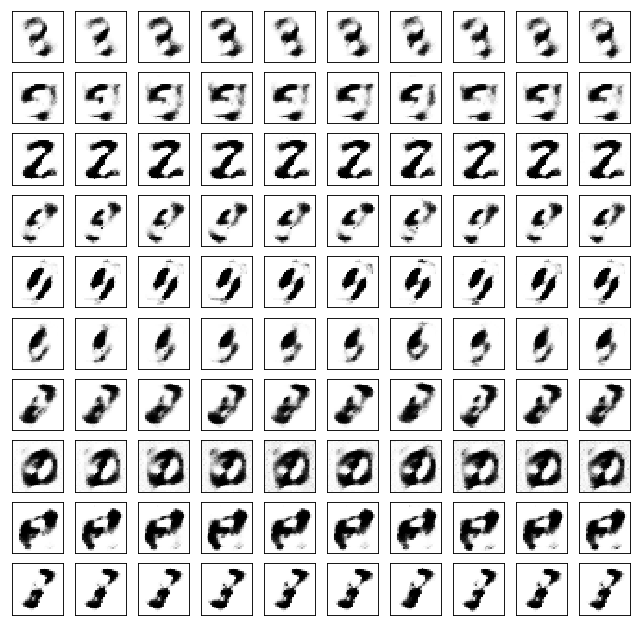

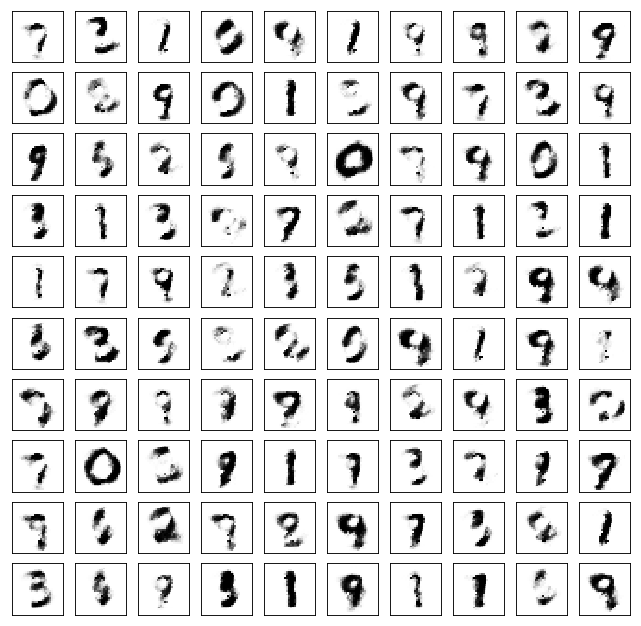

Test losses. E: 0.6566, AE: 0.2124, D: 0.7443
Train Epoch: 23 [0/50000 (0%)]	Losses E: 0.7433, AE: 0.2073, D: 0.7469
Train Epoch: 23 [25000/50000 (50%)]	Losses E: 0.7137, AE: 0.1236, D: 0.7049
Train Epoch: 23 [50000/50000 (100%)]	Losses E: 0.6530, AE: 0.1462, D: 0.6739


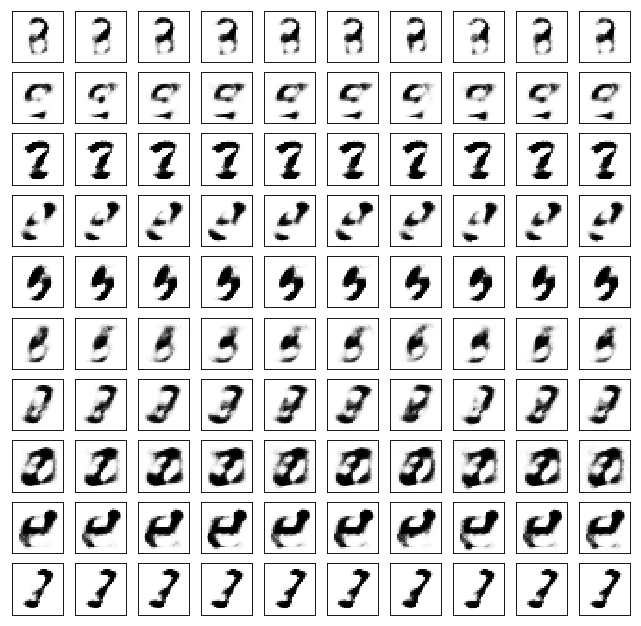

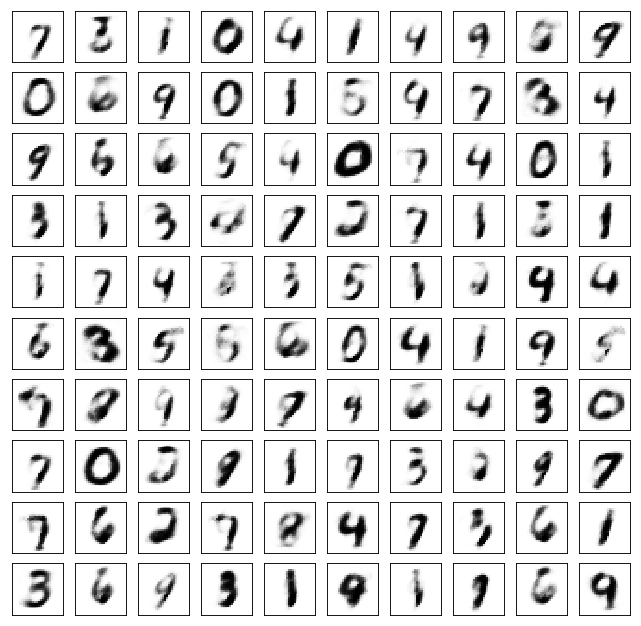

Test losses. E: 0.6410, AE: 0.1498, D: 0.6740
Train Epoch: 24 [0/50000 (0%)]	Losses E: 0.6466, AE: 0.1491, D: 0.6798
Train Epoch: 24 [25000/50000 (50%)]	Losses E: 0.8171, AE: 0.1438, D: 0.7283
Train Epoch: 24 [50000/50000 (100%)]	Losses E: 0.6606, AE: 0.1303, D: 0.6774


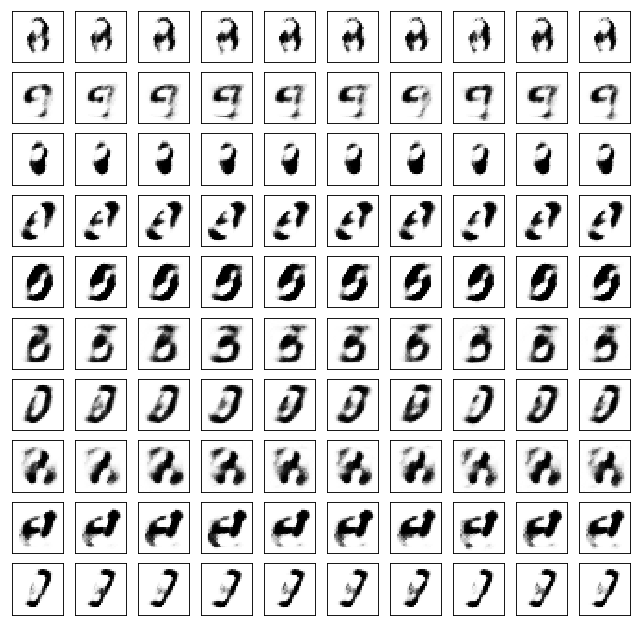

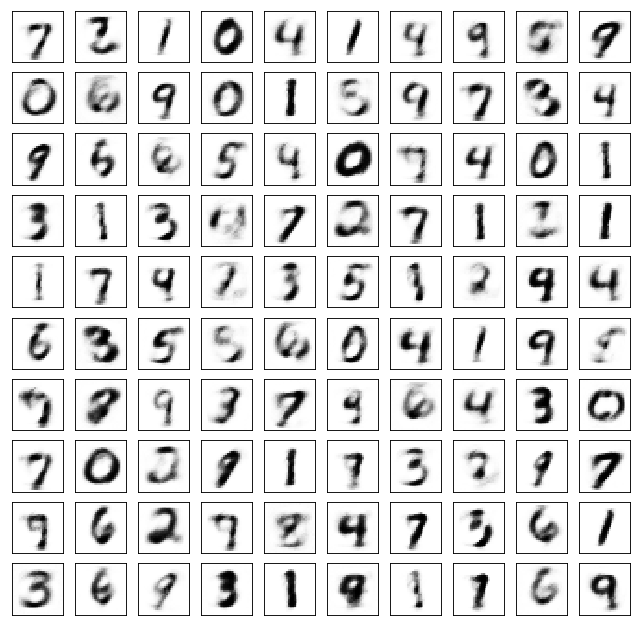

Test losses. E: 0.6570, AE: 0.1293, D: 0.6758
Train Epoch: 25 [0/50000 (0%)]	Losses E: 0.6581, AE: 0.1328, D: 0.6737
Train Epoch: 25 [25000/50000 (50%)]	Losses E: 0.7635, AE: 0.1559, D: 0.6957
Train Epoch: 25 [50000/50000 (100%)]	Losses E: 0.6490, AE: 0.1261, D: 0.7068


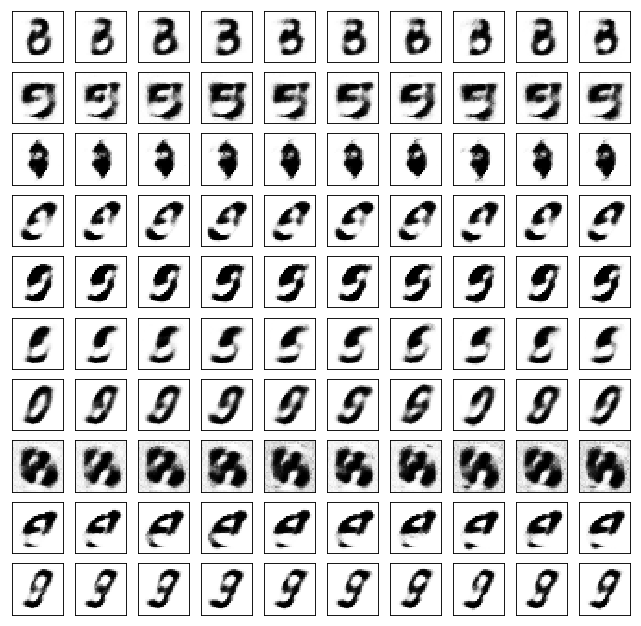

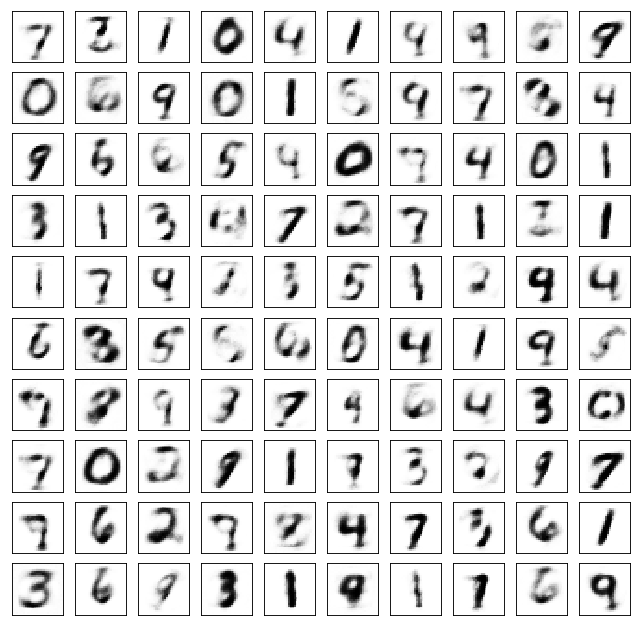

Test losses. E: 0.6458, AE: 0.1310, D: 0.7019
Train Epoch: 26 [0/50000 (0%)]	Losses E: 0.6491, AE: 0.1259, D: 0.7022
Train Epoch: 26 [25000/50000 (50%)]	Losses E: 0.6203, AE: 0.1501, D: 0.7328
Train Epoch: 26 [50000/50000 (100%)]	Losses E: 0.7171, AE: 0.1328, D: 0.6983


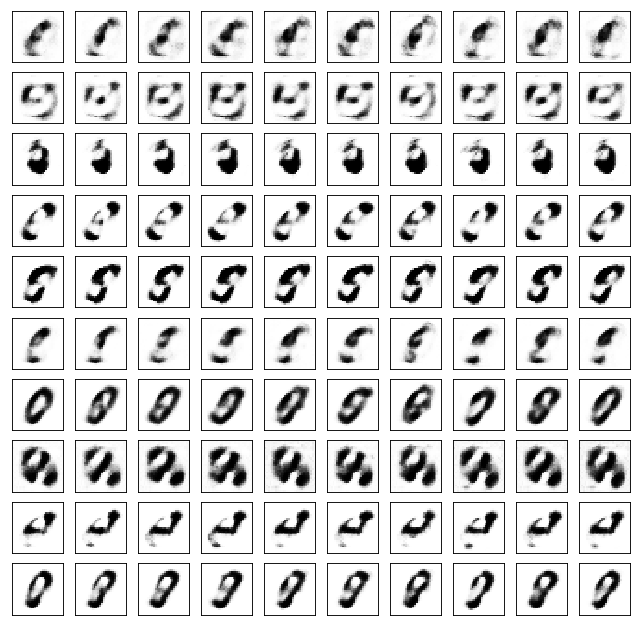

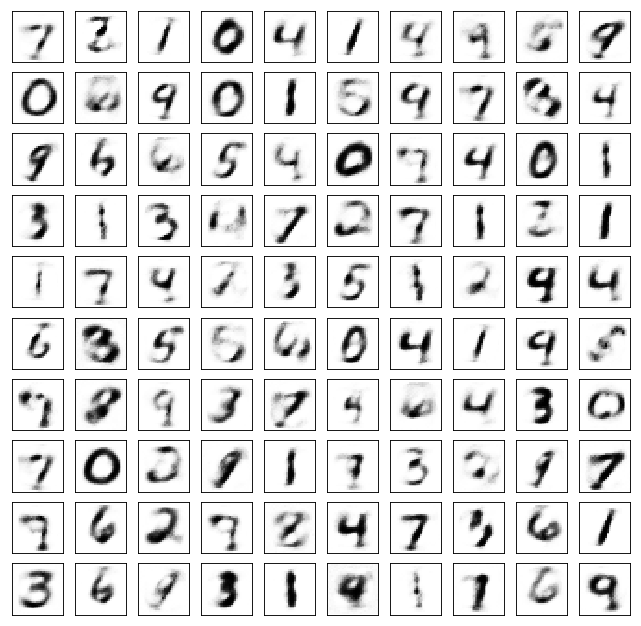

Test losses. E: 0.7091, AE: 0.1313, D: 0.6995
Train Epoch: 27 [0/50000 (0%)]	Losses E: 0.7139, AE: 0.1311, D: 0.6999
Train Epoch: 27 [25000/50000 (50%)]	Losses E: 0.7548, AE: 0.1331, D: 0.6783
Train Epoch: 27 [50000/50000 (100%)]	Losses E: 0.6730, AE: 0.1376, D: 0.7296


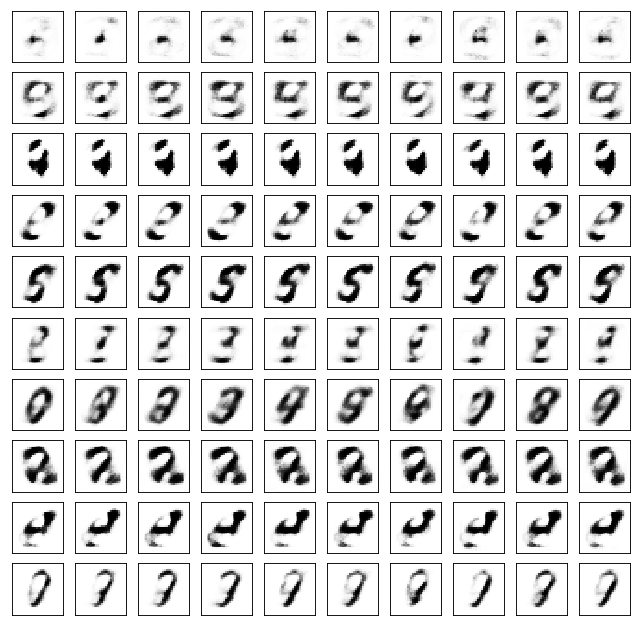

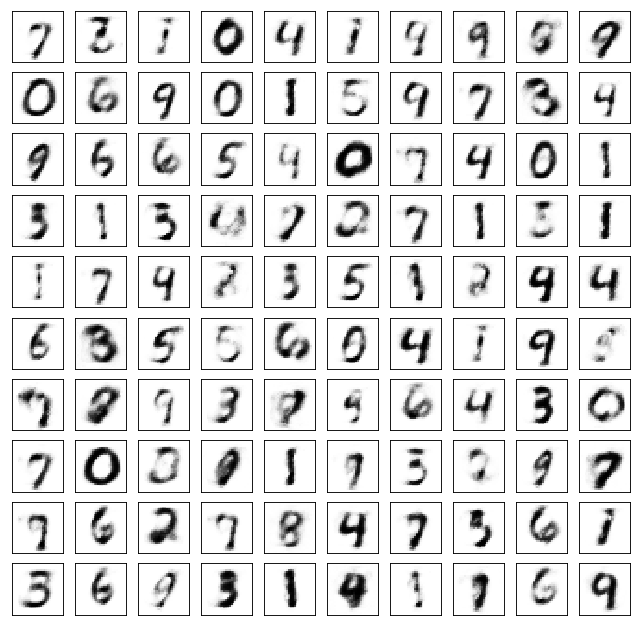

Test losses. E: 0.6672, AE: 0.1385, D: 0.7255
Train Epoch: 28 [0/50000 (0%)]	Losses E: 0.6811, AE: 0.1357, D: 0.7256
Train Epoch: 28 [25000/50000 (50%)]	Losses E: 0.7522, AE: 0.1362, D: 0.7089
Train Epoch: 28 [50000/50000 (100%)]	Losses E: 0.7280, AE: 0.1339, D: 0.6864


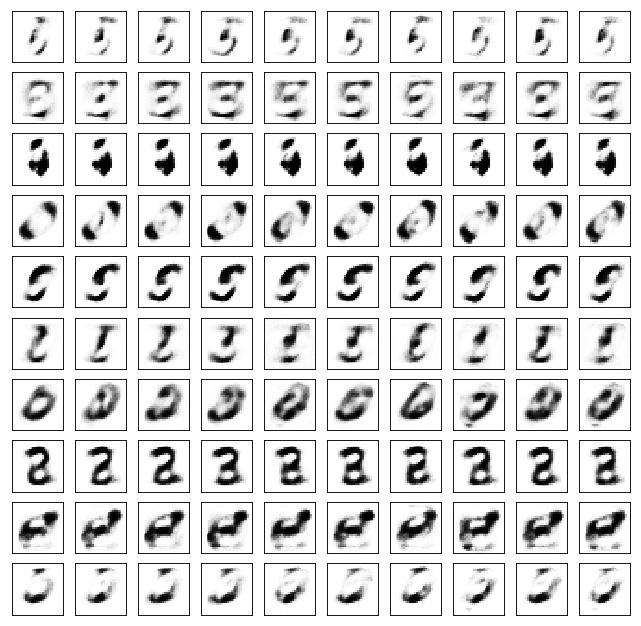

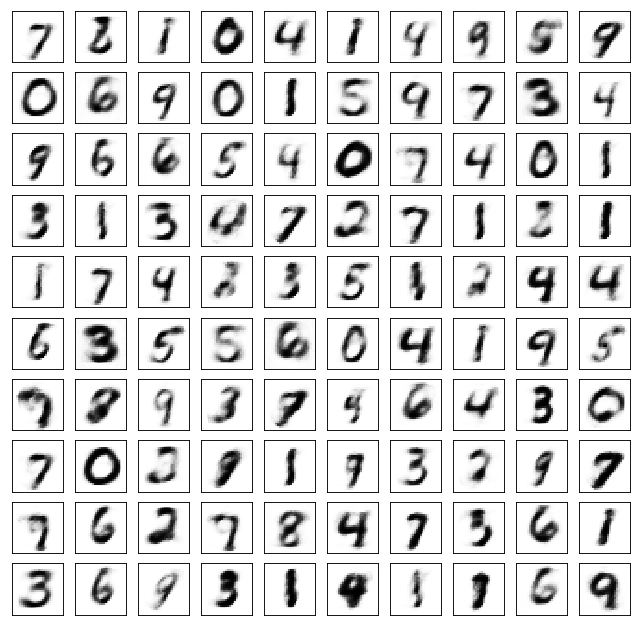

Test losses. E: 0.7183, AE: 0.1351, D: 0.6871
Train Epoch: 29 [0/50000 (0%)]	Losses E: 0.7279, AE: 0.1389, D: 0.6843
Train Epoch: 29 [25000/50000 (50%)]	Losses E: 0.6769, AE: 0.1272, D: 0.7115
Train Epoch: 29 [50000/50000 (100%)]	Losses E: 0.6707, AE: 0.1226, D: 0.7242


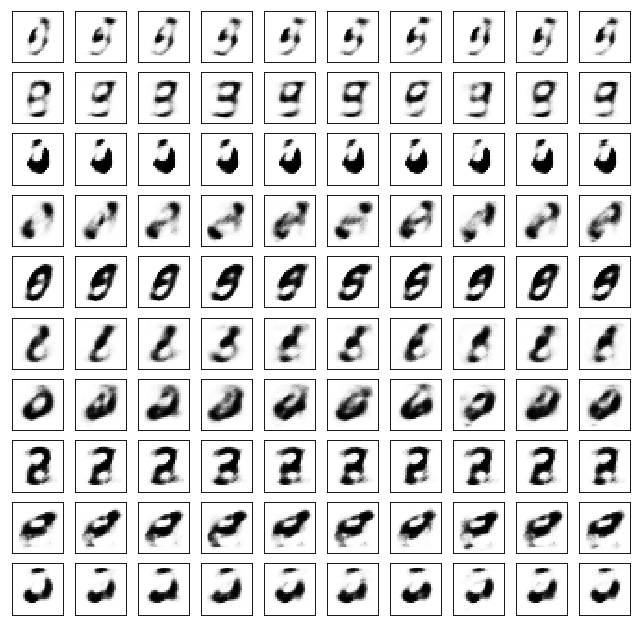

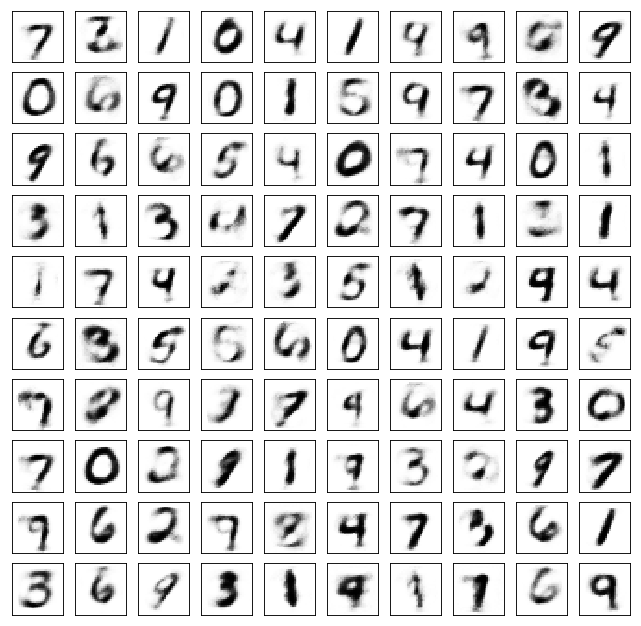

Test losses. E: 0.6685, AE: 0.1221, D: 0.7206
Train Epoch: 30 [0/50000 (0%)]	Losses E: 0.6737, AE: 0.1208, D: 0.7208
Train Epoch: 30 [25000/50000 (50%)]	Losses E: 0.6628, AE: 0.1186, D: 0.7081
Train Epoch: 30 [50000/50000 (100%)]	Losses E: 0.6956, AE: 0.1155, D: 0.7090


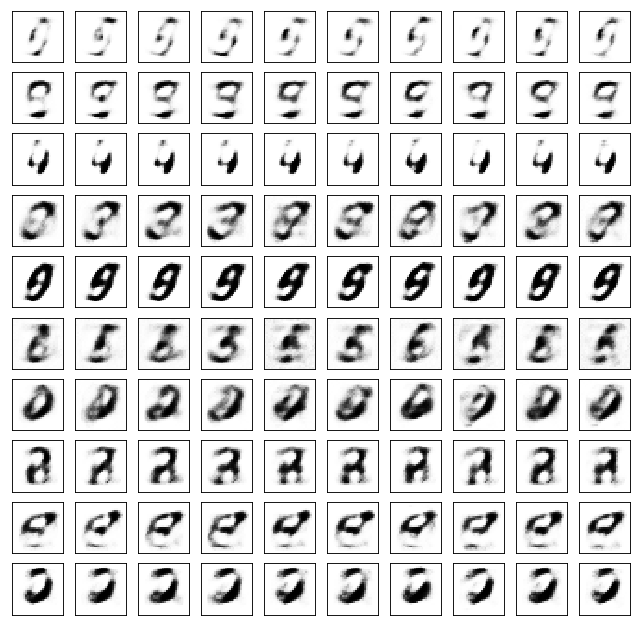

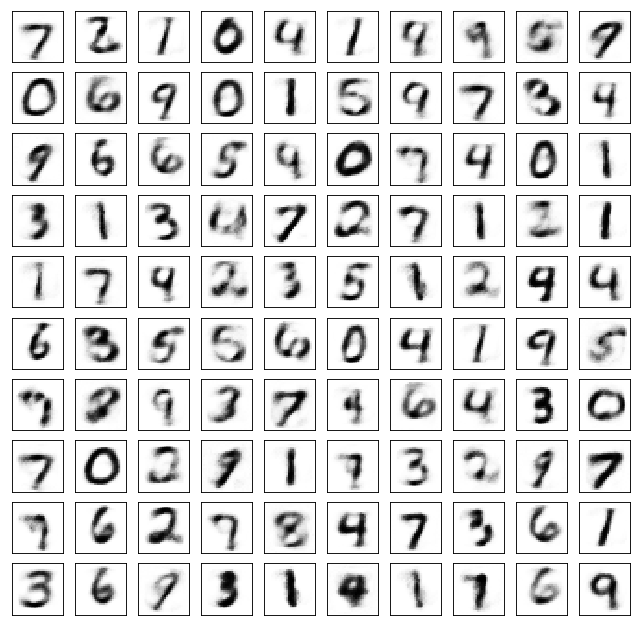

Test losses. E: 0.6927, AE: 0.1134, D: 0.7107
Train Epoch: 31 [0/50000 (0%)]	Losses E: 0.6955, AE: 0.1066, D: 0.7113
Train Epoch: 31 [25000/50000 (50%)]	Losses E: 0.6533, AE: 0.1028, D: 0.6965
Train Epoch: 31 [50000/50000 (100%)]	Losses E: 0.8368, AE: 0.1265, D: 0.6836


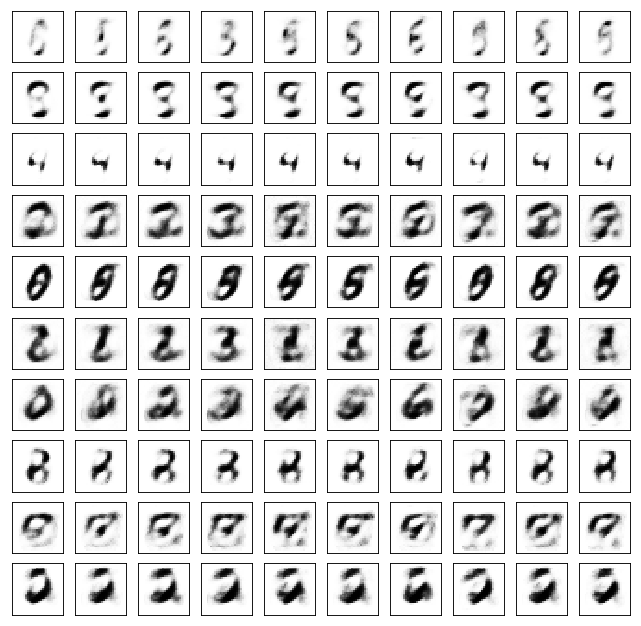

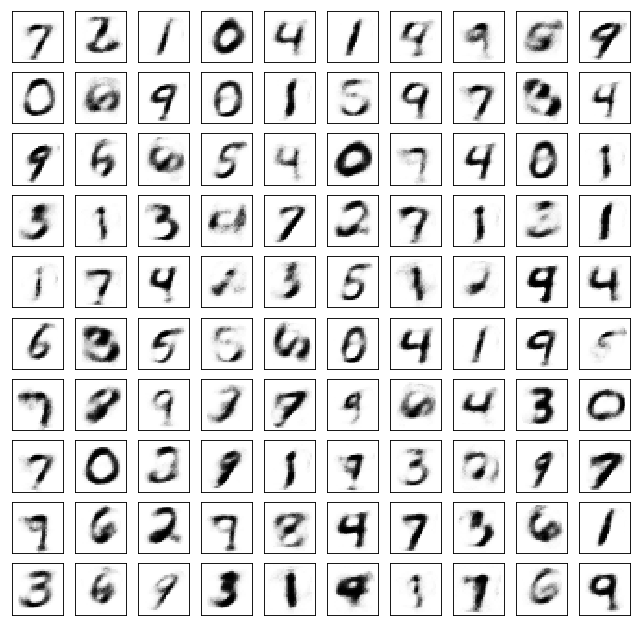

Test losses. E: 0.8192, AE: 0.1214, D: 0.6816
Train Epoch: 32 [0/50000 (0%)]	Losses E: 0.8467, AE: 0.1197, D: 0.6818
Train Epoch: 32 [25000/50000 (50%)]	Losses E: 0.6767, AE: 0.1061, D: 0.7012
Train Epoch: 32 [50000/50000 (100%)]	Losses E: 0.6592, AE: 0.1101, D: 0.7170


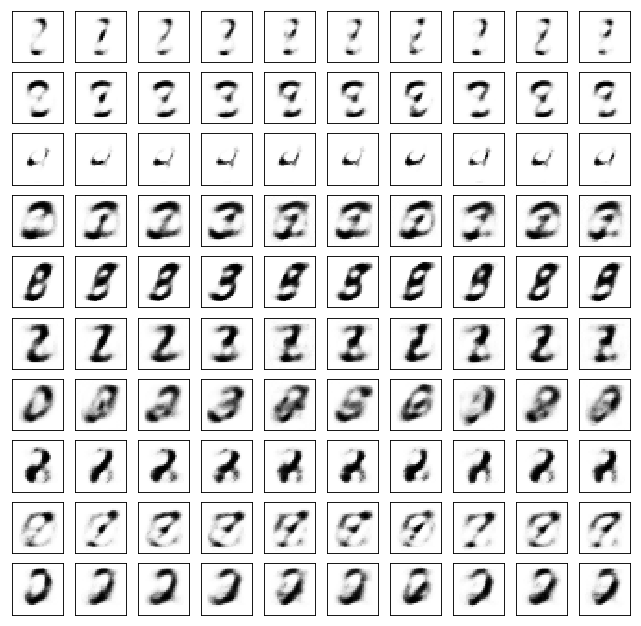

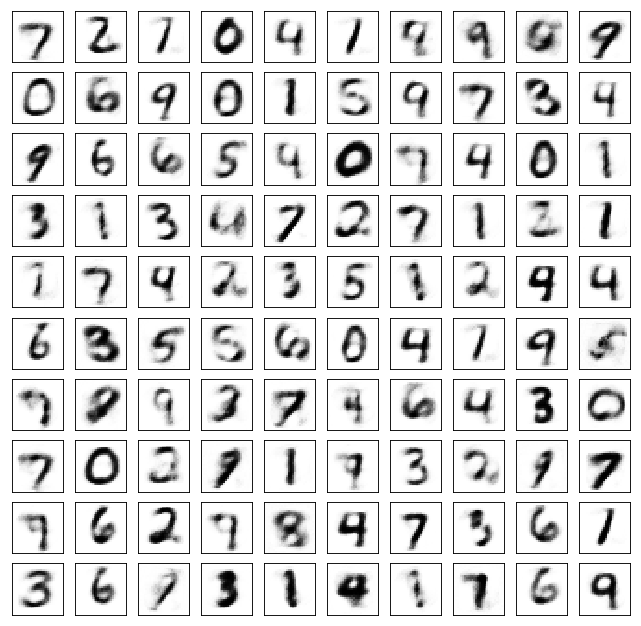

Test losses. E: 0.6483, AE: 0.1144, D: 0.7194
Train Epoch: 33 [0/50000 (0%)]	Losses E: 0.6535, AE: 0.1147, D: 0.7199
Train Epoch: 33 [25000/50000 (50%)]	Losses E: 0.6912, AE: 0.1043, D: 0.7042
Train Epoch: 33 [50000/50000 (100%)]	Losses E: 0.8229, AE: 0.1134, D: 0.6652


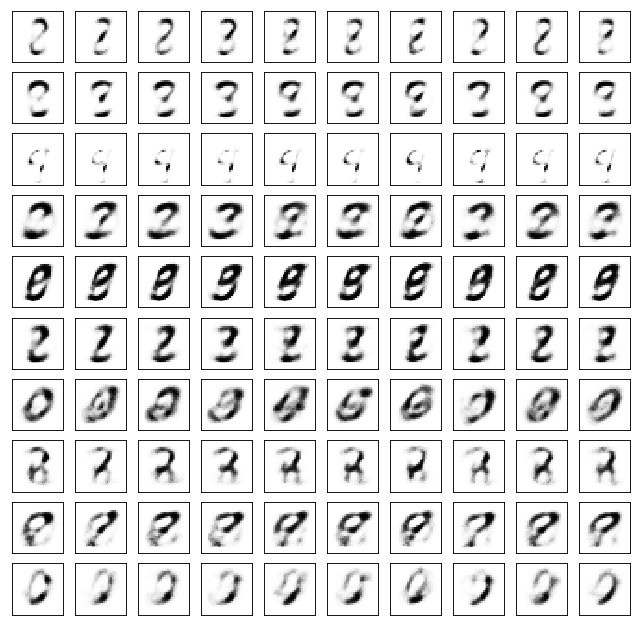

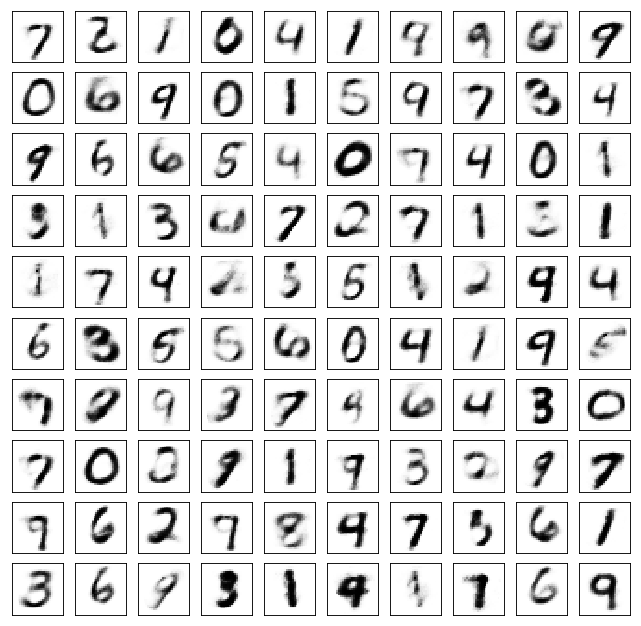

Test losses. E: 0.8015, AE: 0.1132, D: 0.6625
Train Epoch: 34 [0/50000 (0%)]	Losses E: 0.8383, AE: 0.1105, D: 0.6579
Train Epoch: 34 [25000/50000 (50%)]	Losses E: 0.6818, AE: 0.1034, D: 0.7033
Train Epoch: 34 [50000/50000 (100%)]	Losses E: 0.6817, AE: 0.1020, D: 0.6860


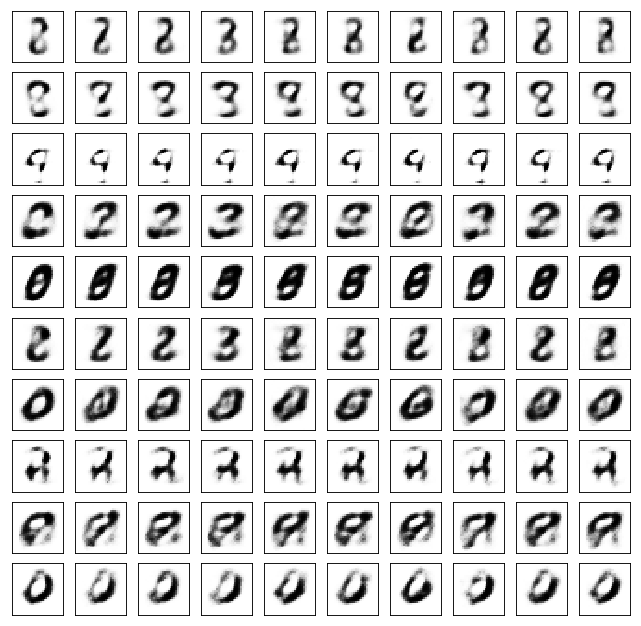

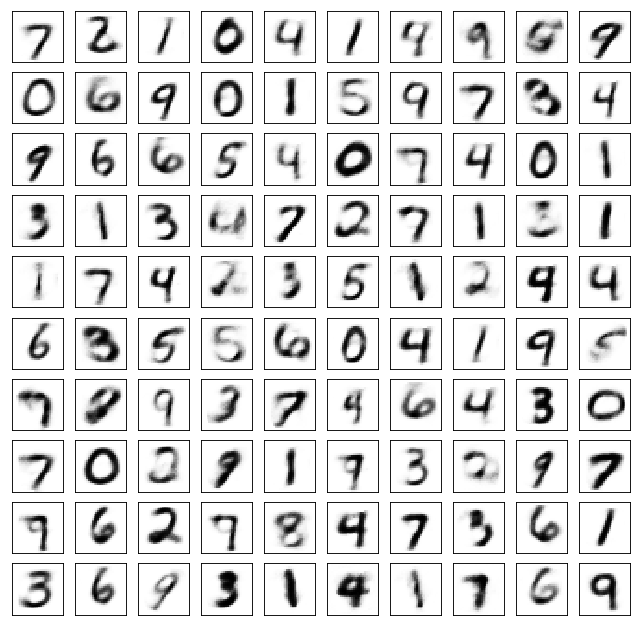

Test losses. E: 0.6793, AE: 0.1010, D: 0.6857
Train Epoch: 35 [0/50000 (0%)]	Losses E: 0.6818, AE: 0.0998, D: 0.6853
Train Epoch: 35 [25000/50000 (50%)]	Losses E: 0.7497, AE: 0.1017, D: 0.7020
Train Epoch: 35 [50000/50000 (100%)]	Losses E: 0.7091, AE: 0.1077, D: 0.6929


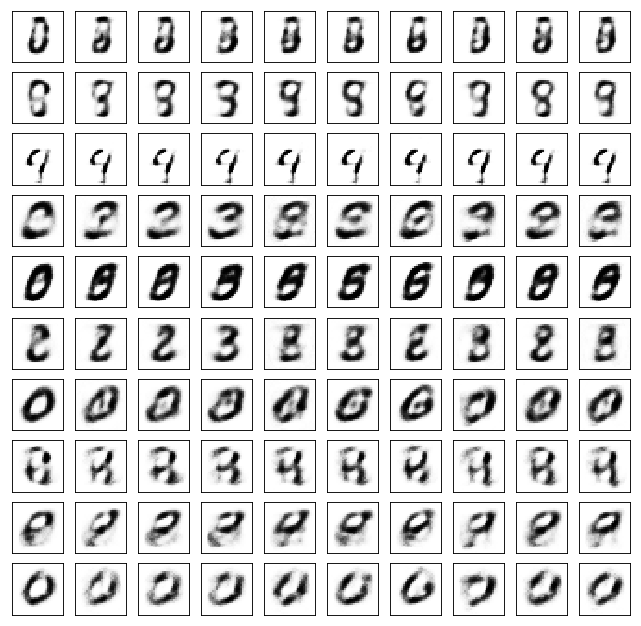

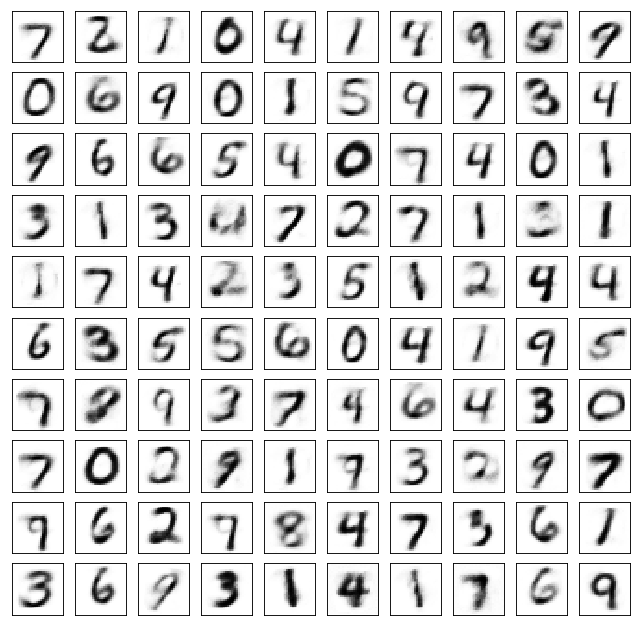

Test losses. E: 0.7039, AE: 0.1078, D: 0.6913
Train Epoch: 36 [0/50000 (0%)]	Losses E: 0.7079, AE: 0.1107, D: 0.6880
Train Epoch: 36 [25000/50000 (50%)]	Losses E: 0.6657, AE: 0.1002, D: 0.7022
Train Epoch: 36 [50000/50000 (100%)]	Losses E: 0.9153, AE: 0.1315, D: 0.6991


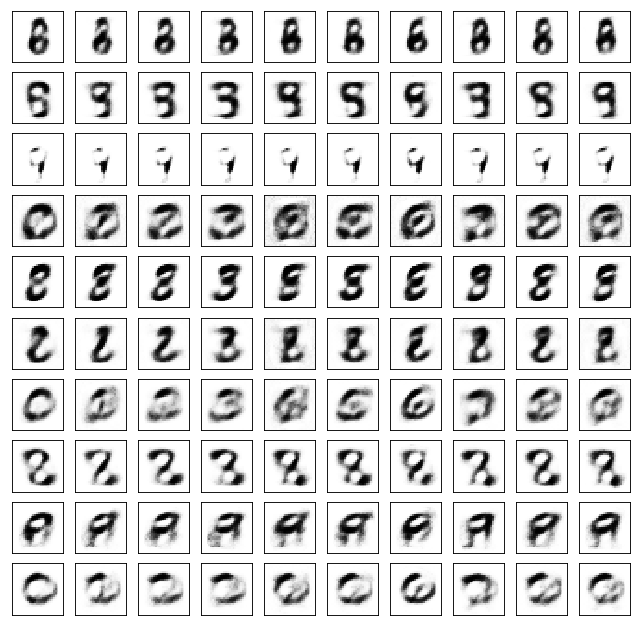

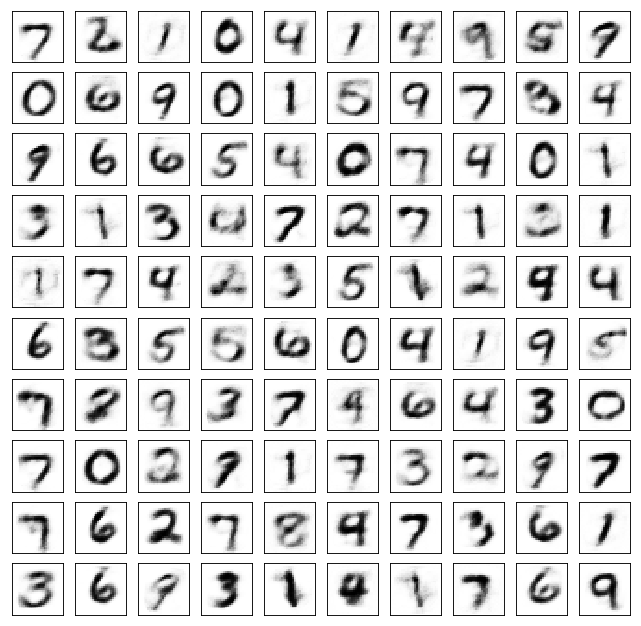

Test losses. E: 0.8742, AE: 0.1281, D: 0.7107
Train Epoch: 37 [0/50000 (0%)]	Losses E: 0.8855, AE: 0.1318, D: 0.7117
Train Epoch: 37 [25000/50000 (50%)]	Losses E: 0.9193, AE: 0.1557, D: 0.6793
Train Epoch: 37 [50000/50000 (100%)]	Losses E: 0.6425, AE: 0.1018, D: 0.7017


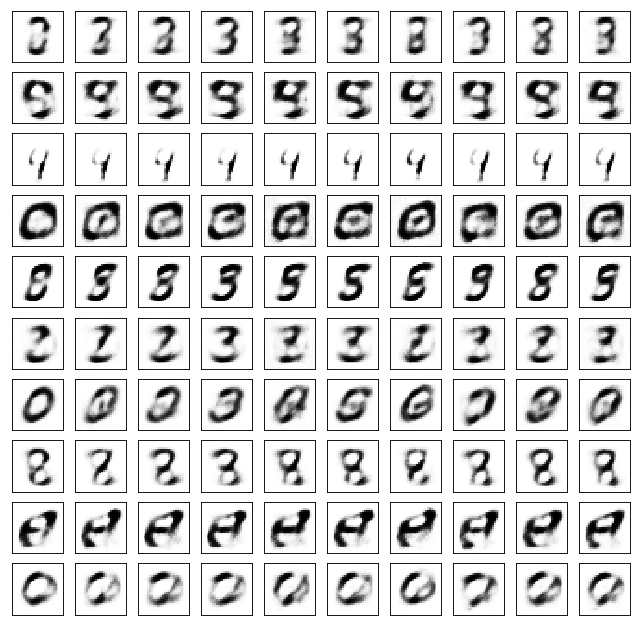

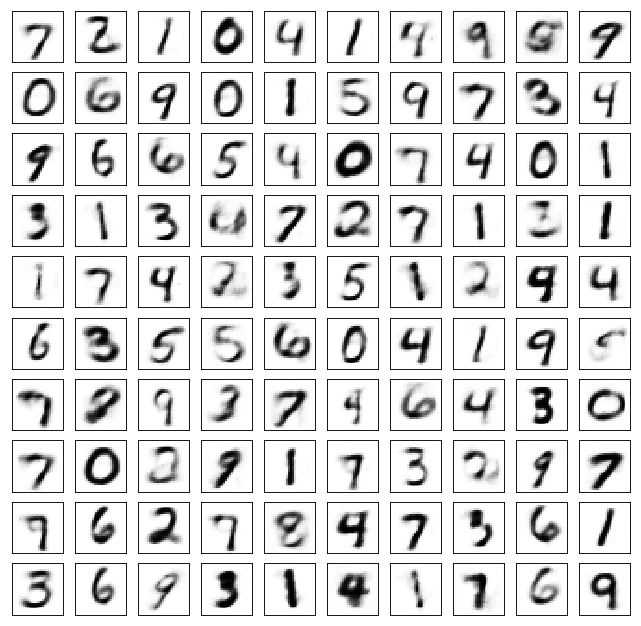

Test losses. E: 0.6416, AE: 0.0993, D: 0.7026
Train Epoch: 38 [0/50000 (0%)]	Losses E: 0.6422, AE: 0.0996, D: 0.7029
Train Epoch: 38 [25000/50000 (50%)]	Losses E: 0.7374, AE: 0.1058, D: 0.7041
Train Epoch: 38 [50000/50000 (100%)]	Losses E: 0.6433, AE: 0.1030, D: 0.7066


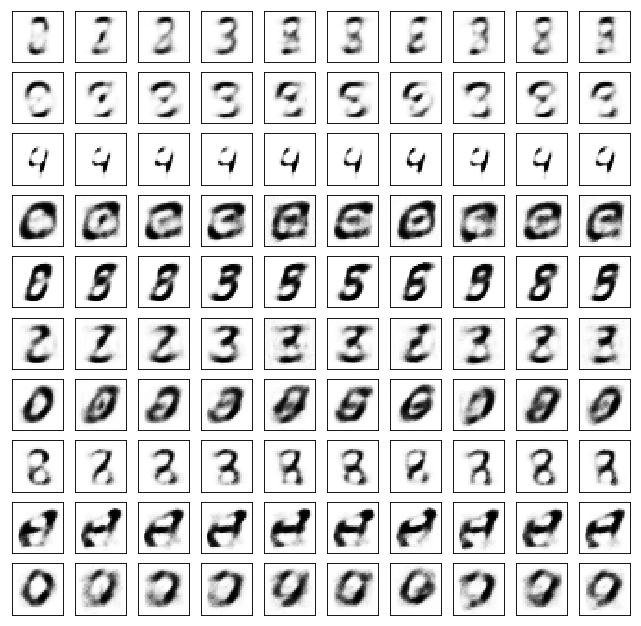

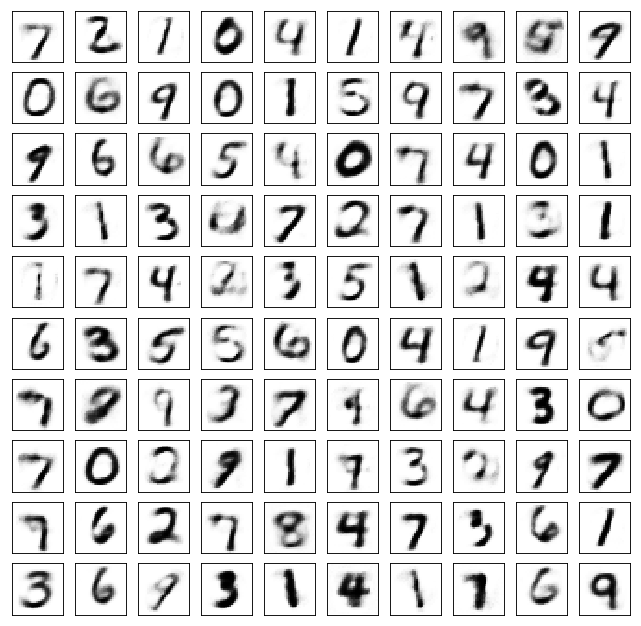

Test losses. E: 0.6360, AE: 0.1018, D: 0.7104
Train Epoch: 39 [0/50000 (0%)]	Losses E: 0.6399, AE: 0.0999, D: 0.7096
Train Epoch: 39 [25000/50000 (50%)]	Losses E: 0.6490, AE: 0.1043, D: 0.6988
Train Epoch: 39 [50000/50000 (100%)]	Losses E: 0.6551, AE: 0.1088, D: 0.7128


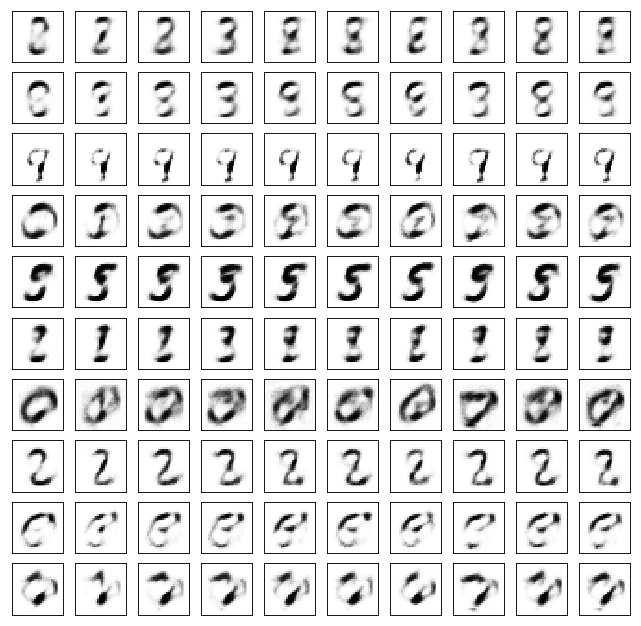

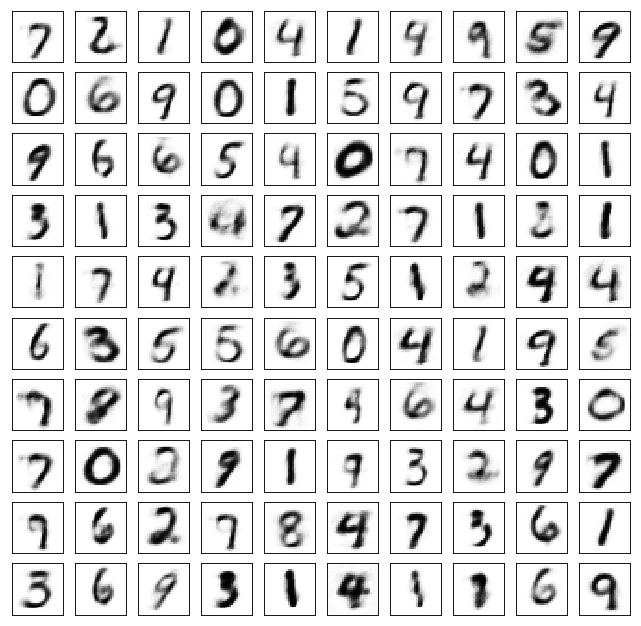

Test losses. E: 0.6544, AE: 0.1075, D: 0.7093
Train Epoch: 40 [0/50000 (0%)]	Losses E: 0.6566, AE: 0.1102, D: 0.7079
Train Epoch: 40 [25000/50000 (50%)]	Losses E: 0.7029, AE: 0.1295, D: 0.7521
Train Epoch: 40 [50000/50000 (100%)]	Losses E: 0.7289, AE: 0.1143, D: 0.6651


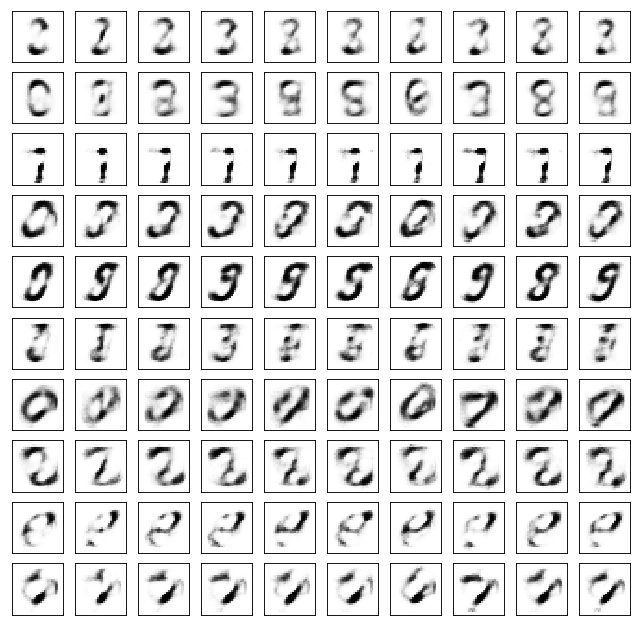

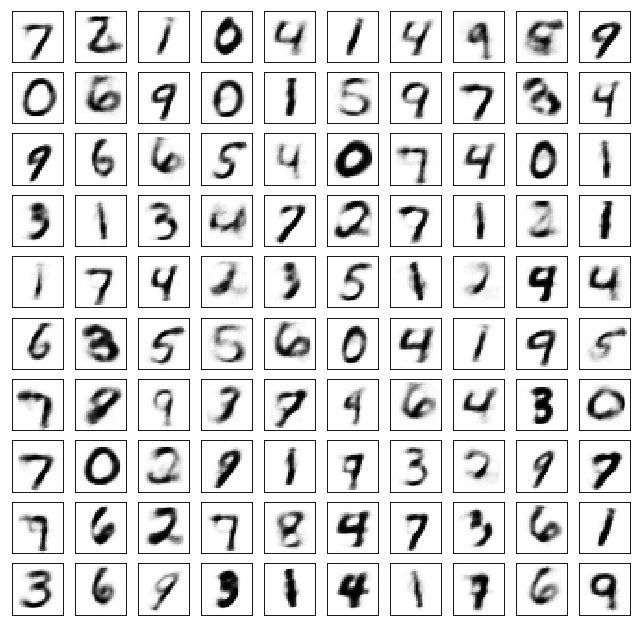

Test losses. E: 0.7184, AE: 0.1128, D: 0.6638
Train Epoch: 41 [0/50000 (0%)]	Losses E: 0.7269, AE: 0.1134, D: 0.6659
Train Epoch: 41 [25000/50000 (50%)]	Losses E: 0.6481, AE: 0.1233, D: 0.7133
Train Epoch: 41 [50000/50000 (100%)]	Losses E: 0.6586, AE: 0.1096, D: 0.6973


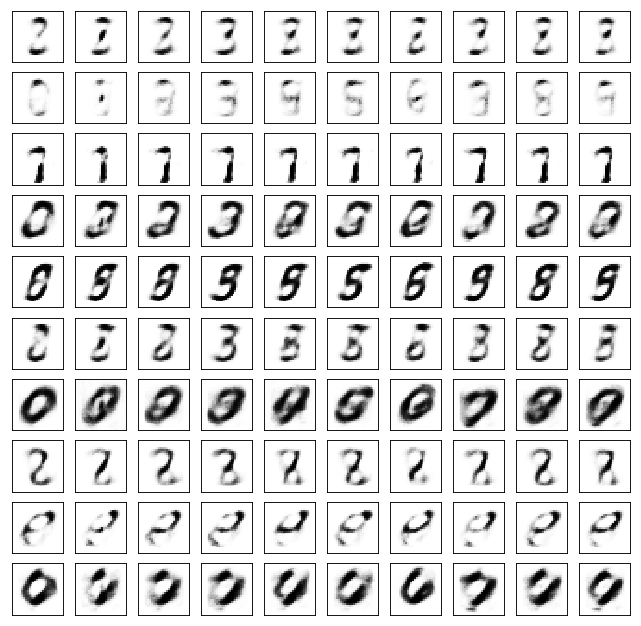

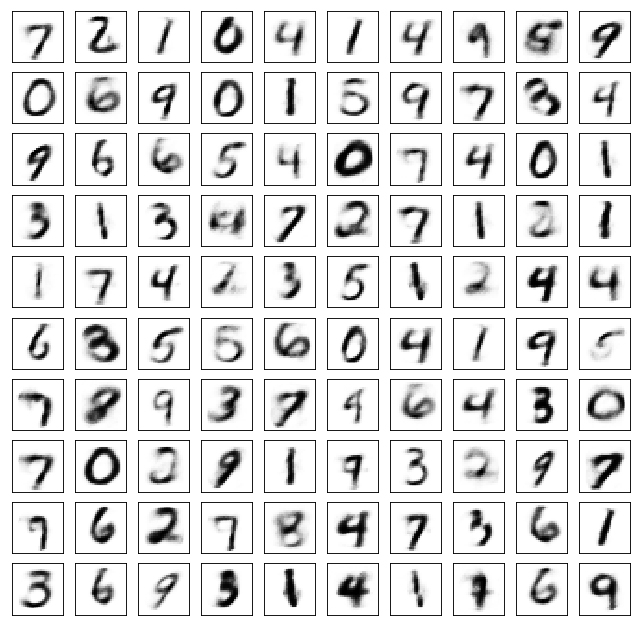

Test losses. E: 0.6521, AE: 0.1106, D: 0.6985
Train Epoch: 42 [0/50000 (0%)]	Losses E: 0.6518, AE: 0.1062, D: 0.7004
Train Epoch: 42 [25000/50000 (50%)]	Losses E: 0.7166, AE: 0.1048, D: 0.6933
Train Epoch: 42 [50000/50000 (100%)]	Losses E: 0.7474, AE: 0.1063, D: 0.6905


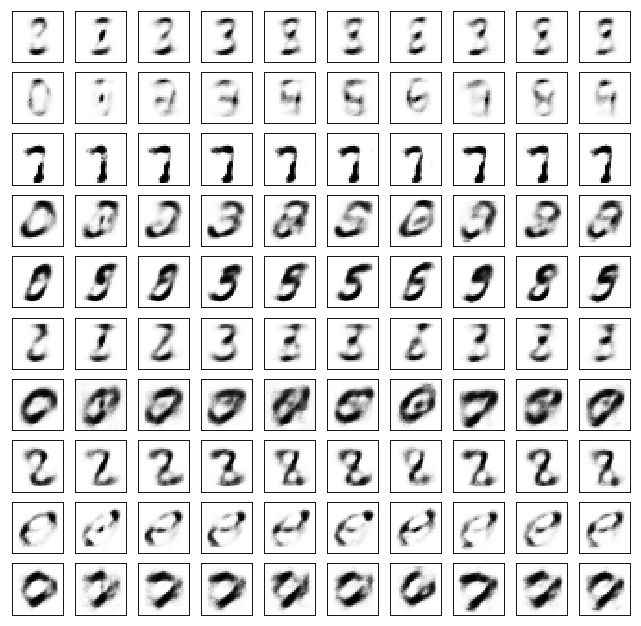

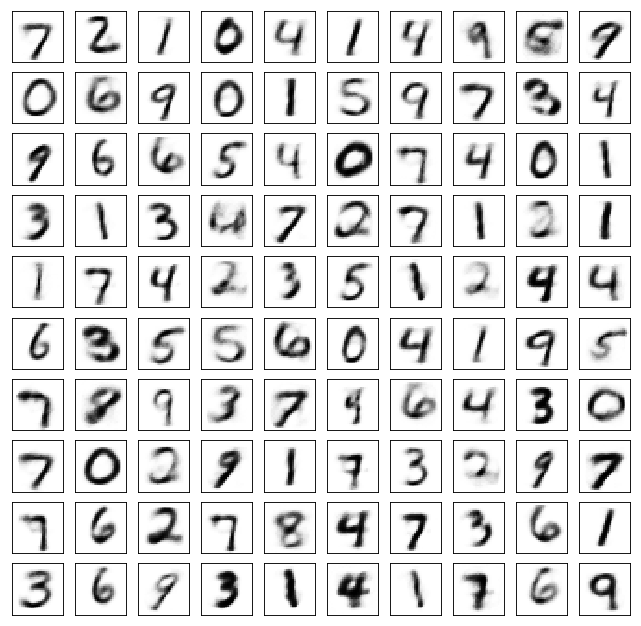

Test losses. E: 0.7465, AE: 0.0997, D: 0.6918
Train Epoch: 43 [0/50000 (0%)]	Losses E: 0.7499, AE: 0.1007, D: 0.6919
Train Epoch: 43 [25000/50000 (50%)]	Losses E: 0.6749, AE: 0.1034, D: 0.7249
Train Epoch: 43 [50000/50000 (100%)]	Losses E: 0.6679, AE: 0.1026, D: 0.7159


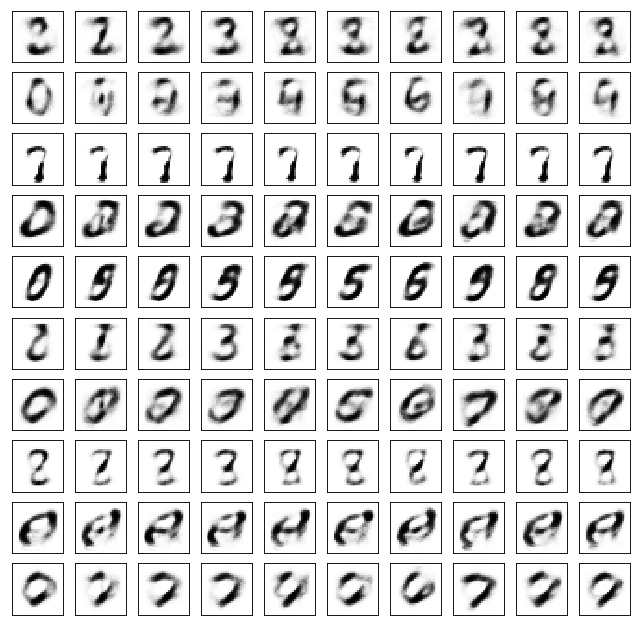

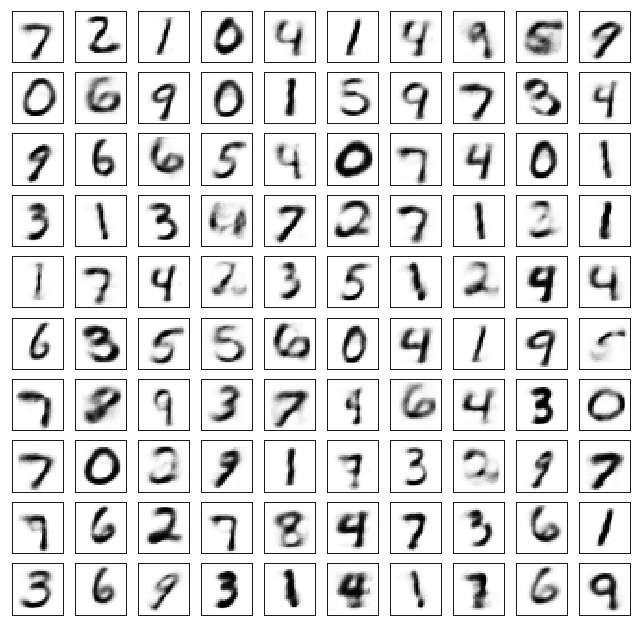

Test losses. E: 0.6657, AE: 0.1026, D: 0.7175
Train Epoch: 44 [0/50000 (0%)]	Losses E: 0.6654, AE: 0.1014, D: 0.7182
Train Epoch: 44 [25000/50000 (50%)]	Losses E: 0.6525, AE: 0.0999, D: 0.7185
Train Epoch: 44 [50000/50000 (100%)]	Losses E: 0.6571, AE: 0.1055, D: 0.7109


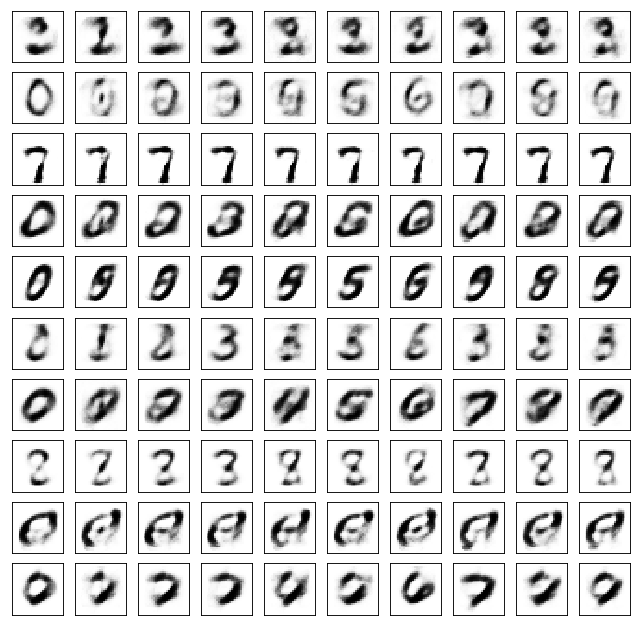

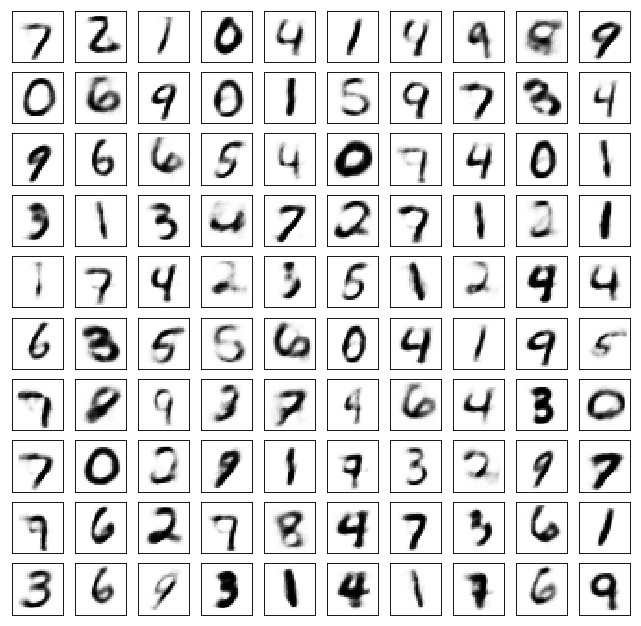

Test losses. E: 0.6529, AE: 0.1027, D: 0.7110
Train Epoch: 45 [0/50000 (0%)]	Losses E: 0.6571, AE: 0.1088, D: 0.7124
Train Epoch: 45 [25000/50000 (50%)]	Losses E: 0.6919, AE: 0.1055, D: 0.6878
Train Epoch: 45 [50000/50000 (100%)]	Losses E: 0.6252, AE: 0.1049, D: 0.7130


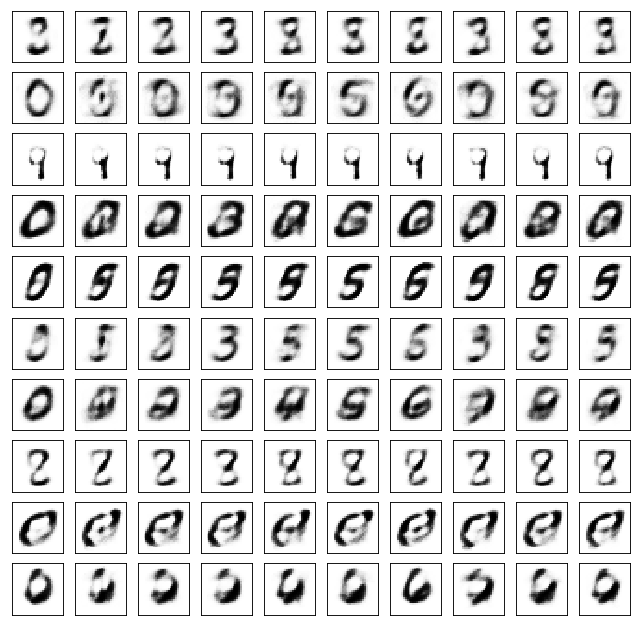

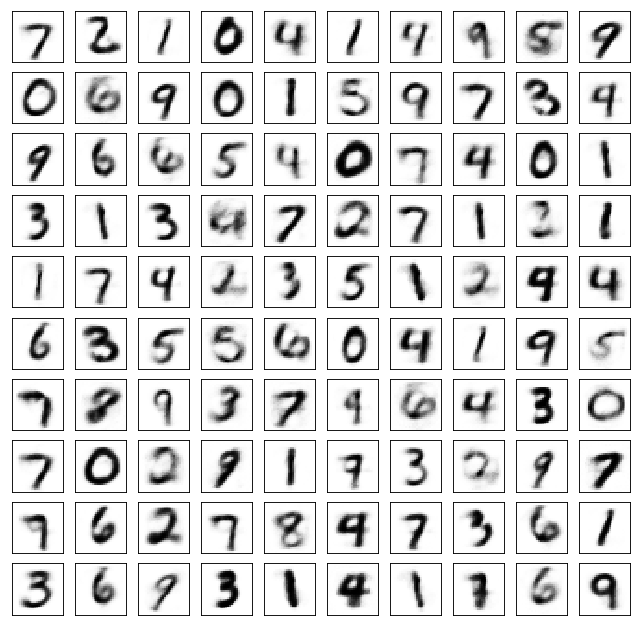

Test losses. E: 0.6235, AE: 0.1043, D: 0.7120
Train Epoch: 46 [0/50000 (0%)]	Losses E: 0.6265, AE: 0.1028, D: 0.7130
Train Epoch: 46 [25000/50000 (50%)]	Losses E: 0.7582, AE: 0.0989, D: 0.6994
Train Epoch: 46 [50000/50000 (100%)]	Losses E: 0.6185, AE: 0.0974, D: 0.7360


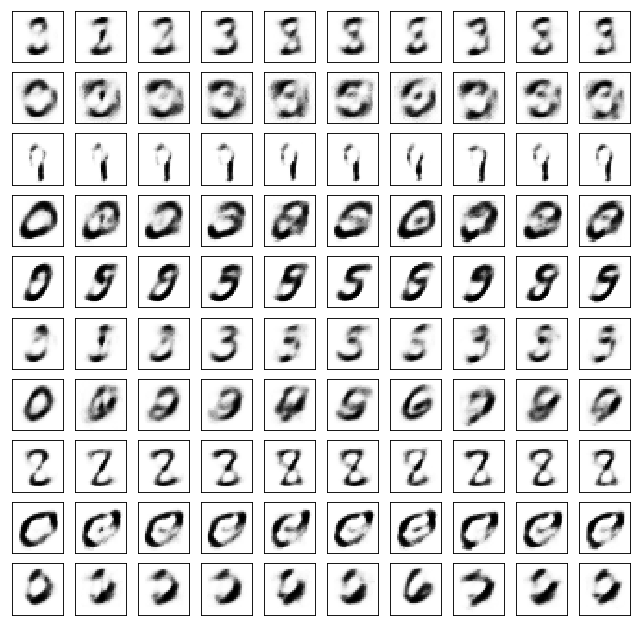

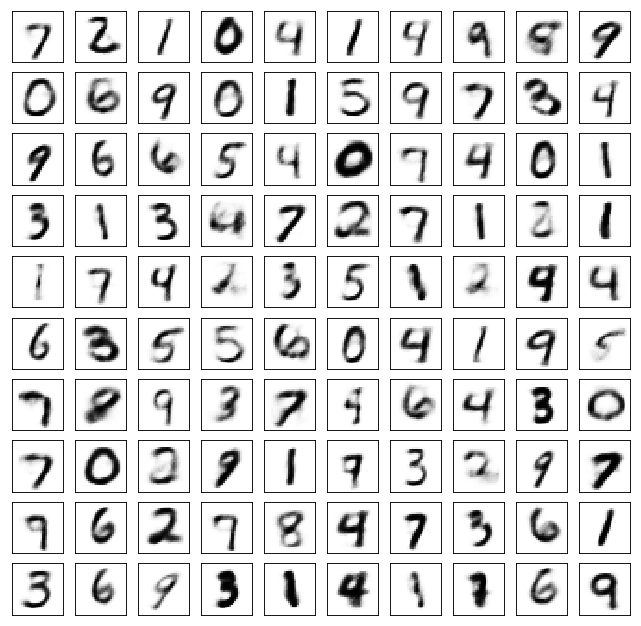

Test losses. E: 0.6154, AE: 0.0978, D: 0.7330
Train Epoch: 47 [0/50000 (0%)]	Losses E: 0.6221, AE: 0.0985, D: 0.7345
Train Epoch: 47 [25000/50000 (50%)]	Losses E: 0.5904, AE: 0.1000, D: 0.7292
Train Epoch: 47 [50000/50000 (100%)]	Losses E: 0.6535, AE: 0.0944, D: 0.6934


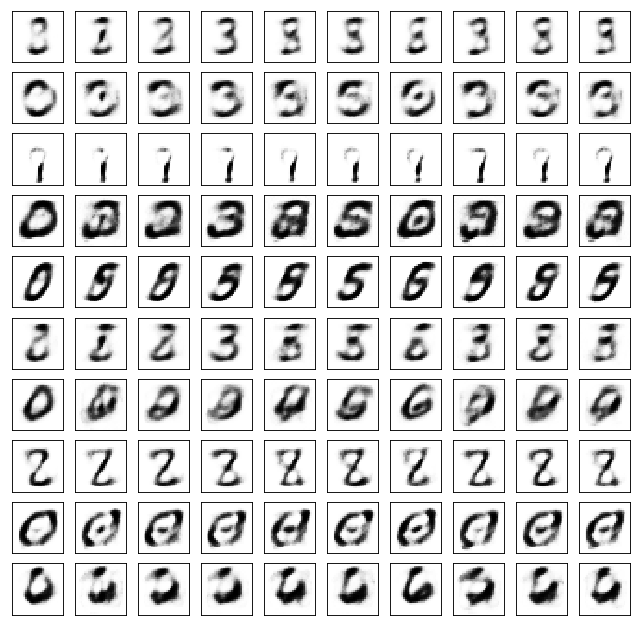

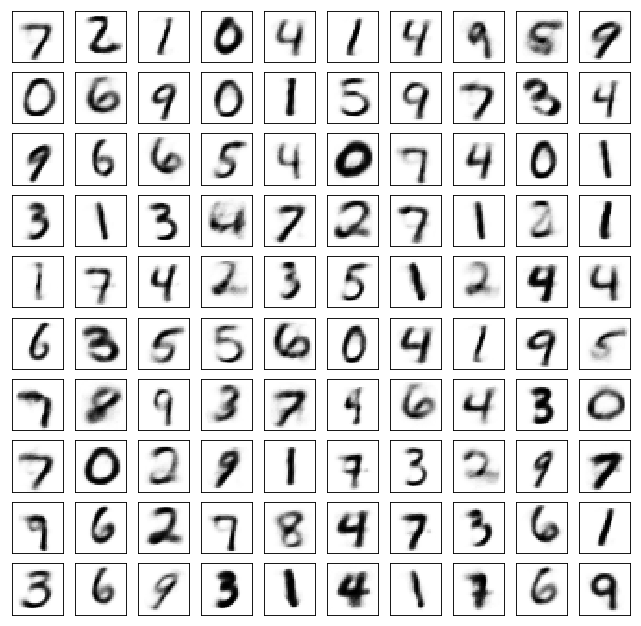

Test losses. E: 0.6531, AE: 0.0926, D: 0.6971
Train Epoch: 48 [0/50000 (0%)]	Losses E: 0.6520, AE: 0.0931, D: 0.6966
Train Epoch: 48 [25000/50000 (50%)]	Losses E: 0.7122, AE: 0.0892, D: 0.7059
Train Epoch: 48 [50000/50000 (100%)]	Losses E: 0.6713, AE: 0.0978, D: 0.7212


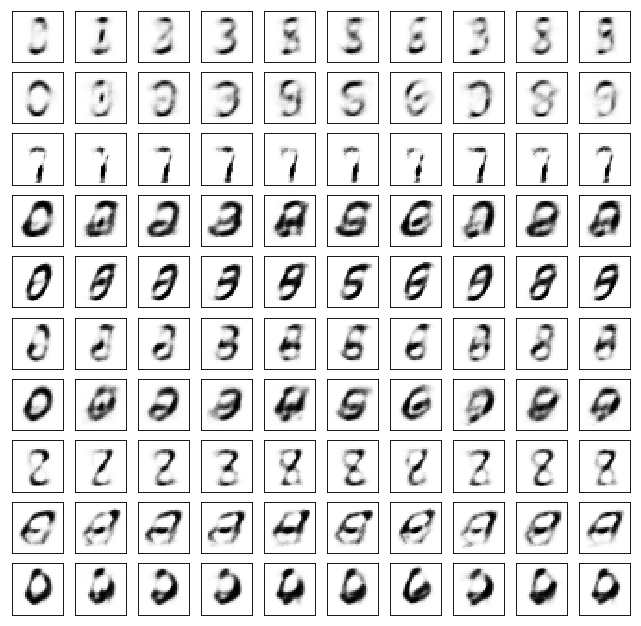

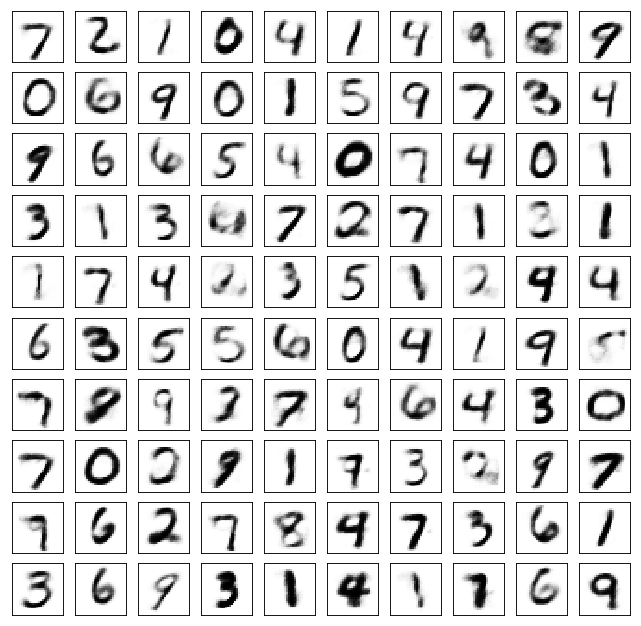

Test losses. E: 0.6678, AE: 0.0999, D: 0.7167
Train Epoch: 49 [0/50000 (0%)]	Losses E: 0.6813, AE: 0.1067, D: 0.7175
Train Epoch: 49 [25000/50000 (50%)]	Losses E: 0.6130, AE: 0.0974, D: 0.7198
Train Epoch: 49 [50000/50000 (100%)]	Losses E: 0.6938, AE: 0.1212, D: 0.7221


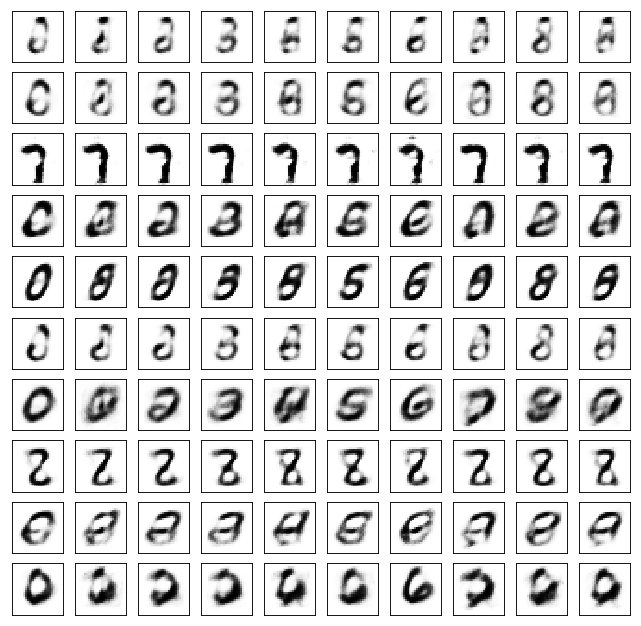

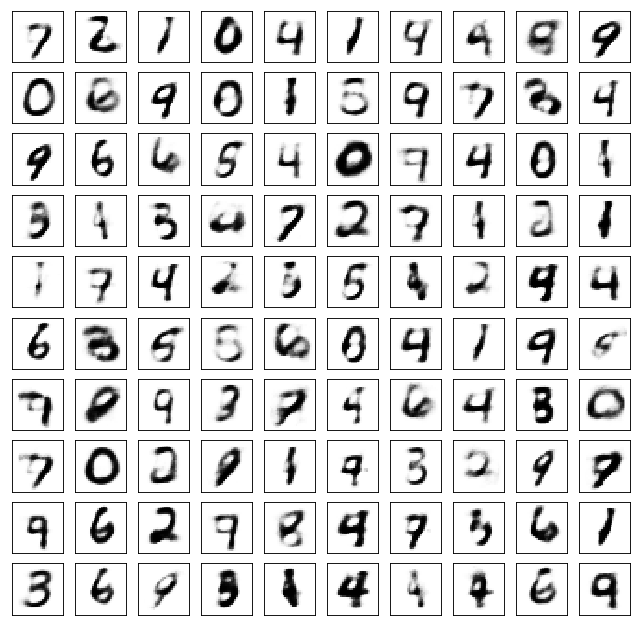

Test losses. E: 0.6765, AE: 0.1337, D: 0.7200
Train Epoch: 50 [0/50000 (0%)]	Losses E: 0.7102, AE: 0.1392, D: 0.7218
Train Epoch: 50 [25000/50000 (50%)]	Losses E: 0.6354, AE: 0.1026, D: 0.7177
Train Epoch: 50 [50000/50000 (100%)]	Losses E: 0.6563, AE: 0.0954, D: 0.7035


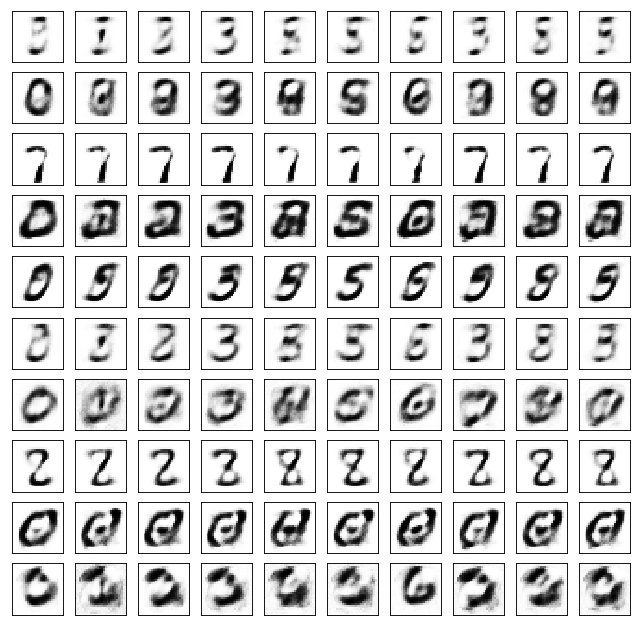

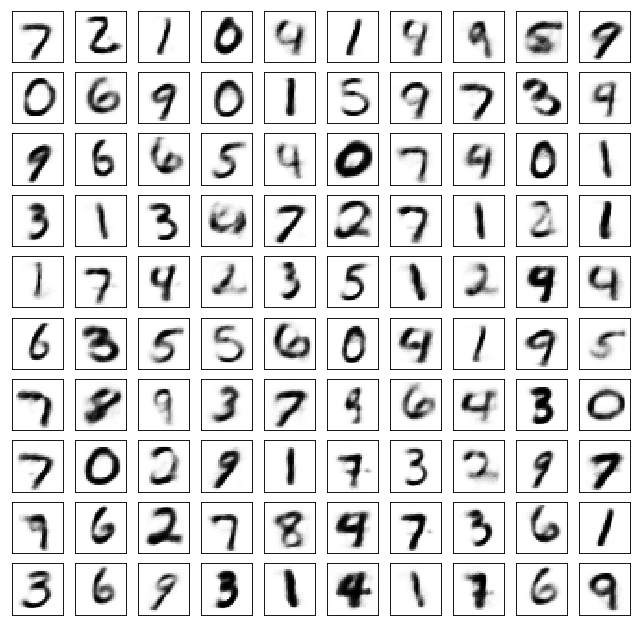

Test losses. E: 0.6519, AE: 0.0989, D: 0.7043
Train Epoch: 51 [0/50000 (0%)]	Losses E: 0.6514, AE: 0.0993, D: 0.7054
Train Epoch: 51 [25000/50000 (50%)]	Losses E: 0.6532, AE: 0.0880, D: 0.7036
Train Epoch: 51 [50000/50000 (100%)]	Losses E: 0.7627, AE: 0.0955, D: 0.6836


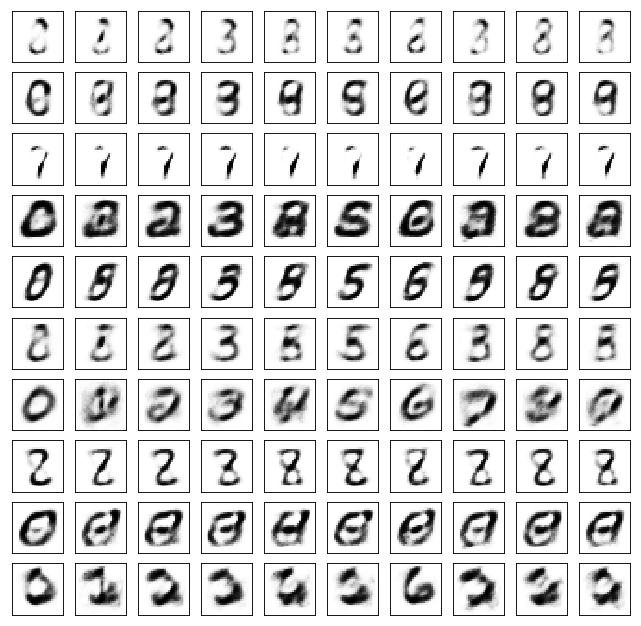

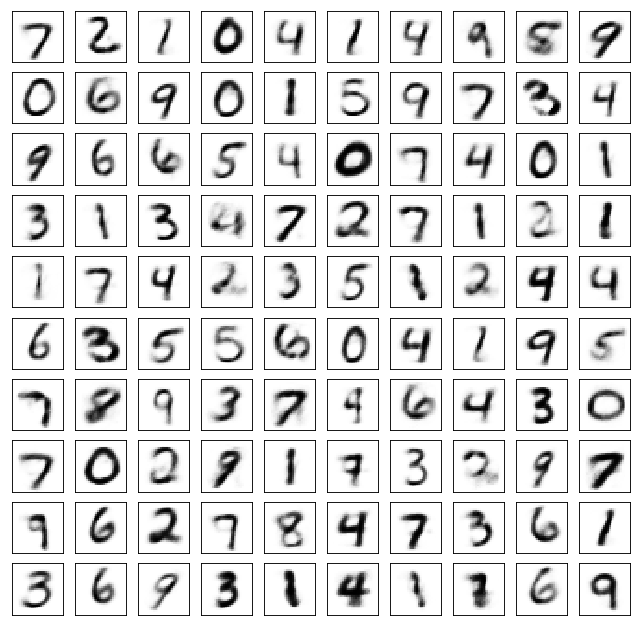

Test losses. E: 0.7510, AE: 0.0992, D: 0.6853
Train Epoch: 52 [0/50000 (0%)]	Losses E: 0.7541, AE: 0.1040, D: 0.6859
Train Epoch: 52 [25000/50000 (50%)]	Losses E: 0.6716, AE: 0.1033, D: 0.7083
Train Epoch: 52 [50000/50000 (100%)]	Losses E: 0.6970, AE: 0.1044, D: 0.7257


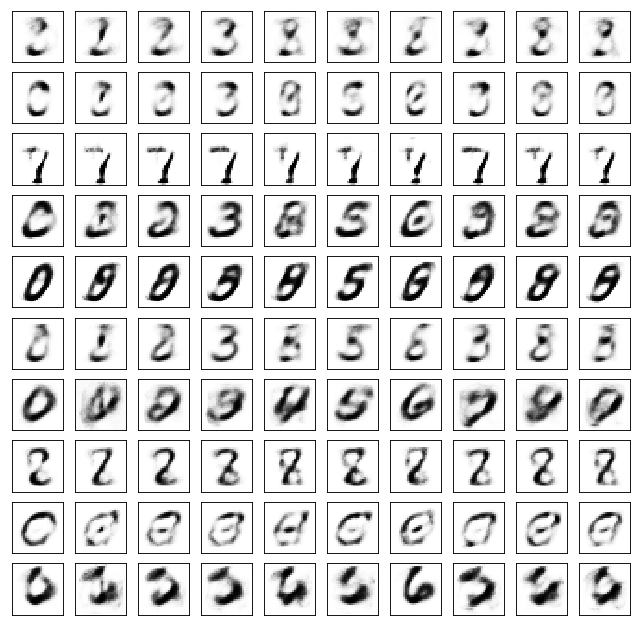

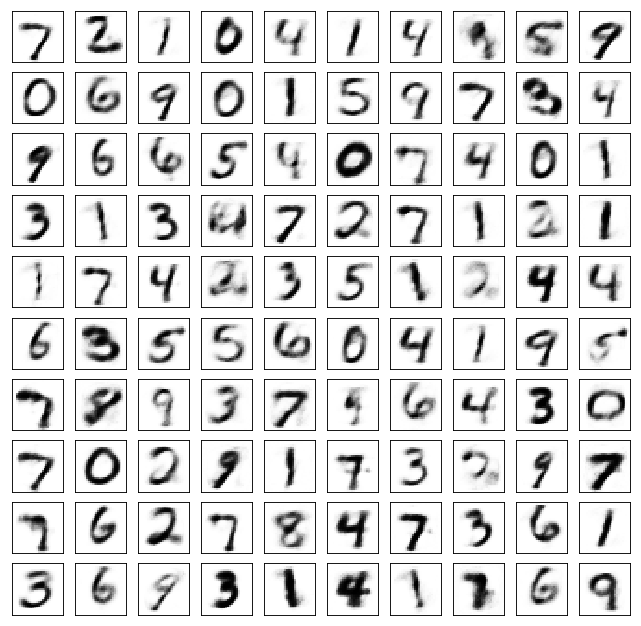

Test losses. E: 0.6804, AE: 0.1055, D: 0.7236
Train Epoch: 53 [0/50000 (0%)]	Losses E: 0.7076, AE: 0.1018, D: 0.7201
Train Epoch: 53 [25000/50000 (50%)]	Losses E: 0.7899, AE: 0.1105, D: 0.7072
Train Epoch: 53 [50000/50000 (100%)]	Losses E: 0.7052, AE: 0.1006, D: 0.7042


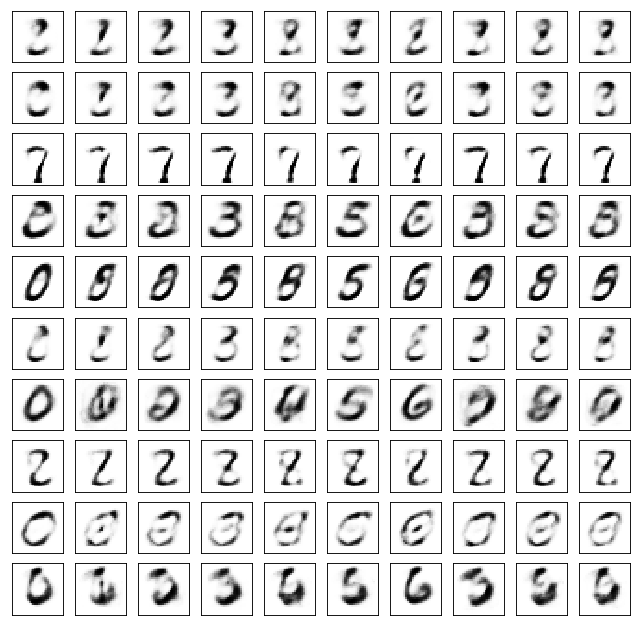

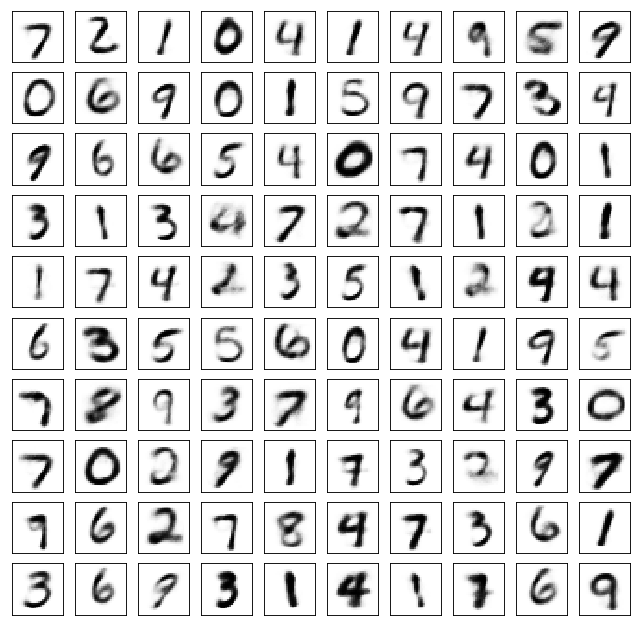

Test losses. E: 0.7026, AE: 0.1005, D: 0.7021
Train Epoch: 54 [0/50000 (0%)]	Losses E: 0.7030, AE: 0.1025, D: 0.7004
Train Epoch: 54 [25000/50000 (50%)]	Losses E: 0.7057, AE: 0.0974, D: 0.6965
Train Epoch: 54 [50000/50000 (100%)]	Losses E: 0.7275, AE: 0.0987, D: 0.6943


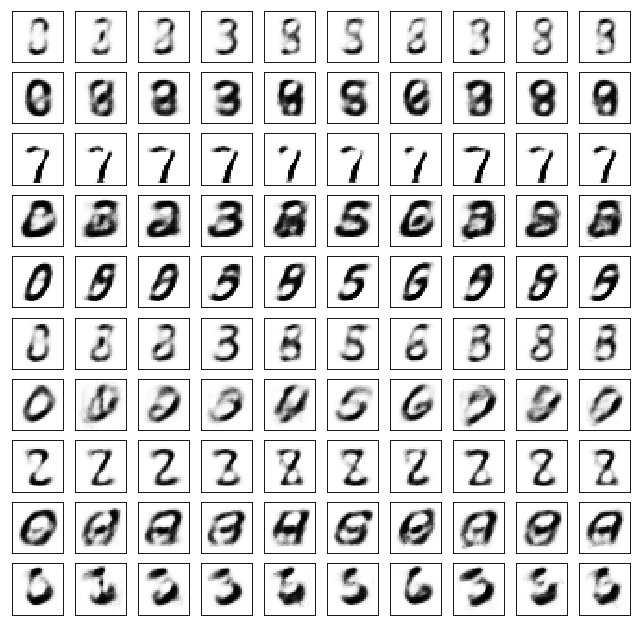

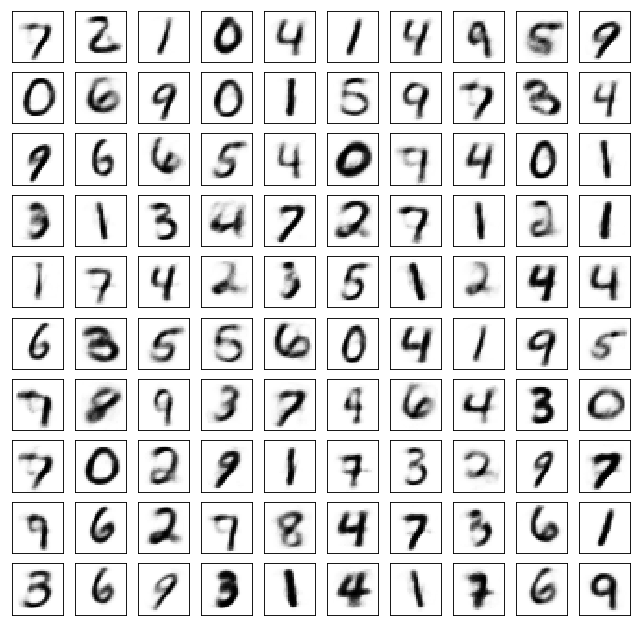

Test losses. E: 0.7234, AE: 0.0976, D: 0.6937
Train Epoch: 55 [0/50000 (0%)]	Losses E: 0.7270, AE: 0.0929, D: 0.6915
Train Epoch: 55 [25000/50000 (50%)]	Losses E: 0.7870, AE: 0.1066, D: 0.6991
Train Epoch: 55 [50000/50000 (100%)]	Losses E: 0.6209, AE: 0.0923, D: 0.7146


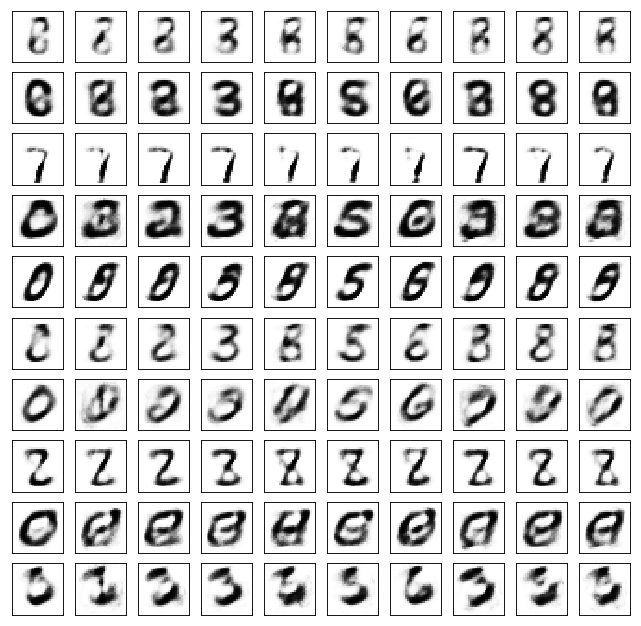

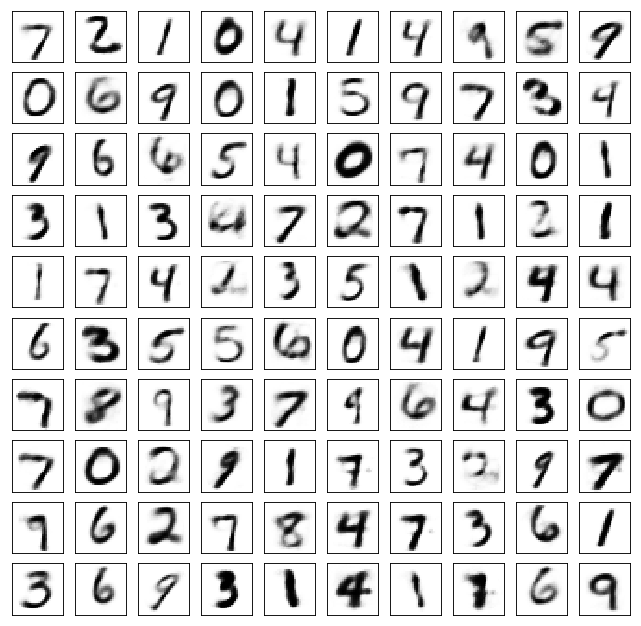

Test losses. E: 0.6140, AE: 0.0948, D: 0.7156
Train Epoch: 56 [0/50000 (0%)]	Losses E: 0.6155, AE: 0.0942, D: 0.7153
Train Epoch: 56 [25000/50000 (50%)]	Losses E: 0.6508, AE: 0.0952, D: 0.7066
Train Epoch: 56 [50000/50000 (100%)]	Losses E: 0.6619, AE: 0.0887, D: 0.6914


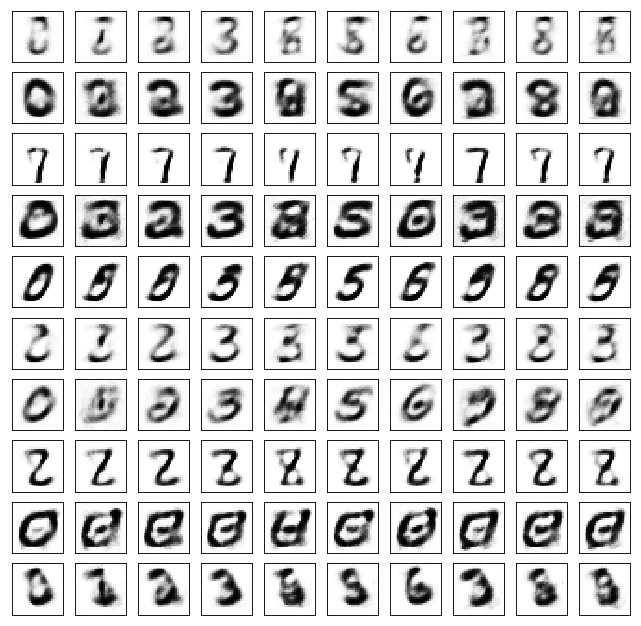

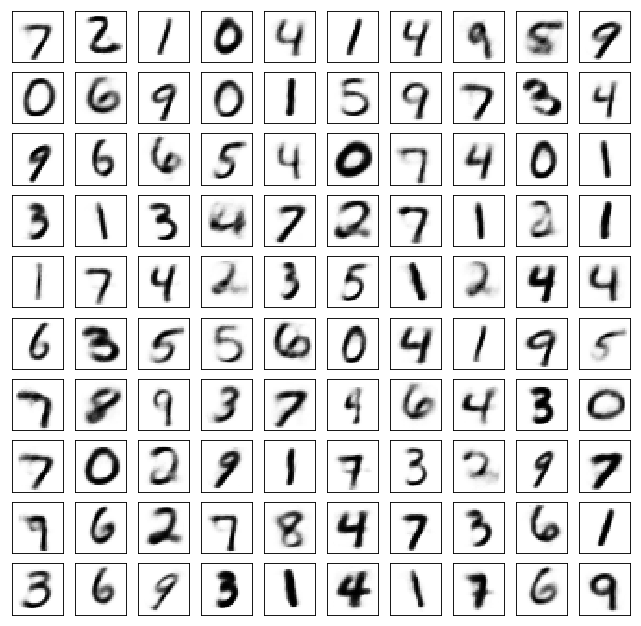

Test losses. E: 0.6599, AE: 0.0879, D: 0.6917
Train Epoch: 57 [0/50000 (0%)]	Losses E: 0.6599, AE: 0.0879, D: 0.6906
Train Epoch: 57 [25000/50000 (50%)]	Losses E: 0.7305, AE: 0.0893, D: 0.6863
Train Epoch: 57 [50000/50000 (100%)]	Losses E: 0.6976, AE: 0.0875, D: 0.6950


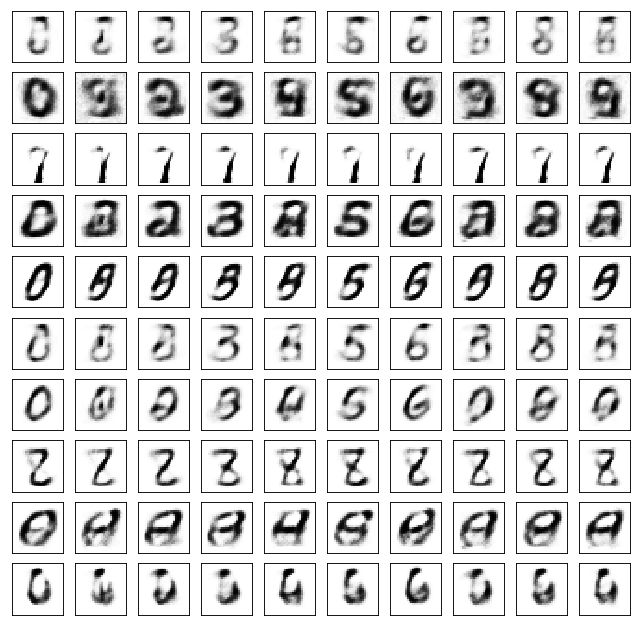

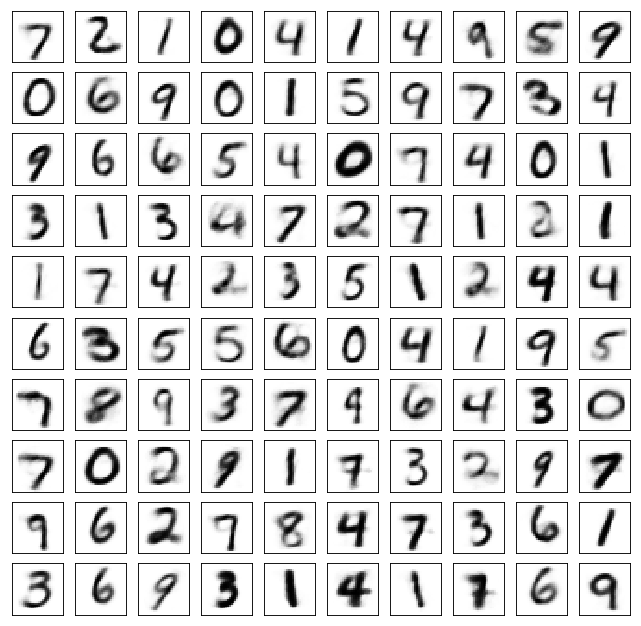

Test losses. E: 0.6966, AE: 0.0896, D: 0.6955
Train Epoch: 58 [0/50000 (0%)]	Losses E: 0.6937, AE: 0.0898, D: 0.6952
Train Epoch: 58 [25000/50000 (50%)]	Losses E: 0.7286, AE: 0.0974, D: 0.6986
Train Epoch: 58 [50000/50000 (100%)]	Losses E: 0.6785, AE: 0.1087, D: 0.6902


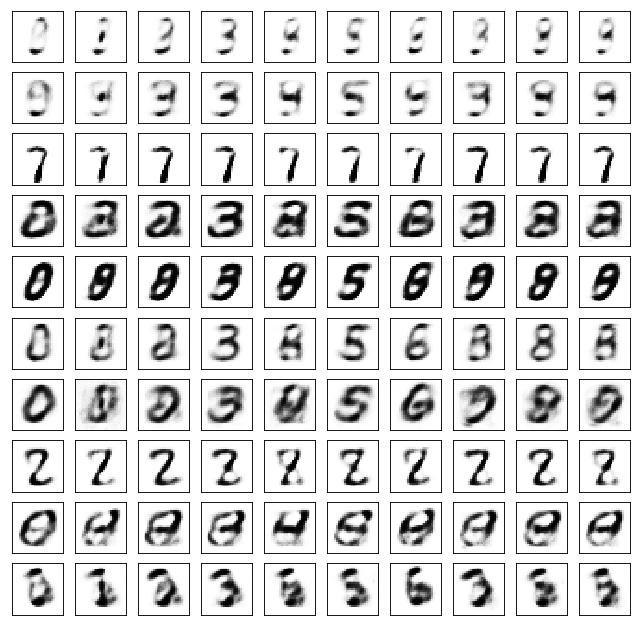

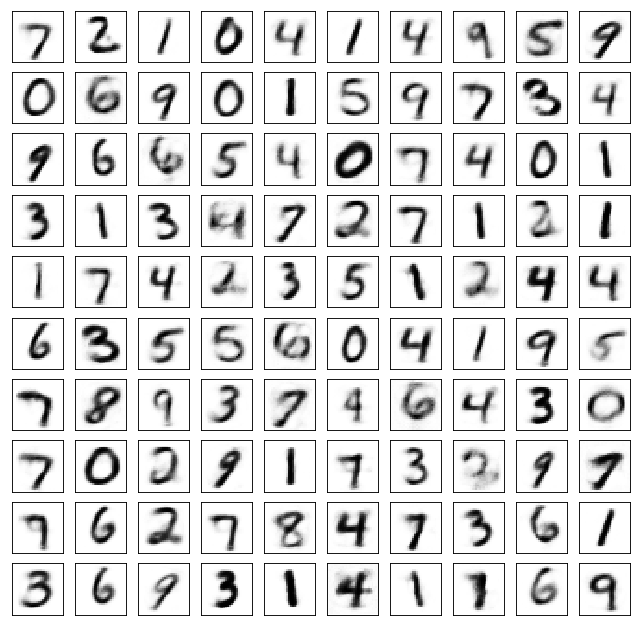

Test losses. E: 0.6754, AE: 0.1035, D: 0.6883
Train Epoch: 59 [0/50000 (0%)]	Losses E: 0.6813, AE: 0.1068, D: 0.6869
Train Epoch: 59 [25000/50000 (50%)]	Losses E: 0.7053, AE: 0.0984, D: 0.6766
Train Epoch: 59 [50000/50000 (100%)]	Losses E: 0.6518, AE: 0.0995, D: 0.7034


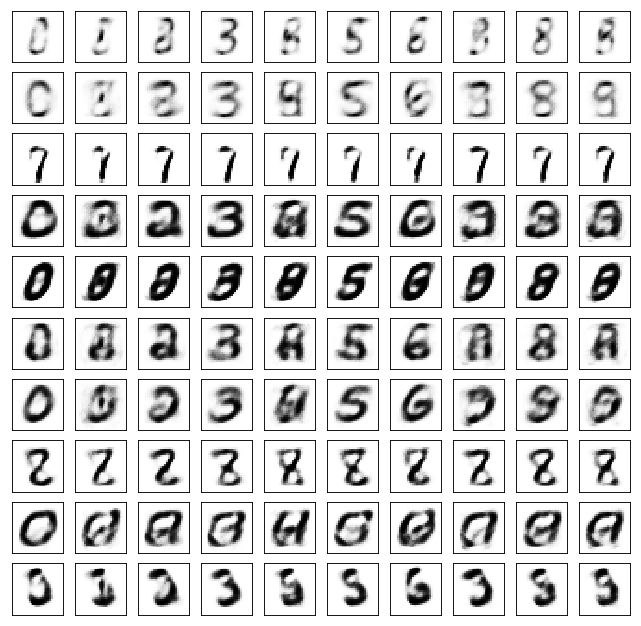

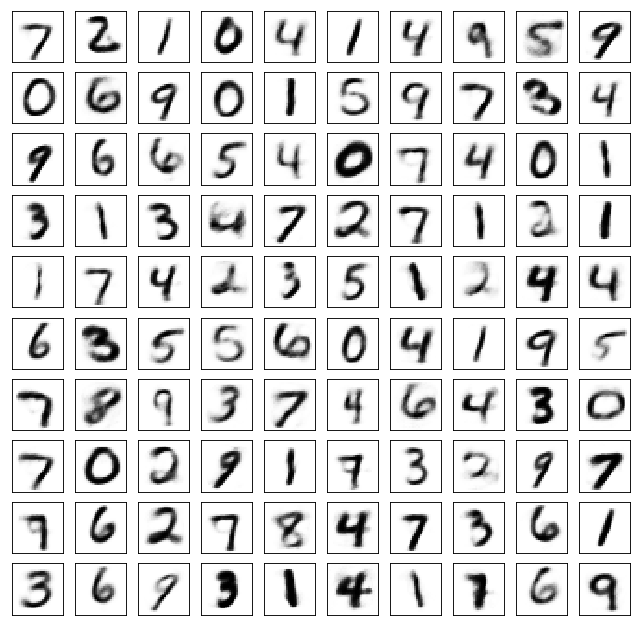

Test losses. E: 0.6512, AE: 0.0952, D: 0.6997
Train Epoch: 60 [0/50000 (0%)]	Losses E: 0.6602, AE: 0.0952, D: 0.6993
Train Epoch: 60 [25000/50000 (50%)]	Losses E: 0.6799, AE: 0.0958, D: 0.6958
Train Epoch: 60 [50000/50000 (100%)]	Losses E: 0.6676, AE: 0.0963, D: 0.6906


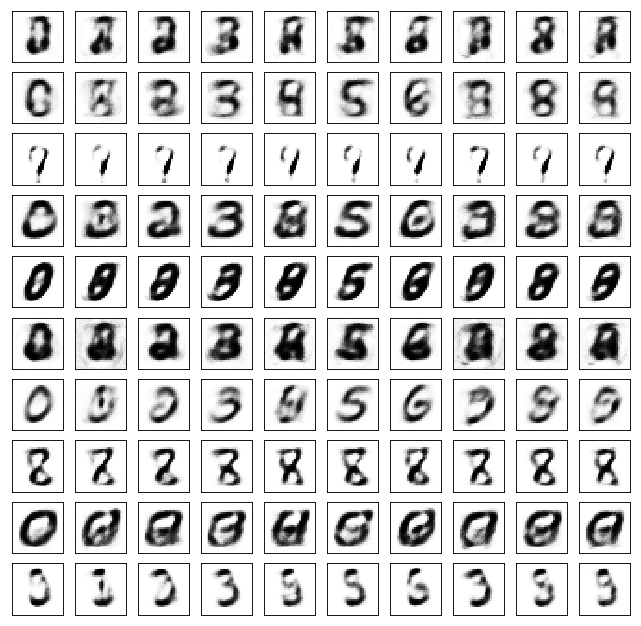

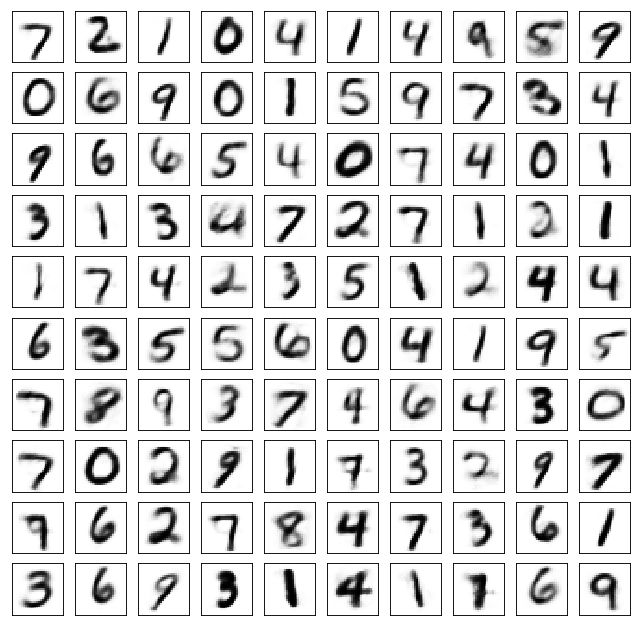

Test losses. E: 0.6666, AE: 0.0953, D: 0.6914
Train Epoch: 61 [0/50000 (0%)]	Losses E: 0.6674, AE: 0.0987, D: 0.6929
Train Epoch: 61 [25000/50000 (50%)]	Losses E: 0.6621, AE: 0.0997, D: 0.7208
Train Epoch: 61 [50000/50000 (100%)]	Losses E: 0.6569, AE: 0.0909, D: 0.6952


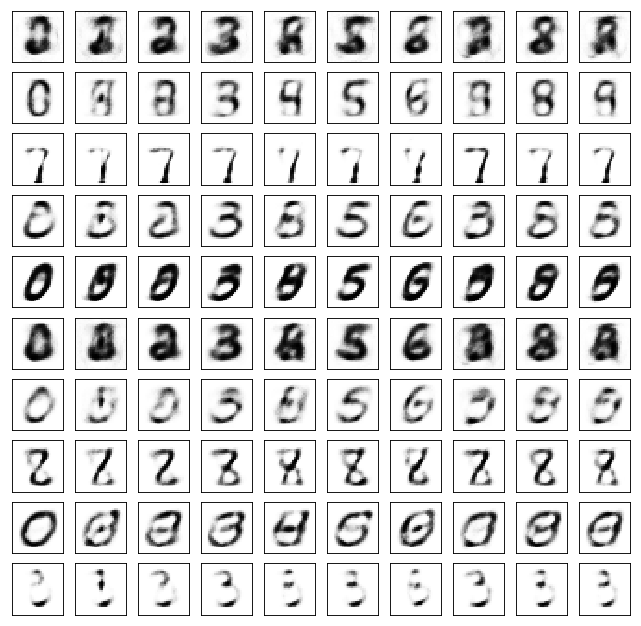

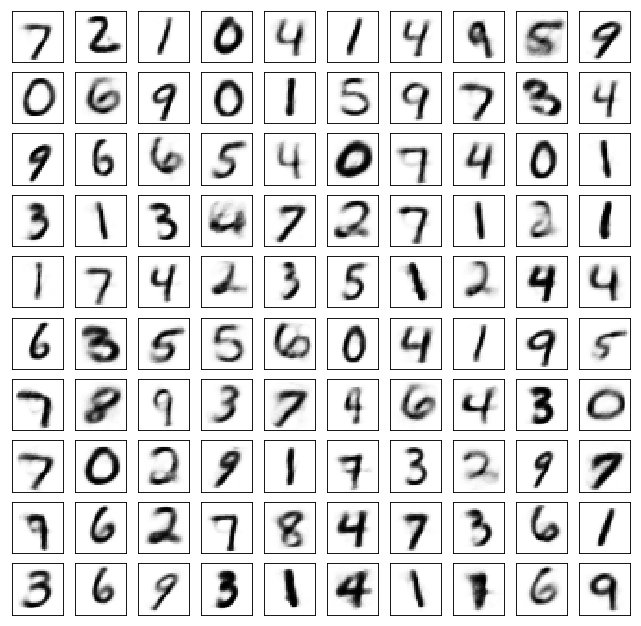

Test losses. E: 0.6556, AE: 0.0914, D: 0.6948
Train Epoch: 62 [0/50000 (0%)]	Losses E: 0.6556, AE: 0.0863, D: 0.6936
Train Epoch: 62 [25000/50000 (50%)]	Losses E: 0.7537, AE: 0.0877, D: 0.6781
Train Epoch: 62 [50000/50000 (100%)]	Losses E: 0.6585, AE: 0.0939, D: 0.7016


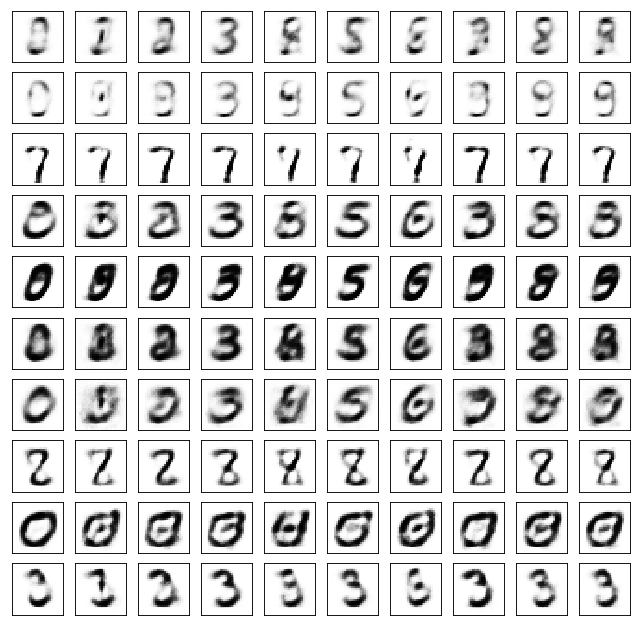

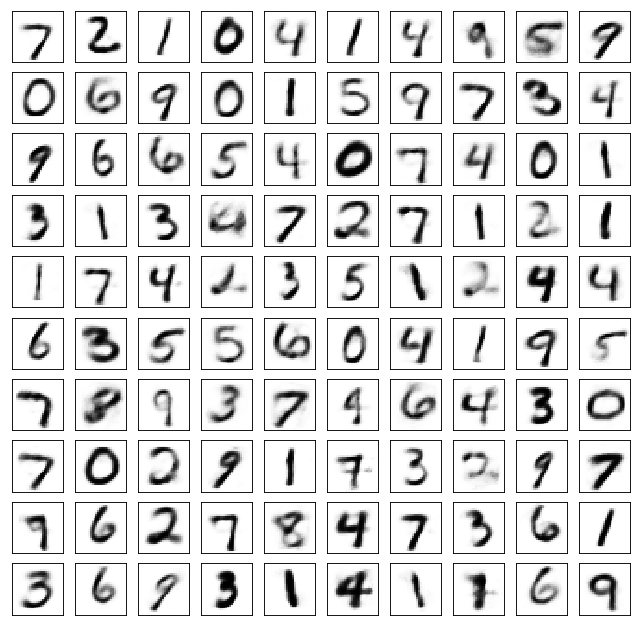

Test losses. E: 0.6554, AE: 0.0935, D: 0.7011
Train Epoch: 63 [0/50000 (0%)]	Losses E: 0.6573, AE: 0.0993, D: 0.6996
Train Epoch: 63 [25000/50000 (50%)]	Losses E: 0.6805, AE: 0.0906, D: 0.7051
Train Epoch: 63 [50000/50000 (100%)]	Losses E: 0.6373, AE: 0.0902, D: 0.7200


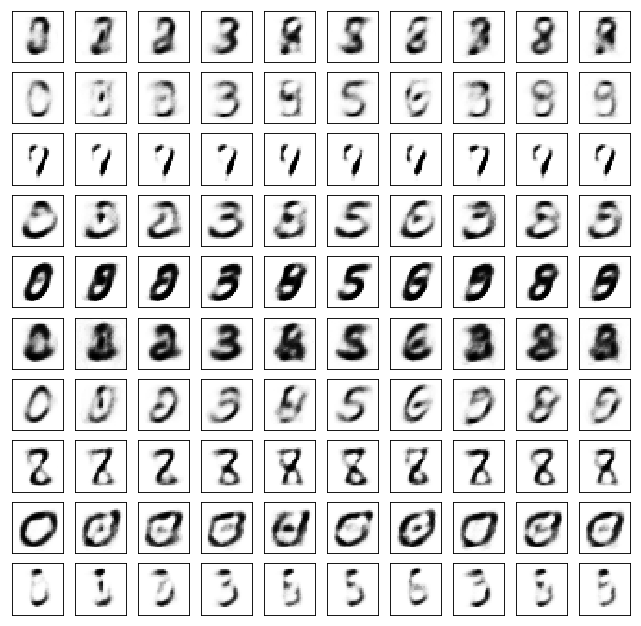

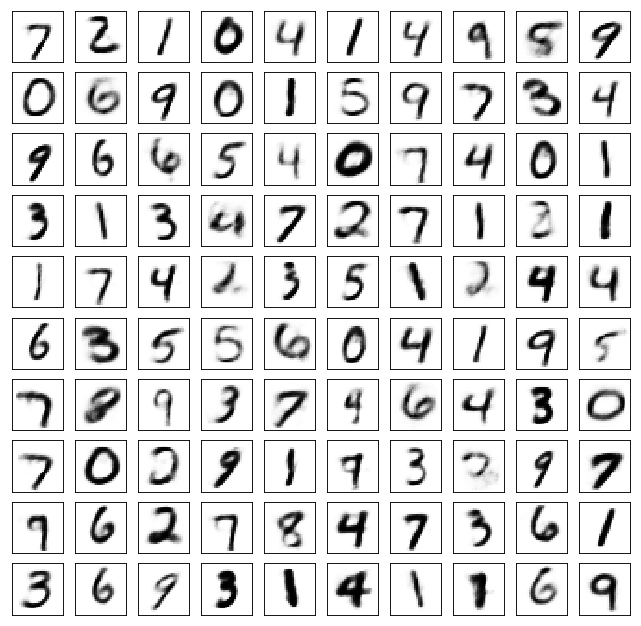

Test losses. E: 0.6308, AE: 0.0922, D: 0.7204
Train Epoch: 64 [0/50000 (0%)]	Losses E: 0.6443, AE: 0.0940, D: 0.7177
Train Epoch: 64 [25000/50000 (50%)]	Losses E: 0.6319, AE: 0.0850, D: 0.6951
Train Epoch: 64 [50000/50000 (100%)]	Losses E: 0.6252, AE: 0.0885, D: 0.7123


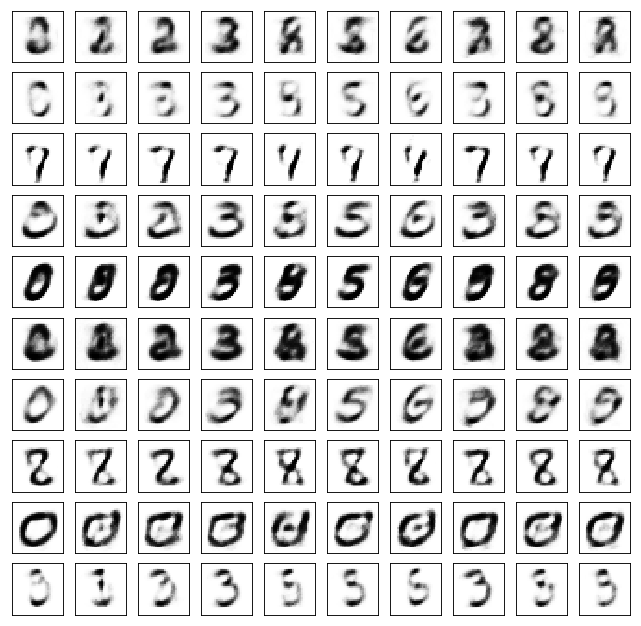

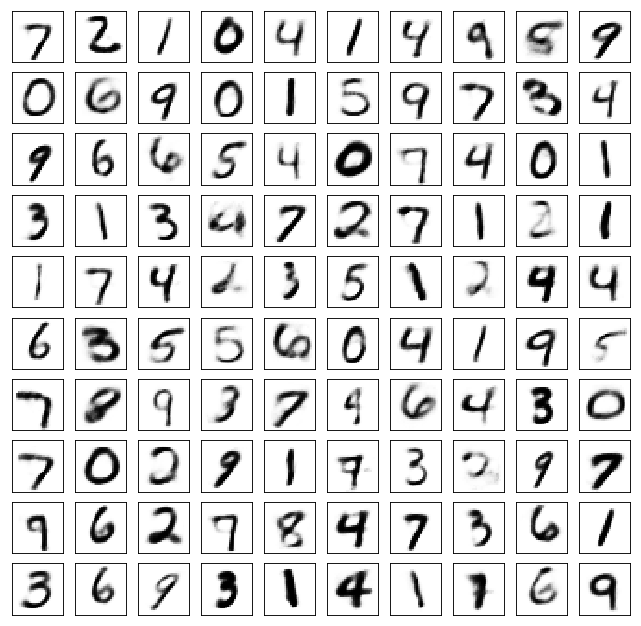

Test losses. E: 0.6221, AE: 0.0896, D: 0.7084
Train Epoch: 65 [0/50000 (0%)]	Losses E: 0.6333, AE: 0.0836, D: 0.7074
Train Epoch: 65 [25000/50000 (50%)]	Losses E: 0.7001, AE: 0.1044, D: 0.6993
Train Epoch: 65 [50000/50000 (100%)]	Losses E: 0.6455, AE: 0.0972, D: 0.7003


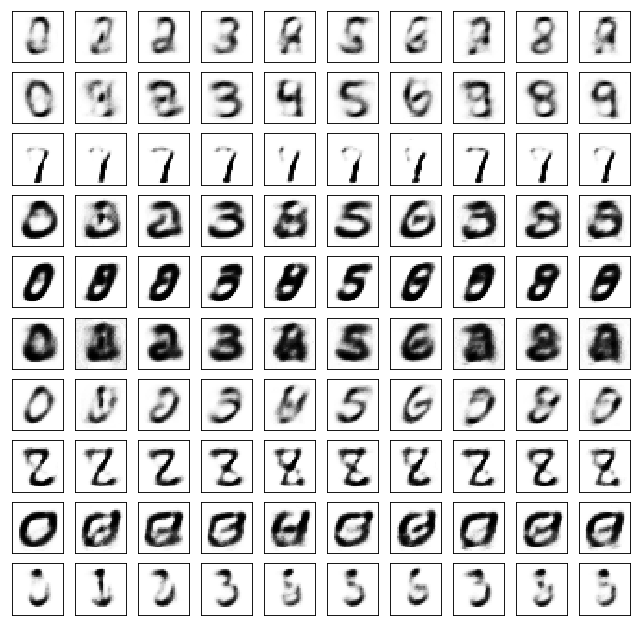

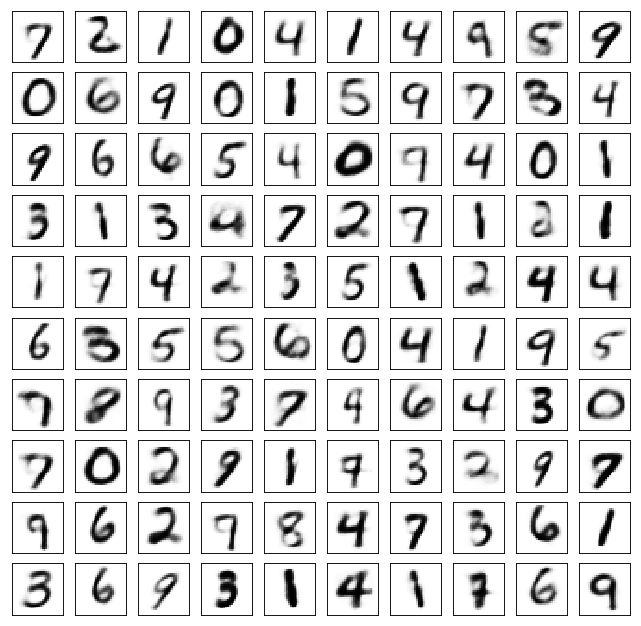

Test losses. E: 0.6424, AE: 0.0961, D: 0.7003
Train Epoch: 66 [0/50000 (0%)]	Losses E: 0.6412, AE: 0.0970, D: 0.7016
Train Epoch: 66 [25000/50000 (50%)]	Losses E: 0.6737, AE: 0.0940, D: 0.6966
Train Epoch: 66 [50000/50000 (100%)]	Losses E: 0.6558, AE: 0.0908, D: 0.6903


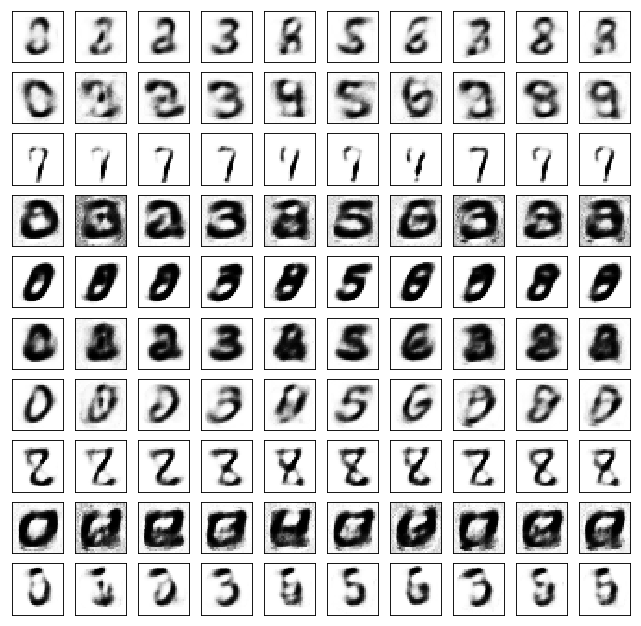

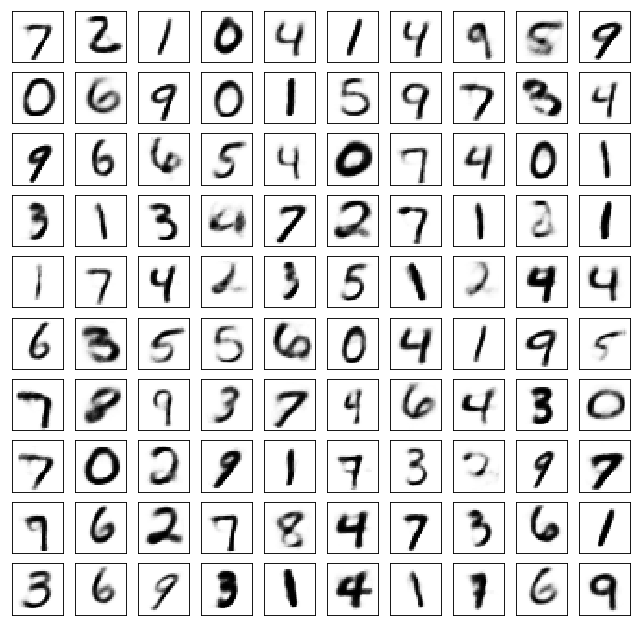

Test losses. E: 0.6500, AE: 0.0911, D: 0.6895
Train Epoch: 67 [0/50000 (0%)]	Losses E: 0.6578, AE: 0.0934, D: 0.6878
Train Epoch: 67 [25000/50000 (50%)]	Losses E: 0.5626, AE: 0.1334, D: 0.7560
Train Epoch: 67 [50000/50000 (100%)]	Losses E: 0.7209, AE: 0.1027, D: 0.7001


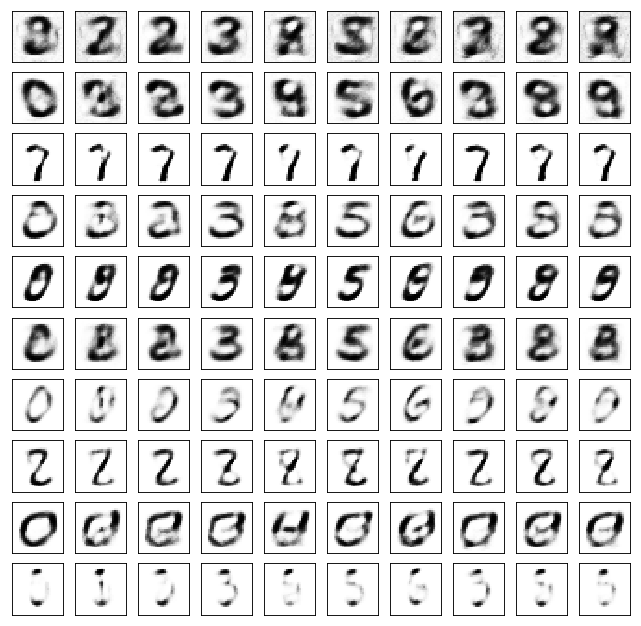

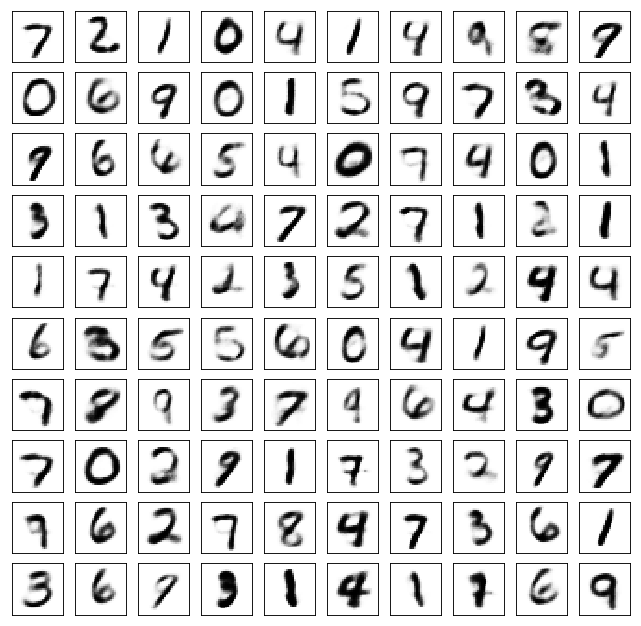

Test losses. E: 0.7007, AE: 0.1073, D: 0.6972
Train Epoch: 68 [0/50000 (0%)]	Losses E: 0.7167, AE: 0.1021, D: 0.6973
Train Epoch: 68 [25000/50000 (50%)]	Losses E: 0.6819, AE: 0.0920, D: 0.7061
Train Epoch: 68 [50000/50000 (100%)]	Losses E: 0.6824, AE: 0.0922, D: 0.7162


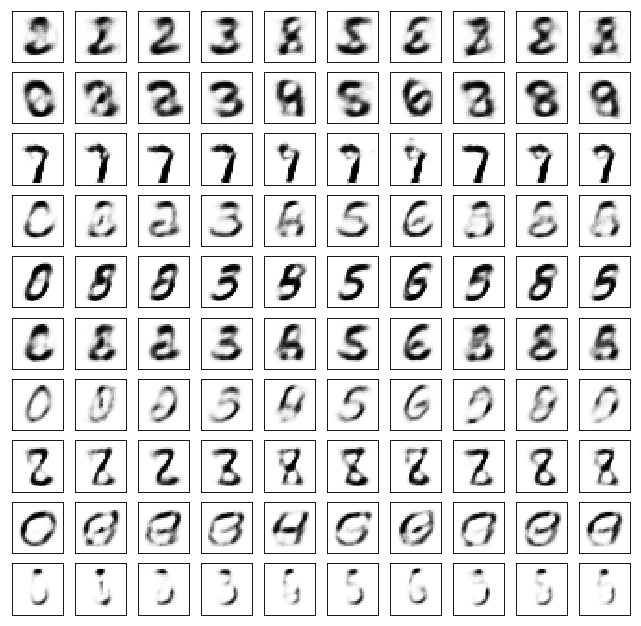

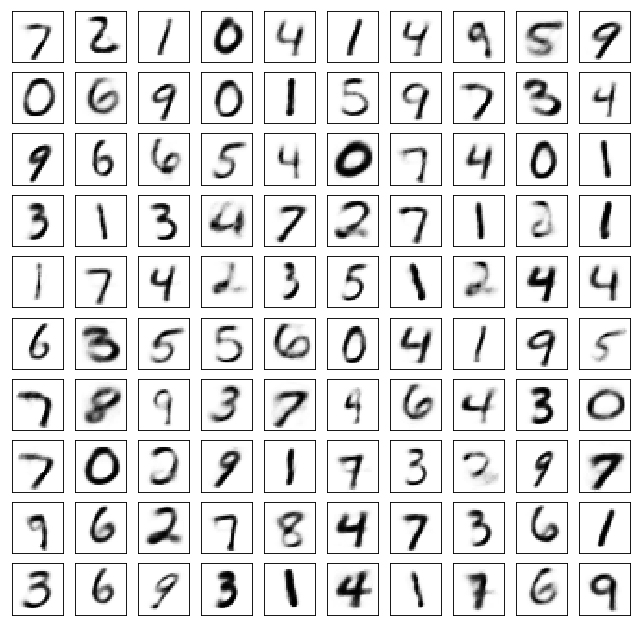

Test losses. E: 0.6813, AE: 0.0935, D: 0.7162
Train Epoch: 69 [0/50000 (0%)]	Losses E: 0.6770, AE: 0.0915, D: 0.7186
Train Epoch: 69 [25000/50000 (50%)]	Losses E: 0.7153, AE: 0.0865, D: 0.6940
Train Epoch: 69 [50000/50000 (100%)]	Losses E: 0.6708, AE: 0.0801, D: 0.7103


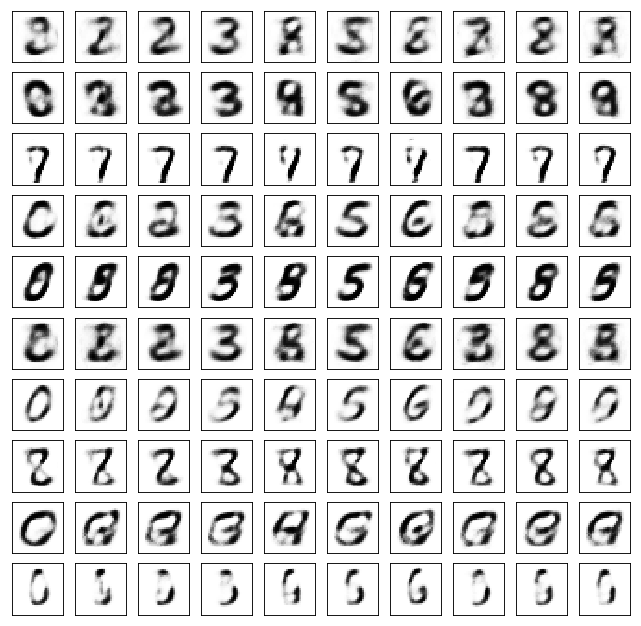

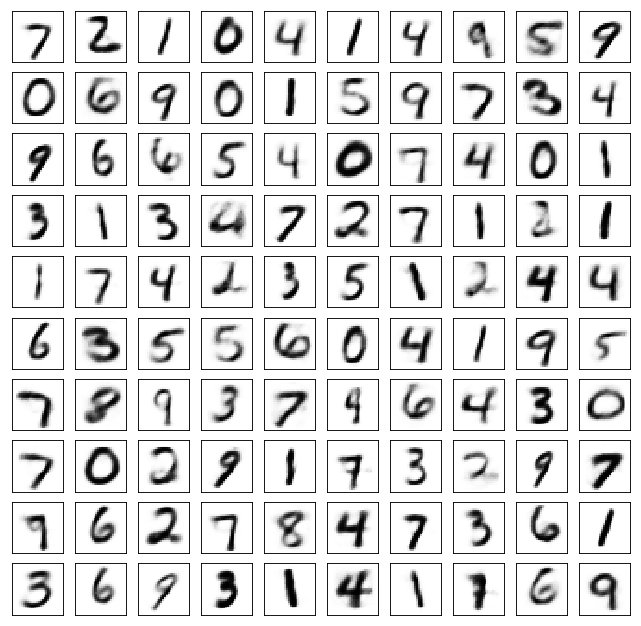

Test losses. E: 0.6691, AE: 0.0881, D: 0.7097
Train Epoch: 70 [0/50000 (0%)]	Losses E: 0.6682, AE: 0.0842, D: 0.7090
Train Epoch: 70 [25000/50000 (50%)]	Losses E: 0.7354, AE: 0.0837, D: 0.6961
Train Epoch: 70 [50000/50000 (100%)]	Losses E: 0.6869, AE: 0.0880, D: 0.7014


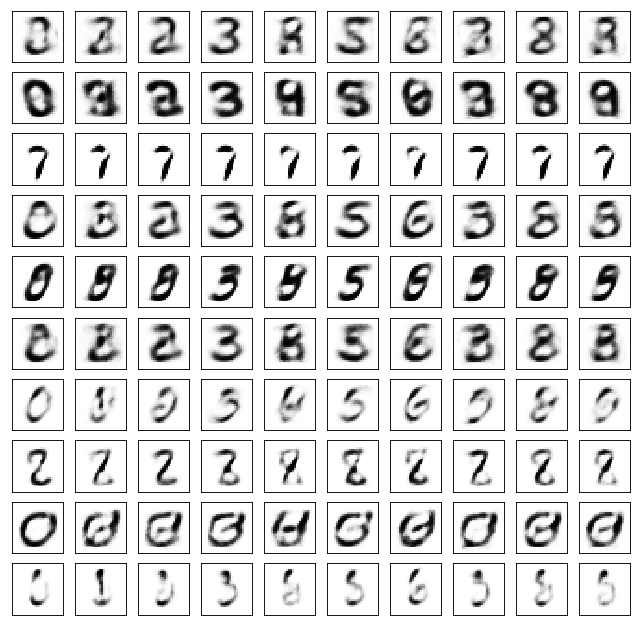

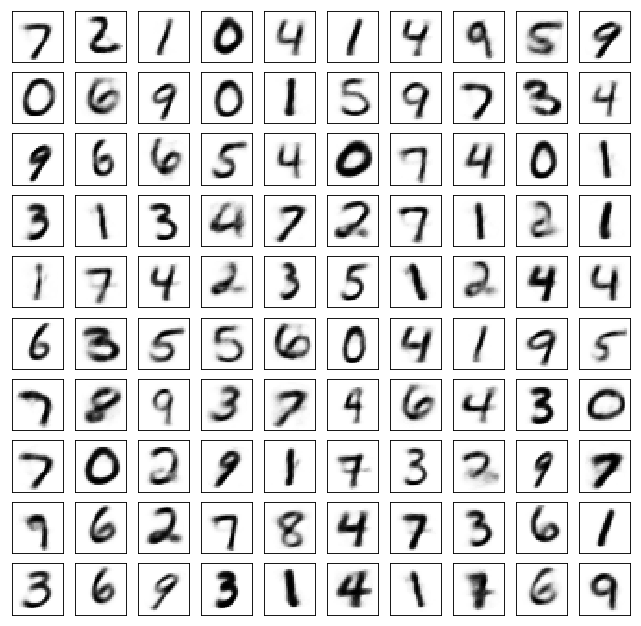

Test losses. E: 0.6838, AE: 0.0875, D: 0.7039
Train Epoch: 71 [0/50000 (0%)]	Losses E: 0.6861, AE: 0.0910, D: 0.7055
Train Epoch: 71 [25000/50000 (50%)]	Losses E: 0.6953, AE: 0.0922, D: 0.6996
Train Epoch: 71 [50000/50000 (100%)]	Losses E: 0.6326, AE: 0.0791, D: 0.6919


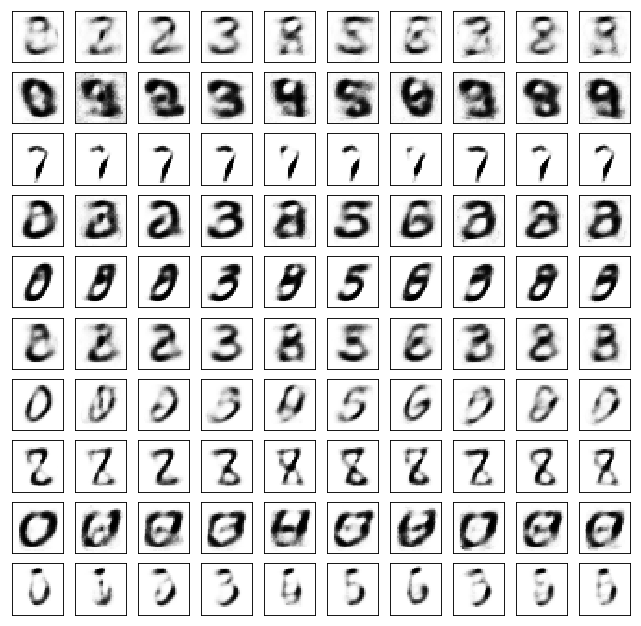

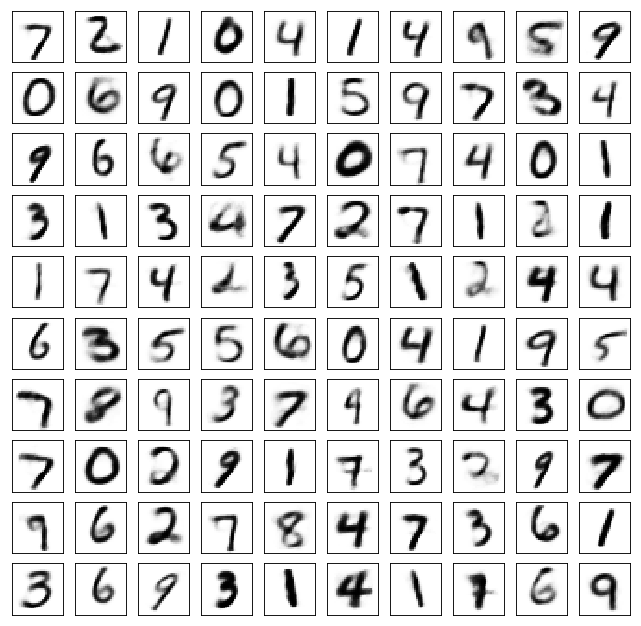

Test losses. E: 0.6297, AE: 0.0820, D: 0.6906
Train Epoch: 72 [0/50000 (0%)]	Losses E: 0.6307, AE: 0.0808, D: 0.6904
Train Epoch: 72 [25000/50000 (50%)]	Losses E: 0.6611, AE: 0.0884, D: 0.7031
Train Epoch: 72 [50000/50000 (100%)]	Losses E: 0.7684, AE: 0.0878, D: 0.6948


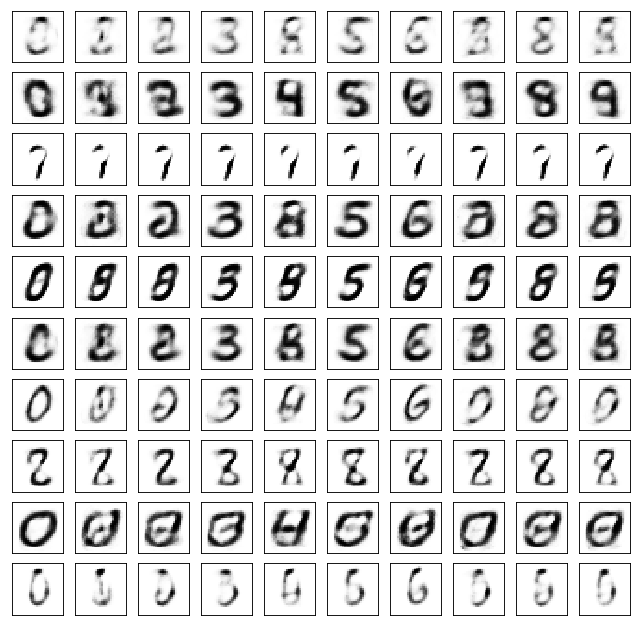

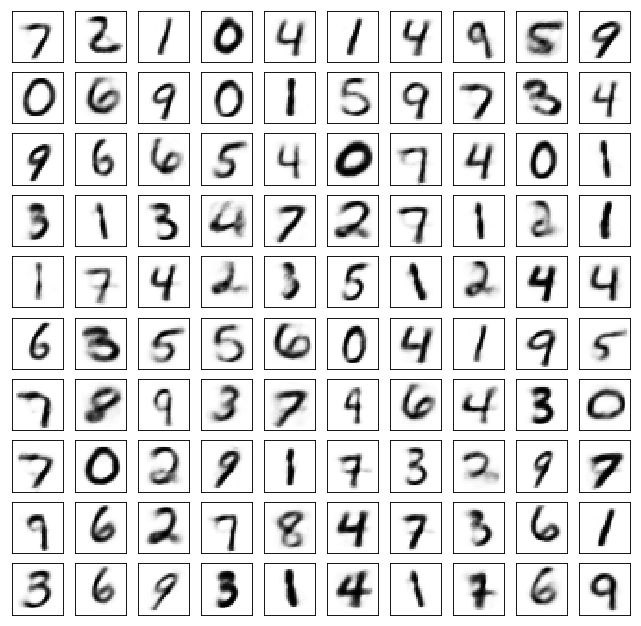

Test losses. E: 0.7680, AE: 0.0877, D: 0.6937
Train Epoch: 73 [0/50000 (0%)]	Losses E: 0.7678, AE: 0.0850, D: 0.6927
Train Epoch: 73 [25000/50000 (50%)]	Losses E: 0.7148, AE: 0.0981, D: 0.7089
Train Epoch: 73 [50000/50000 (100%)]	Losses E: 0.7794, AE: 0.1095, D: 0.6947


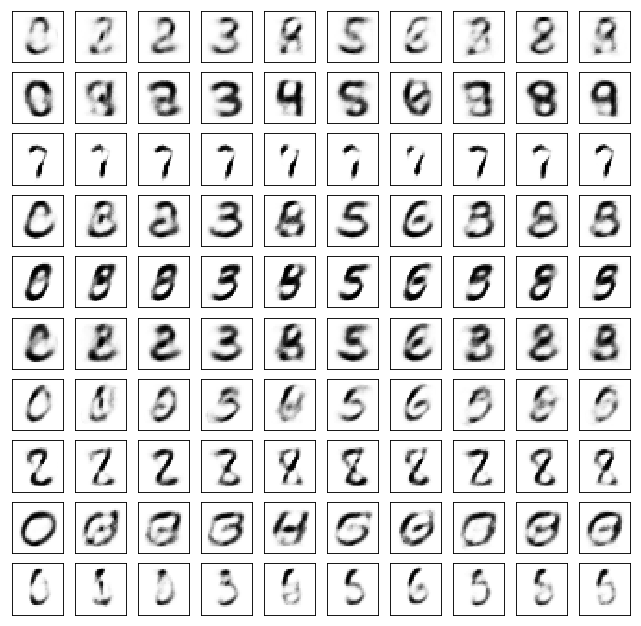

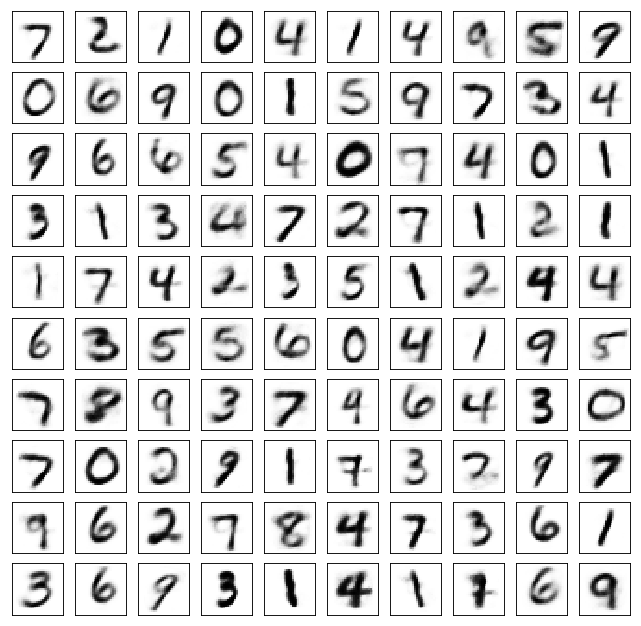

Test losses. E: 0.7556, AE: 0.1027, D: 0.6995
Train Epoch: 74 [0/50000 (0%)]	Losses E: 0.7720, AE: 0.0983, D: 0.7005
Train Epoch: 74 [25000/50000 (50%)]	Losses E: 0.7319, AE: 0.0951, D: 0.7017
Train Epoch: 74 [50000/50000 (100%)]	Losses E: 0.6928, AE: 0.0839, D: 0.7046


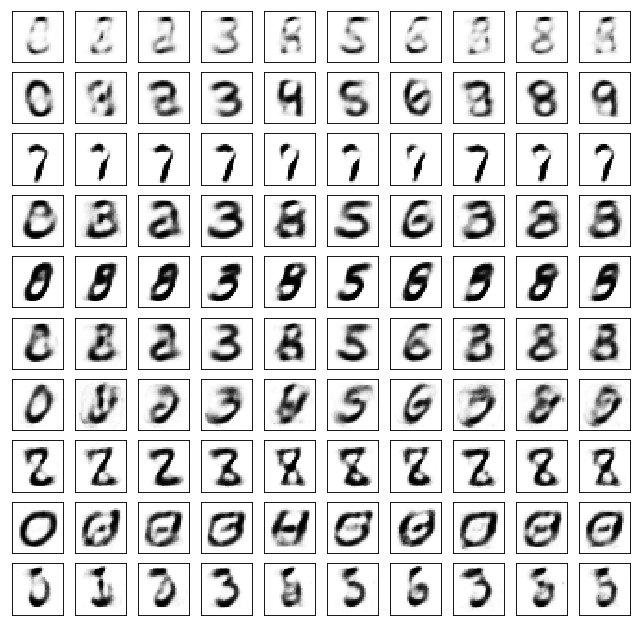

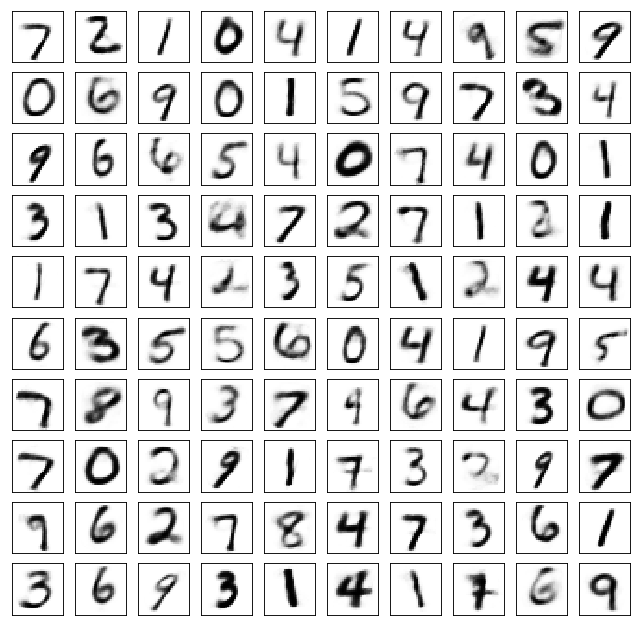

Test losses. E: 0.6892, AE: 0.0872, D: 0.7057
Train Epoch: 75 [0/50000 (0%)]	Losses E: 0.6927, AE: 0.0903, D: 0.7047
Train Epoch: 75 [25000/50000 (50%)]	Losses E: 0.6683, AE: 0.0823, D: 0.7181
Train Epoch: 75 [50000/50000 (100%)]	Losses E: 0.4371, AE: 0.0958, D: 0.9125


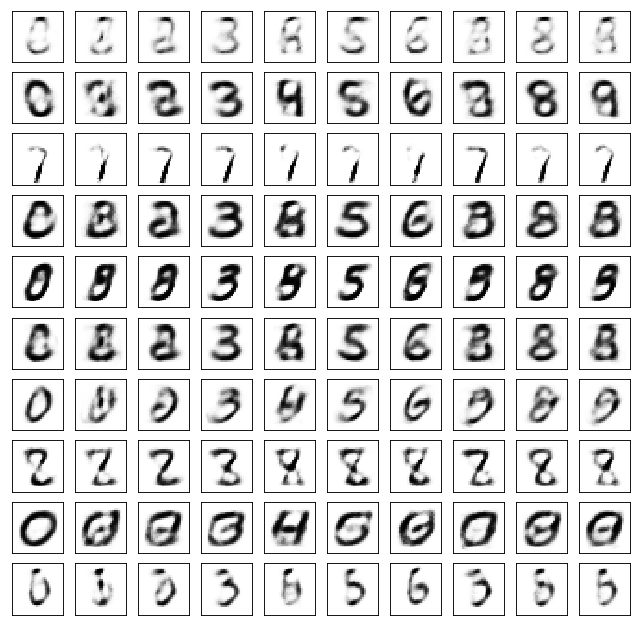

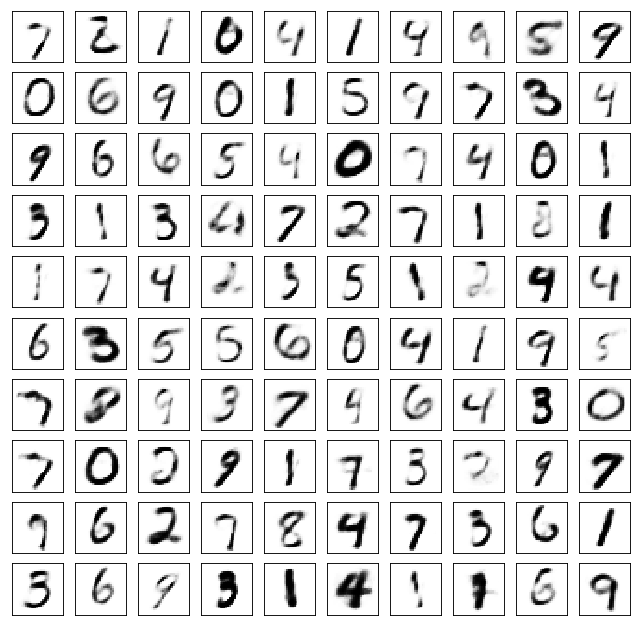

Test losses. E: 0.3719, AE: 0.1156, D: 0.9443
Train Epoch: 76 [0/50000 (0%)]	Losses E: 0.4165, AE: 0.1134, D: 0.9448
Train Epoch: 76 [25000/50000 (50%)]	Losses E: 0.6518, AE: 0.0927, D: 0.7008
Train Epoch: 76 [50000/50000 (100%)]	Losses E: 0.6322, AE: 0.0830, D: 0.6857


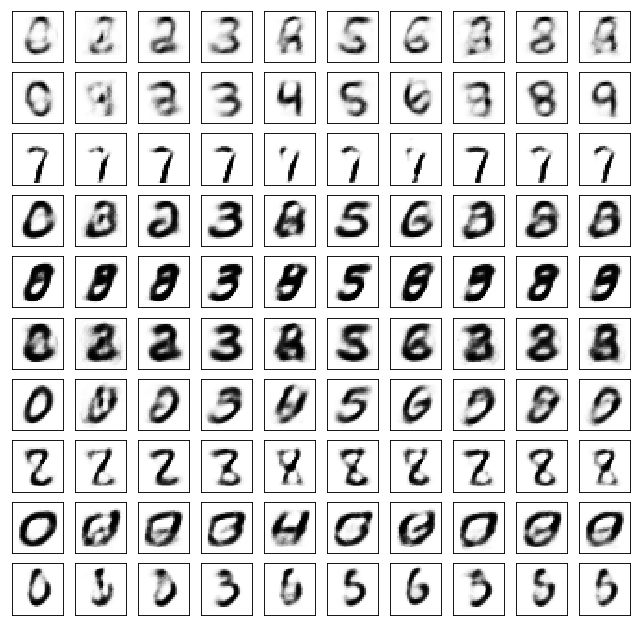

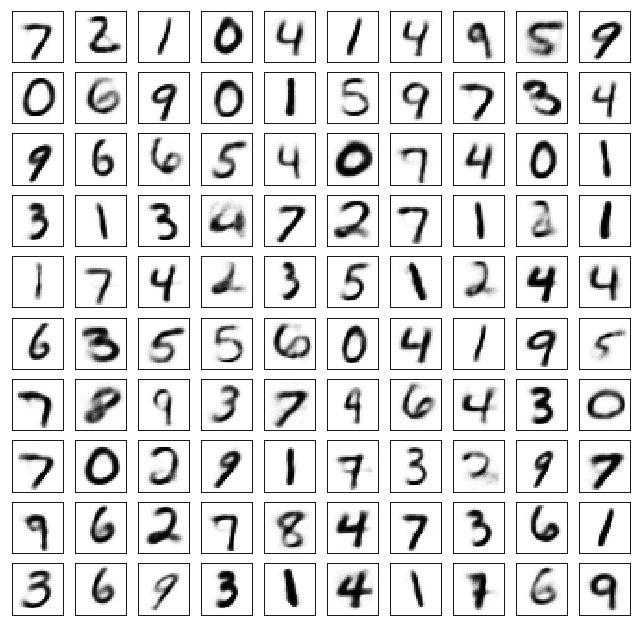

Test losses. E: 0.6278, AE: 0.0859, D: 0.6859
Train Epoch: 77 [0/50000 (0%)]	Losses E: 0.6301, AE: 0.0863, D: 0.6854
Train Epoch: 77 [25000/50000 (50%)]	Losses E: 0.6773, AE: 0.0848, D: 0.7026
Train Epoch: 77 [50000/50000 (100%)]	Losses E: 0.6688, AE: 0.0783, D: 0.7077


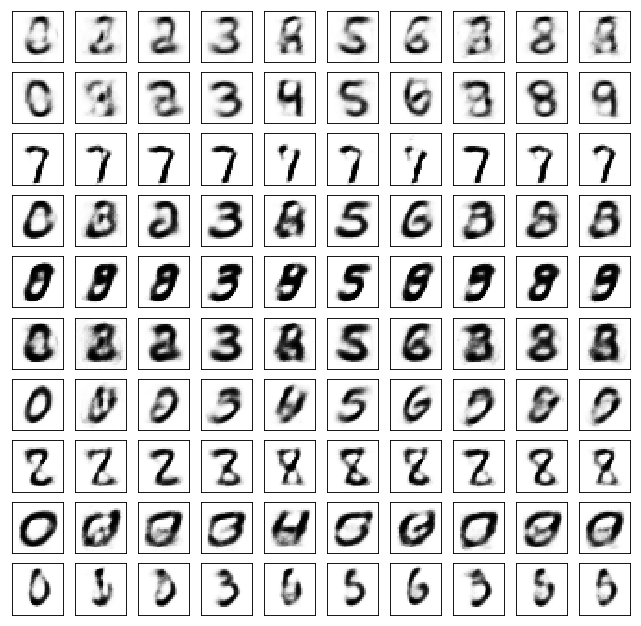

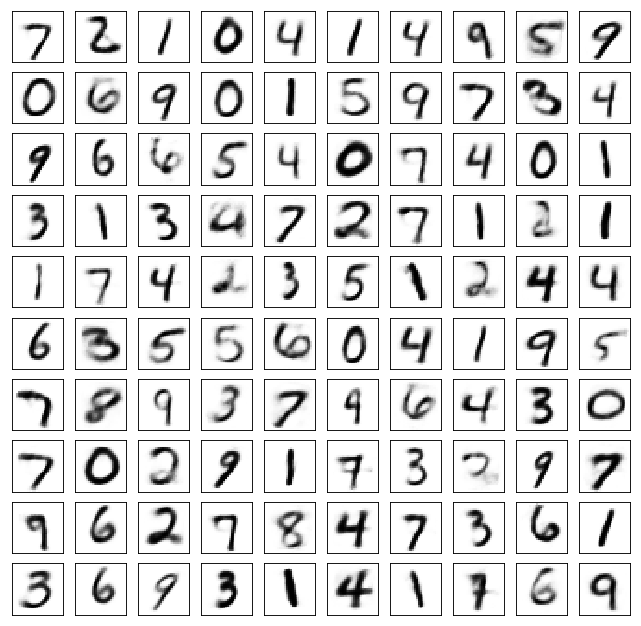

Test losses. E: 0.6681, AE: 0.0850, D: 0.7055
Train Epoch: 78 [0/50000 (0%)]	Losses E: 0.6709, AE: 0.0855, D: 0.7053
Train Epoch: 78 [25000/50000 (50%)]	Losses E: 0.6479, AE: 0.0907, D: 0.7022
Train Epoch: 78 [50000/50000 (100%)]	Losses E: 0.6818, AE: 0.0821, D: 0.6915


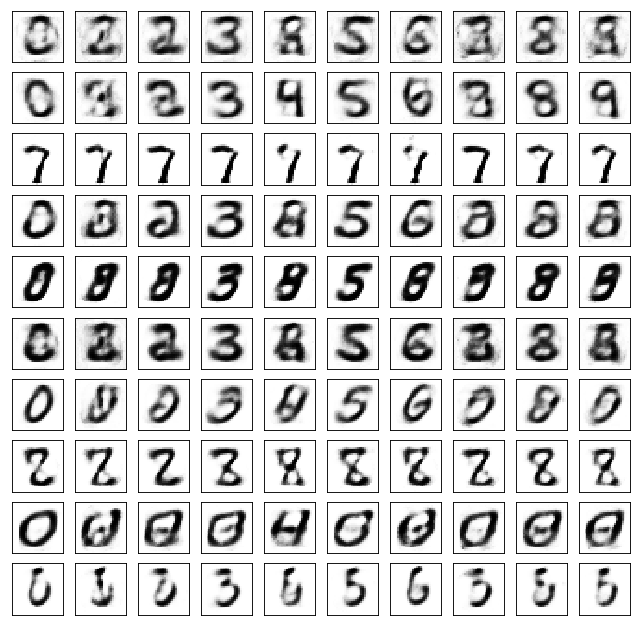

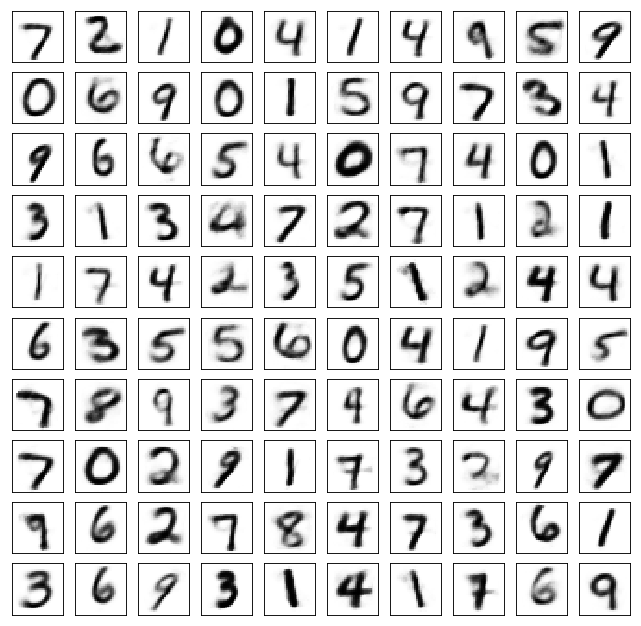

Test losses. E: 0.6797, AE: 0.0864, D: 0.6891
Train Epoch: 79 [0/50000 (0%)]	Losses E: 0.6777, AE: 0.0836, D: 0.6891
Train Epoch: 79 [25000/50000 (50%)]	Losses E: 0.7182, AE: 0.0825, D: 0.6935
Train Epoch: 79 [50000/50000 (100%)]	Losses E: 0.6437, AE: 0.0914, D: 0.7053


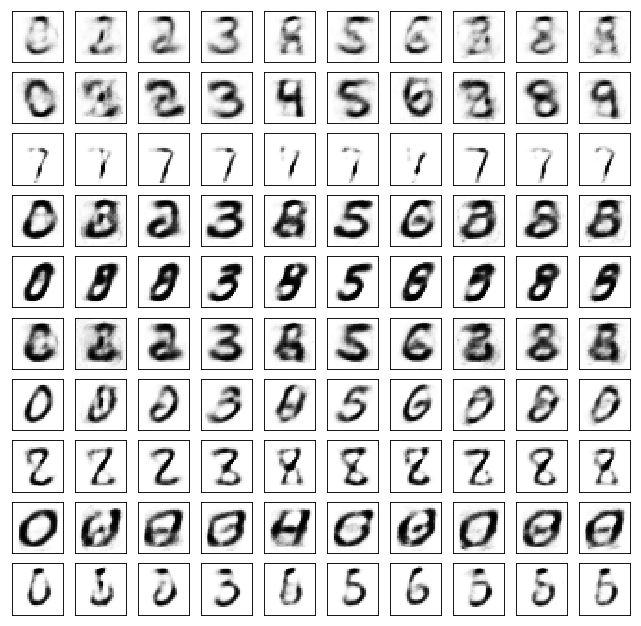

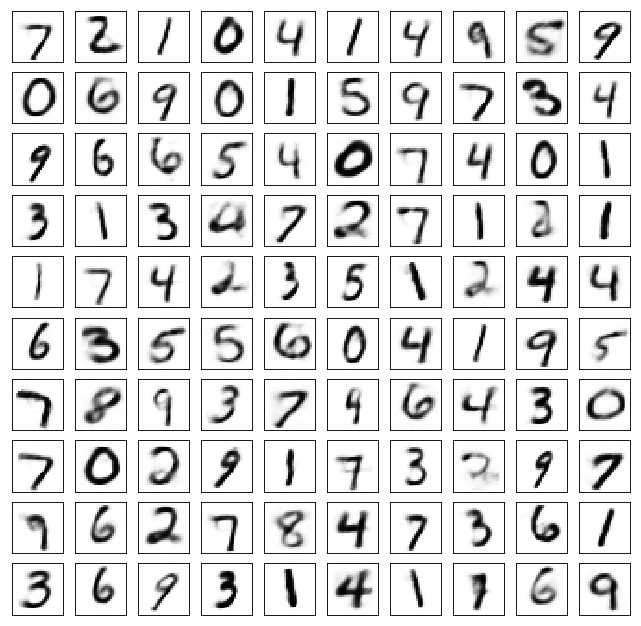

Test losses. E: 0.6387, AE: 0.0917, D: 0.7064
Train Epoch: 80 [0/50000 (0%)]	Losses E: 0.6388, AE: 0.0938, D: 0.7050
Train Epoch: 80 [25000/50000 (50%)]	Losses E: 0.6048, AE: 0.0966, D: 0.7175
Train Epoch: 80 [50000/50000 (100%)]	Losses E: 0.6663, AE: 0.0790, D: 0.6933


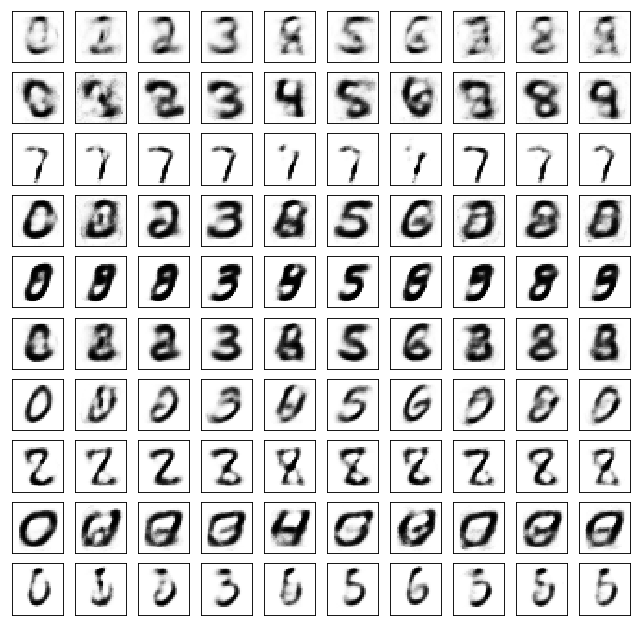

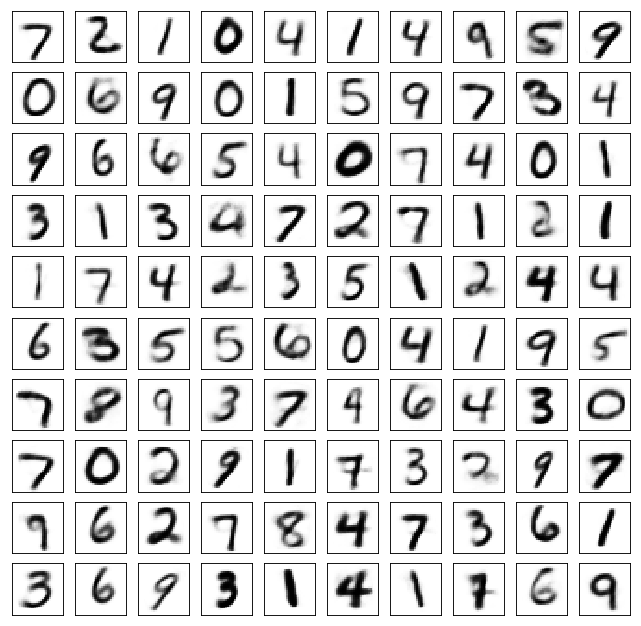

Test losses. E: 0.6657, AE: 0.0810, D: 0.6921
Train Epoch: 81 [0/50000 (0%)]	Losses E: 0.6686, AE: 0.0842, D: 0.6919
Train Epoch: 81 [25000/50000 (50%)]	Losses E: 0.7022, AE: 0.0791, D: 0.6892
Train Epoch: 81 [50000/50000 (100%)]	Losses E: 0.7000, AE: 0.0810, D: 0.6923


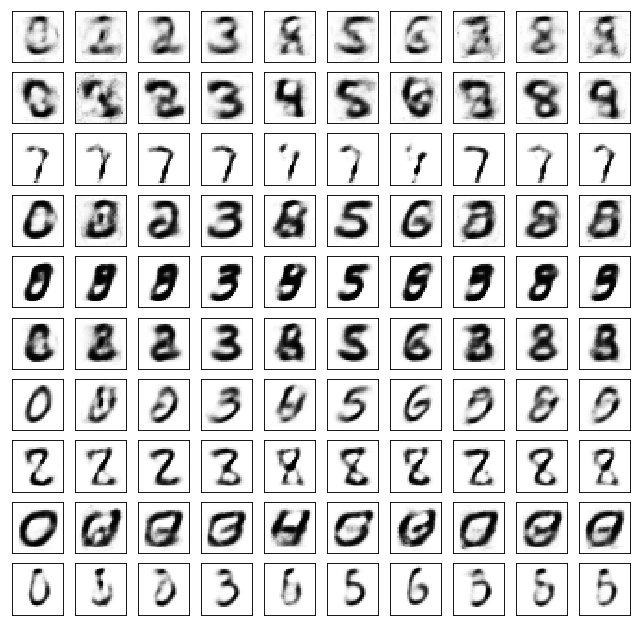

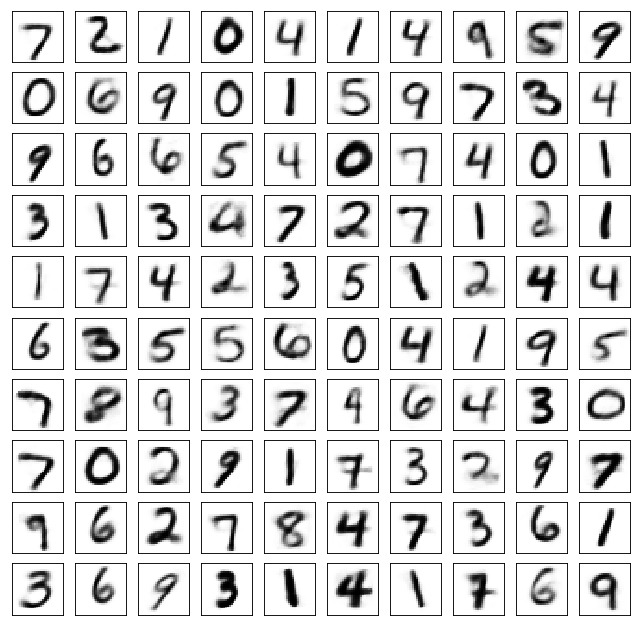

Test losses. E: 0.6983, AE: 0.0800, D: 0.6901
Train Epoch: 82 [0/50000 (0%)]	Losses E: 0.6994, AE: 0.0773, D: 0.6905
Train Epoch: 82 [25000/50000 (50%)]	Losses E: 0.7569, AE: 0.0821, D: 0.6995
Train Epoch: 82 [50000/50000 (100%)]	Losses E: 0.6321, AE: 0.0822, D: 0.6979


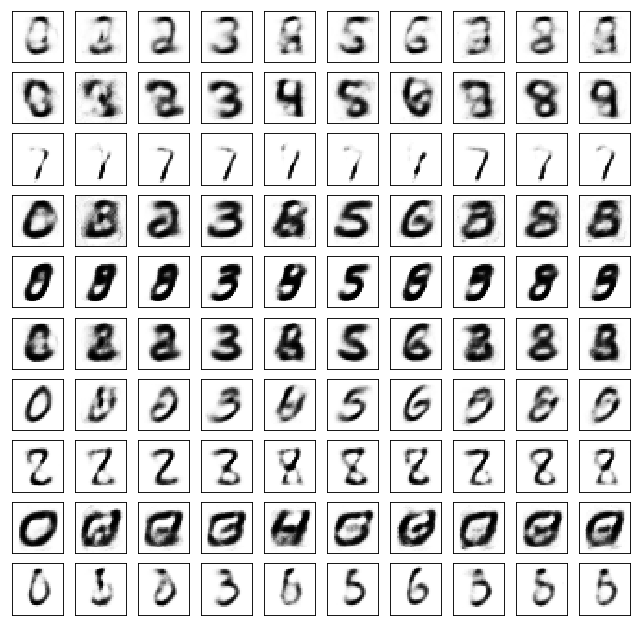

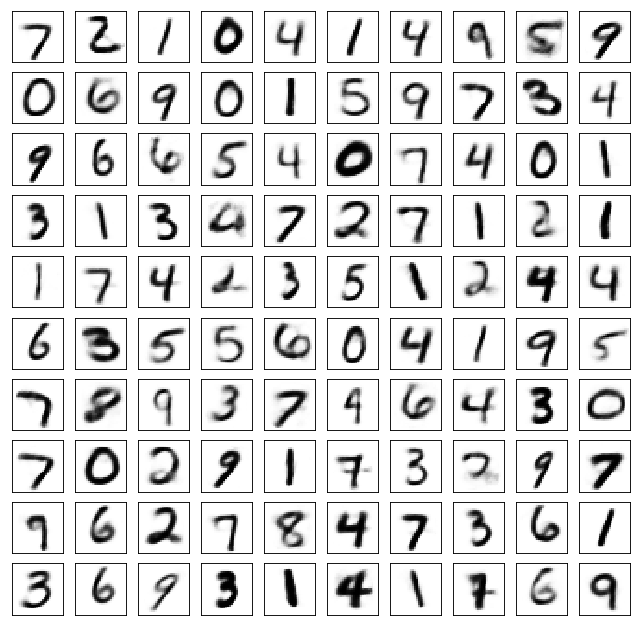

Test losses. E: 0.6317, AE: 0.0796, D: 0.6981
Train Epoch: 83 [0/50000 (0%)]	Losses E: 0.6329, AE: 0.0775, D: 0.7008
Train Epoch: 83 [25000/50000 (50%)]	Losses E: 0.6276, AE: 0.0967, D: 0.7718
Train Epoch: 83 [50000/50000 (100%)]	Losses E: 0.7091, AE: 0.0847, D: 0.6996


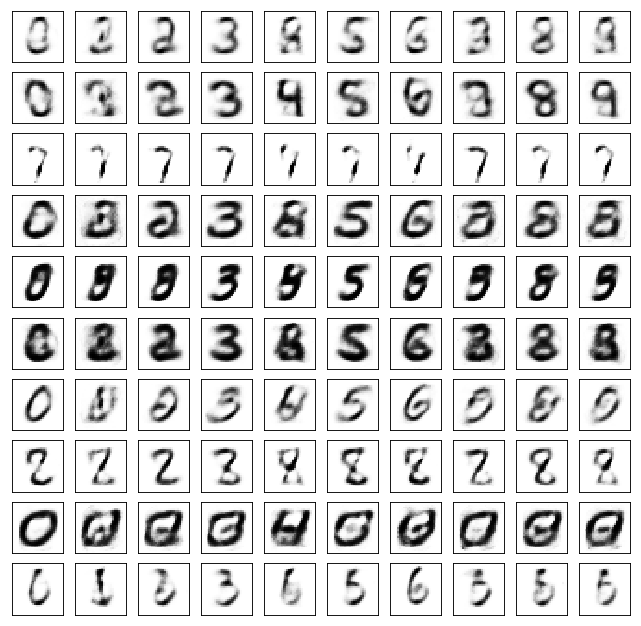

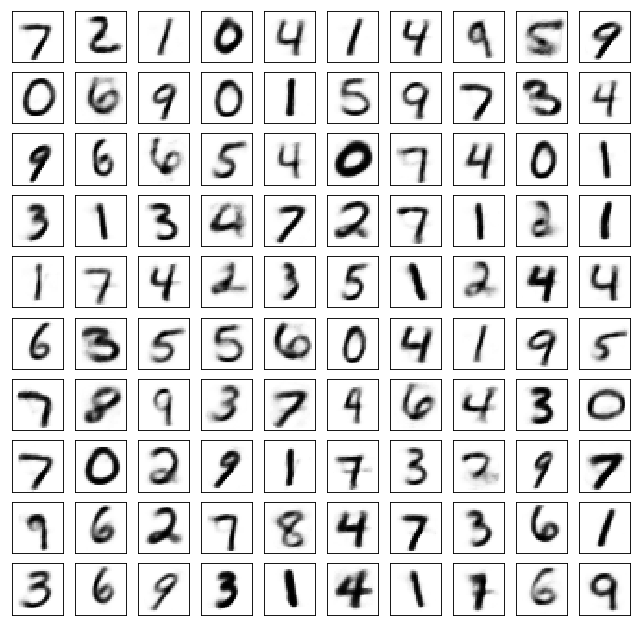

Test losses. E: 0.7061, AE: 0.0835, D: 0.7004
Train Epoch: 84 [0/50000 (0%)]	Losses E: 0.7120, AE: 0.0850, D: 0.7001
Train Epoch: 84 [25000/50000 (50%)]	Losses E: 0.5937, AE: 0.0951, D: 0.7558
Train Epoch: 84 [50000/50000 (100%)]	Losses E: 0.7388, AE: 0.0773, D: 0.6860


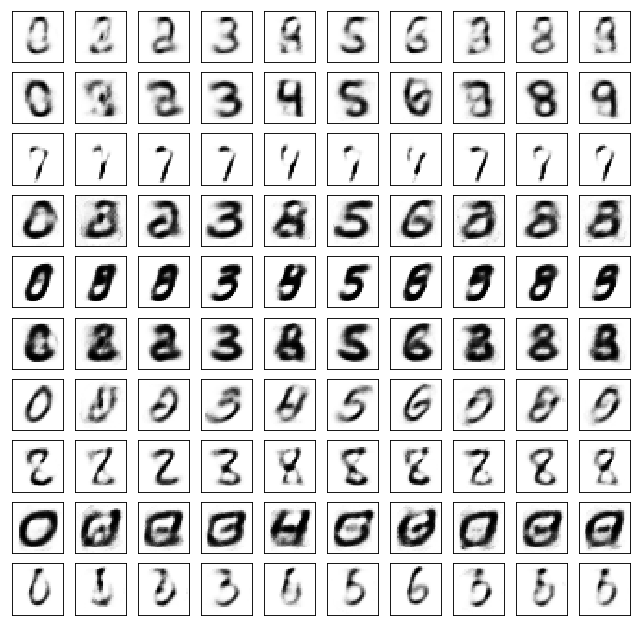

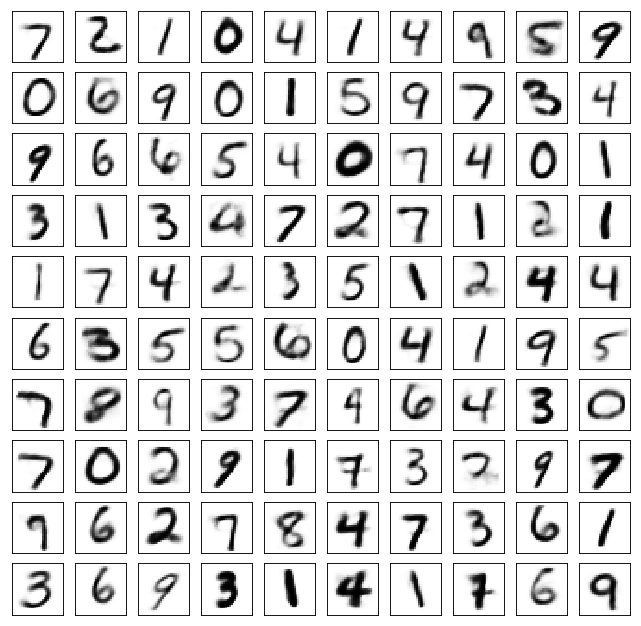

Test losses. E: 0.7375, AE: 0.0796, D: 0.6827
Train Epoch: 85 [0/50000 (0%)]	Losses E: 0.7442, AE: 0.0804, D: 0.6814
Train Epoch: 85 [25000/50000 (50%)]	Losses E: 0.7126, AE: 0.0811, D: 0.7047
Train Epoch: 85 [50000/50000 (100%)]	Losses E: 0.7122, AE: 0.0792, D: 0.7017


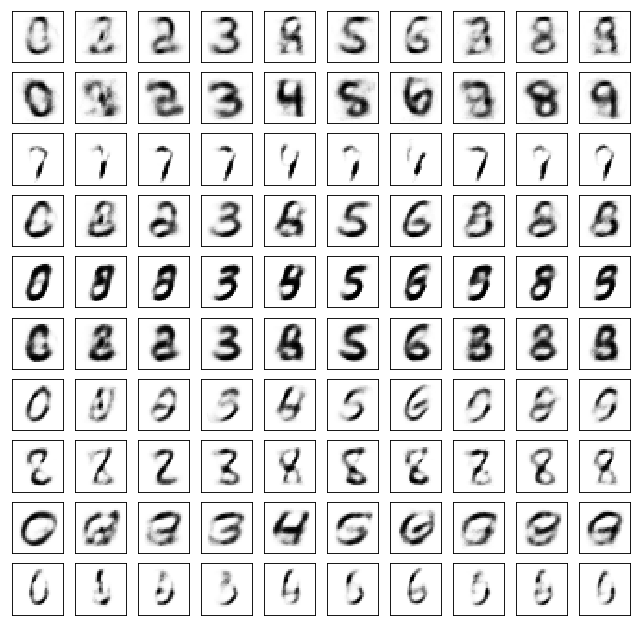

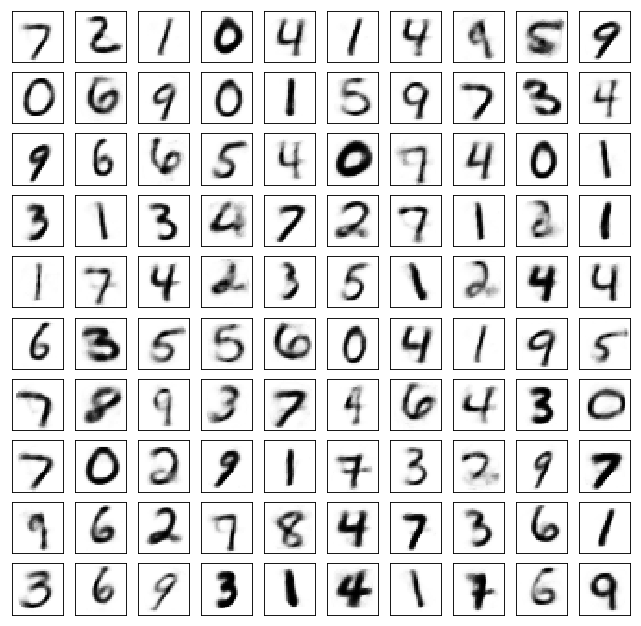

Test losses. E: 0.7077, AE: 0.0841, D: 0.7020
Train Epoch: 86 [0/50000 (0%)]	Losses E: 0.7166, AE: 0.0891, D: 0.7000
Train Epoch: 86 [25000/50000 (50%)]	Losses E: 0.6776, AE: 0.0874, D: 0.7057
Train Epoch: 86 [50000/50000 (100%)]	Losses E: 0.7293, AE: 0.0781, D: 0.6929


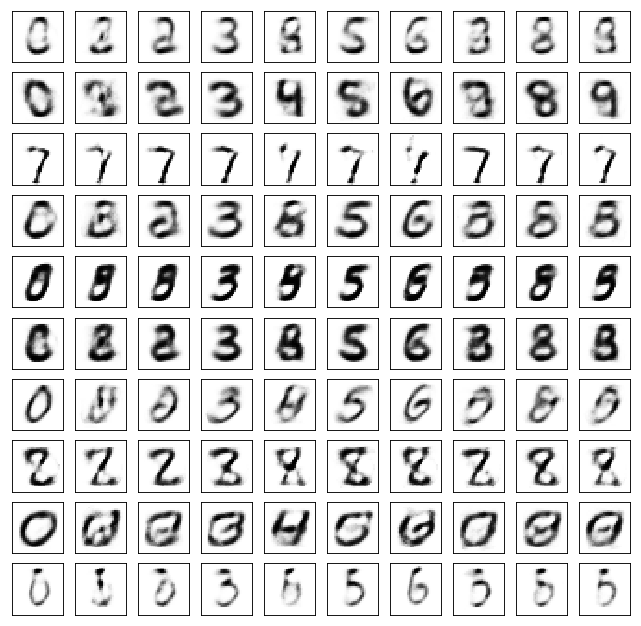

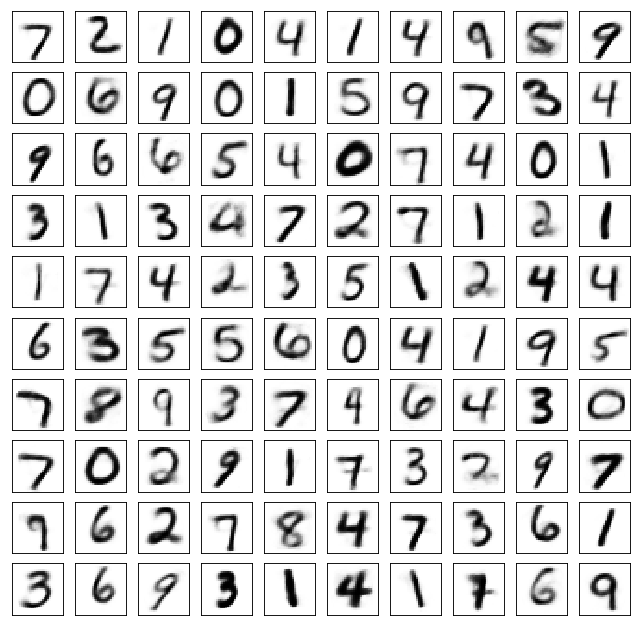

Test losses. E: 0.7286, AE: 0.0790, D: 0.6934
Train Epoch: 87 [0/50000 (0%)]	Losses E: 0.7300, AE: 0.0755, D: 0.6945
Train Epoch: 87 [25000/50000 (50%)]	Losses E: 0.6450, AE: 0.0759, D: 0.7048
Train Epoch: 87 [50000/50000 (100%)]	Losses E: 0.6963, AE: 0.0873, D: 0.6841


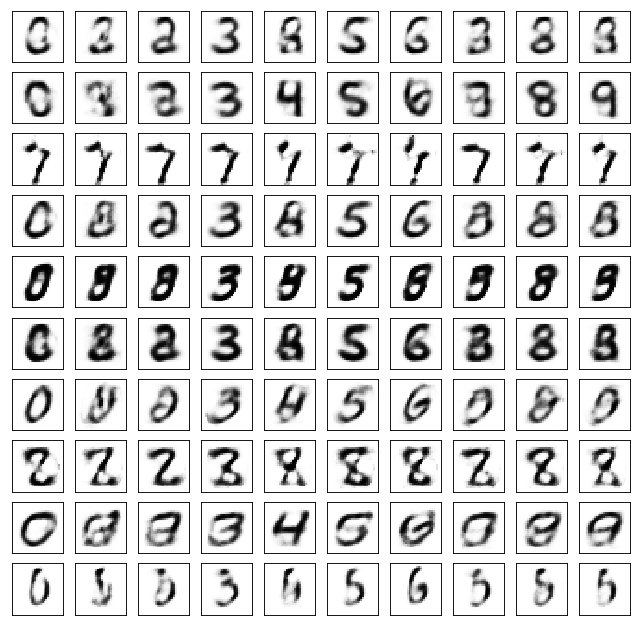

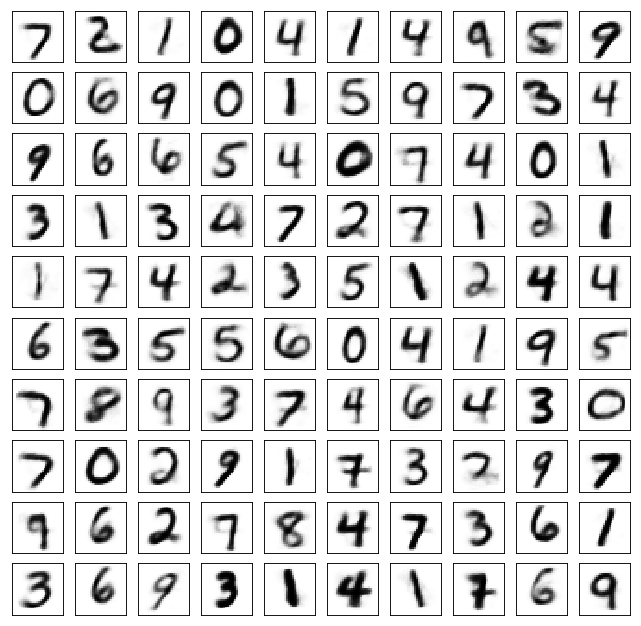

Test losses. E: 0.6856, AE: 0.0931, D: 0.6843
Train Epoch: 88 [0/50000 (0%)]	Losses E: 0.6944, AE: 0.0878, D: 0.6836
Train Epoch: 88 [25000/50000 (50%)]	Losses E: 0.6617, AE: 0.0799, D: 0.6972
Train Epoch: 88 [50000/50000 (100%)]	Losses E: 0.7286, AE: 0.0807, D: 0.7018


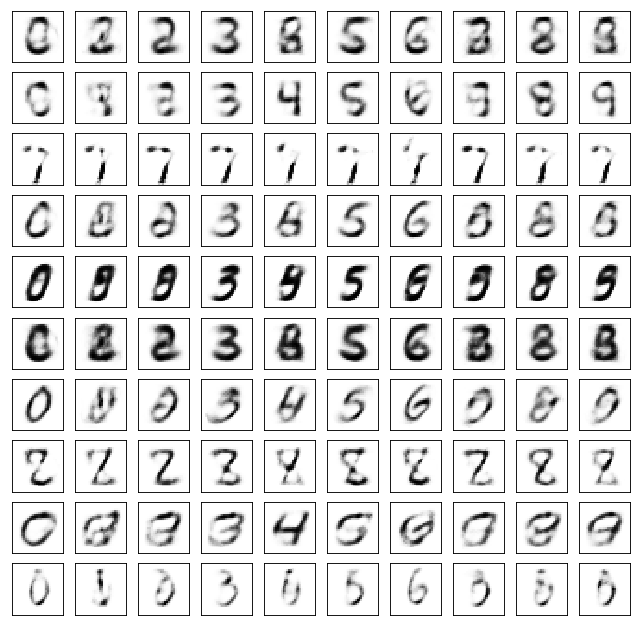

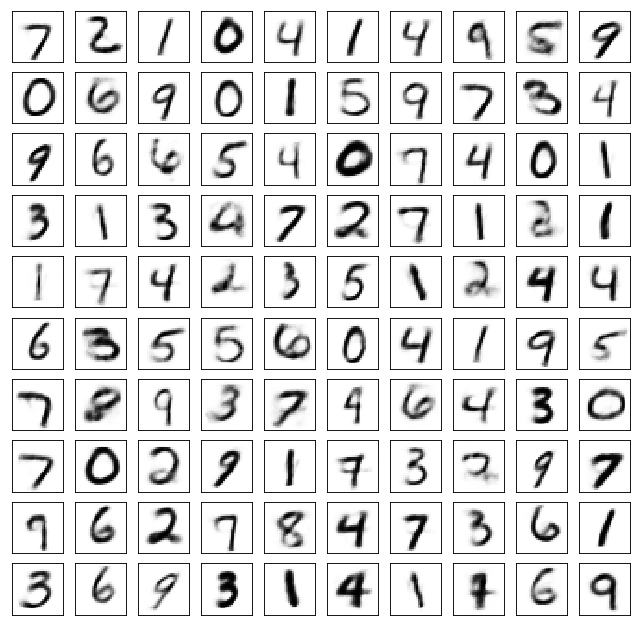

Test losses. E: 0.7220, AE: 0.0841, D: 0.7018
Train Epoch: 89 [0/50000 (0%)]	Losses E: 0.7335, AE: 0.0823, D: 0.6986
Train Epoch: 89 [25000/50000 (50%)]	Losses E: 0.7362, AE: 0.0788, D: 0.6907
Train Epoch: 89 [50000/50000 (100%)]	Losses E: 0.6550, AE: 0.0729, D: 0.6945


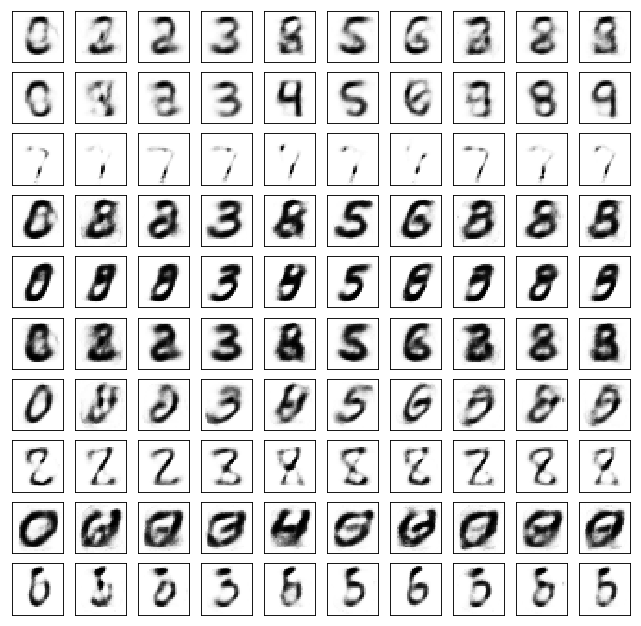

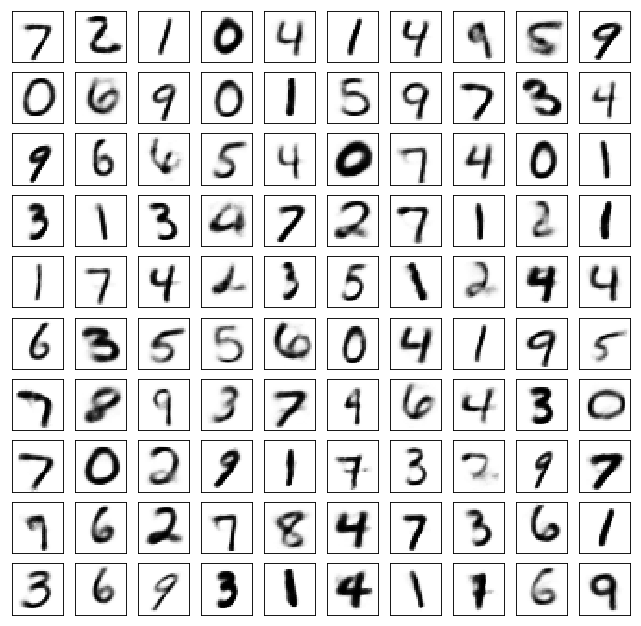

Test losses. E: 0.6505, AE: 0.0791, D: 0.6957
Train Epoch: 90 [0/50000 (0%)]	Losses E: 0.6512, AE: 0.0744, D: 0.6932
Train Epoch: 90 [25000/50000 (50%)]	Losses E: 0.6403, AE: 0.1164, D: 0.8088
Train Epoch: 90 [50000/50000 (100%)]	Losses E: 0.6469, AE: 0.0790, D: 0.7007


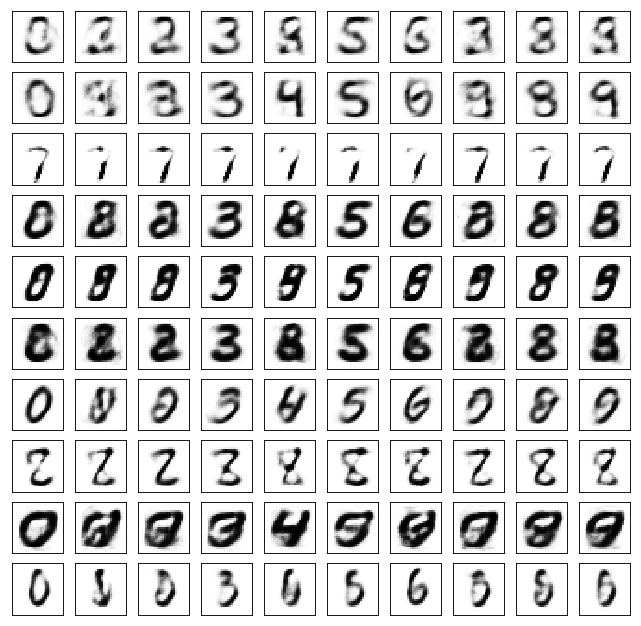

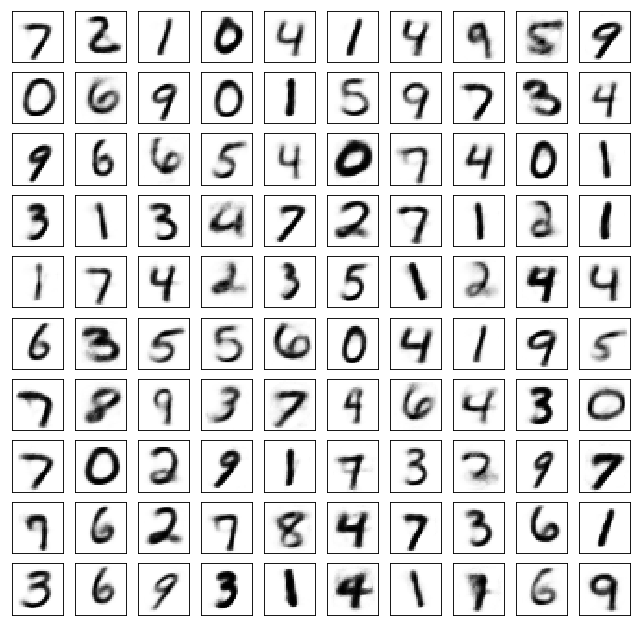

Test losses. E: 0.6438, AE: 0.0850, D: 0.6999
Train Epoch: 91 [0/50000 (0%)]	Losses E: 0.6510, AE: 0.0827, D: 0.6991
Train Epoch: 91 [25000/50000 (50%)]	Losses E: 0.6981, AE: 0.0838, D: 0.6982
Train Epoch: 91 [50000/50000 (100%)]	Losses E: 0.7344, AE: 0.0737, D: 0.6892


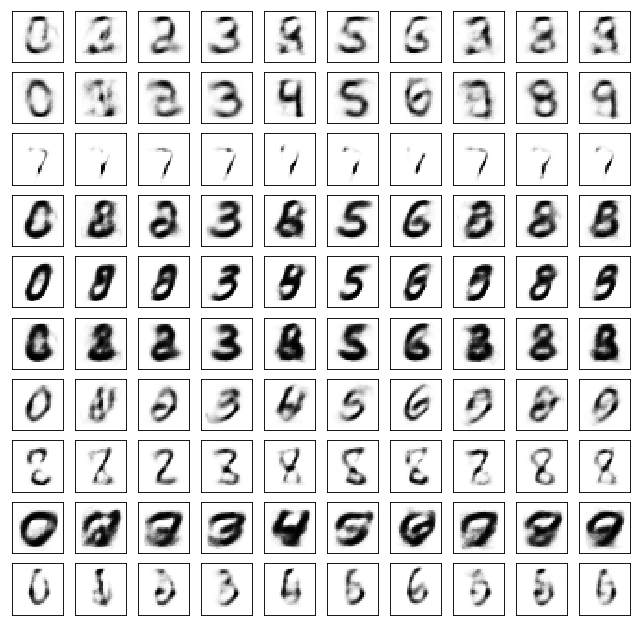

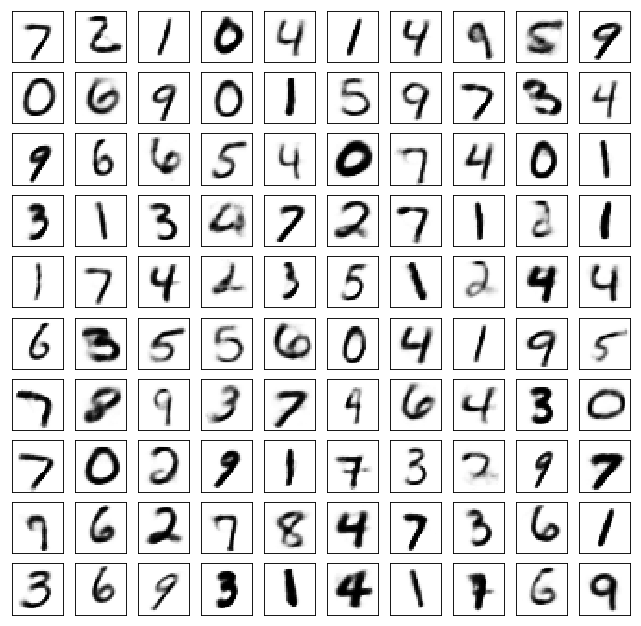

Test losses. E: 0.7340, AE: 0.0799, D: 0.6894
Train Epoch: 92 [0/50000 (0%)]	Losses E: 0.7379, AE: 0.0801, D: 0.6880
Train Epoch: 92 [25000/50000 (50%)]	Losses E: 0.6826, AE: 0.0817, D: 0.6943
Train Epoch: 92 [50000/50000 (100%)]	Losses E: 0.6074, AE: 0.0815, D: 0.7314


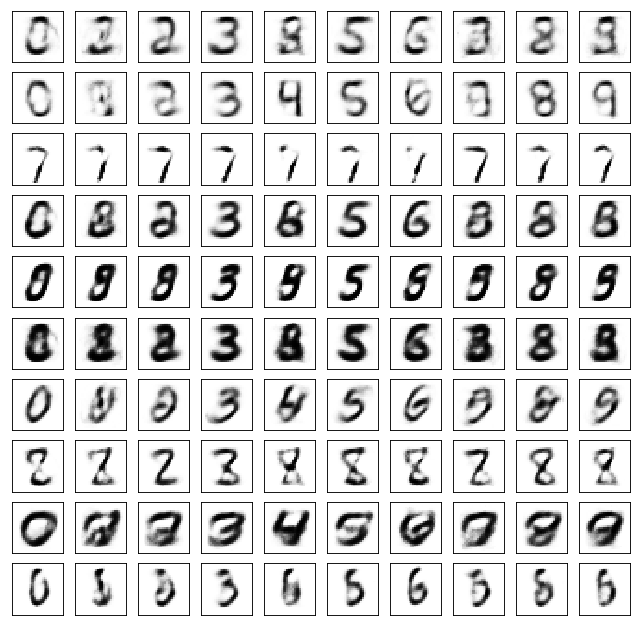

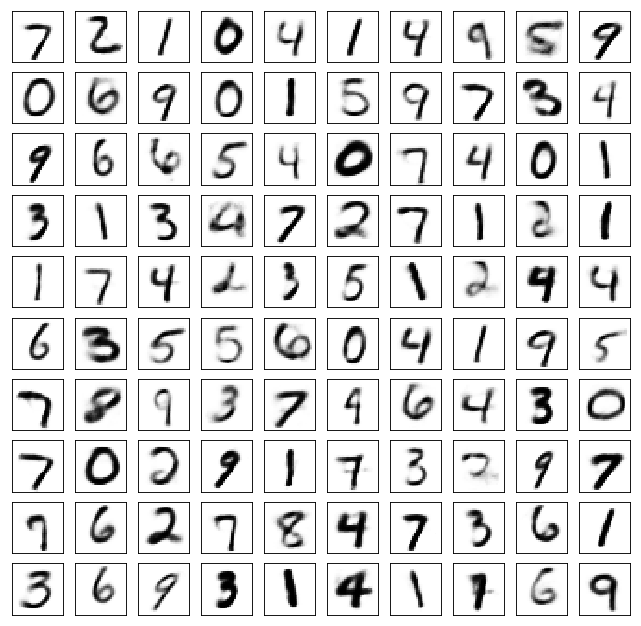

Test losses. E: 0.5966, AE: 0.0827, D: 0.7306
Train Epoch: 93 [0/50000 (0%)]	Losses E: 0.6045, AE: 0.0807, D: 0.7313
Train Epoch: 93 [25000/50000 (50%)]	Losses E: 0.6833, AE: 0.0805, D: 0.6864
Train Epoch: 93 [50000/50000 (100%)]	Losses E: 0.7124, AE: 0.0791, D: 0.7010


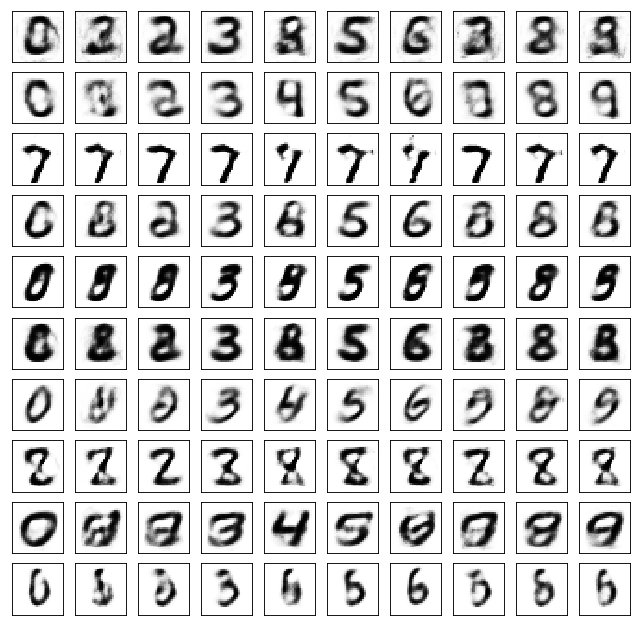

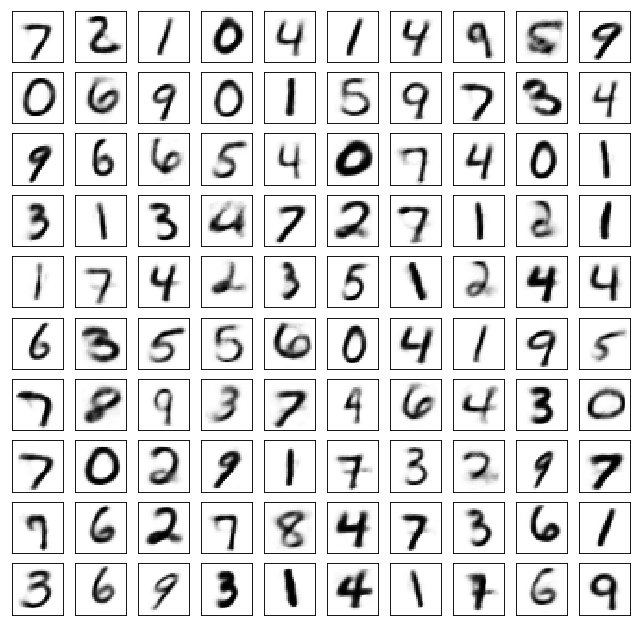

Test losses. E: 0.7111, AE: 0.0791, D: 0.7000
Train Epoch: 94 [0/50000 (0%)]	Losses E: 0.7102, AE: 0.0801, D: 0.7004
Train Epoch: 94 [25000/50000 (50%)]	Losses E: 0.7342, AE: 0.0810, D: 0.7004
Train Epoch: 94 [50000/50000 (100%)]	Losses E: 0.6942, AE: 0.1033, D: 0.7297


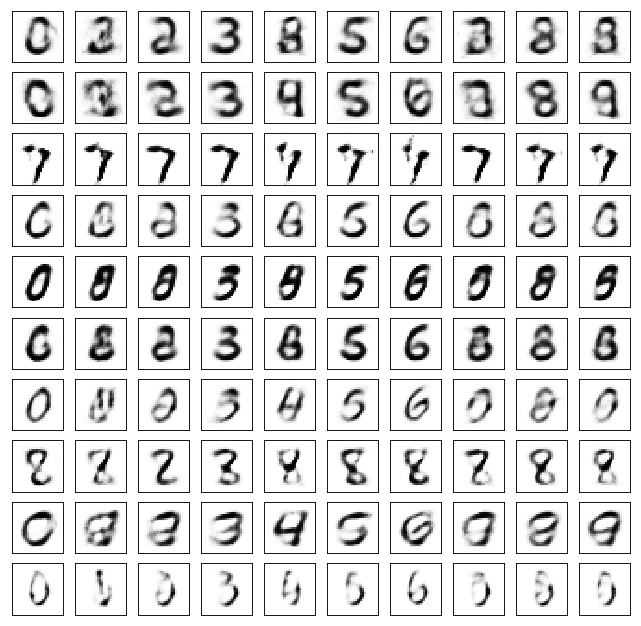

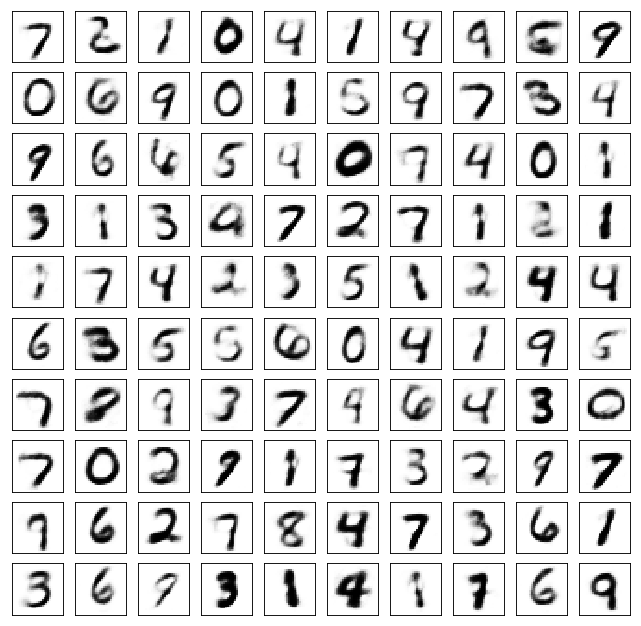

Test losses. E: 0.6716, AE: 0.1057, D: 0.7159
Train Epoch: 95 [0/50000 (0%)]	Losses E: 0.7170, AE: 0.1027, D: 0.7155
Train Epoch: 95 [25000/50000 (50%)]	Losses E: 0.5802, AE: 0.0813, D: 0.7574
Train Epoch: 95 [50000/50000 (100%)]	Losses E: 0.6762, AE: 0.0777, D: 0.7074


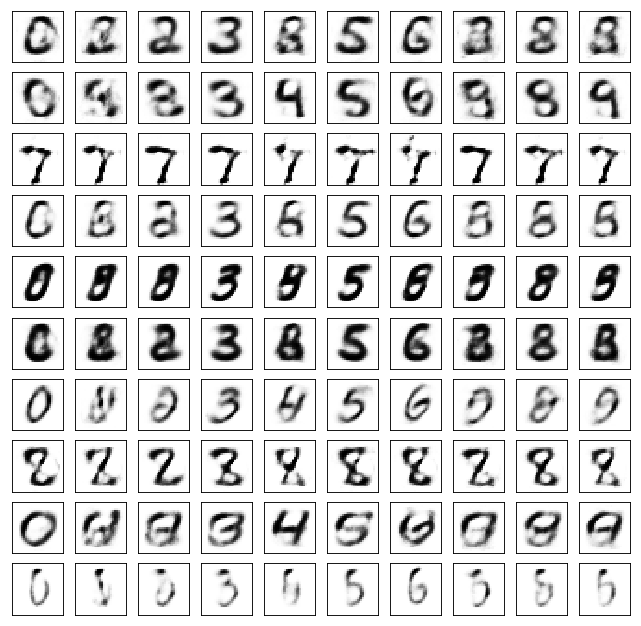

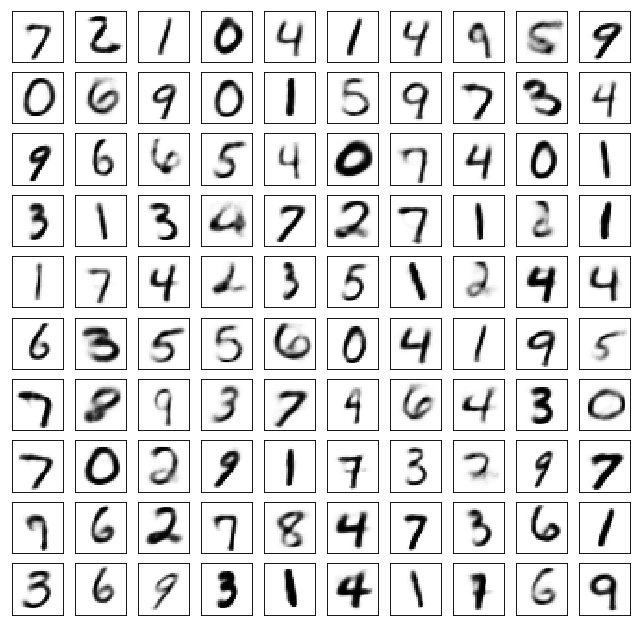

Test losses. E: 0.6733, AE: 0.0814, D: 0.7081
Train Epoch: 96 [0/50000 (0%)]	Losses E: 0.6708, AE: 0.0792, D: 0.7093
Train Epoch: 96 [25000/50000 (50%)]	Losses E: 0.7493, AE: 0.0759, D: 0.6904
Train Epoch: 96 [50000/50000 (100%)]	Losses E: 0.6570, AE: 0.0725, D: 0.7075


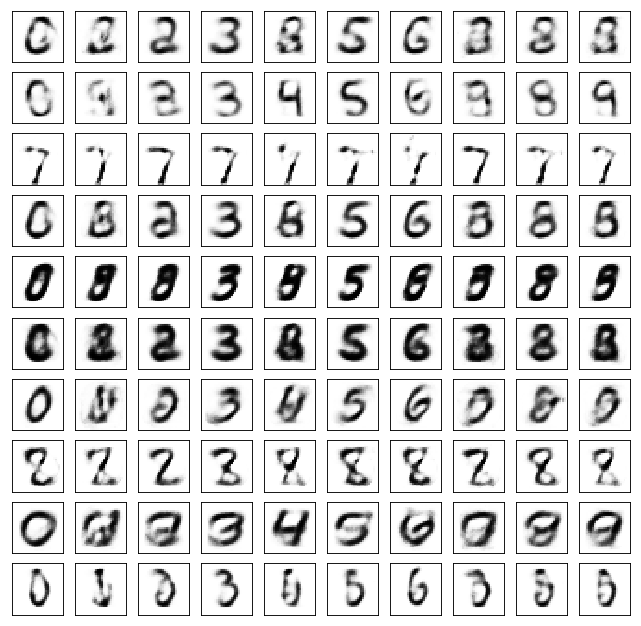

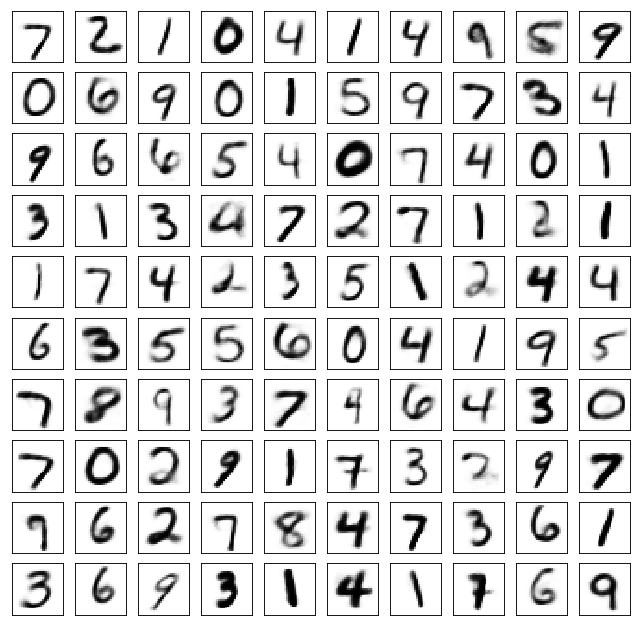

Test losses. E: 0.6558, AE: 0.0759, D: 0.7058
Train Epoch: 97 [0/50000 (0%)]	Losses E: 0.6576, AE: 0.0742, D: 0.7069
Train Epoch: 97 [25000/50000 (50%)]	Losses E: 0.6910, AE: 0.0754, D: 0.6936
Train Epoch: 97 [50000/50000 (100%)]	Losses E: 0.7047, AE: 0.0782, D: 0.6987


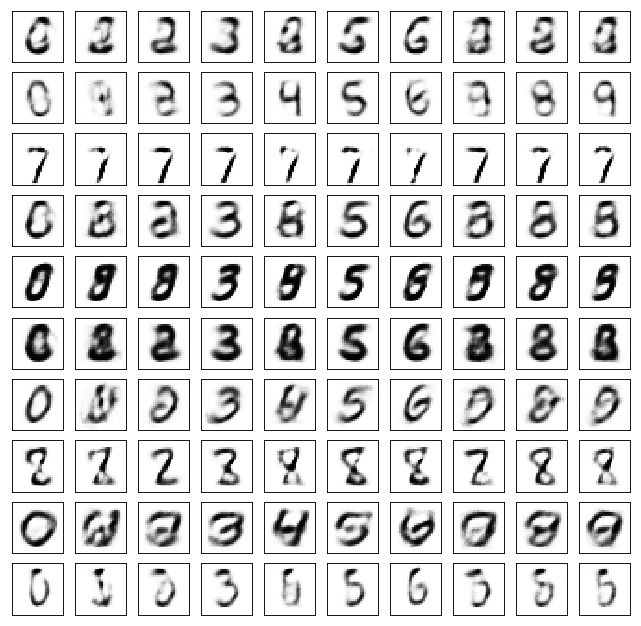

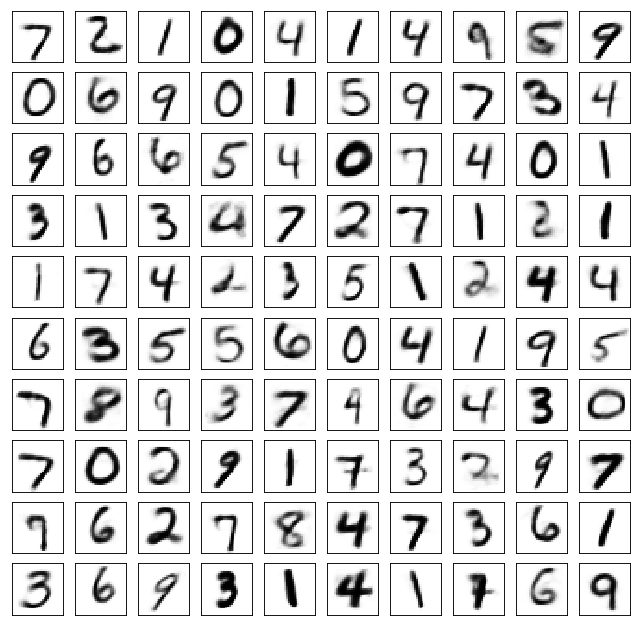

Test losses. E: 0.7026, AE: 0.0747, D: 0.6990
Train Epoch: 98 [0/50000 (0%)]	Losses E: 0.7040, AE: 0.0760, D: 0.6995
Train Epoch: 98 [25000/50000 (50%)]	Losses E: 0.7525, AE: 0.0805, D: 0.6985
Train Epoch: 98 [50000/50000 (100%)]	Losses E: 0.6510, AE: 0.0733, D: 0.7109


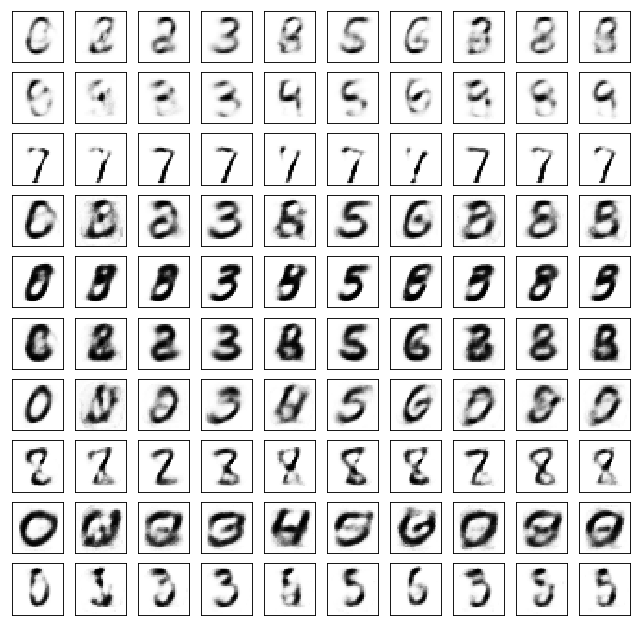

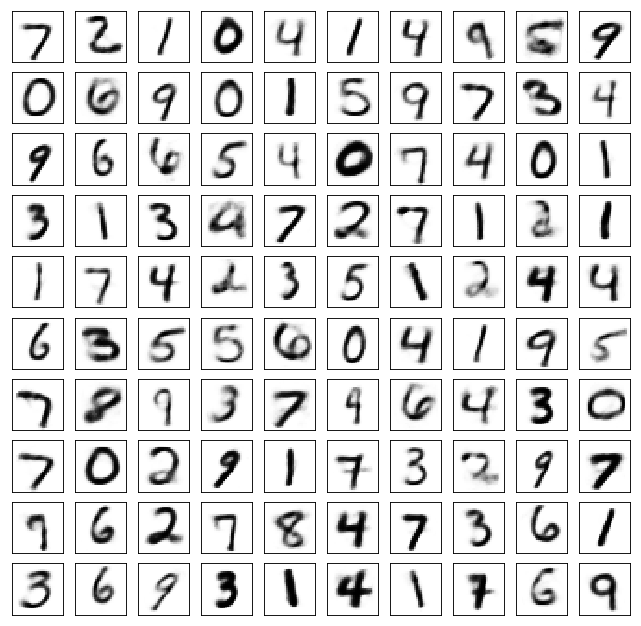

Test losses. E: 0.6466, AE: 0.0768, D: 0.7102
Train Epoch: 99 [0/50000 (0%)]	Losses E: 0.6538, AE: 0.0757, D: 0.7113
Train Epoch: 99 [25000/50000 (50%)]	Losses E: 0.6627, AE: 0.0744, D: 0.6880
Train Epoch: 99 [50000/50000 (100%)]	Losses E: 0.7278, AE: 0.0763, D: 0.6979


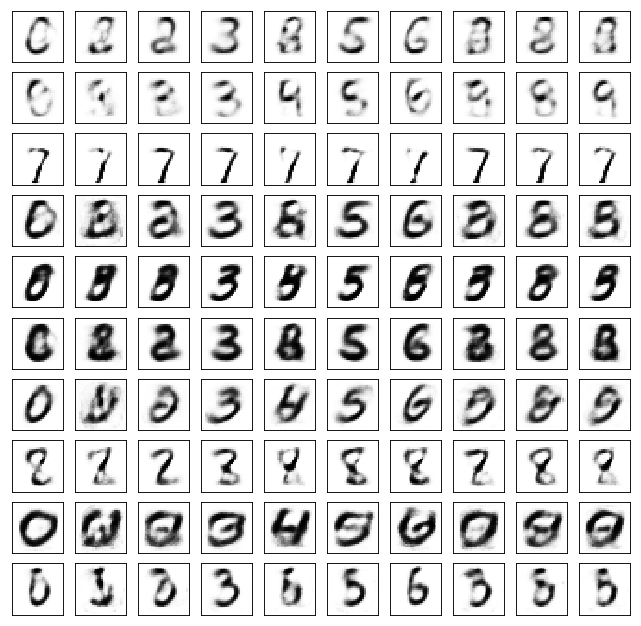

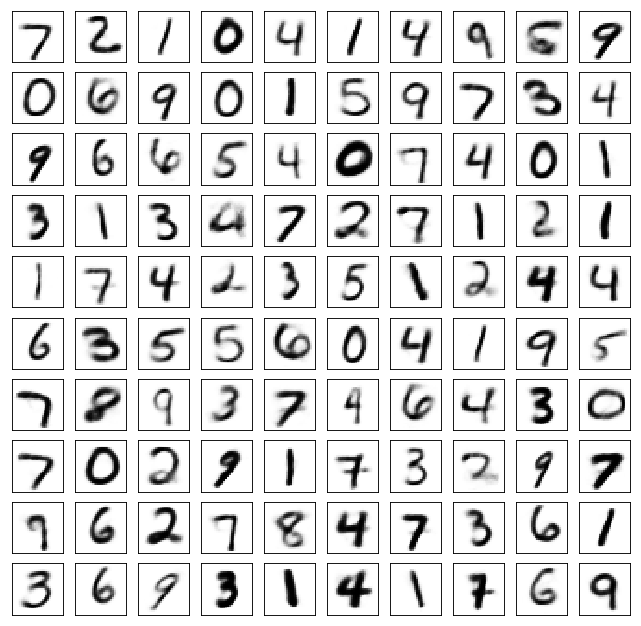

Test losses. E: 0.7277, AE: 0.0730, D: 0.6979
Train Epoch: 100 [0/50000 (0%)]	Losses E: 0.7260, AE: 0.0740, D: 0.6976
Train Epoch: 100 [25000/50000 (50%)]	Losses E: 0.7339, AE: 0.0728, D: 0.6932
Train Epoch: 100 [50000/50000 (100%)]	Losses E: 0.7227, AE: 0.0726, D: 0.6948


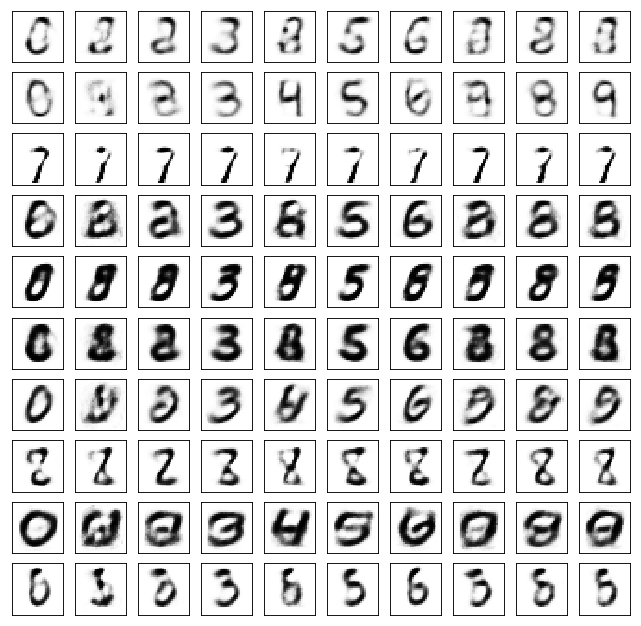

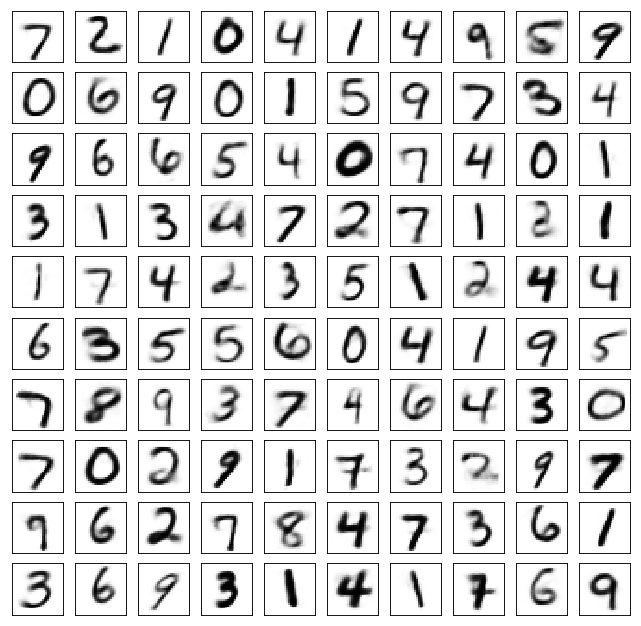

Test losses. E: 0.7209, AE: 0.0751, D: 0.6939
Train Epoch: 101 [0/50000 (0%)]	Losses E: 0.7221, AE: 0.0798, D: 0.6921
Train Epoch: 101 [25000/50000 (50%)]	Losses E: 0.6576, AE: 0.0748, D: 0.7002
Train Epoch: 101 [50000/50000 (100%)]	Losses E: 0.6782, AE: 0.0739, D: 0.6998


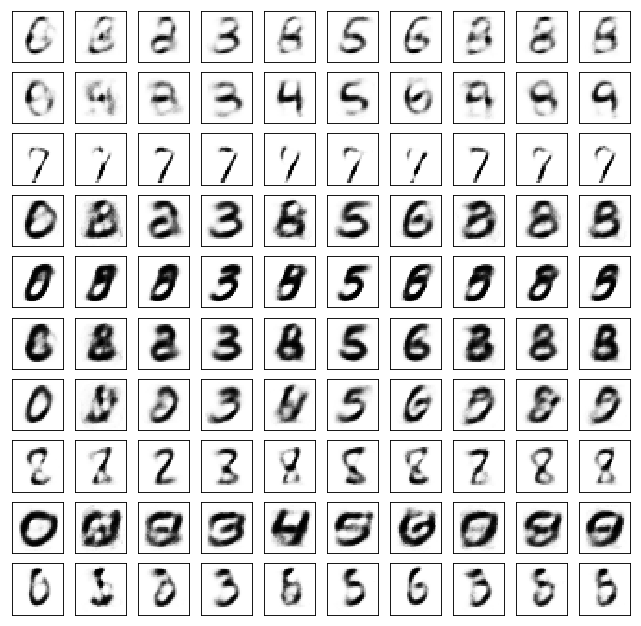

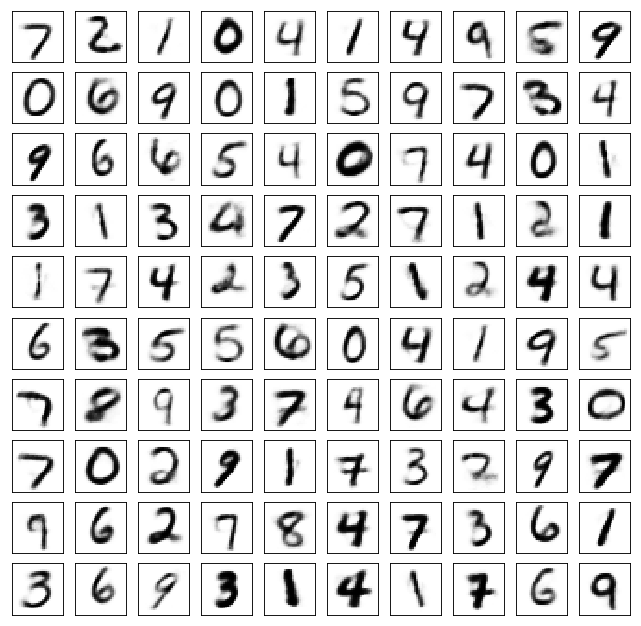

Test losses. E: 0.6725, AE: 0.0812, D: 0.6999
Train Epoch: 102 [0/50000 (0%)]	Losses E: 0.6788, AE: 0.0777, D: 0.6998
Train Epoch: 102 [25000/50000 (50%)]	Losses E: 0.7006, AE: 0.0812, D: 0.6903
Train Epoch: 102 [50000/50000 (100%)]	Losses E: 0.6697, AE: 0.0774, D: 0.6954


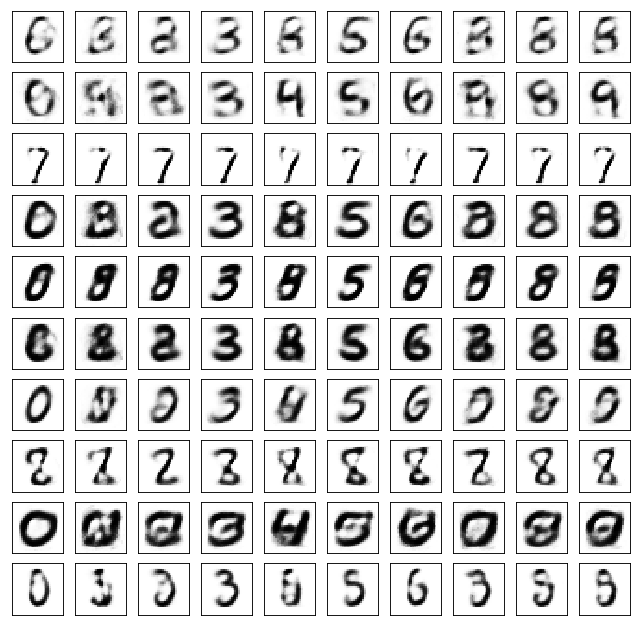

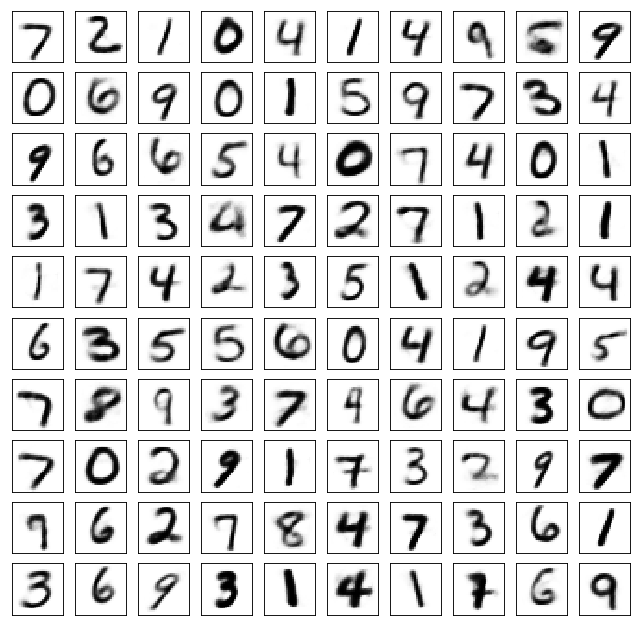

Test losses. E: 0.6690, AE: 0.0751, D: 0.6947
Train Epoch: 103 [0/50000 (0%)]	Losses E: 0.6726, AE: 0.0704, D: 0.6944
Train Epoch: 103 [25000/50000 (50%)]	Losses E: 0.7198, AE: 0.0739, D: 0.6956
Train Epoch: 103 [50000/50000 (100%)]	Losses E: 0.6787, AE: 0.0742, D: 0.7040


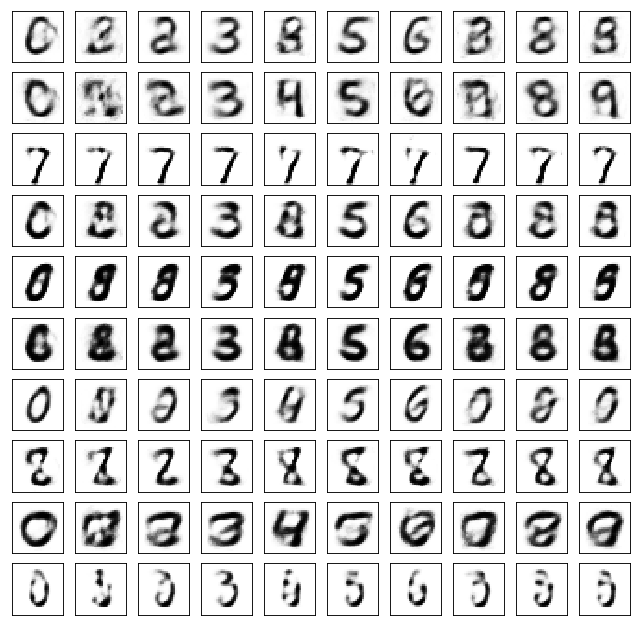

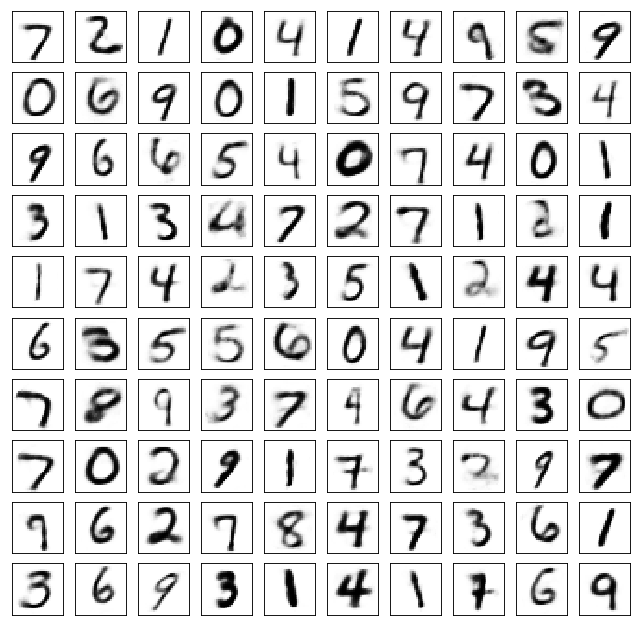

Test losses. E: 0.6744, AE: 0.0780, D: 0.7035
Train Epoch: 104 [0/50000 (0%)]	Losses E: 0.6799, AE: 0.0743, D: 0.7051
Train Epoch: 104 [25000/50000 (50%)]	Losses E: 0.6905, AE: 0.0741, D: 0.6976
Train Epoch: 104 [50000/50000 (100%)]	Losses E: 0.6978, AE: 0.0761, D: 0.6888


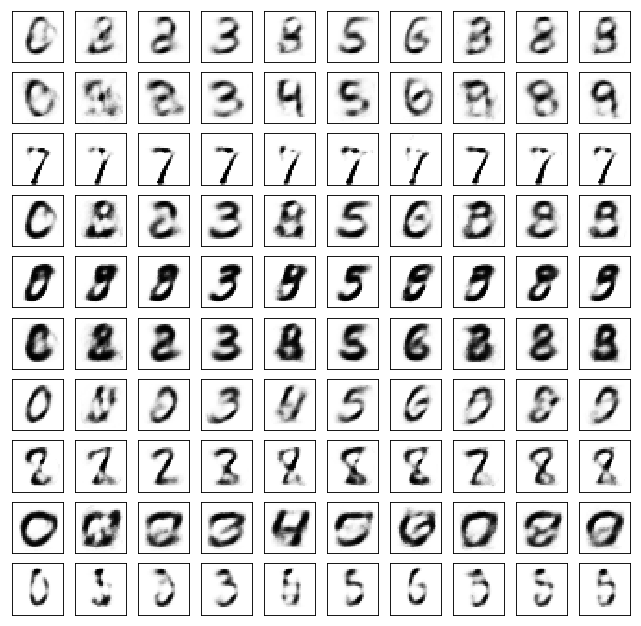

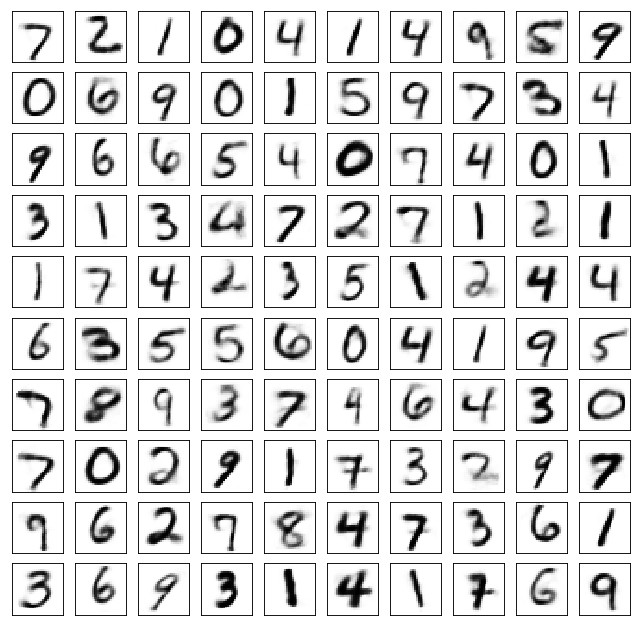

Test losses. E: 0.6933, AE: 0.0773, D: 0.6896
Train Epoch: 105 [0/50000 (0%)]	Losses E: 0.6935, AE: 0.0796, D: 0.6897
Train Epoch: 105 [25000/50000 (50%)]	Losses E: 0.6758, AE: 0.0759, D: 0.6922
Train Epoch: 105 [50000/50000 (100%)]	Losses E: 0.6955, AE: 0.0776, D: 0.7071


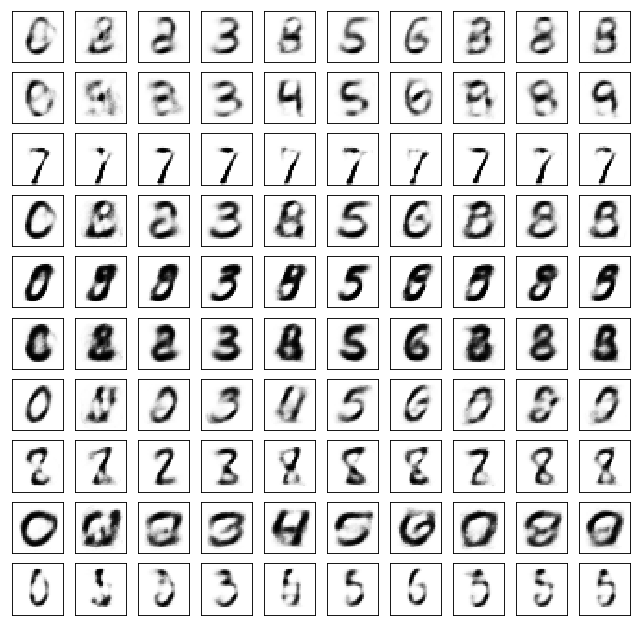

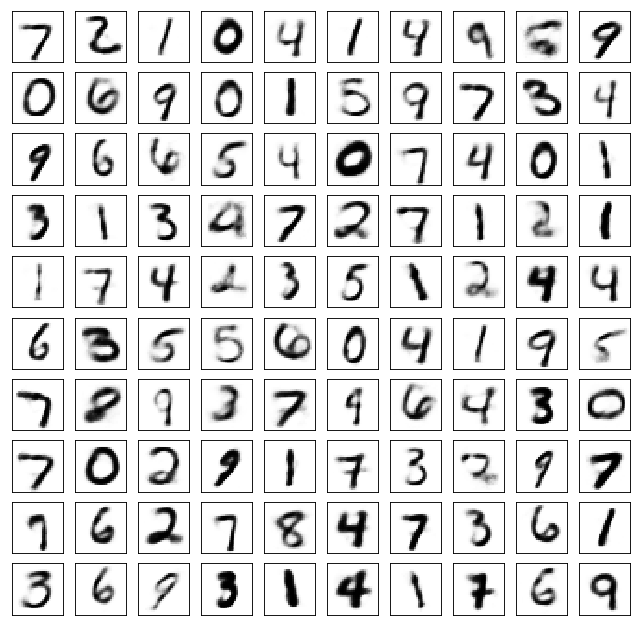

Test losses. E: 0.6870, AE: 0.0826, D: 0.7096
Train Epoch: 106 [0/50000 (0%)]	Losses E: 0.6866, AE: 0.0776, D: 0.7101
Train Epoch: 106 [25000/50000 (50%)]	Losses E: 0.7357, AE: 0.0703, D: 0.6955
Train Epoch: 106 [50000/50000 (100%)]	Losses E: 0.6818, AE: 0.0722, D: 0.6932


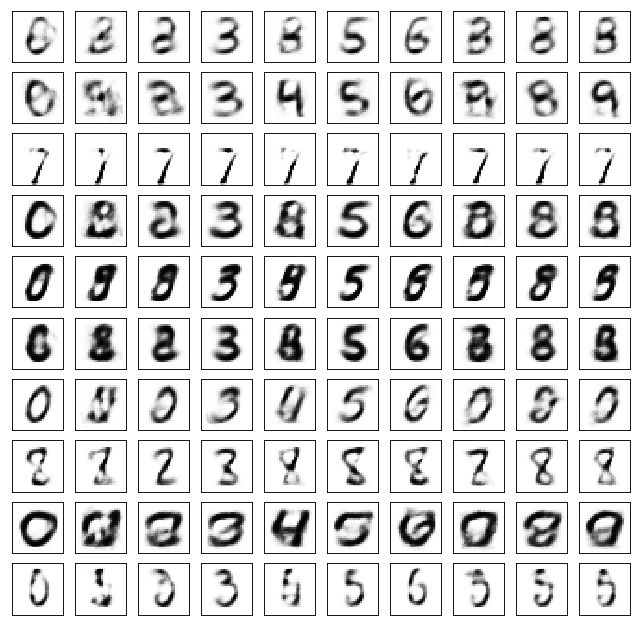

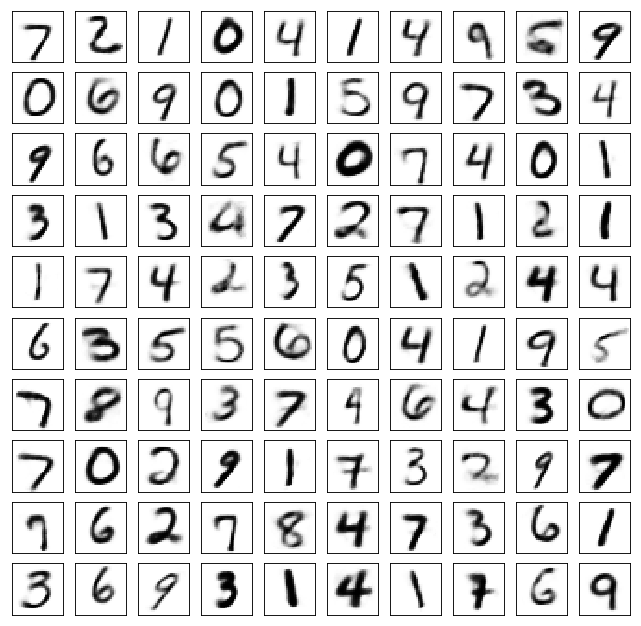

Test losses. E: 0.6798, AE: 0.0705, D: 0.6936
Train Epoch: 107 [0/50000 (0%)]	Losses E: 0.6804, AE: 0.0692, D: 0.6926
Train Epoch: 107 [25000/50000 (50%)]	Losses E: 0.6968, AE: 0.0657, D: 0.6951
Train Epoch: 107 [50000/50000 (100%)]	Losses E: 0.6510, AE: 0.0885, D: 0.7235


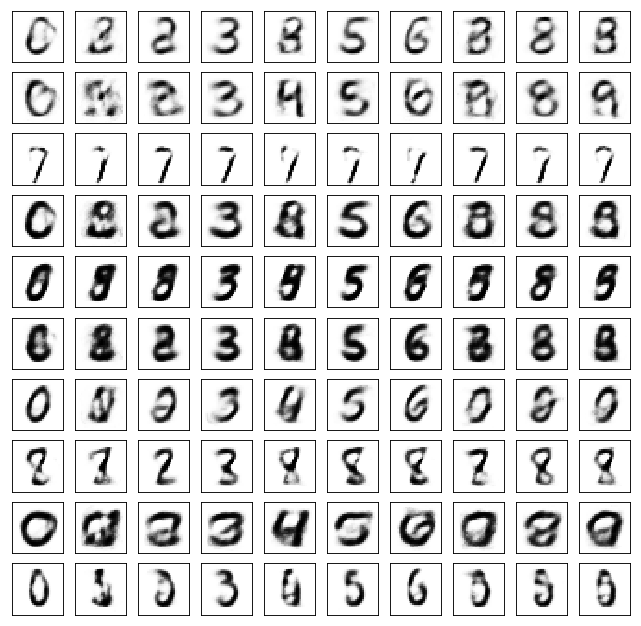

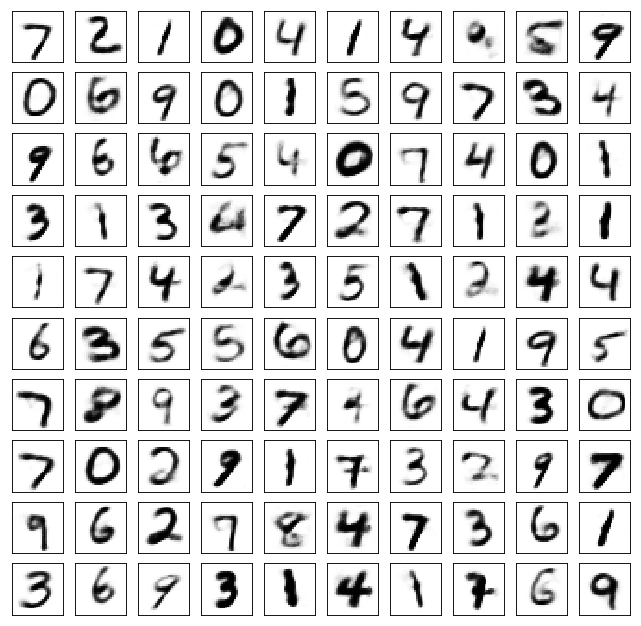

Test losses. E: 0.6488, AE: 0.0908, D: 0.7189
Train Epoch: 108 [0/50000 (0%)]	Losses E: 0.6589, AE: 0.0930, D: 0.7199
Train Epoch: 108 [25000/50000 (50%)]	Losses E: 0.6918, AE: 0.0682, D: 0.6922
Train Epoch: 108 [50000/50000 (100%)]	Losses E: 0.6692, AE: 0.0616, D: 0.6960


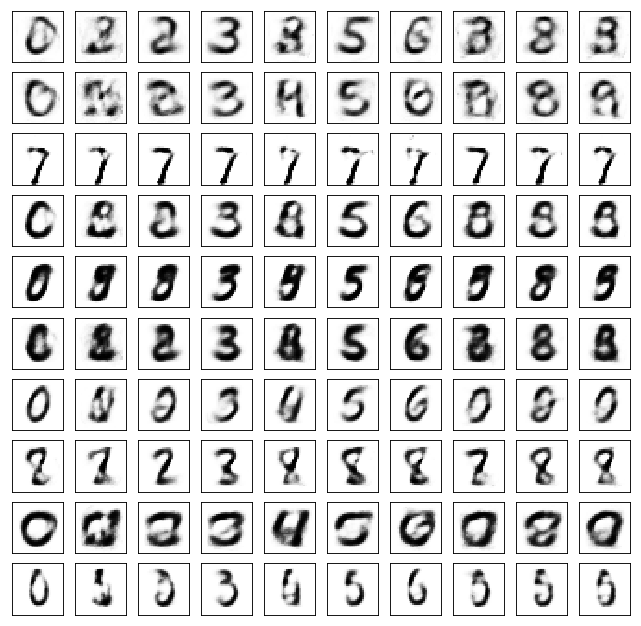

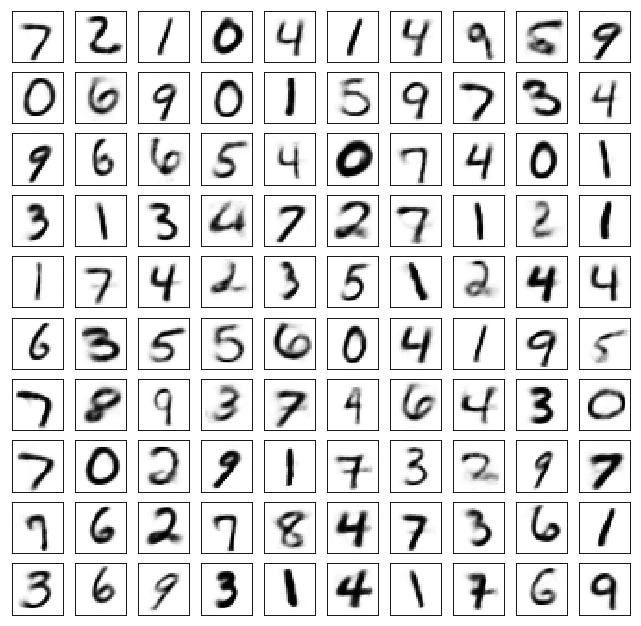

Test losses. E: 0.6670, AE: 0.0701, D: 0.6952
Train Epoch: 109 [0/50000 (0%)]	Losses E: 0.6665, AE: 0.0679, D: 0.6959
Train Epoch: 109 [25000/50000 (50%)]	Losses E: 0.6573, AE: 0.0704, D: 0.6945
Train Epoch: 109 [50000/50000 (100%)]	Losses E: 0.7032, AE: 0.0628, D: 0.6936


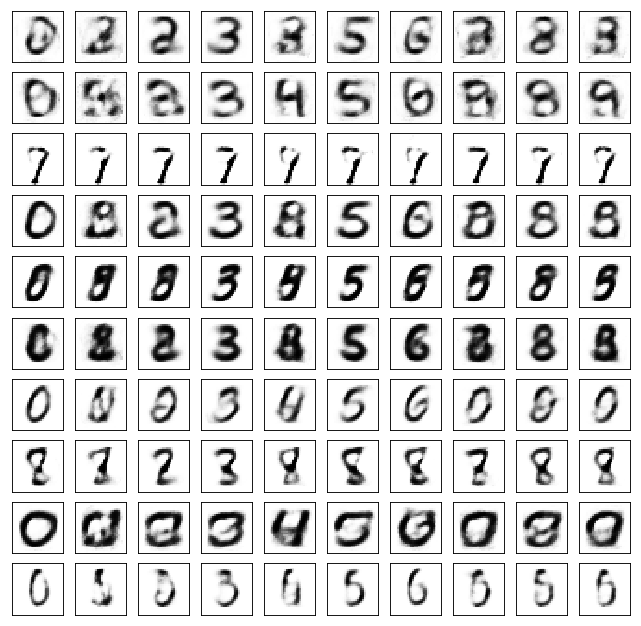

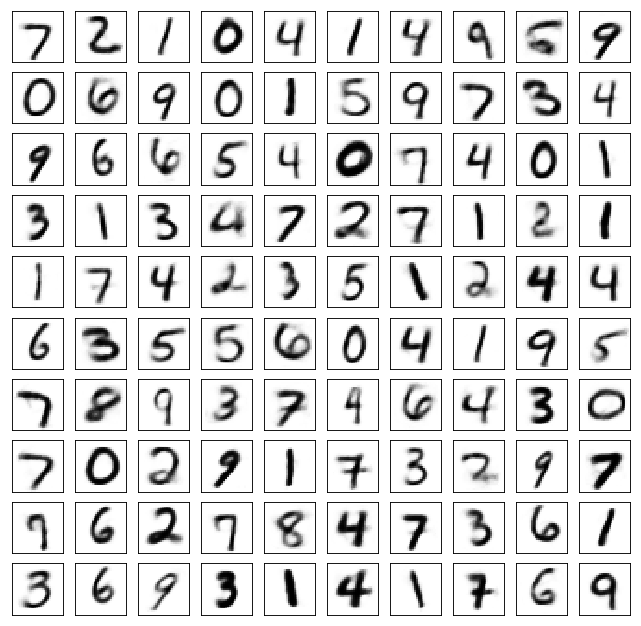

Test losses. E: 0.7023, AE: 0.0691, D: 0.6929
Train Epoch: 110 [0/50000 (0%)]	Losses E: 0.7027, AE: 0.0680, D: 0.6931
Train Epoch: 110 [25000/50000 (50%)]	Losses E: 0.7123, AE: 0.0753, D: 0.7068
Train Epoch: 110 [50000/50000 (100%)]	Losses E: 0.6717, AE: 0.0766, D: 0.7057


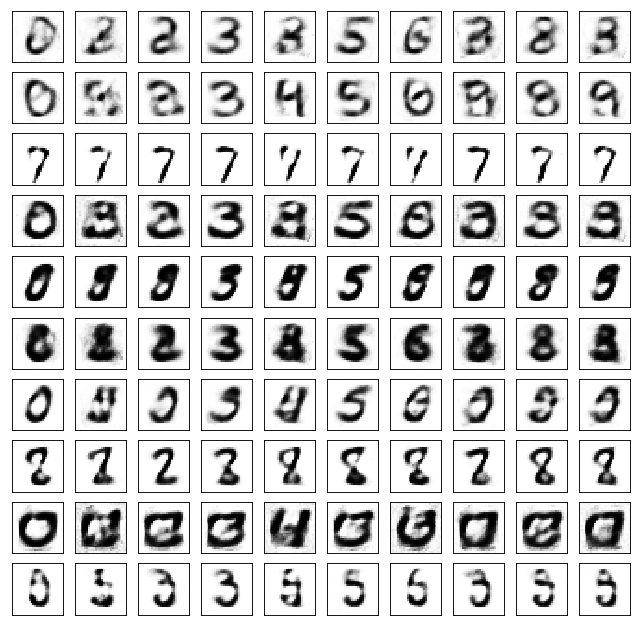

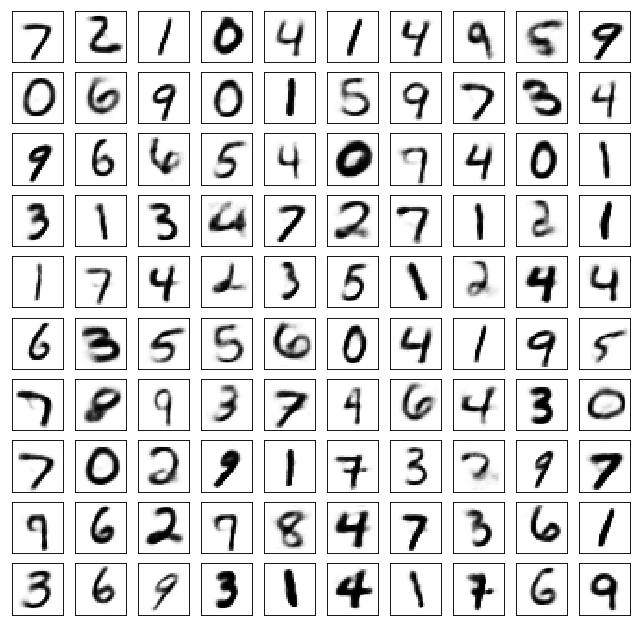

Test losses. E: 0.6663, AE: 0.0770, D: 0.7056
Train Epoch: 111 [0/50000 (0%)]	Losses E: 0.6687, AE: 0.0744, D: 0.7067
Train Epoch: 111 [25000/50000 (50%)]	Losses E: 0.6500, AE: 0.0751, D: 0.7057
Train Epoch: 111 [50000/50000 (100%)]	Losses E: 0.7365, AE: 0.0685, D: 0.6954


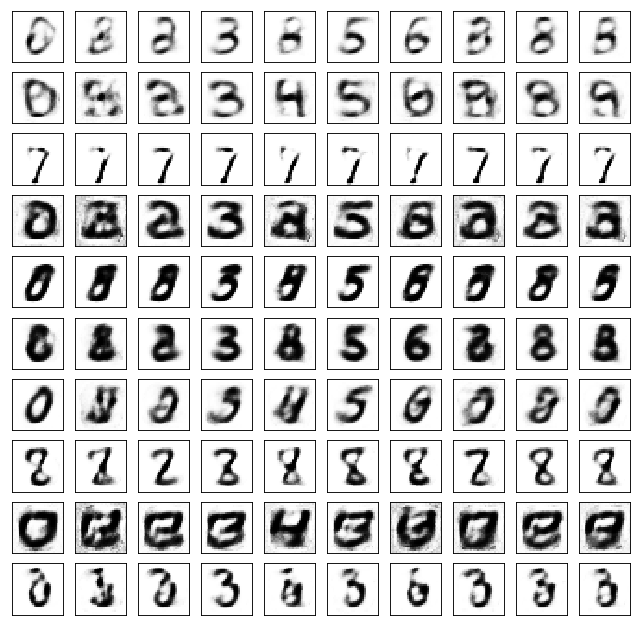

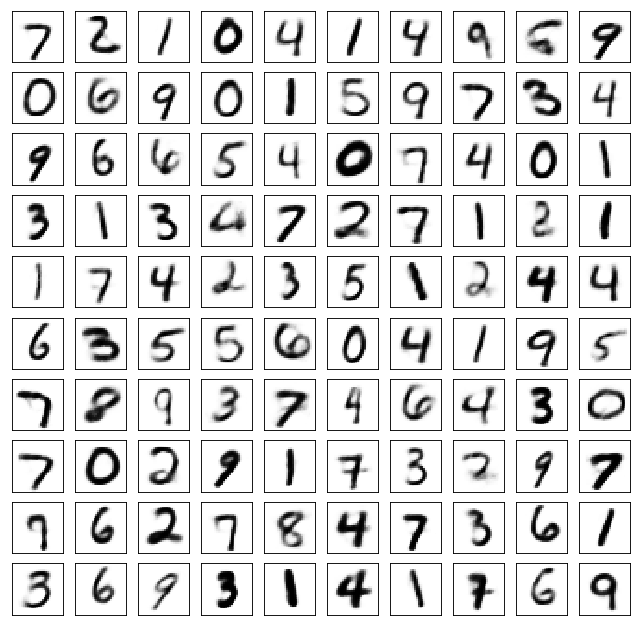

Test losses. E: 0.7346, AE: 0.0717, D: 0.6951
Train Epoch: 112 [0/50000 (0%)]	Losses E: 0.7362, AE: 0.0704, D: 0.6943
Train Epoch: 112 [25000/50000 (50%)]	Losses E: 0.7371, AE: 0.0696, D: 0.6986
Train Epoch: 112 [50000/50000 (100%)]	Losses E: 0.7745, AE: 0.0775, D: 0.7023


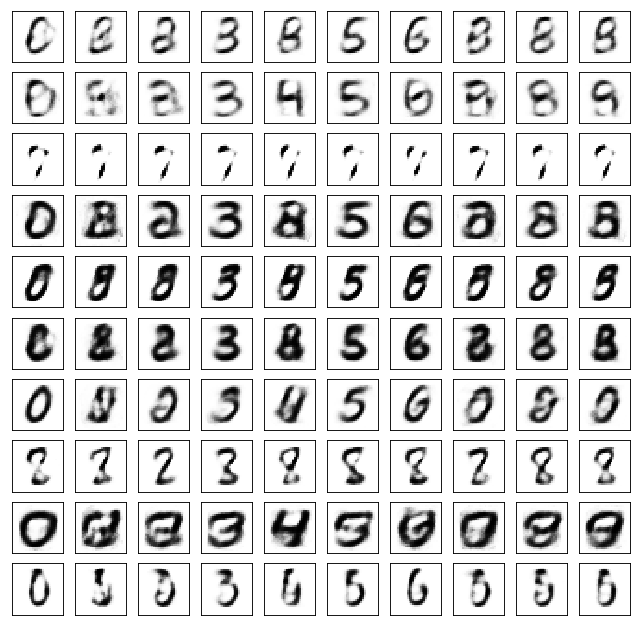

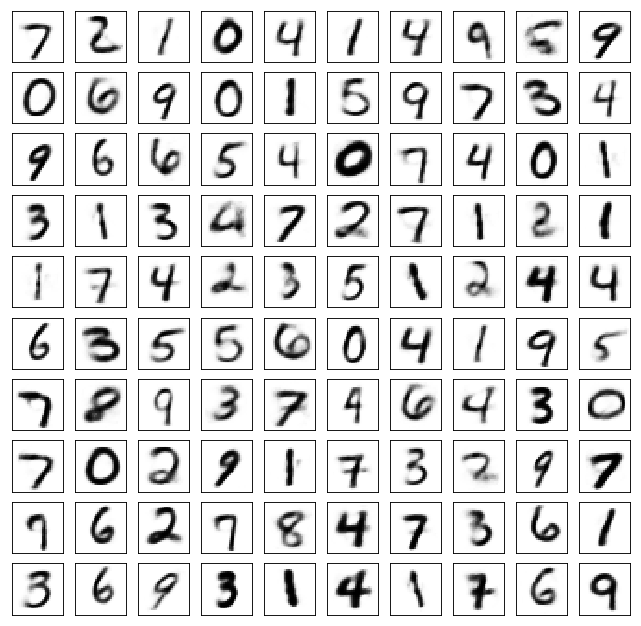

Test losses. E: 0.7737, AE: 0.0746, D: 0.7007
Train Epoch: 113 [0/50000 (0%)]	Losses E: 0.7724, AE: 0.0711, D: 0.7000
Train Epoch: 113 [25000/50000 (50%)]	Losses E: 0.7347, AE: 0.0648, D: 0.6932
Train Epoch: 113 [50000/50000 (100%)]	Losses E: 0.7519, AE: 0.0688, D: 0.6923


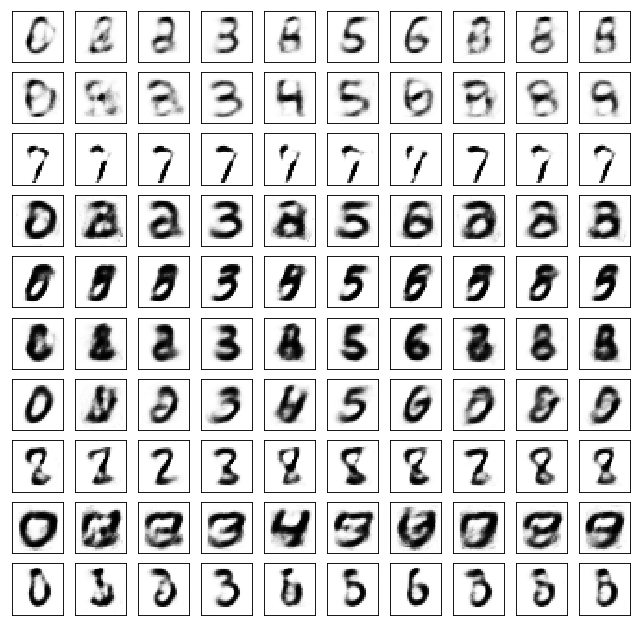

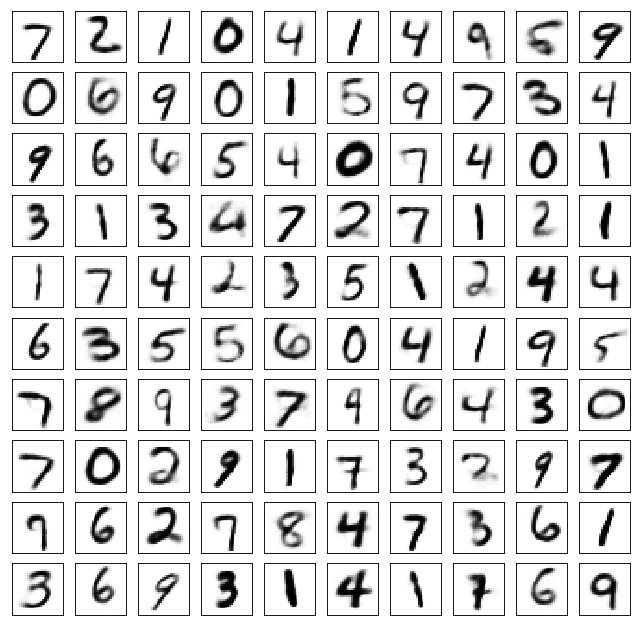

Test losses. E: 0.7504, AE: 0.0729, D: 0.6924
Train Epoch: 114 [0/50000 (0%)]	Losses E: 0.7498, AE: 0.0720, D: 0.6920
Train Epoch: 114 [25000/50000 (50%)]	Losses E: 0.7282, AE: 0.0640, D: 0.6915
Train Epoch: 114 [50000/50000 (100%)]	Losses E: 0.6686, AE: 0.0695, D: 0.6997


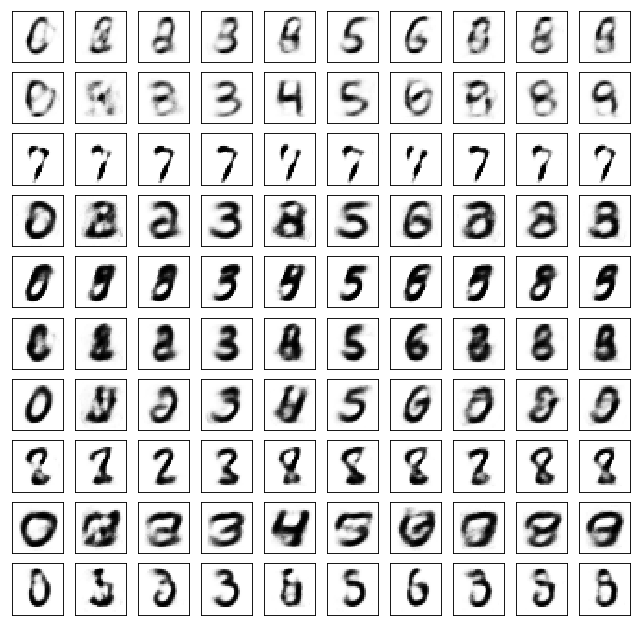

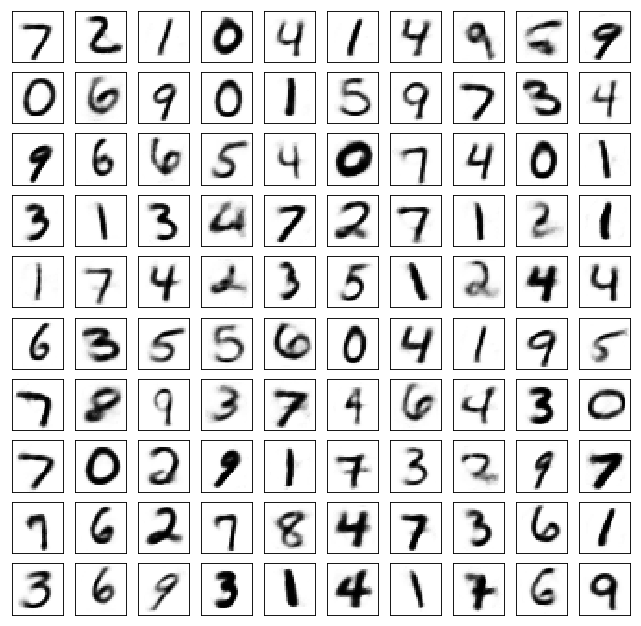

Test losses. E: 0.6698, AE: 0.0712, D: 0.6990
Train Epoch: 115 [0/50000 (0%)]	Losses E: 0.6736, AE: 0.0700, D: 0.7005
Train Epoch: 115 [25000/50000 (50%)]	Losses E: 0.6716, AE: 0.0639, D: 0.6979
Train Epoch: 115 [50000/50000 (100%)]	Losses E: 0.6604, AE: 0.0644, D: 0.6952


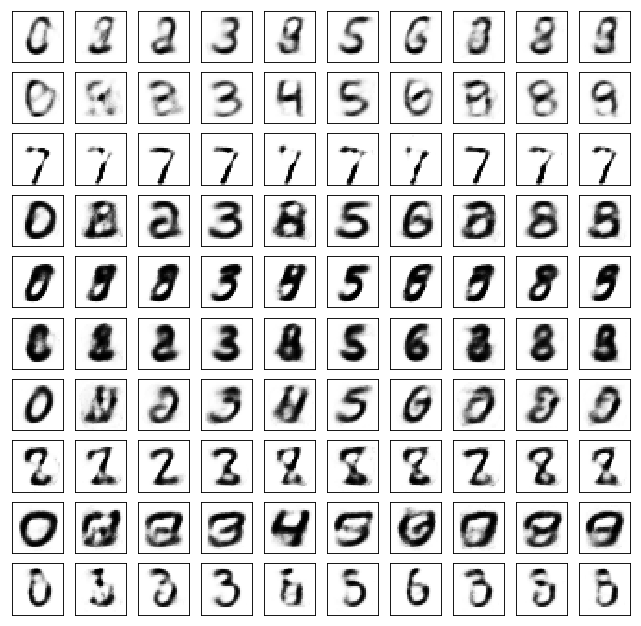

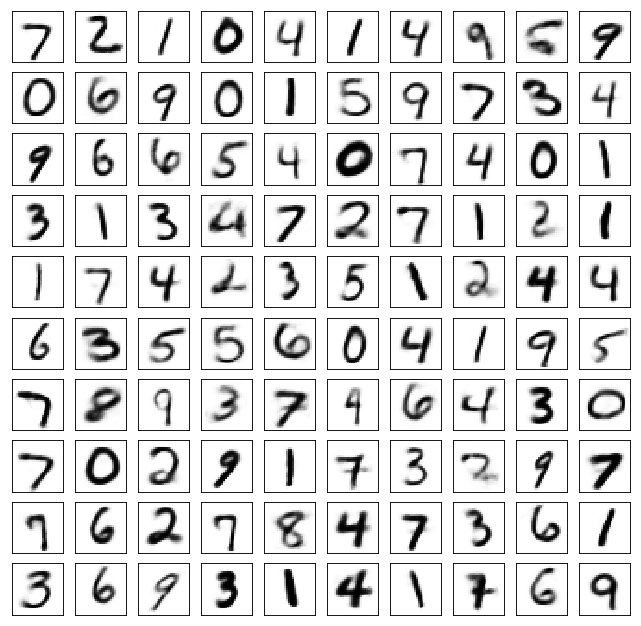

Test losses. E: 0.6611, AE: 0.0672, D: 0.6945
Train Epoch: 116 [0/50000 (0%)]	Losses E: 0.6618, AE: 0.0625, D: 0.6935
Train Epoch: 116 [25000/50000 (50%)]	Losses E: 0.7230, AE: 0.0625, D: 0.6940
Train Epoch: 116 [50000/50000 (100%)]	Losses E: 0.7496, AE: 0.0705, D: 0.6905


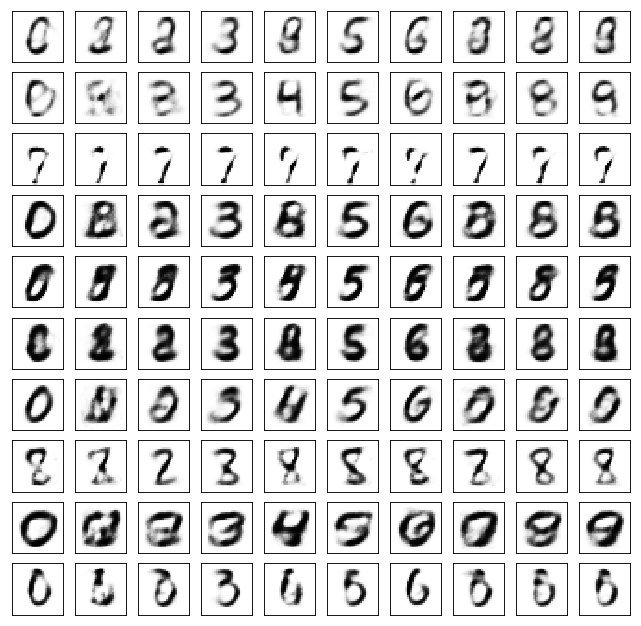

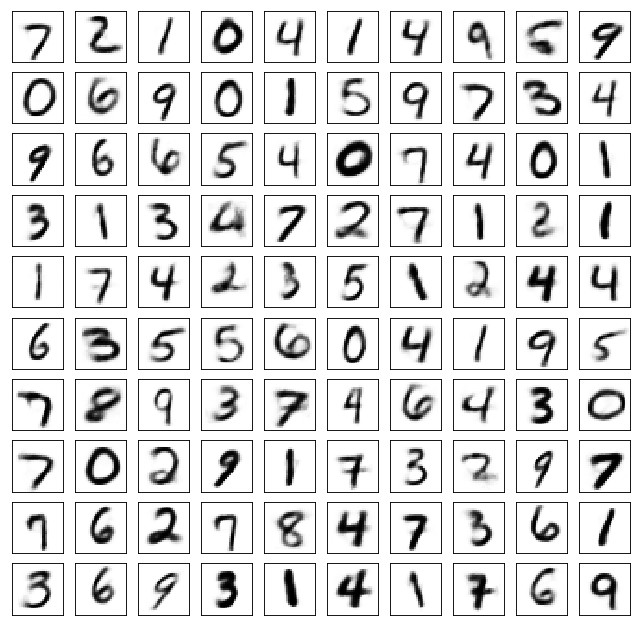

Test losses. E: 0.7459, AE: 0.0700, D: 0.6915
Train Epoch: 117 [0/50000 (0%)]	Losses E: 0.7519, AE: 0.0663, D: 0.6911
Train Epoch: 117 [25000/50000 (50%)]	Losses E: 0.6762, AE: 0.0692, D: 0.7033
Train Epoch: 117 [50000/50000 (100%)]	Losses E: 0.6688, AE: 0.0662, D: 0.7000


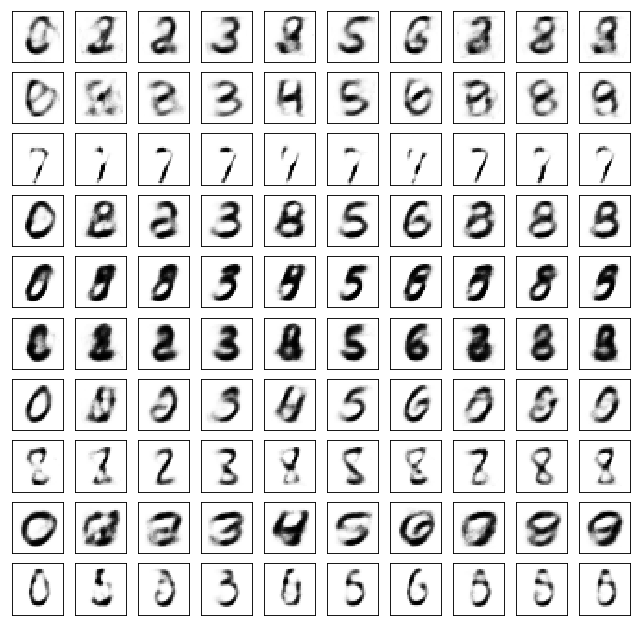

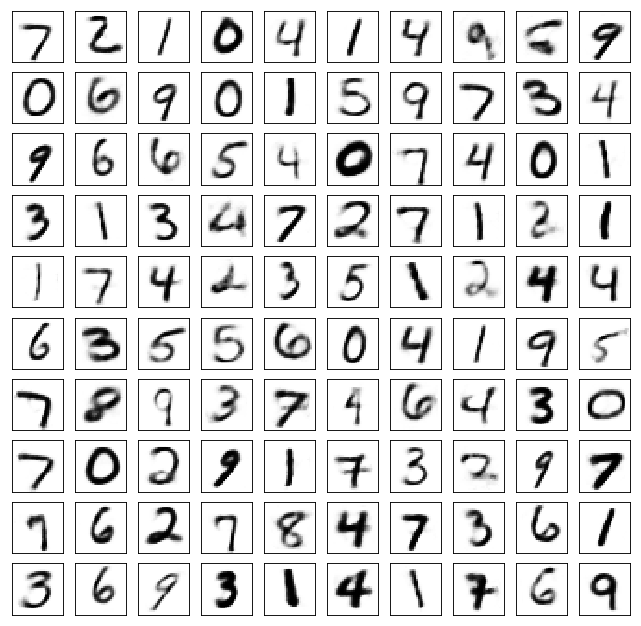

Test losses. E: 0.6653, AE: 0.0698, D: 0.7002
Train Epoch: 118 [0/50000 (0%)]	Losses E: 0.6689, AE: 0.0665, D: 0.6999
Train Epoch: 118 [25000/50000 (50%)]	Losses E: 0.6588, AE: 0.0728, D: 0.7095
Train Epoch: 118 [50000/50000 (100%)]	Losses E: 0.6721, AE: 0.0613, D: 0.6957


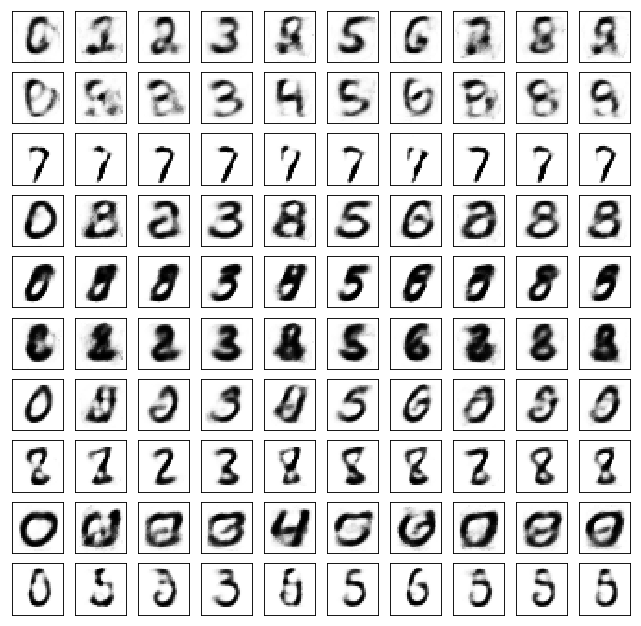

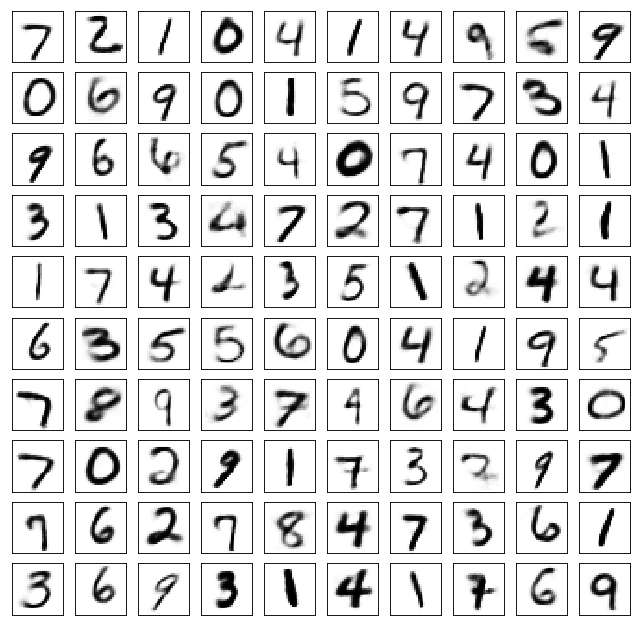

Test losses. E: 0.6697, AE: 0.0676, D: 0.6973
Train Epoch: 119 [0/50000 (0%)]	Losses E: 0.6713, AE: 0.0647, D: 0.6965
Train Epoch: 119 [25000/50000 (50%)]	Losses E: 0.6799, AE: 0.0647, D: 0.6939
Train Epoch: 119 [50000/50000 (100%)]	Losses E: 0.6530, AE: 0.0724, D: 0.7087


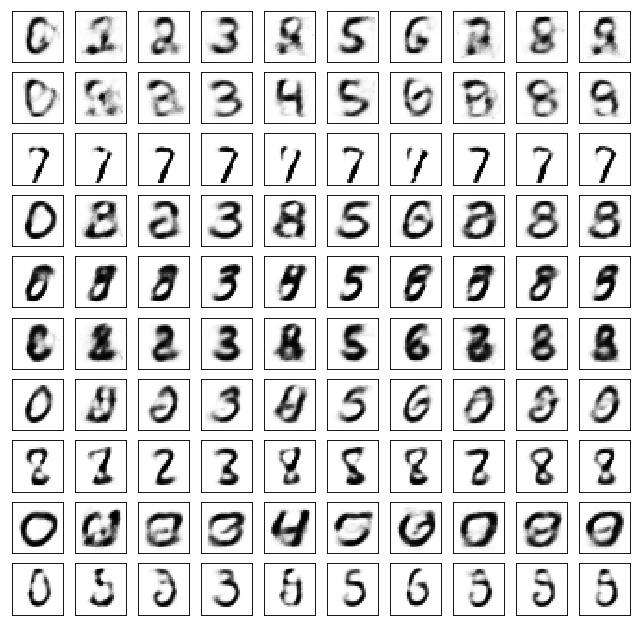

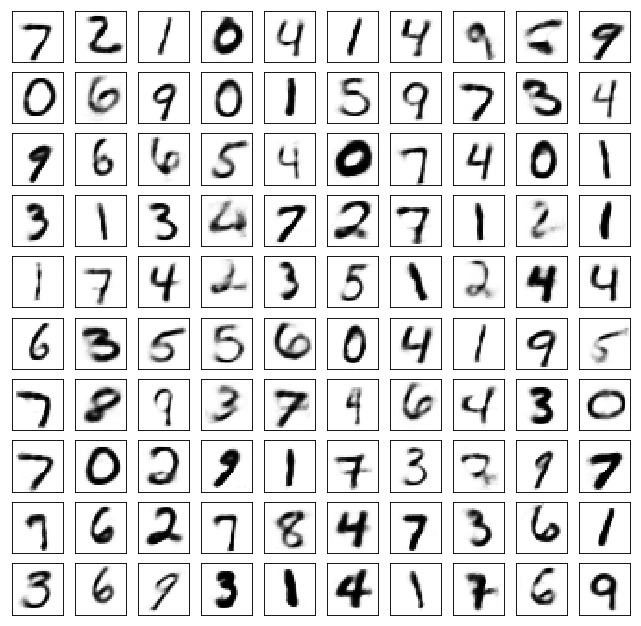

Test losses. E: 0.6432, AE: 0.0731, D: 0.7133
Train Epoch: 120 [0/50000 (0%)]	Losses E: 0.6487, AE: 0.0708, D: 0.7136
Train Epoch: 120 [25000/50000 (50%)]	Losses E: 0.7117, AE: 0.1123, D: 0.7094
Train Epoch: 120 [50000/50000 (100%)]	Losses E: 0.6581, AE: 0.0706, D: 0.7032


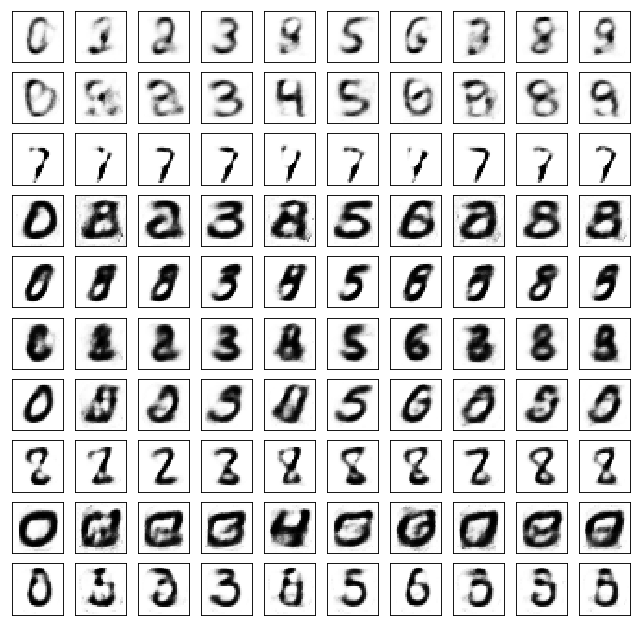

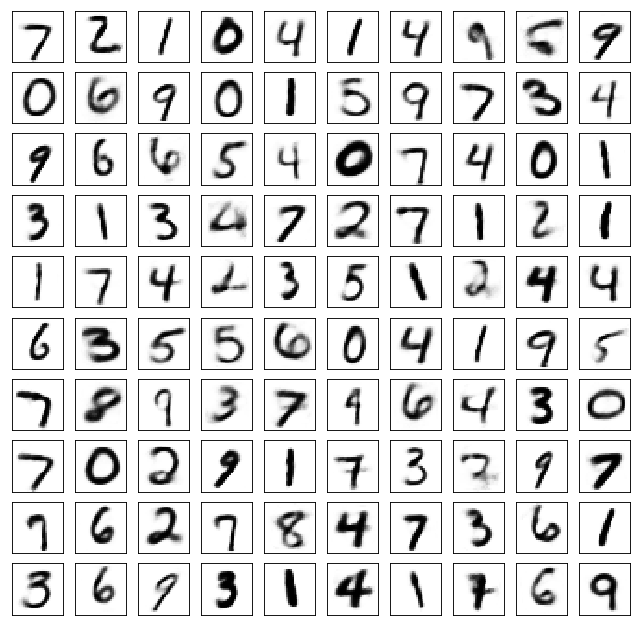

Test losses. E: 0.6546, AE: 0.0738, D: 0.7038
Train Epoch: 121 [0/50000 (0%)]	Losses E: 0.6573, AE: 0.0726, D: 0.7053
Train Epoch: 121 [25000/50000 (50%)]	Losses E: 0.6703, AE: 0.0654, D: 0.6971
Train Epoch: 121 [50000/50000 (100%)]	Losses E: 0.7182, AE: 0.0626, D: 0.6953


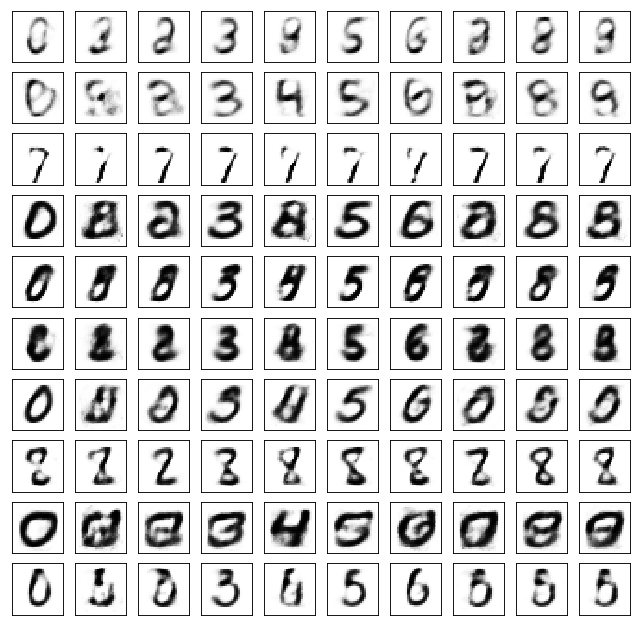

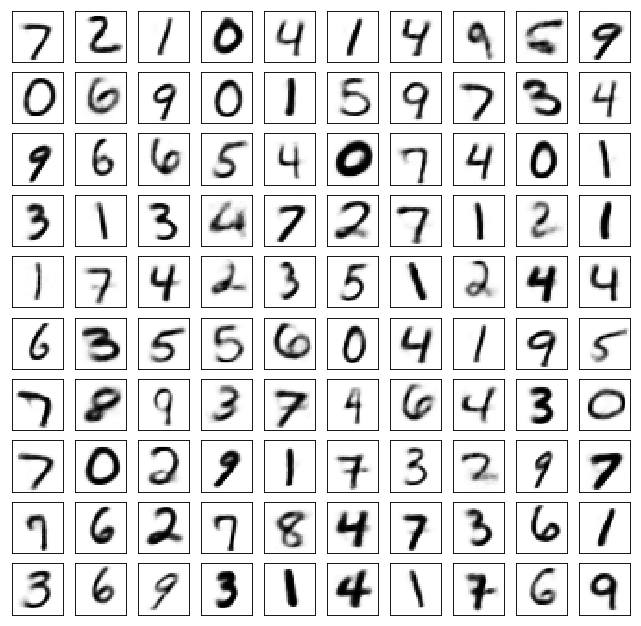

Test losses. E: 0.7198, AE: 0.0643, D: 0.6943
Train Epoch: 122 [0/50000 (0%)]	Losses E: 0.7185, AE: 0.0640, D: 0.6948
Train Epoch: 122 [25000/50000 (50%)]	Losses E: 0.6945, AE: 0.0623, D: 0.6931
Train Epoch: 122 [50000/50000 (100%)]	Losses E: 0.6576, AE: 0.0622, D: 0.6952


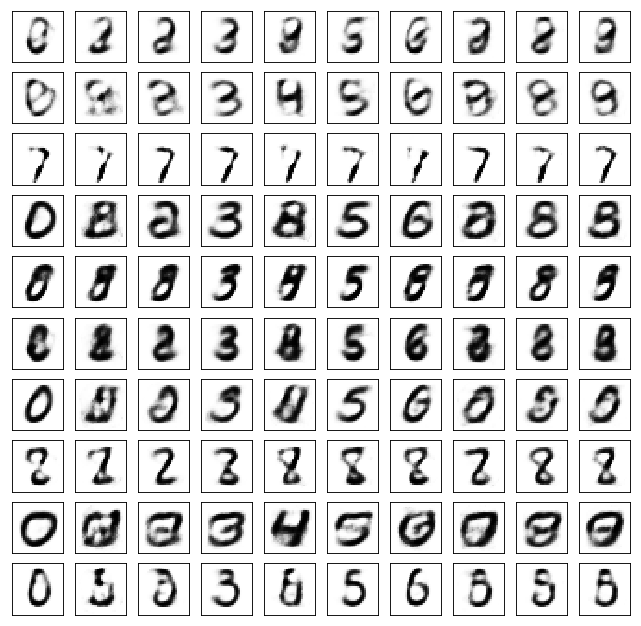

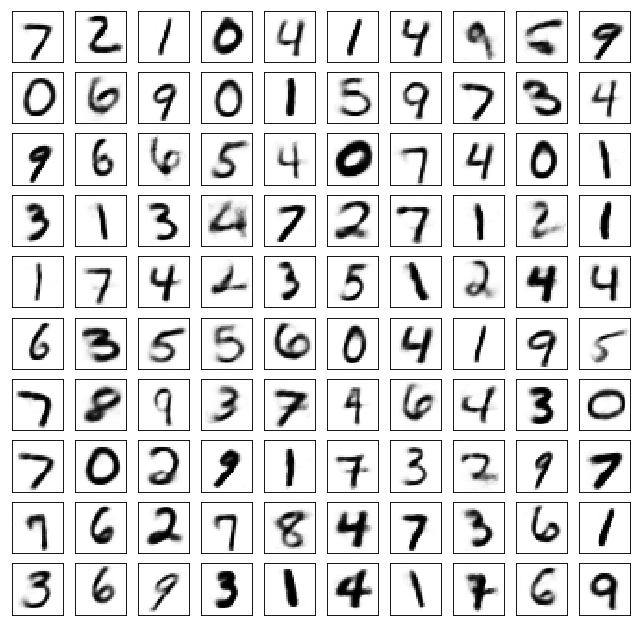

Test losses. E: 0.6548, AE: 0.0678, D: 0.6966
Train Epoch: 123 [0/50000 (0%)]	Losses E: 0.6559, AE: 0.0616, D: 0.6977
Train Epoch: 123 [25000/50000 (50%)]	Losses E: 0.6358, AE: 0.0698, D: 0.6982
Train Epoch: 123 [50000/50000 (100%)]	Losses E: 0.6678, AE: 0.0677, D: 0.7007


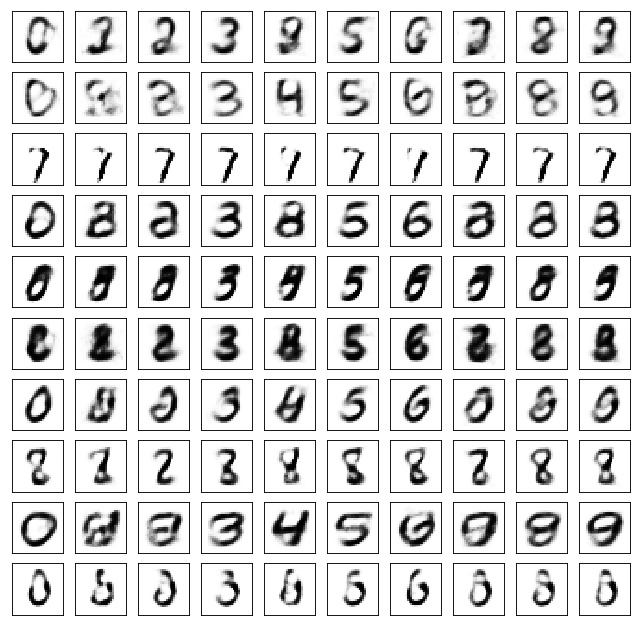

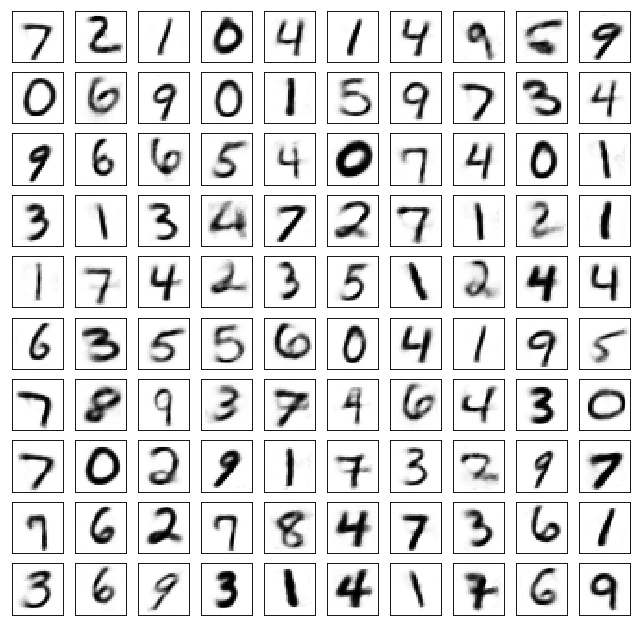

Test losses. E: 0.6643, AE: 0.0679, D: 0.6993
Train Epoch: 124 [0/50000 (0%)]	Losses E: 0.6696, AE: 0.0634, D: 0.6995
Train Epoch: 124 [25000/50000 (50%)]	Losses E: 0.6796, AE: 0.0664, D: 0.6939
Train Epoch: 124 [50000/50000 (100%)]	Losses E: 0.7123, AE: 0.0614, D: 0.6924


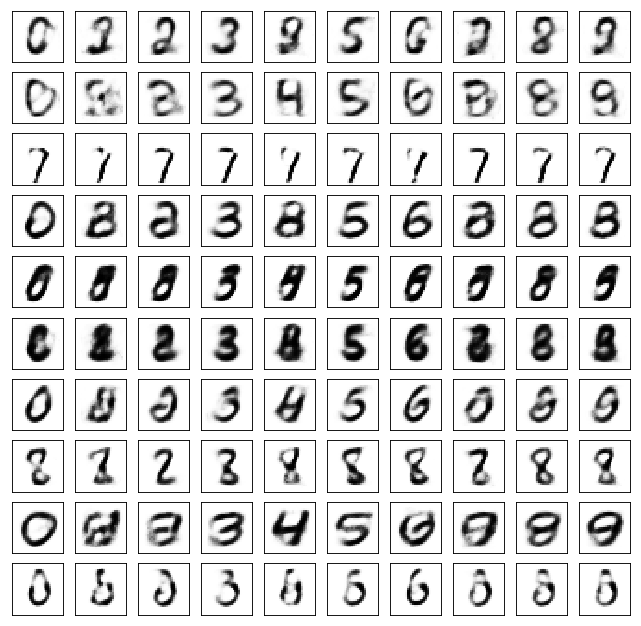

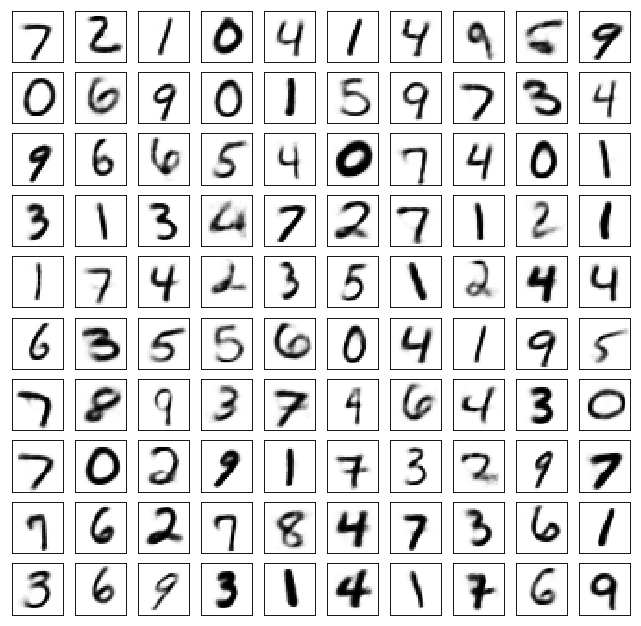

Test losses. E: 0.7127, AE: 0.0621, D: 0.6921
Train Epoch: 125 [0/50000 (0%)]	Losses E: 0.7114, AE: 0.0567, D: 0.6932
Train Epoch: 125 [25000/50000 (50%)]	Losses E: 0.6947, AE: 0.0583, D: 0.6880
Train Epoch: 125 [50000/50000 (100%)]	Losses E: 0.7235, AE: 0.0641, D: 0.7038


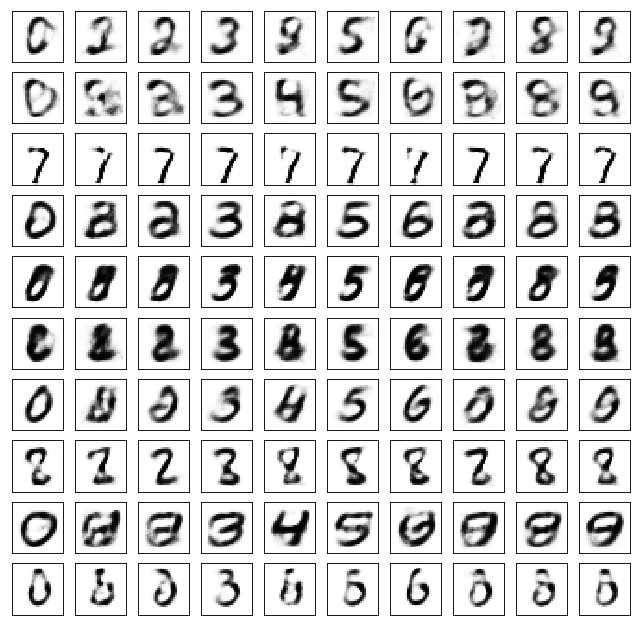

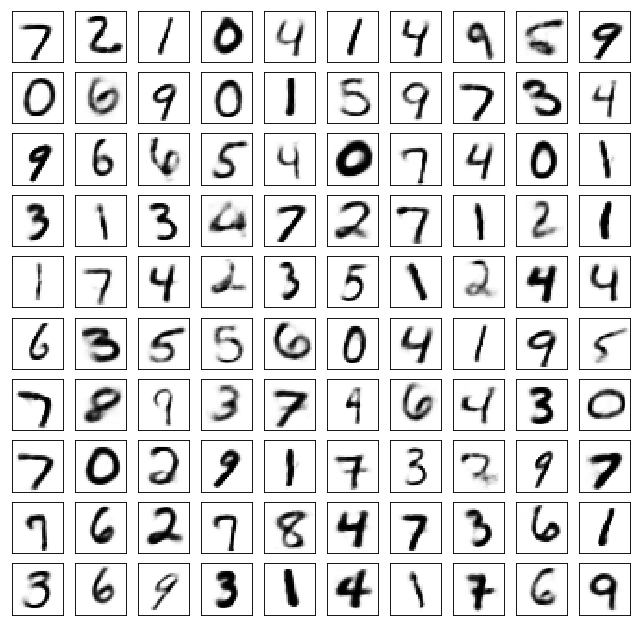

Test losses. E: 0.7227, AE: 0.0695, D: 0.7040
Train Epoch: 126 [0/50000 (0%)]	Losses E: 0.7197, AE: 0.0669, D: 0.7066
Train Epoch: 126 [25000/50000 (50%)]	Losses E: 0.6944, AE: 0.0601, D: 0.6943
Train Epoch: 126 [50000/50000 (100%)]	Losses E: 0.6999, AE: 0.0542, D: 0.6941


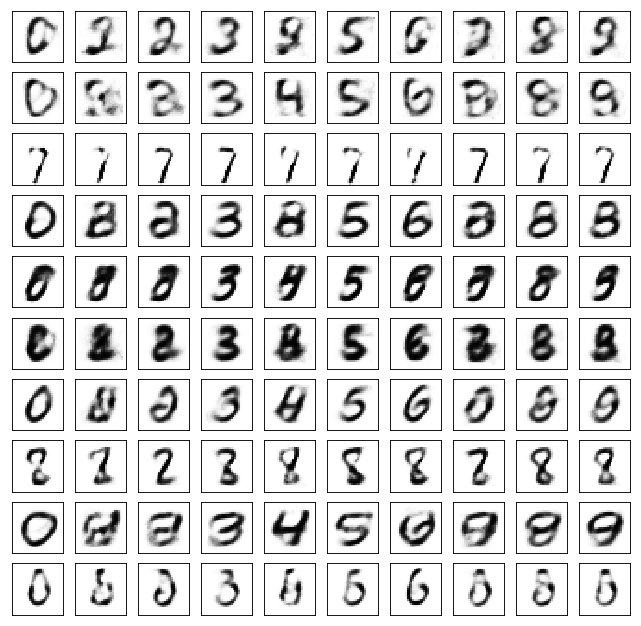

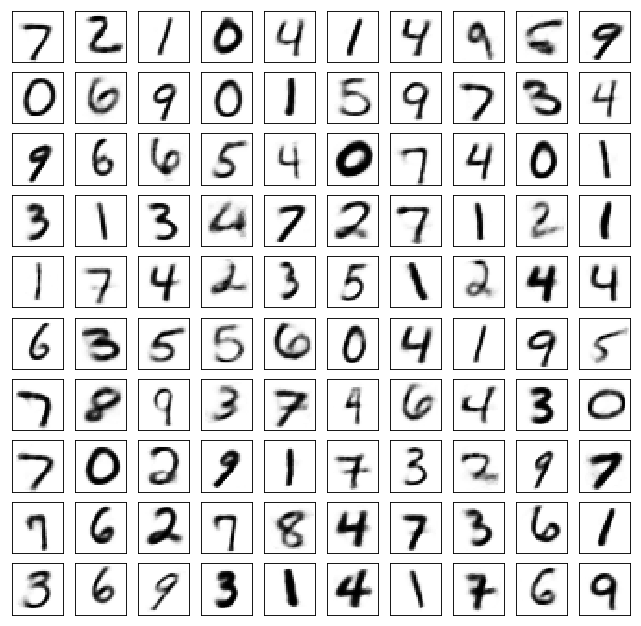

Test losses. E: 0.7001, AE: 0.0621, D: 0.6938
Train Epoch: 127 [0/50000 (0%)]	Losses E: 0.7006, AE: 0.0593, D: 0.6942
Train Epoch: 127 [25000/50000 (50%)]	Losses E: 0.6879, AE: 0.0582, D: 0.6932
Train Epoch: 127 [50000/50000 (100%)]	Losses E: 0.7299, AE: 0.0609, D: 0.6936


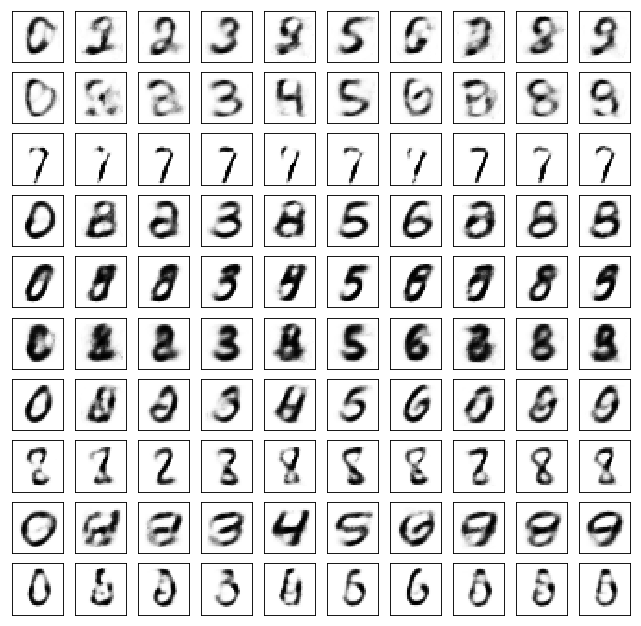

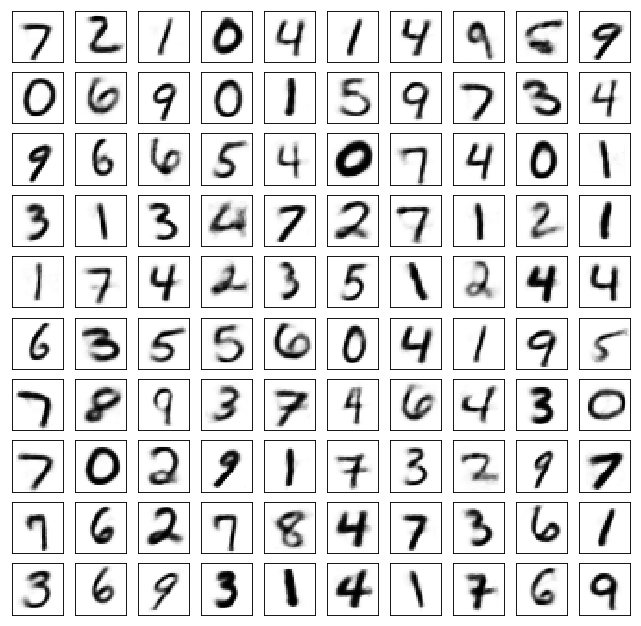

Test losses. E: 0.7295, AE: 0.0644, D: 0.6942
Train Epoch: 128 [0/50000 (0%)]	Losses E: 0.7292, AE: 0.0607, D: 0.6951
Train Epoch: 128 [25000/50000 (50%)]	Losses E: 0.6901, AE: 0.0587, D: 0.6927
Train Epoch: 128 [50000/50000 (100%)]	Losses E: 0.6878, AE: 0.0586, D: 0.6979


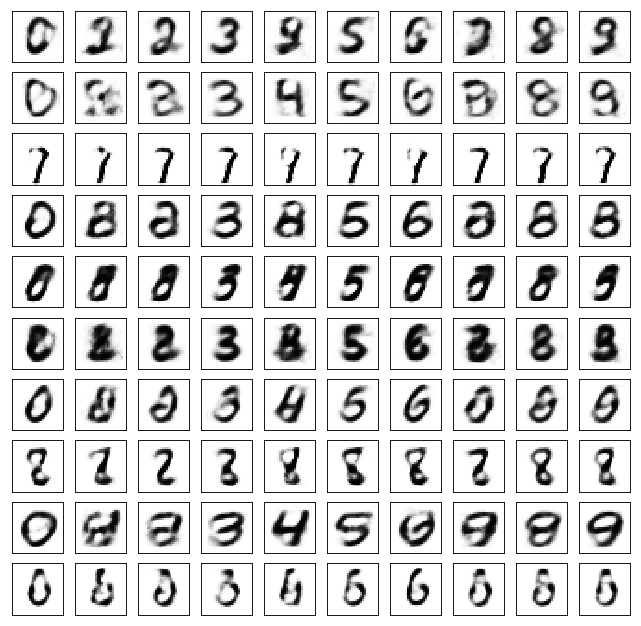

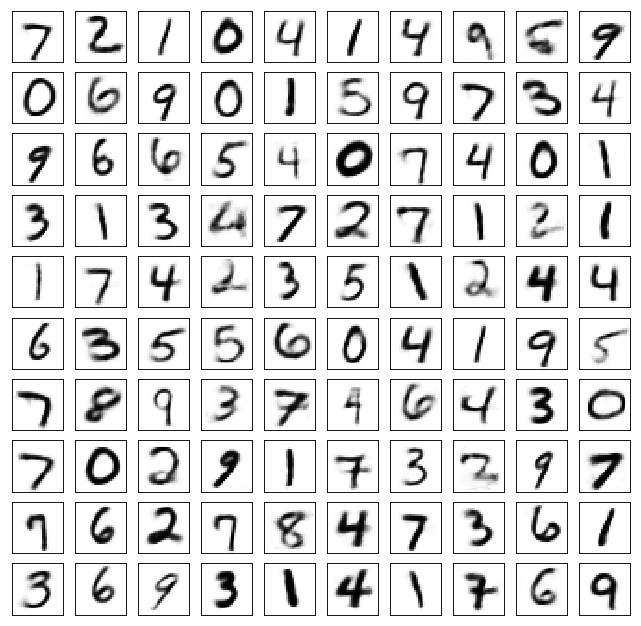

Test losses. E: 0.6866, AE: 0.0625, D: 0.6966
Train Epoch: 129 [0/50000 (0%)]	Losses E: 0.6879, AE: 0.0636, D: 0.6971
Train Epoch: 129 [25000/50000 (50%)]	Losses E: 0.7142, AE: 0.0630, D: 0.6934
Train Epoch: 129 [50000/50000 (100%)]	Losses E: 0.6859, AE: 0.0605, D: 0.6926


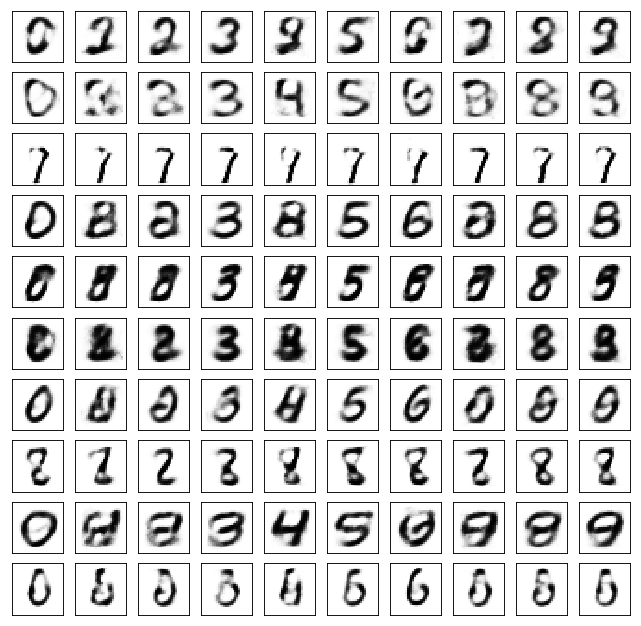

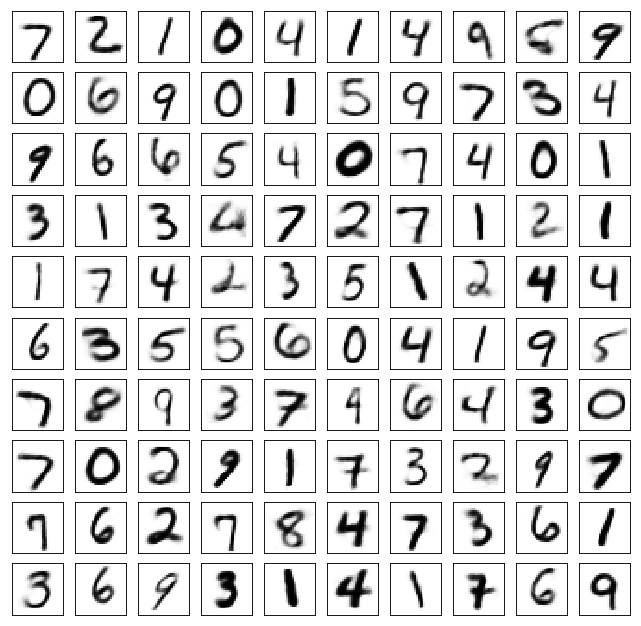

Test losses. E: 0.6859, AE: 0.0599, D: 0.6927
Train Epoch: 130 [0/50000 (0%)]	Losses E: 0.6851, AE: 0.0552, D: 0.6929
Train Epoch: 130 [25000/50000 (50%)]	Losses E: 0.7723, AE: 0.0643, D: 0.6965
Train Epoch: 130 [50000/50000 (100%)]	Losses E: 0.7086, AE: 0.0607, D: 0.6954


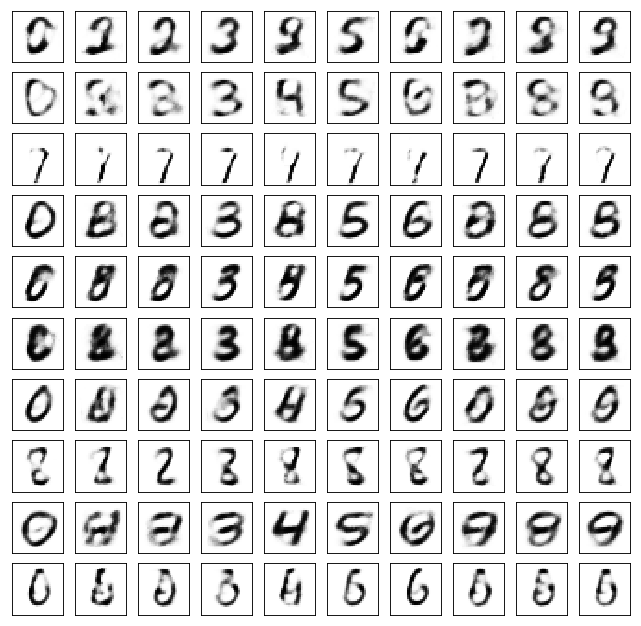

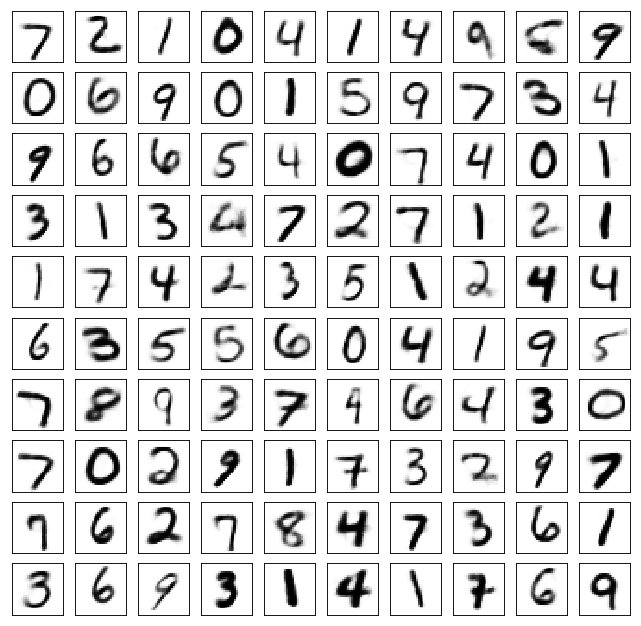

Test losses. E: 0.7085, AE: 0.0614, D: 0.6952
Train Epoch: 131 [0/50000 (0%)]	Losses E: 0.7123, AE: 0.0599, D: 0.6961
Train Epoch: 131 [25000/50000 (50%)]	Losses E: 0.6658, AE: 0.0582, D: 0.6935
Train Epoch: 131 [50000/50000 (100%)]	Losses E: 0.6195, AE: 0.0667, D: 0.6998


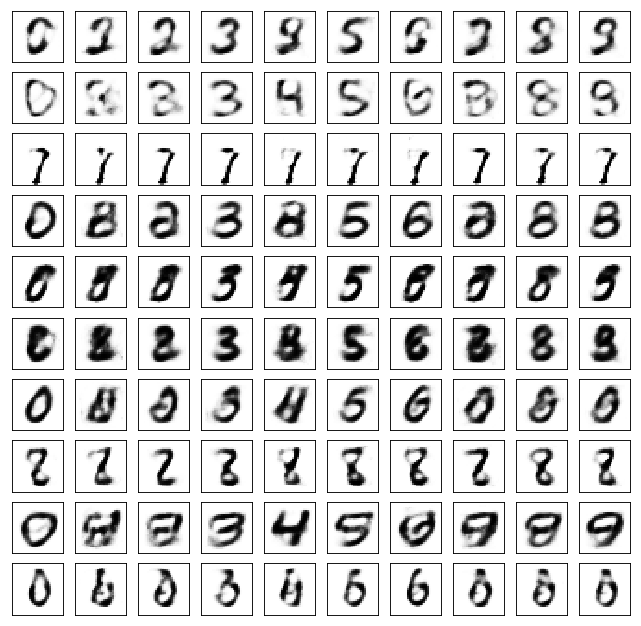

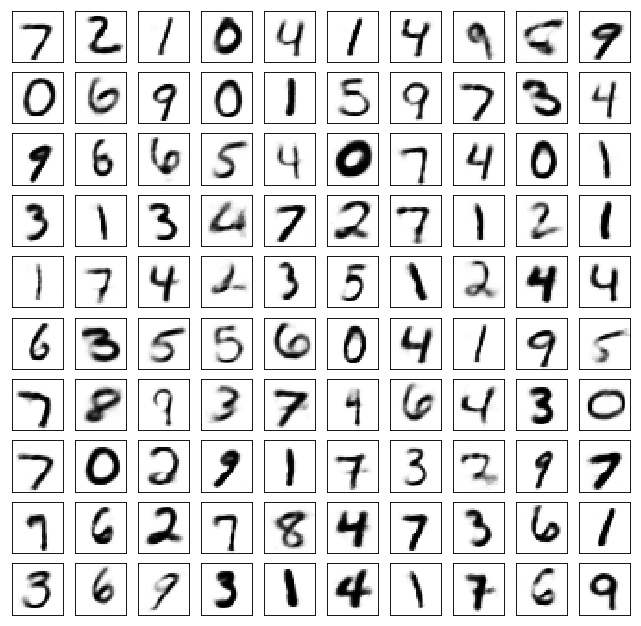

Test losses. E: 0.6151, AE: 0.0691, D: 0.7020
Train Epoch: 132 [0/50000 (0%)]	Losses E: 0.6175, AE: 0.0651, D: 0.7024
Train Epoch: 132 [25000/50000 (50%)]	Losses E: 0.6849, AE: 0.0664, D: 0.6954
Train Epoch: 132 [50000/50000 (100%)]	Losses E: 0.6853, AE: 0.0626, D: 0.6965


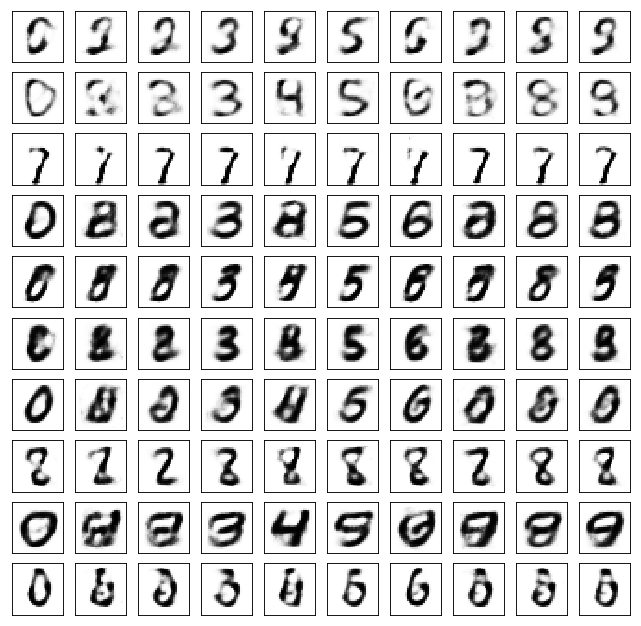

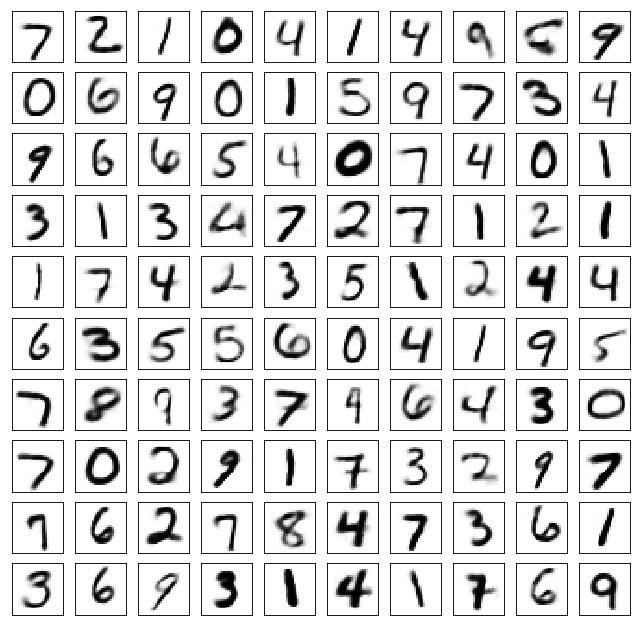

Test losses. E: 0.6844, AE: 0.0634, D: 0.6957
Train Epoch: 133 [0/50000 (0%)]	Losses E: 0.6845, AE: 0.0608, D: 0.6945
Train Epoch: 133 [25000/50000 (50%)]	Losses E: 0.7326, AE: 0.0598, D: 0.6989
Train Epoch: 133 [50000/50000 (100%)]	Losses E: 0.6818, AE: 0.0601, D: 0.6861


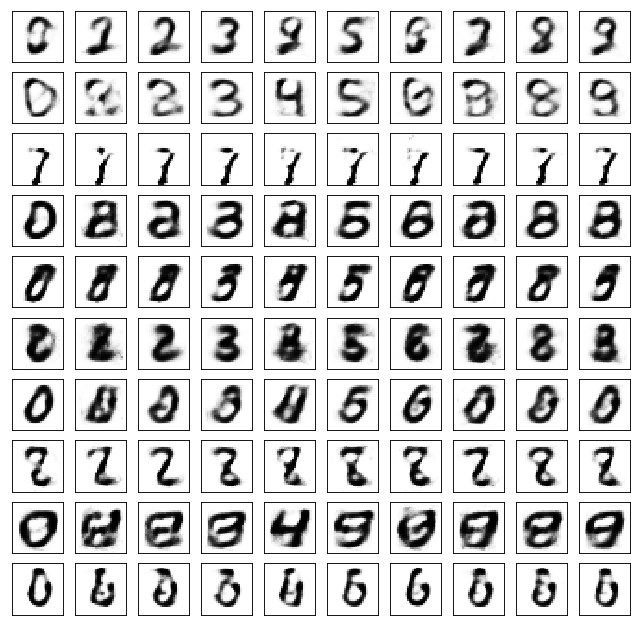

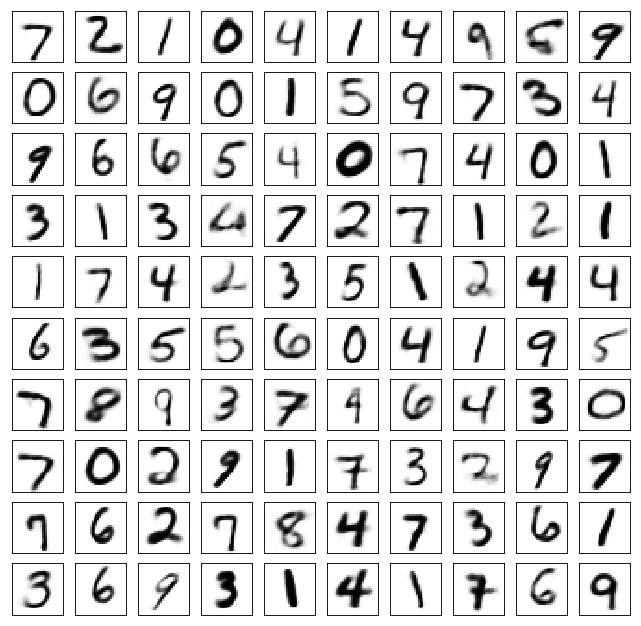

Test losses. E: 0.6810, AE: 0.0603, D: 0.6848
Train Epoch: 134 [0/50000 (0%)]	Losses E: 0.6810, AE: 0.0550, D: 0.6855
Train Epoch: 134 [25000/50000 (50%)]	Losses E: 0.6863, AE: 0.0656, D: 0.6904
Train Epoch: 134 [50000/50000 (100%)]	Losses E: 0.6650, AE: 0.0658, D: 0.6983


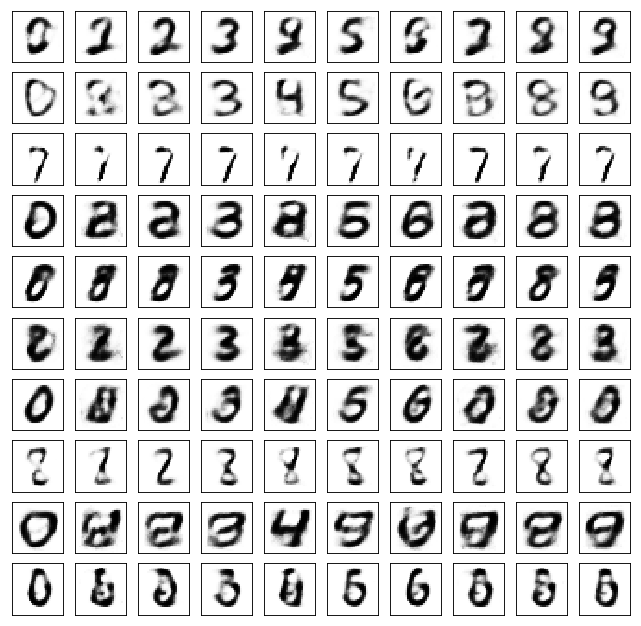

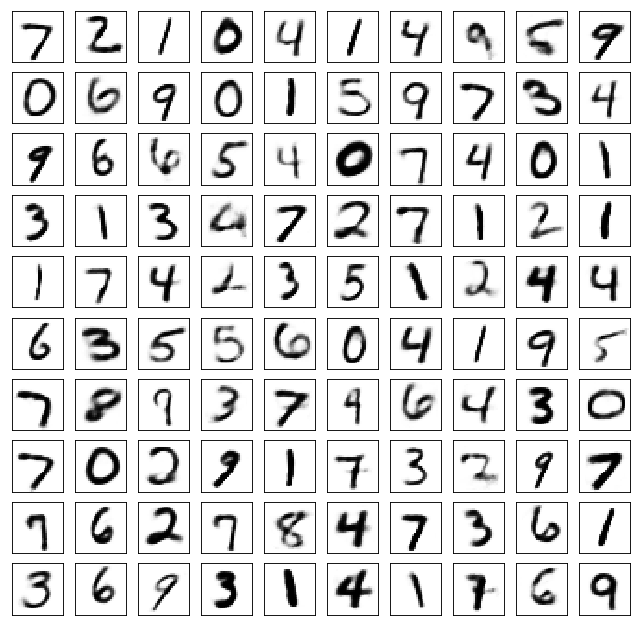

Test losses. E: 0.6636, AE: 0.0666, D: 0.6979
Train Epoch: 135 [0/50000 (0%)]	Losses E: 0.6671, AE: 0.0626, D: 0.6968
Train Epoch: 135 [25000/50000 (50%)]	Losses E: 0.6993, AE: 0.0548, D: 0.6929
Train Epoch: 135 [50000/50000 (100%)]	Losses E: 0.7069, AE: 0.0626, D: 0.6897


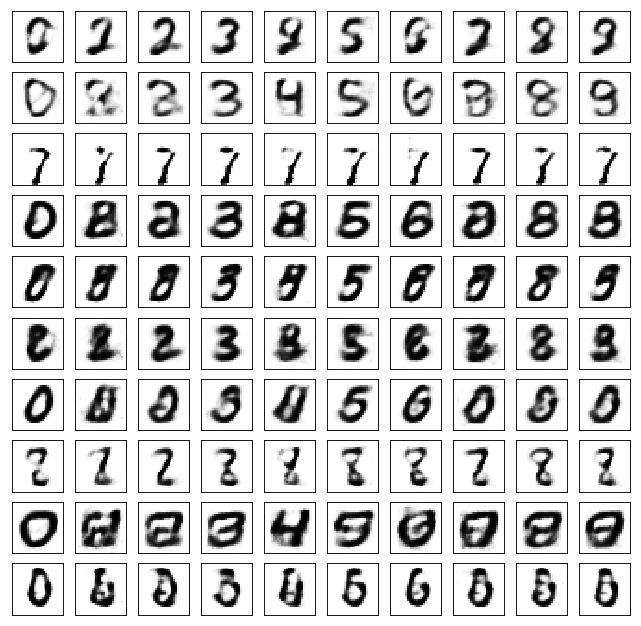

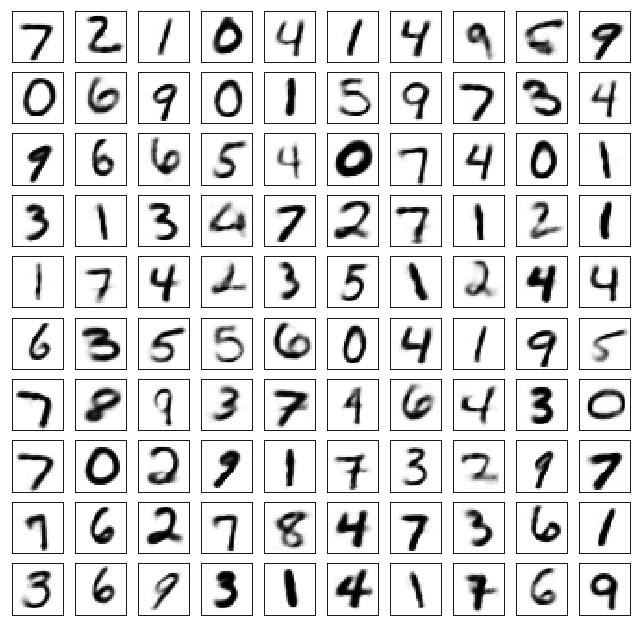

Test losses. E: 0.7069, AE: 0.0664, D: 0.6892
Train Epoch: 136 [0/50000 (0%)]	Losses E: 0.7061, AE: 0.0638, D: 0.6886
Train Epoch: 136 [25000/50000 (50%)]	Losses E: 0.6523, AE: 0.0672, D: 0.7003
Train Epoch: 136 [50000/50000 (100%)]	Losses E: 0.6943, AE: 0.0643, D: 0.6980


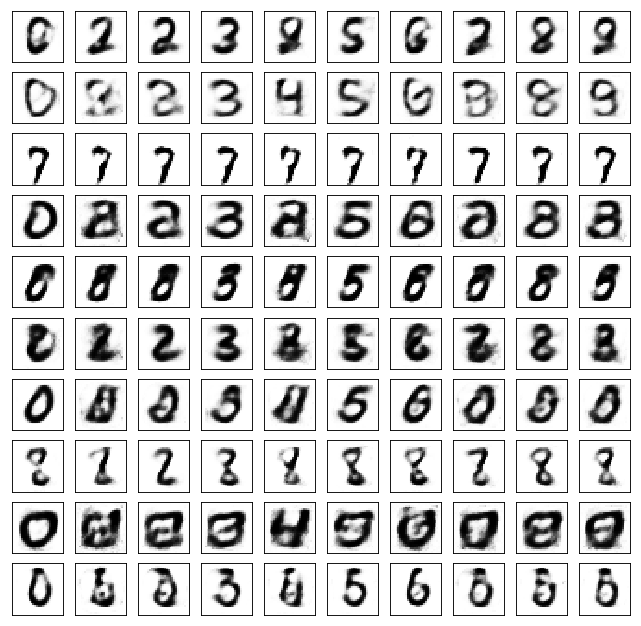

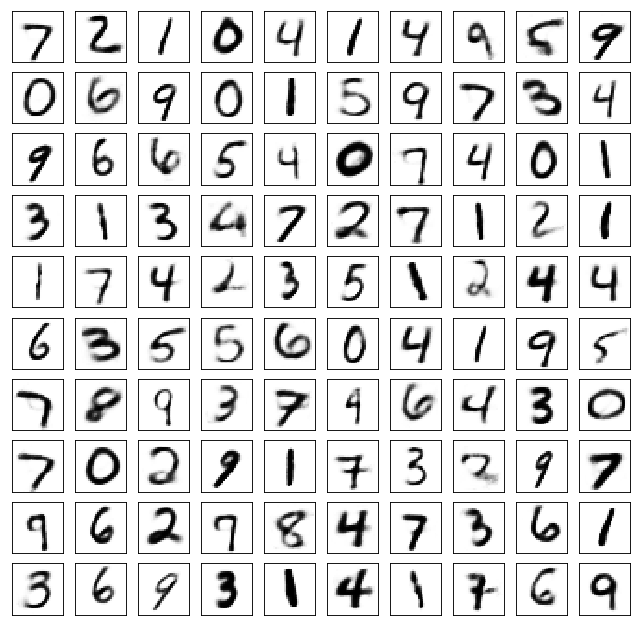

Test losses. E: 0.6949, AE: 0.0669, D: 0.6968
Train Epoch: 137 [0/50000 (0%)]	Losses E: 0.6982, AE: 0.0668, D: 0.6972
Train Epoch: 137 [25000/50000 (50%)]	Losses E: 0.6864, AE: 0.0561, D: 0.6925
Train Epoch: 137 [50000/50000 (100%)]	Losses E: 0.6917, AE: 0.0578, D: 0.6939


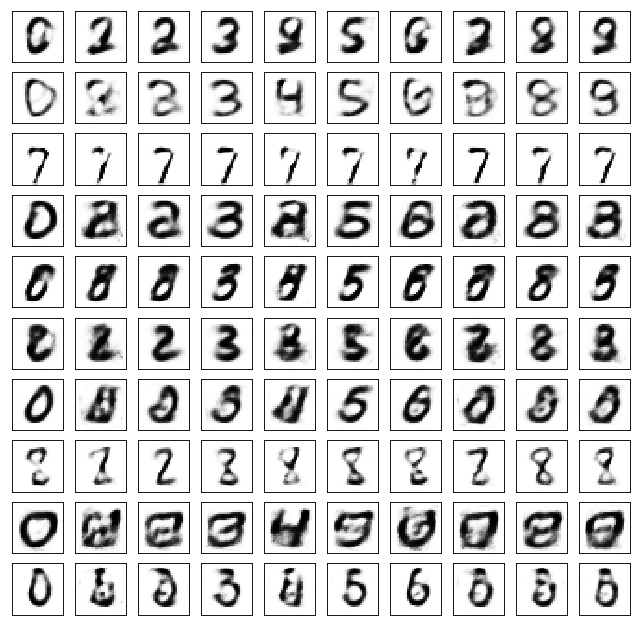

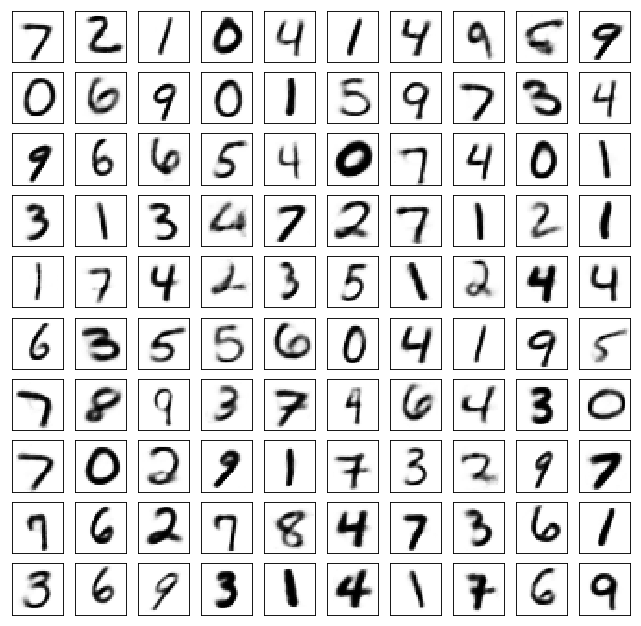

Test losses. E: 0.6925, AE: 0.0574, D: 0.6929
Train Epoch: 138 [0/50000 (0%)]	Losses E: 0.6922, AE: 0.0528, D: 0.6928
Train Epoch: 138 [25000/50000 (50%)]	Losses E: 0.6977, AE: 0.0527, D: 0.6947
Train Epoch: 138 [50000/50000 (100%)]	Losses E: 0.6811, AE: 0.0571, D: 0.6979


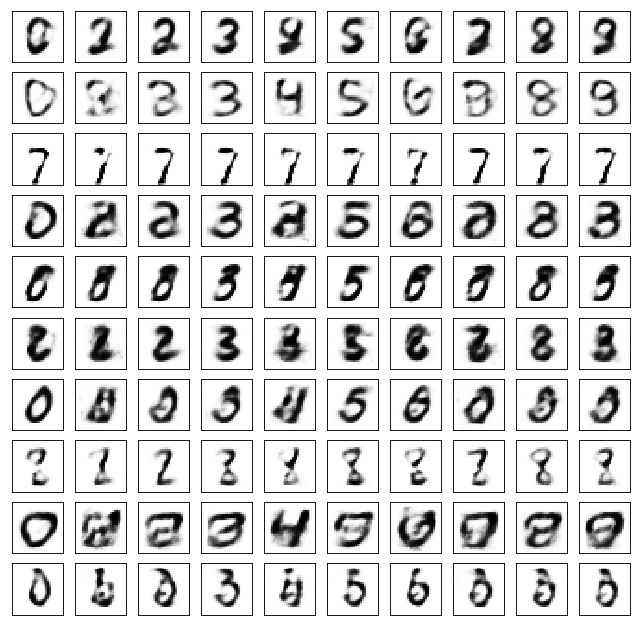

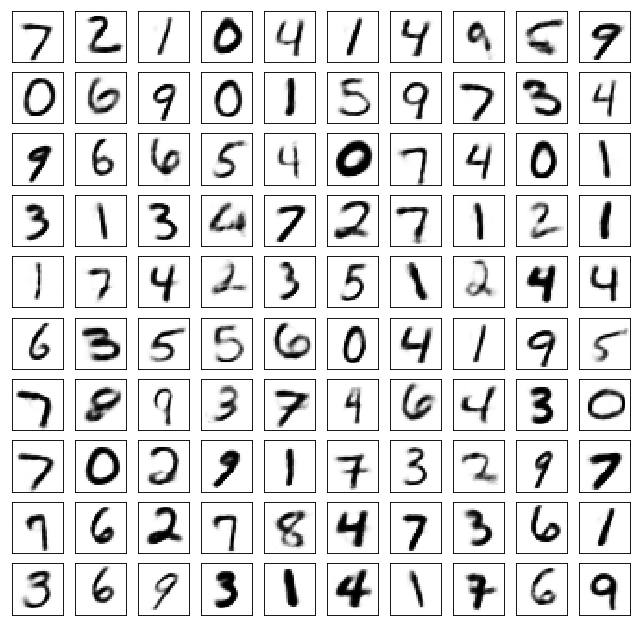

Test losses. E: 0.6798, AE: 0.0607, D: 0.6972
Train Epoch: 139 [0/50000 (0%)]	Losses E: 0.6816, AE: 0.0525, D: 0.6967
Train Epoch: 139 [25000/50000 (50%)]	Losses E: 0.7046, AE: 0.0568, D: 0.6942
Train Epoch: 139 [50000/50000 (100%)]	Losses E: 0.7031, AE: 0.0530, D: 0.6931


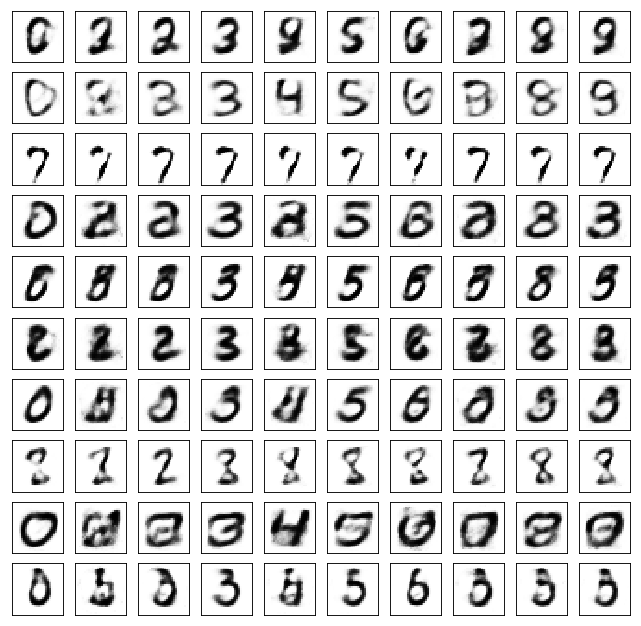

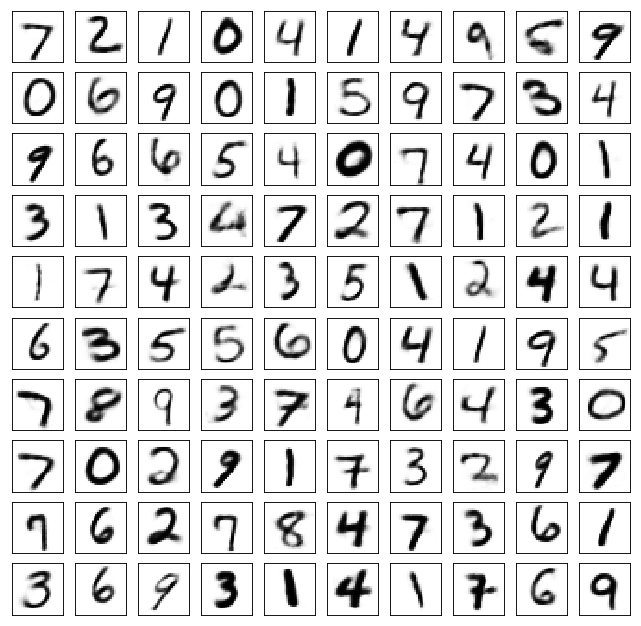

Test losses. E: 0.7033, AE: 0.0578, D: 0.6930
Train Epoch: 140 [0/50000 (0%)]	Losses E: 0.7046, AE: 0.0539, D: 0.6934
Train Epoch: 140 [25000/50000 (50%)]	Losses E: 0.6864, AE: 0.0514, D: 0.6921
Train Epoch: 140 [50000/50000 (100%)]	Losses E: 0.6876, AE: 0.0531, D: 0.6925


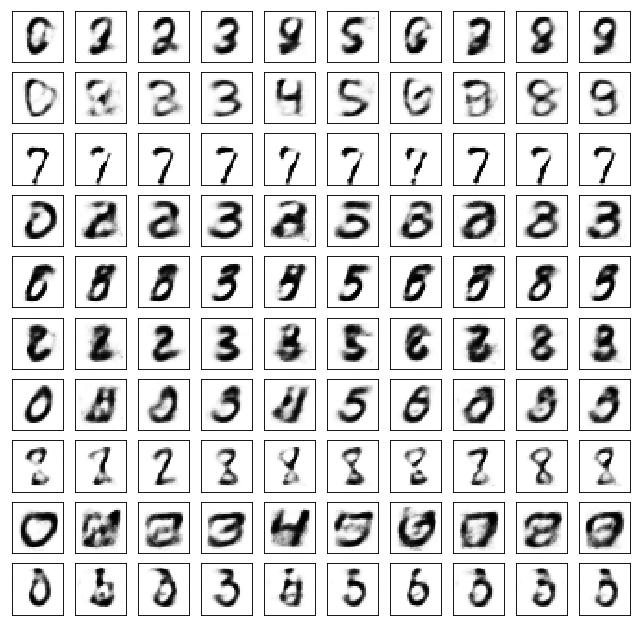

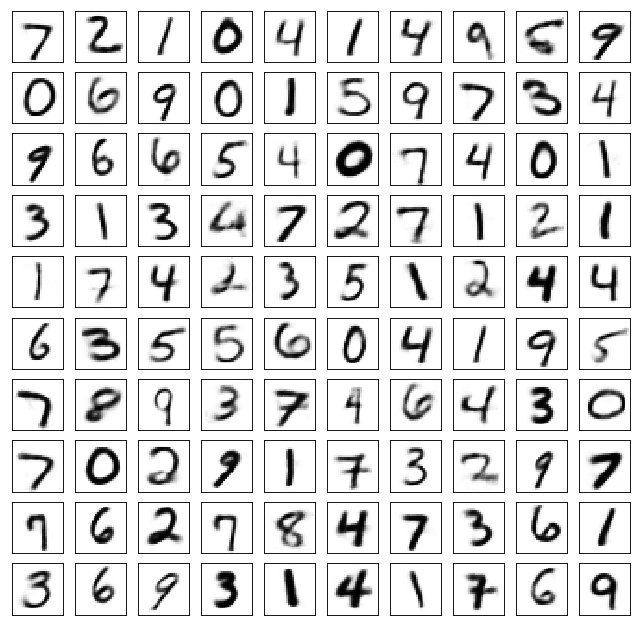

Test losses. E: 0.6870, AE: 0.0555, D: 0.6931
Train Epoch: 141 [0/50000 (0%)]	Losses E: 0.6874, AE: 0.0547, D: 0.6941
Train Epoch: 141 [25000/50000 (50%)]	Losses E: 0.6848, AE: 0.0543, D: 0.6925
Train Epoch: 141 [50000/50000 (100%)]	Losses E: 0.6961, AE: 0.0514, D: 0.6941


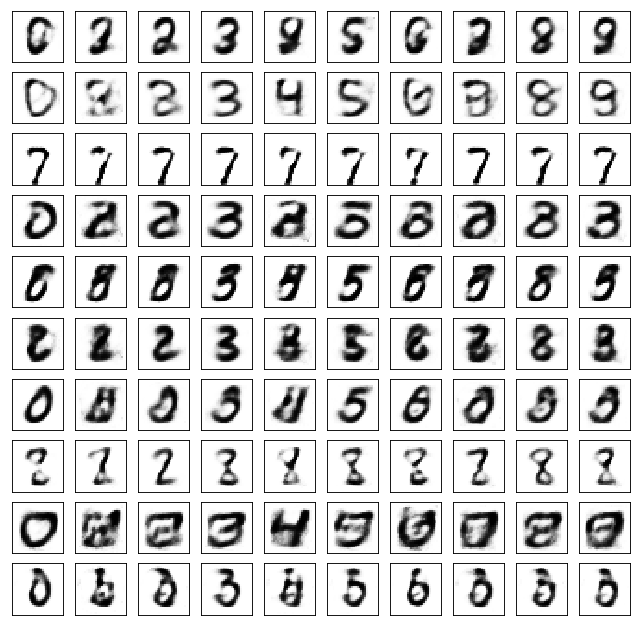

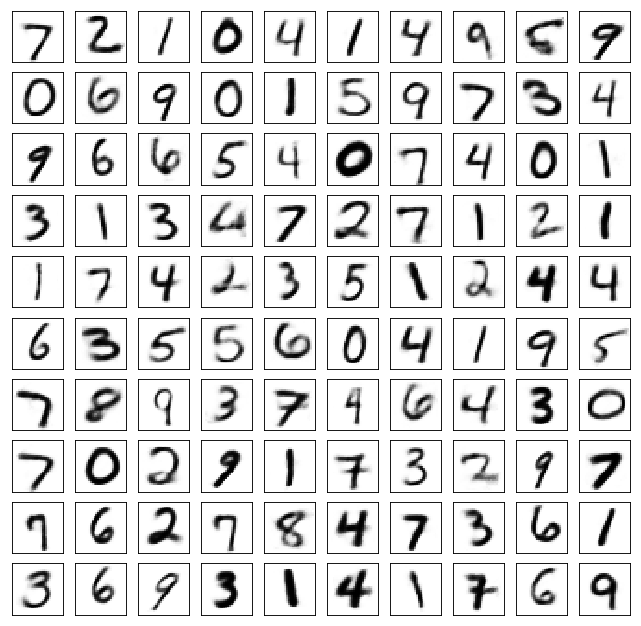

Test losses. E: 0.6960, AE: 0.0549, D: 0.6938
Train Epoch: 142 [0/50000 (0%)]	Losses E: 0.6958, AE: 0.0556, D: 0.6935
Train Epoch: 142 [25000/50000 (50%)]	Losses E: 0.6806, AE: 0.0486, D: 0.6922
Train Epoch: 142 [50000/50000 (100%)]	Losses E: 0.6901, AE: 0.0522, D: 0.6936


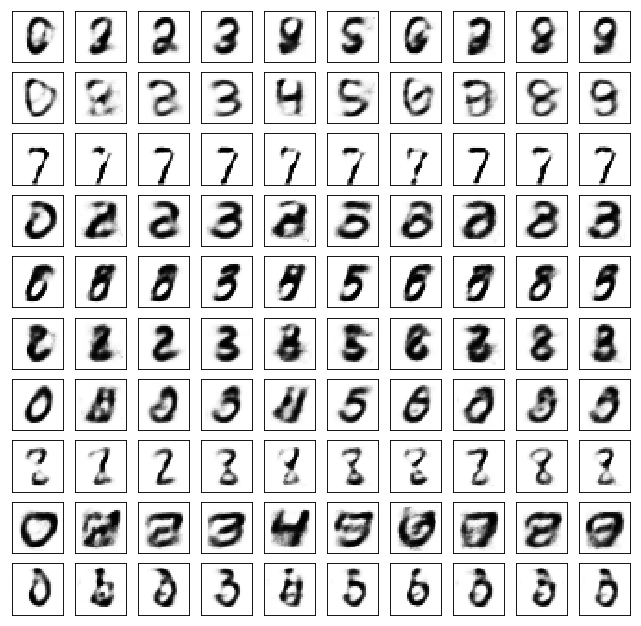

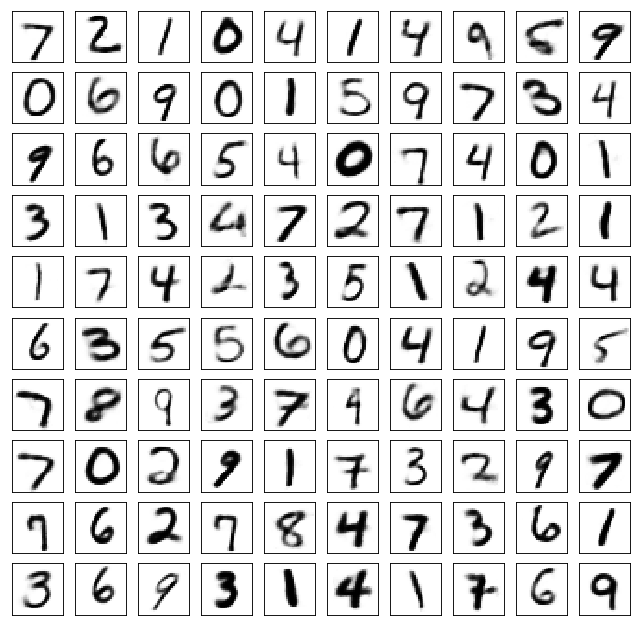

Test losses. E: 0.6896, AE: 0.0556, D: 0.6939
Train Epoch: 143 [0/50000 (0%)]	Losses E: 0.6890, AE: 0.0527, D: 0.6948
Train Epoch: 143 [25000/50000 (50%)]	Losses E: 0.7133, AE: 0.0505, D: 0.6930
Train Epoch: 143 [50000/50000 (100%)]	Losses E: 0.6855, AE: 0.0545, D: 0.6941


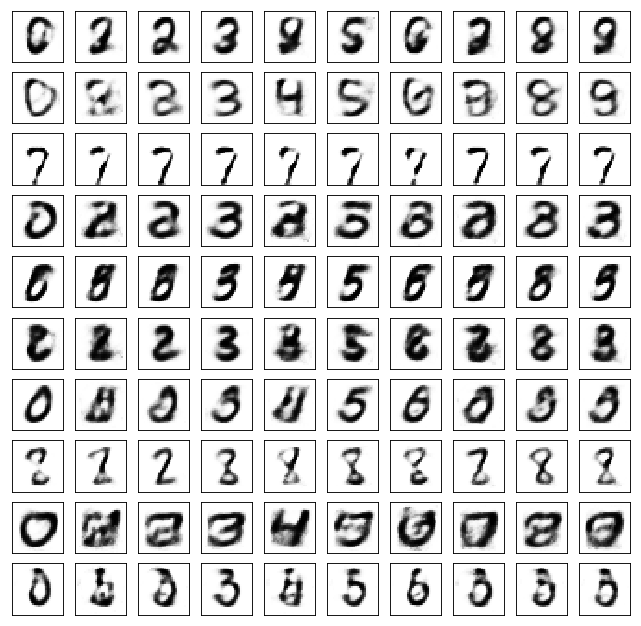

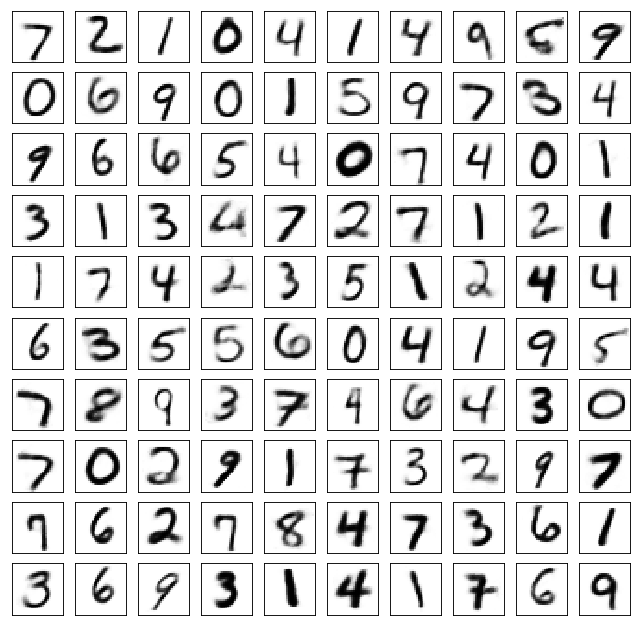

Test losses. E: 0.6847, AE: 0.0546, D: 0.6945
Train Epoch: 144 [0/50000 (0%)]	Losses E: 0.6874, AE: 0.0494, D: 0.6951
Train Epoch: 144 [25000/50000 (50%)]	Losses E: 0.7048, AE: 0.0521, D: 0.6944
Train Epoch: 144 [50000/50000 (100%)]	Losses E: 0.7015, AE: 0.0536, D: 0.6939


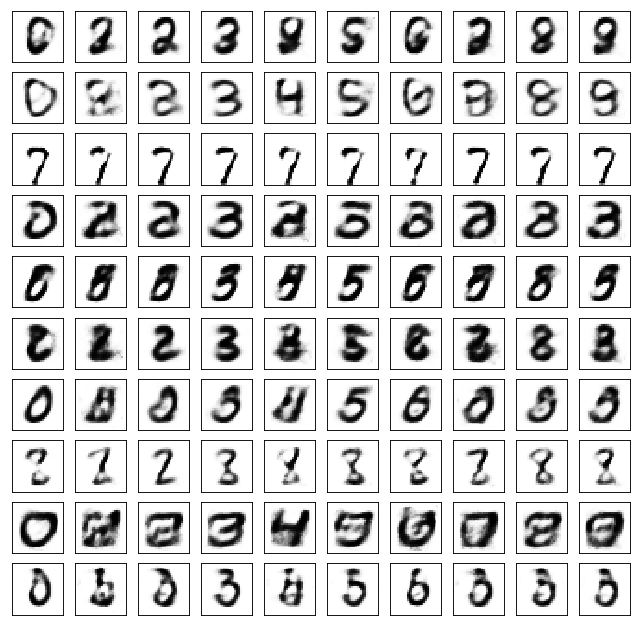

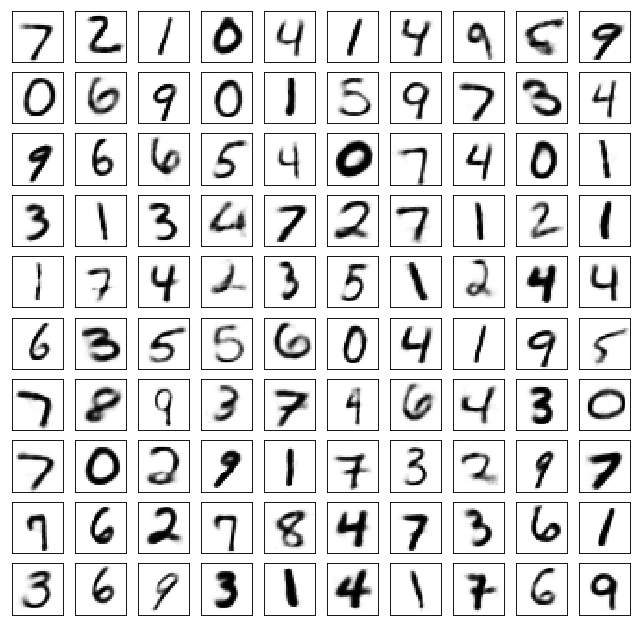

Test losses. E: 0.7016, AE: 0.0542, D: 0.6935
Train Epoch: 145 [0/50000 (0%)]	Losses E: 0.7031, AE: 0.0492, D: 0.6928
Train Epoch: 145 [25000/50000 (50%)]	Losses E: 0.7164, AE: 0.0515, D: 0.6937
Train Epoch: 145 [50000/50000 (100%)]	Losses E: 0.6803, AE: 0.0498, D: 0.6960


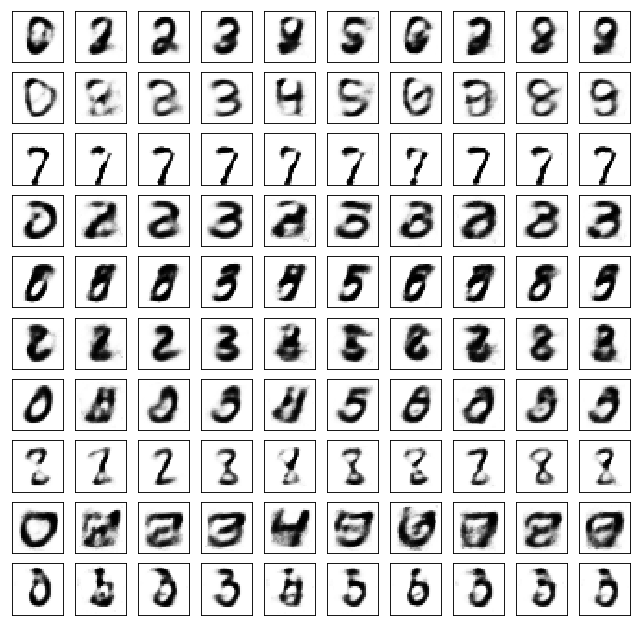

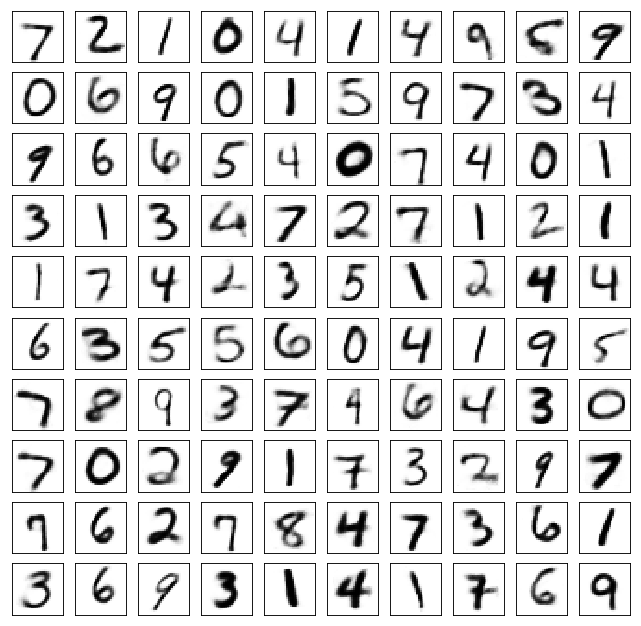

Test losses. E: 0.6800, AE: 0.0553, D: 0.6957
Train Epoch: 146 [0/50000 (0%)]	Losses E: 0.6813, AE: 0.0496, D: 0.6954
Train Epoch: 146 [25000/50000 (50%)]	Losses E: 0.7124, AE: 0.0547, D: 0.6957
Train Epoch: 146 [50000/50000 (100%)]	Losses E: 0.6795, AE: 0.0511, D: 0.6964


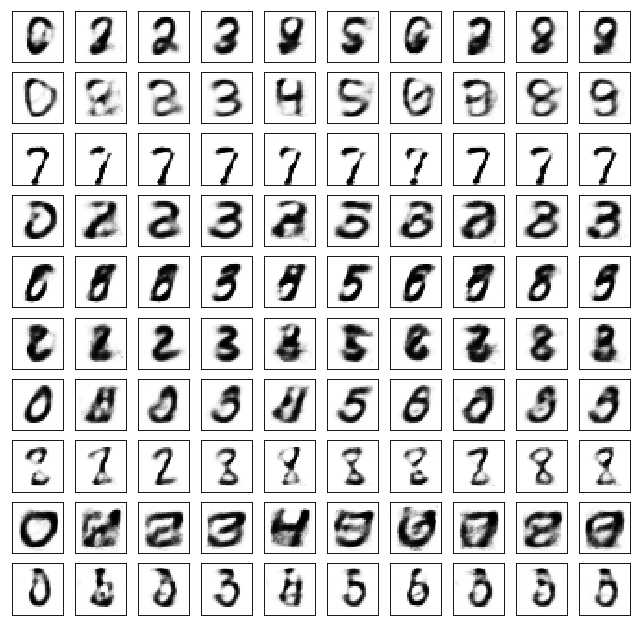

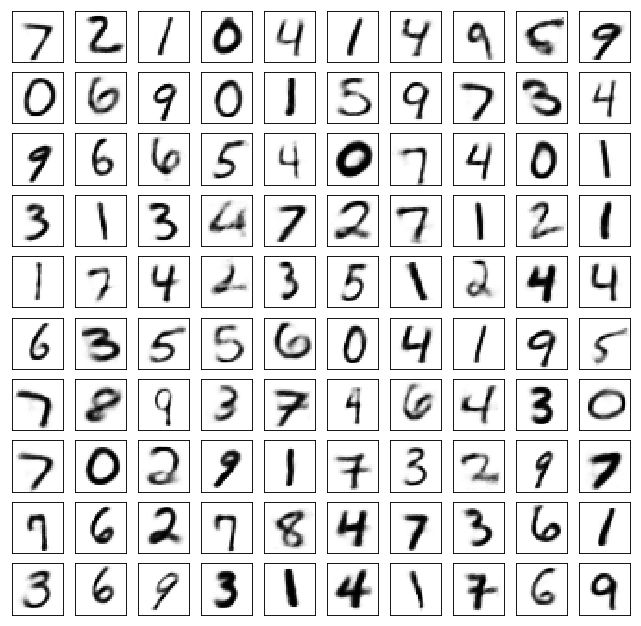

Test losses. E: 0.6781, AE: 0.0555, D: 0.6970
Train Epoch: 147 [0/50000 (0%)]	Losses E: 0.6790, AE: 0.0476, D: 0.6976
Train Epoch: 147 [25000/50000 (50%)]	Losses E: 0.6694, AE: 0.0520, D: 0.6911
Train Epoch: 147 [50000/50000 (100%)]	Losses E: 0.7001, AE: 0.0572, D: 0.6923


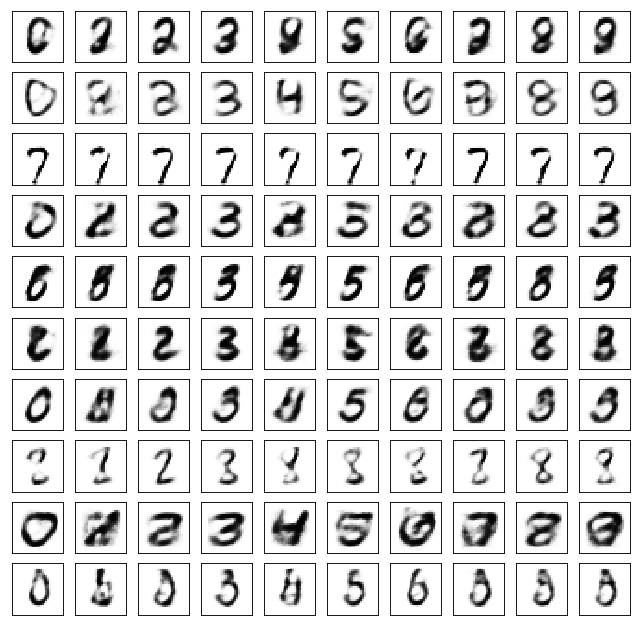

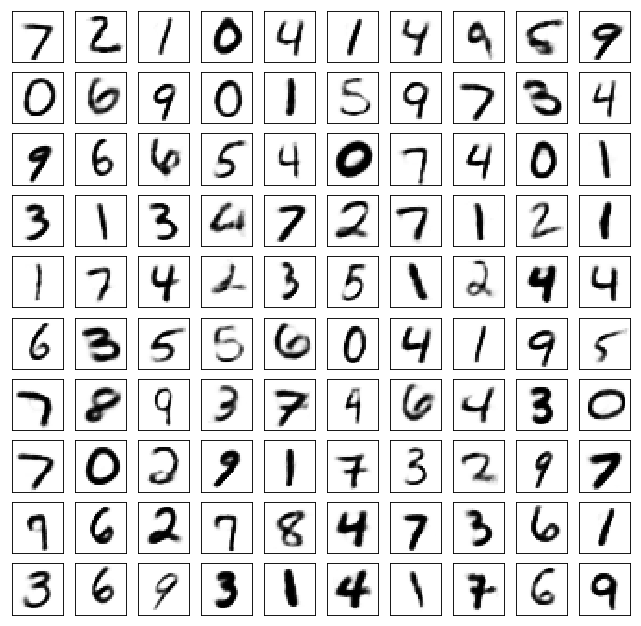

Test losses. E: 0.7002, AE: 0.0586, D: 0.6917
Train Epoch: 148 [0/50000 (0%)]	Losses E: 0.6982, AE: 0.0567, D: 0.6915
Train Epoch: 148 [25000/50000 (50%)]	Losses E: 0.6875, AE: 0.0511, D: 0.6965
Train Epoch: 148 [50000/50000 (100%)]	Losses E: 0.6964, AE: 0.0528, D: 0.6925


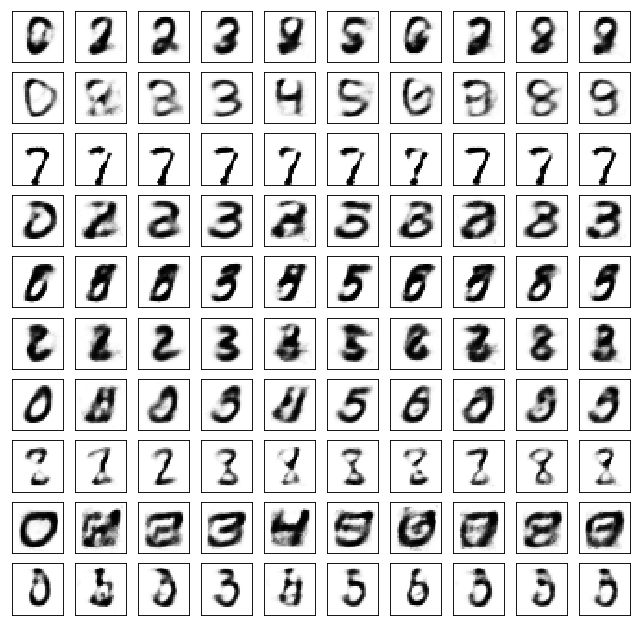

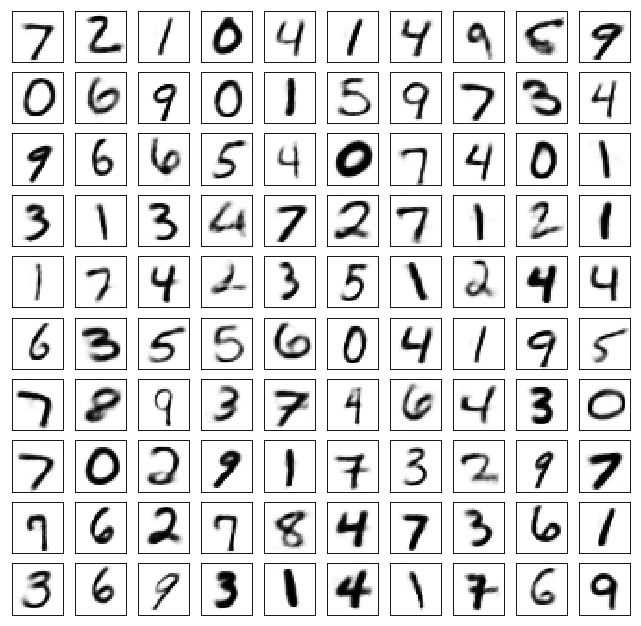

Test losses. E: 0.6962, AE: 0.0534, D: 0.6920
Train Epoch: 149 [0/50000 (0%)]	Losses E: 0.6923, AE: 0.0545, D: 0.6926
Train Epoch: 149 [25000/50000 (50%)]	Losses E: 0.7233, AE: 0.0505, D: 0.6944
Train Epoch: 149 [50000/50000 (100%)]	Losses E: 0.6714, AE: 0.0487, D: 0.6928


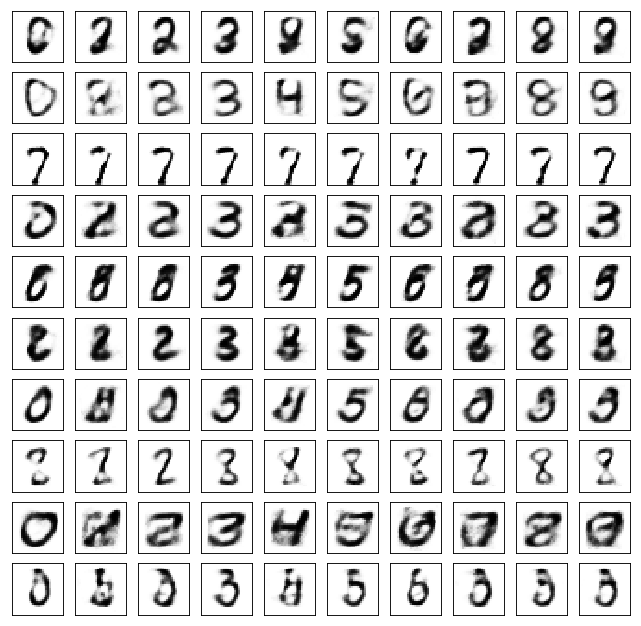

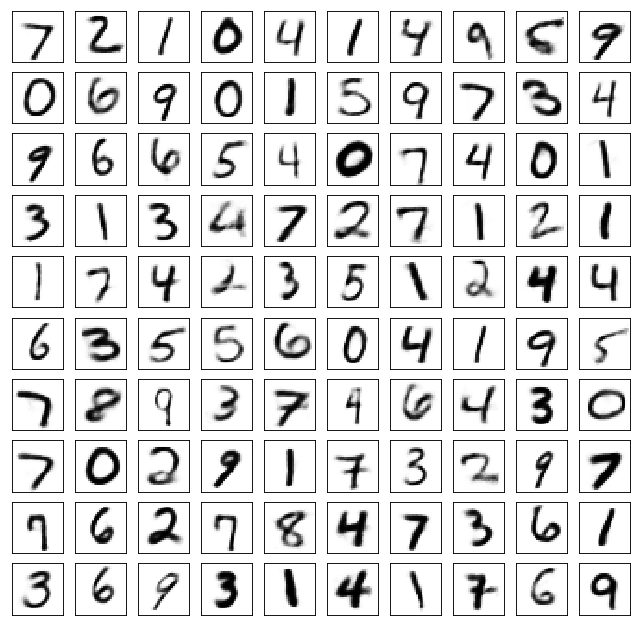

Test losses. E: 0.6717, AE: 0.0517, D: 0.6929
Train Epoch: 150 [0/50000 (0%)]	Losses E: 0.6728, AE: 0.0480, D: 0.6931
Train Epoch: 150 [25000/50000 (50%)]	Losses E: 0.7026, AE: 0.0474, D: 0.6928
Train Epoch: 150 [50000/50000 (100%)]	Losses E: 0.7008, AE: 0.0496, D: 0.6941


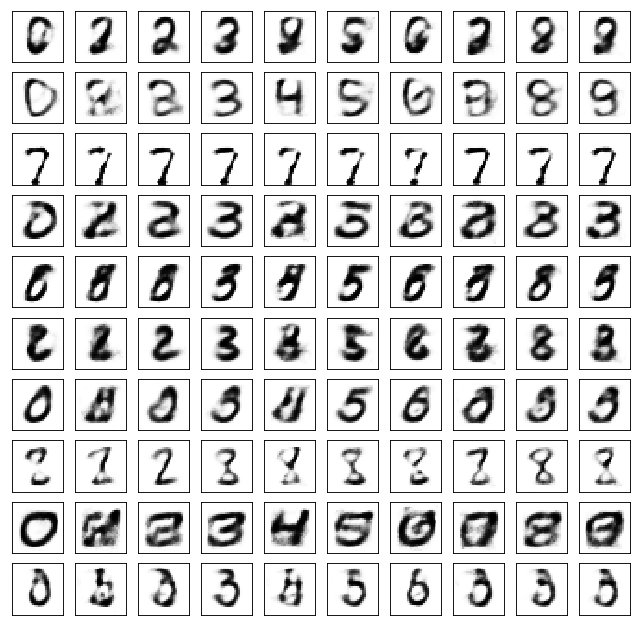

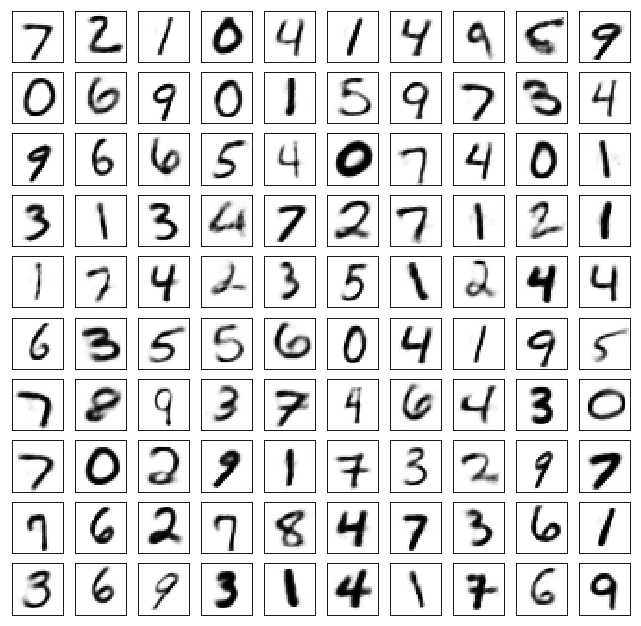

Test losses. E: 0.7002, AE: 0.0538, D: 0.6945
Train Epoch: 151 [0/50000 (0%)]	Losses E: 0.6981, AE: 0.0507, D: 0.6946
Train Epoch: 151 [25000/50000 (50%)]	Losses E: 0.6777, AE: 0.0485, D: 0.6941
Train Epoch: 151 [50000/50000 (100%)]	Losses E: 0.6752, AE: 0.0480, D: 0.6944


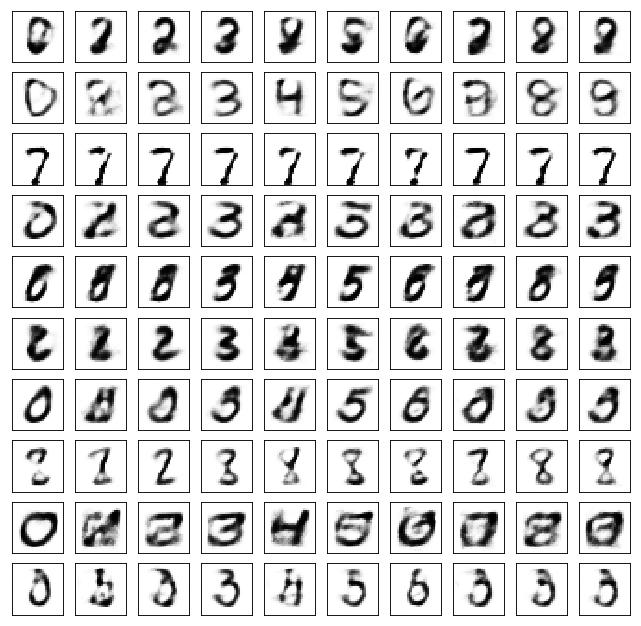

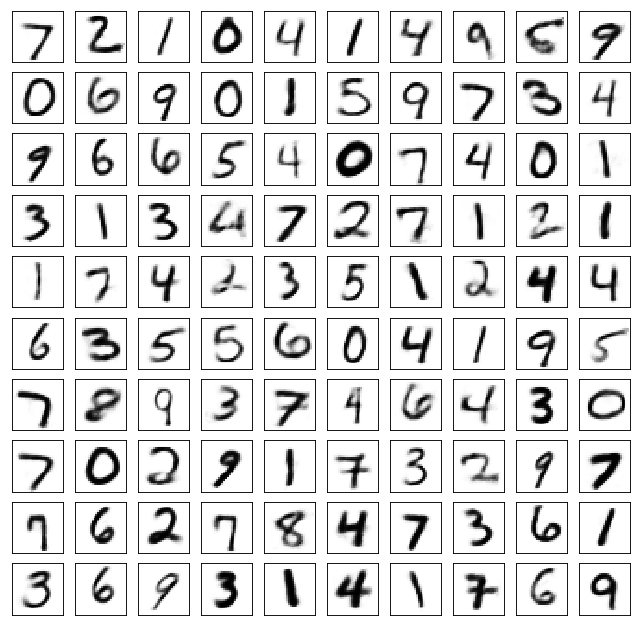

Test losses. E: 0.6730, AE: 0.0530, D: 0.6952
Train Epoch: 152 [0/50000 (0%)]	Losses E: 0.6737, AE: 0.0513, D: 0.6946
Train Epoch: 152 [25000/50000 (50%)]	Losses E: 0.6796, AE: 0.0470, D: 0.6915
Train Epoch: 152 [50000/50000 (100%)]	Losses E: 0.6698, AE: 0.0508, D: 0.6909


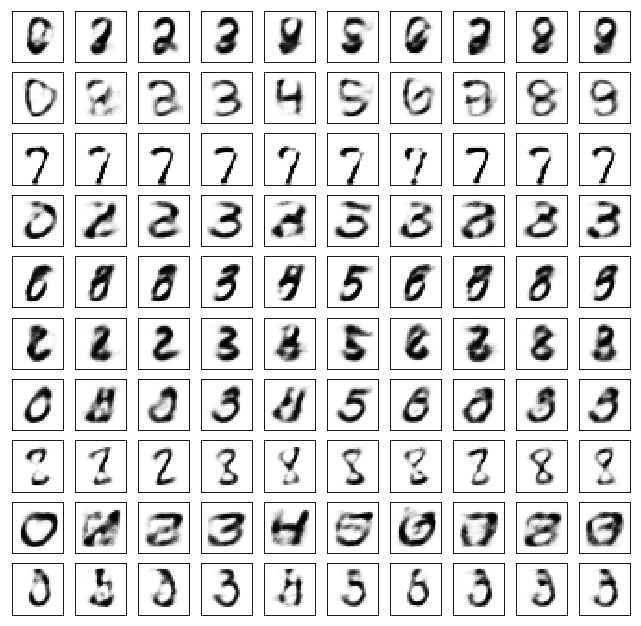

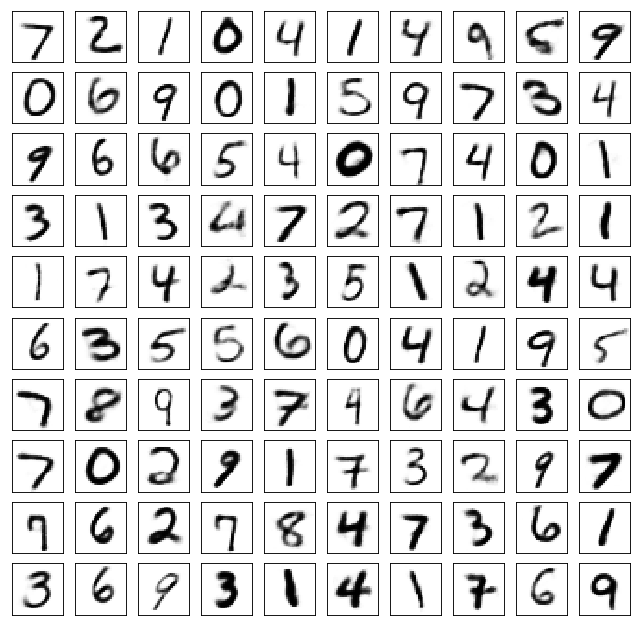

Test losses. E: 0.6681, AE: 0.0526, D: 0.6918
Train Epoch: 153 [0/50000 (0%)]	Losses E: 0.6696, AE: 0.0551, D: 0.6914
Train Epoch: 153 [25000/50000 (50%)]	Losses E: 0.6863, AE: 0.0533, D: 0.6906


KeyboardInterrupt: 

In [13]:
for epoch in range(1, 1001):
    Enc.train()
    Dec.train()
    Disc.train()
    train(epoch, Enc, Dec, Disc, train_log)
    Enc.eval()
    Dec.eval()
    Disc.eval()
    test(Enc, Dec, Disc, valid_loader, epoch, test_log)

In [14]:
Enc.eval()
Dec.eval()
Disc.eval()

FullyConnected(
  (model): Sequential(
    (0): Linear(in_features=10, out_features=1024, bias=True)
    (1): Dropout(p=0.3)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Linear(in_features=1024, out_features=1024, bias=True)
    (4): Dropout(p=0.3)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Linear(in_features=1024, out_features=1, bias=True)
  )
)

In [15]:
torch.save({
    'Encoder': Enc,
    'Decoder': Dec,
    'Discriminator': Disc
}, 'aae_c.models')

c:\program files\python36\lib\site-packages\torch\serialization.py:256: UserWarning: Couldn't retrieve source code for container of type FullyConnected. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
